
# Neural Style Transfer dengan Eksperimen Arsitektur

Eksplorasi Model Vanilla, Residual, dan Multi-Scale



Notebook ini menyajikan implementasi dan evaluasi Neural Style Transfer (NST) menggunakan tiga arsitektur model yang berbeda:

- Model Vanilla NST: Implementasi dasar dengan layer konvolusi berurutan untuk mentransfer gaya.
- Model Residual NST: Menggunakan koneksi residual untuk meningkatkan aliran gradien dan pemanfaatan fitur.
- Model Multi-Scale NST: Memanfaatkan pemrosesan multi-skala untuk menangkap dan mentransfer gaya di berbagai skala spasial.


Setiap model telah dilatih dan diuji pada serangkaian gambar konten dan gaya, memperlihatkan kemampuan serta perbedaan kinerja masing-masing.

Fitur Utama:


- Pelatihan dan Pengujian: Model dilatih menggunakan fungsi loss dinamis yang menyeimbangkan konten dan gaya.
- Eksperimen Arsitektur: Mengeksplorasi pengaruh modifikasi arsitektur terhadap kualitas transfer gaya.
- Visualisasi Interaktif: Hasil transfer gaya dapat dilihat secara real-time selama proses pelatihan dan pengujian.

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from google.colab import files
import time

# Fungsi untuk upload gambar
def upload_image():
    uploaded = files.upload()
    file_path = list(uploaded.keys())[0]
    return file_path

# Preprocessing dan deprocessing gambar
def preprocess_image(image_path, target_size=(512, 512)):
    img = tf.keras.preprocessing.image.load_img(image_path, target_size=target_size)
    img = tf.keras.preprocessing.image.img_to_array(img) / 255.0
    img = tf.expand_dims(img, axis=0)
    return img

def deprocess_image(image):
    img = tf.squeeze(image, axis=0)
    img = tf.clip_by_value(img, 0.0, 1.0)
    return img

# Fungsi Gram Matrix
def gram_matrix(input_tensor):
    channels = int(input_tensor.shape[-1])
    vectorized = tf.reshape(input_tensor, [-1, channels])
    gram = tf.matmul(vectorized, vectorized, transpose_a=True)
    return gram / tf.cast(tf.reduce_prod(input_tensor.shape[1:]), tf.float32)

# Model NST dengan arsitektur custom
def create_nst_model():
    model = models.Sequential([
        layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(512, 512, 3)),
        layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
        layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
        layers.UpSampling2D((2, 2)),
        layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
        layers.UpSampling2D((2, 2)),
        layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
        layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid'),
    ])
    return model

# Loss function
def compute_loss(content_img, style_img, generated_img, model, alpha=1.0, beta=100.0):
    content_features = model(content_img)
    style_features = model(style_img)
    generated_features = model(generated_img)

    # Compute Content Loss
    content_loss = tf.reduce_mean(tf.square(content_features - generated_features))

    # Compute Style Loss
    gram_style = gram_matrix(style_features)
    gram_generated = gram_matrix(generated_features)
    style_loss = tf.reduce_mean(tf.square(gram_style - gram_generated))

    # Variation Loss untuk mengurangi noise
    variation_loss = tf.image.total_variation(generated_img)

    # Total Loss
    total_loss = alpha * content_loss + beta * style_loss + 0.2 * variation_loss
    return total_loss

# Training loop untuk batch
def train_nst_batch(content_images, style_images, model, epochs=1500, lr=0.001):
    generated_images = tf.Variable(content_images)
    optimizer = tf.keras.optimizers.Adam(learning_rate=lr)

    for epoch in tqdm(range(epochs)):
        with tf.GradientTape() as tape:
            total_loss = 0
            for i in range(content_images.shape[0]):  # Loop untuk setiap pasangan dalam batch
                loss = compute_loss(content_images[i:i+1], style_images[i:i+1], generated_images[i:i+1], model)
                total_loss += loss

        gradients = tape.gradient(total_loss, [generated_images])
        optimizer.apply_gradients(zip(gradients, [generated_images]))

        # Pastikan total_loss adalah scalar
        total_loss_scalar = tf.reduce_sum(total_loss).numpy()

        if epoch % 100 == 0 or epoch == epochs - 1:
            print(f"Epoch {epoch}, Total Loss: {total_loss_scalar:.6f}")
            temp_image = deprocess_image(generated_images[0])  # Visualisasi salah satu hasil
            plt.imshow(temp_image)
            plt.title(f"Epoch {epoch}")
            plt.axis('off')
            plt.show()

    return generated_images


In [ ]:
# Upload Content dan Style Images
print("Upload Content Image 1")
content_image_path1 = upload_image()
print("Upload Style Image 1")
style_image_path1 = upload_image()

print("Upload Content Image 2")
content_image_path2 = upload_image()
print("Upload Style Image 2")
style_image_path2 = upload_image()

Upload Content Image 1


Saving images (1).jpg to images (1).jpg
Upload Style Image 1


Saving images.jpg to images.jpg
Upload Content Image 2


Saving istockphoto-470755508-612x612.jpg to istockphoto-470755508-612x612.jpg
Upload Style Image 2


Saving images.jpg to images (2).jpg


In [ ]:
# Preprocess semua gambar
content_image1 = preprocess_image(content_image_path1)
style_image1 = preprocess_image(style_image_path1)
content_image2 = preprocess_image(content_image_path2)
style_image2 = preprocess_image(style_image_path2)

# Gabungkan data ke dalam batch
content_images = tf.concat([content_image1, content_image2], axis=0)
style_images = tf.concat([style_image1, style_image2], axis=0)

Upload Content Image 1


Saving images (1).jpg to images (1) (3).jpg
Upload Style Image 1


Saving images.jpg to images (4).jpg
Upload Content Image 2


Saving istockphoto-470755508-612x612.jpg to istockphoto-470755508-612x612 (3).jpg
Upload Style Image 2


Saving images.jpg to images (5).jpg


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_27 (Conv2D)                   │ (None, 512, 512, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_28 (Conv2D)                   │ (None, 512, 512, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_6 (MaxPooling2D)       │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_29 (Conv2D)                   │ (None, 256, 256, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_30 (Conv2D)                   │ (None, 256, 256, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_7 (MaxPooling2D)       │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_31 (Conv2D)                   │ (None, 128, 128, 256)       │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_32 (Conv2D)                   │ (None, 128, 128, 256)       │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_6 (UpSampling2D)       │ (None, 256, 256, 256)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_33 (Conv2D)                   │ (None, 256, 256, 128)       │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_7 (UpSampling2D)       │ (None, 512, 512, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_34 (Conv2D)                   │ (None, 512, 512, 64)        │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_35 (Conv2D)                   │ (None, 512, 512, 3)         │           1,731 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,515,971 (5.78 MB)

 Trainable params: 1,515,971 (5.78 MB)

 Non-trainable params: 0 (0.00 B)

  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch 0, Total Loss: 10463.704102


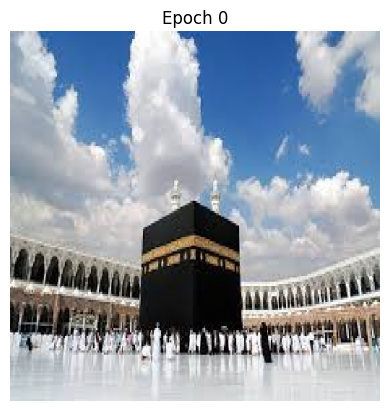

 10%|█         | 100/1000 [01:30<13:17,  1.13it/s]

Epoch 100, Total Loss: 5623.898438


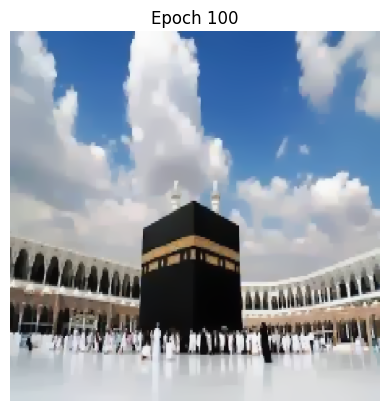

 20%|██        | 200/1000 [03:00<11:49,  1.13it/s]

Epoch 200, Total Loss: 4282.060059


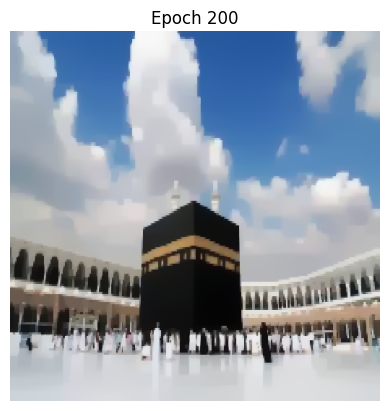

 30%|███       | 300/1000 [04:30<10:19,  1.13it/s]

Epoch 300, Total Loss: 3541.141602


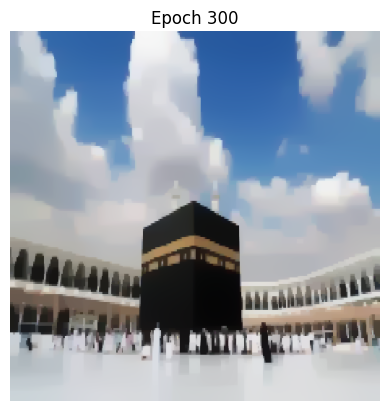

 40%|████      | 400/1000 [06:00<08:53,  1.12it/s]

Epoch 400, Total Loss: 3041.085938


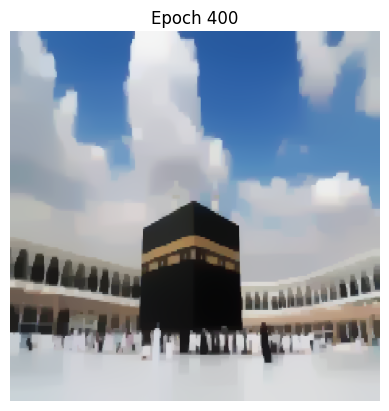

 50%|█████     | 500/1000 [07:30<07:24,  1.13it/s]

Epoch 500, Total Loss: 2674.194824


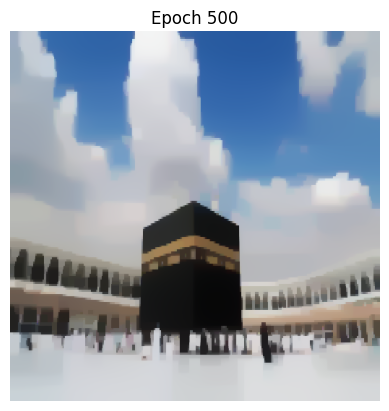

 60%|██████    | 600/1000 [09:01<05:54,  1.13it/s]

Epoch 600, Total Loss: 2395.317627


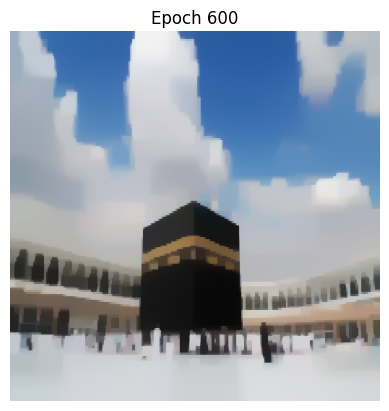

 70%|███████   | 700/1000 [10:31<04:26,  1.12it/s]

Epoch 700, Total Loss: 2181.228271


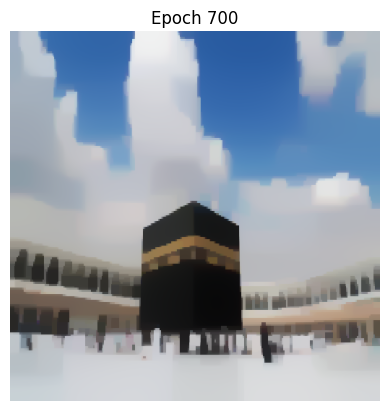

 80%|████████  | 800/1000 [12:01<02:57,  1.12it/s]

Epoch 800, Total Loss: 2011.937256


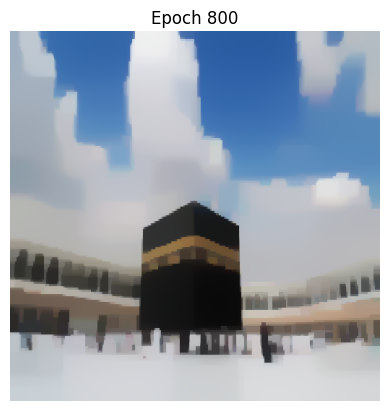

 90%|█████████ | 900/1000 [13:31<01:28,  1.13it/s]

Epoch 900, Total Loss: 1875.347656


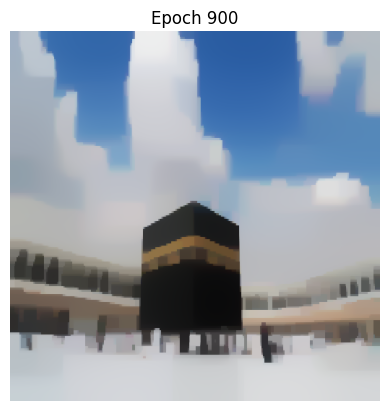

100%|█████████▉| 999/1000 [15:05<00:00,  1.07it/s]

Epoch 999, Total Loss: 1765.295898


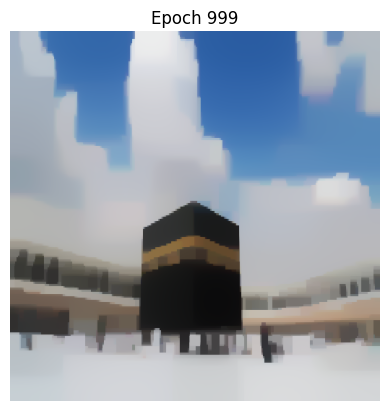

100%|██████████| 1000/1000 [15:06<00:00,  1.10it/s]


Total training time: 15 minutes 7 seconds


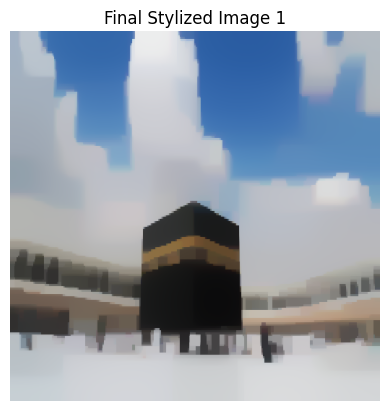

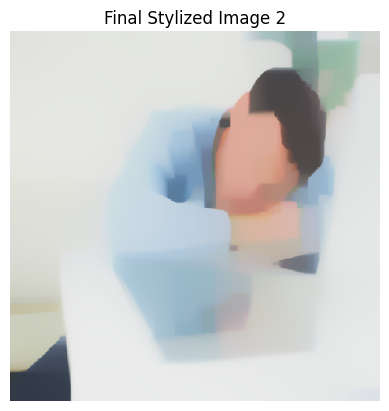

In [ ]:
# Buat model baru
nst_model = create_nst_model()
nst_model.summary()

# Mulai Training
start_time = time.time()
output_images_batch = train_nst_batch(content_images, style_images, nst_model, epochs=1000, lr=0.001)
end_time = time.time()

# Waktu Training
elapsed_time = end_time - start_time
print(f"Total training time: {elapsed_time // 60:.0f} minutes {elapsed_time % 60:.0f} seconds")

# Simpan Hasil Akhir
for i in range(output_images_batch.shape[0]):
    final_image = deprocess_image(output_images_batch[i:i+1])
    plt.imshow(final_image)
    plt.title(f"Final Stylized Image {i+1}")
    plt.axis('off')
    plt.show()

    tf.keras.preprocessing.image.save_img(f"/content/final_stylized_image_{i+1}.jpg", final_image)

In [ ]:
nst_model.save('/content/nst_model.h5')
print("Model saved successfully!")

Model saved successfully!


In [ ]:
from tensorflow.keras.models import load_model

# Muat model
nst_model = load_model('/content/nst_model.h5')


Upload Testing Content Image


Saving 09967300800-a1.jpg to 09967300800-a1 (3).jpg
Upload Testing Style Image


Saving images.jpg to images (15).jpg


  0%|          | 0/1000 [00:00<?, ?it/s]<ipython-input-14-62933dcc82d4>:26: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print(f"Epoch {epoch}, Total Loss: {float(total_loss.numpy()):.6f}")


Epoch 0, Total Loss: 4169.328125


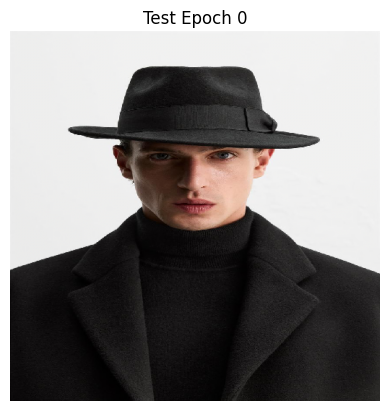

 10%|█         | 100/1000 [00:45<07:00,  2.14it/s]

Epoch 100, Total Loss: 1206.054810


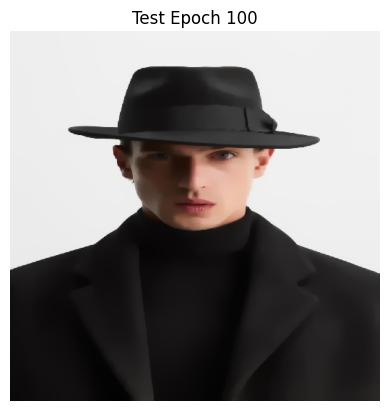

 20%|██        | 200/1000 [01:30<05:56,  2.24it/s]

Epoch 200, Total Loss: 1059.639648


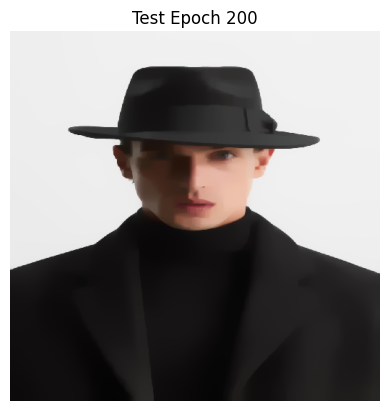

 30%|███       | 300/1000 [02:15<05:21,  2.18it/s]

Epoch 300, Total Loss: 979.835815


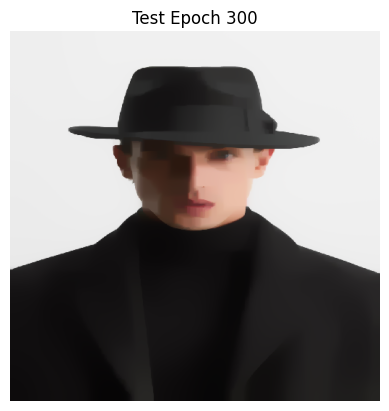

 40%|████      | 400/1000 [03:00<04:28,  2.24it/s]

Epoch 400, Total Loss: 928.092957


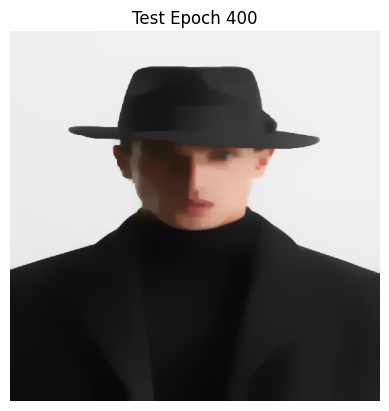

 50%|█████     | 500/1000 [03:45<03:49,  2.18it/s]

Epoch 500, Total Loss: 894.416687


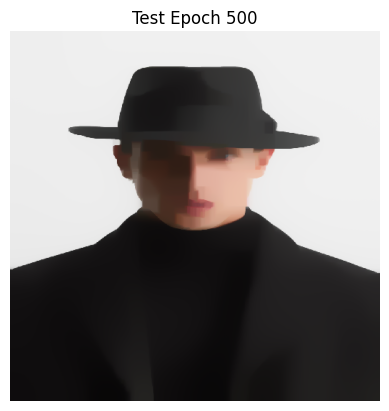

 60%|██████    | 600/1000 [04:30<02:57,  2.25it/s]

Epoch 600, Total Loss: 869.870361


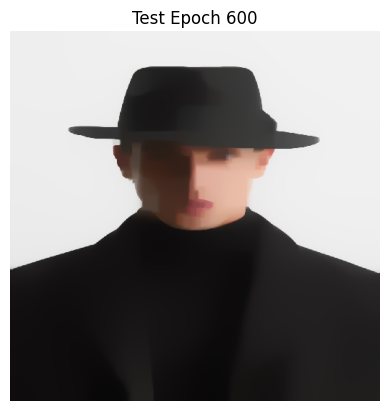

 70%|███████   | 700/1000 [05:15<02:15,  2.22it/s]

Epoch 700, Total Loss: 850.496765


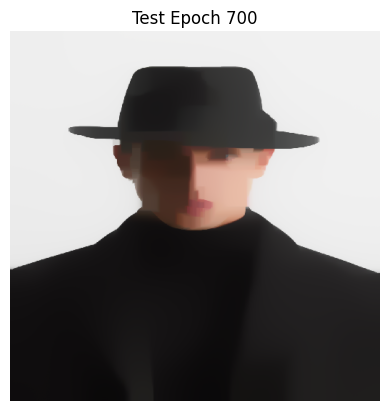

 80%|████████  | 800/1000 [06:02<01:28,  2.25it/s]

Epoch 800, Total Loss: 834.737976


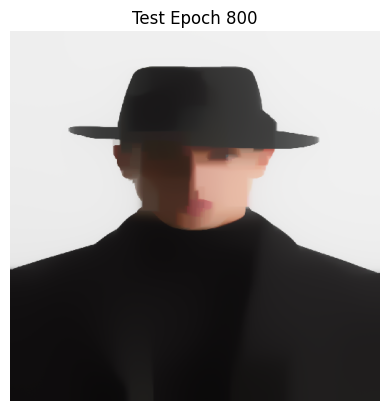

 90%|█████████ | 900/1000 [06:49<00:45,  2.20it/s]

Epoch 900, Total Loss: 821.801025


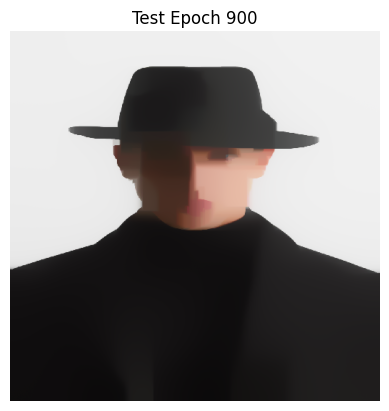

100%|█████████▉| 999/1000 [07:34<00:00,  2.16it/s]

Epoch 999, Total Loss: 811.108276


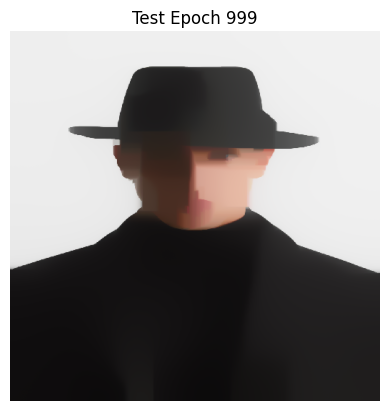

100%|██████████| 1000/1000 [07:34<00:00,  2.20it/s]


In [ ]:
# Upload Content dan Style Images untuk testing
print("Upload Testing Content Image")
test_content_path = upload_image()
print("Upload Testing Style Image")
test_style_path = upload_image()

# Preprocess gambar
test_content_image = preprocess_image(test_content_path)
test_style_image = preprocess_image(test_style_path)

generated_image = tf.Variable(test_content_image)

# Optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

# Testing loop
epochs = 1000
for epoch in tqdm(range(epochs)):
    with tf.GradientTape() as tape:
        total_loss = compute_loss(test_content_image, test_style_image, generated_image, nst_model)

    gradients = tape.gradient(total_loss, [generated_image])
    optimizer.apply_gradients(zip(gradients, [generated_image]))

    if epoch % 100 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch}, Total Loss: {float(total_loss.numpy()):.6f}")
        temp_image = deprocess_image(generated_image)
        plt.imshow(temp_image)
        plt.title(f"Test Epoch {epoch}")
        plt.axis('off')
        plt.show()


model eksperimen kedua :

tambah recidual connections

In [ ]:
def create_nst_model_with_residuals():
    inputs = layers.Input(shape=(512, 512, 3))
    x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(inputs)
    x1 = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = layers.Add()([x, x1])  # Residual Connection

    x = layers.MaxPooling2D((2, 2))(x)

    x = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x1 = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = layers.Add()([x, x1])  # Residual Connection

    x = layers.MaxPooling2D((2, 2))(x)

    x = layers.Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x1 = layers.Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = layers.Add()([x, x1])  # Residual Connection

    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid')(x)

    return models.Model(inputs, x)

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 512, 512, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_27 (Conv2D)        │ (None, 512, 512, 64)   │          1,792 │ input_layer_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_28 (Conv2D)        │ (None, 512, 512, 64)   │         36,928 │ conv2d_27[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_9 (Add)               │ (None, 512, 512, 64)   │              0 │ conv2d_27[0][0],       │
│                           │                        │                │ conv2d_28[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_6           │ (None, 256, 256, 64)   │              0 │ add_9[0][0]            │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_29 (Conv2D)        │ (None, 256, 256, 128)  │         73,856 │ max_pooling2d_6[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_30 (Conv2D)        │ (None, 256, 256, 128)  │        147,584 │ conv2d_29[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_10 (Add)              │ (None, 256, 256, 128)  │              0 │ conv2d_29[0][0],       │
│                           │                        │                │ conv2d_30[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_7           │ (None, 128, 128, 128)  │              0 │ add_10[0][0]           │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_31 (Conv2D)        │ (None, 128, 128, 256)  │        295,168 │ max_pooling2d_7[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_32 (Conv2D)        │ (None, 128, 128, 256)  │        590,080 │ conv2d_31[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_11 (Add)              │ (None, 128, 128, 256)  │              0 │ conv2d_31[0][0],       │
│                           │                        │                │ conv2d_32[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_6           │ (None, 256, 256, 256)  │              0 │ add_11[0][0]           │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_33 (Conv2D)        │ (None, 256, 256, 128)  │        295,040 │ up_sampling2d_6[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_7           │ (None, 512, 512, 128)  │              0 │ conv2d_33[0][0]        │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_34 (Conv2D)   

 Total params: 1,515,971 (5.78 MB)

 Trainable params: 1,515,971 (5.78 MB)

 Non-trainable params: 0 (0.00 B)

  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch 0, Total Loss: 10463.704102


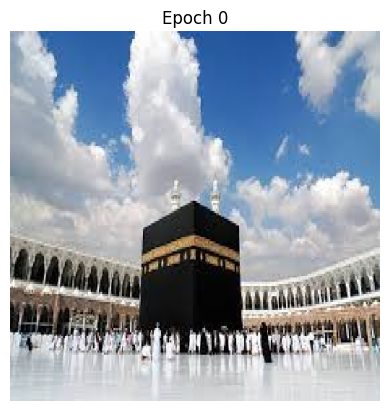

 10%|█         | 100/1000 [01:36<14:27,  1.04it/s]

Epoch 100, Total Loss: 5637.473145


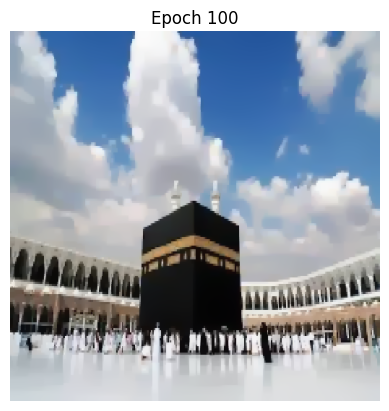

 20%|██        | 200/1000 [03:11<12:29,  1.07it/s]

Epoch 200, Total Loss: 4301.883789


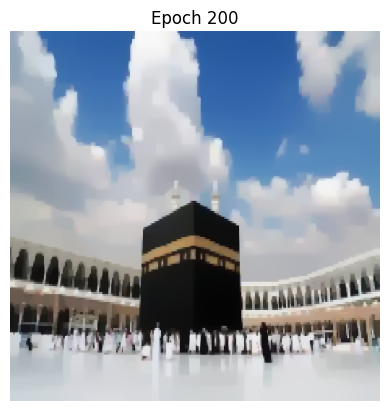

 30%|███       | 300/1000 [04:46<11:25,  1.02it/s]

Epoch 300, Total Loss: 3562.508789


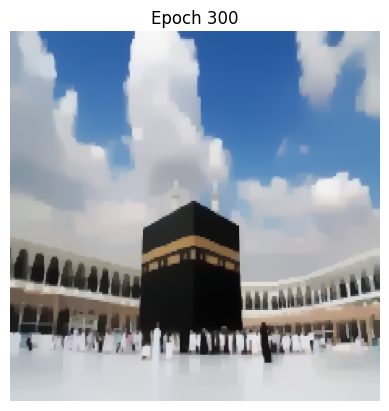

 40%|████      | 400/1000 [06:25<09:22,  1.07it/s]

Epoch 400, Total Loss: 3062.591309


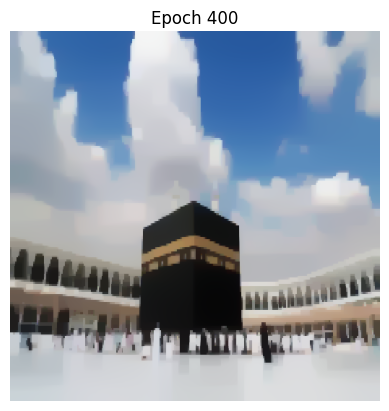

 50%|█████     | 500/1000 [08:00<07:52,  1.06it/s]

Epoch 500, Total Loss: 2694.068604


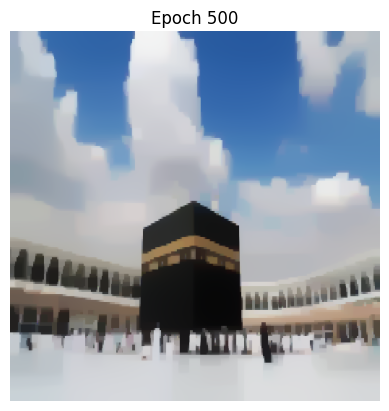

 60%|██████    | 600/1000 [09:35<06:24,  1.04it/s]

Epoch 600, Total Loss: 2412.584961


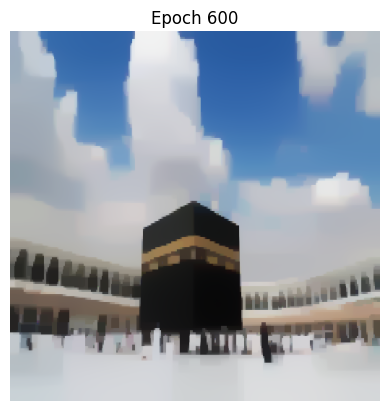

 70%|███████   | 700/1000 [11:10<04:53,  1.02it/s]

Epoch 700, Total Loss: 2195.667969


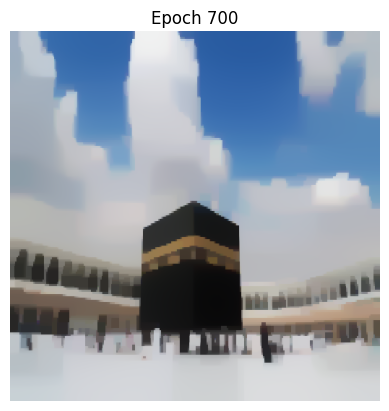

 80%|████████  | 800/1000 [12:49<03:33,  1.07s/it]

Epoch 800, Total Loss: 2023.627319


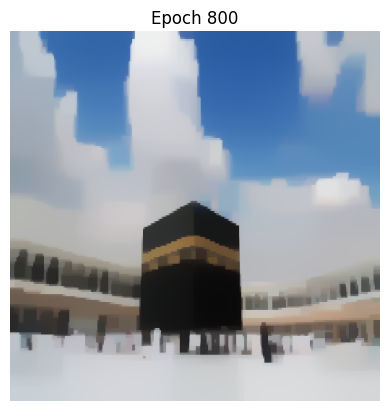

 90%|█████████ | 900/1000 [14:25<01:36,  1.04it/s]

Epoch 900, Total Loss: 1884.546631


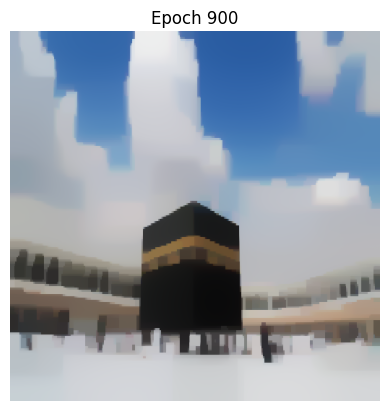

100%|█████████▉| 999/1000 [15:59<00:00,  1.02it/s]

Epoch 999, Total Loss: 1772.303711


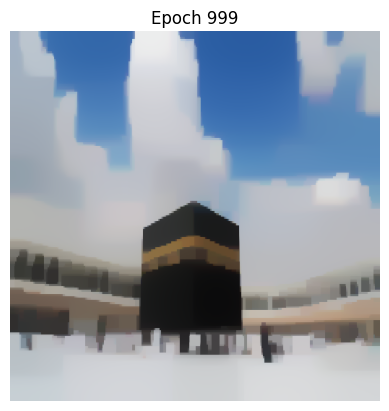

100%|██████████| 1000/1000 [16:00<00:00,  1.04it/s]


NameError: name 'nst_model_with_attention' is not defined

In [ ]:
# Buat model baru dengan Self-Attention
nst_model_with_residuals = create_nst_model_with_residuals()
nst_model_with_residuals.summary()
def deprocess_image(image):
    # Hanya squeeze jika dimensi pertama (batch) adalah 1
    if len(image.shape) == 4 and image.shape[0] == 1:
        image = tf.squeeze(image, axis=0)  # Hapus dimensi batch jika batch size adalah 1
    image = tf.clip_by_value(image, 0.0, 1.0)  # Memastikan nilai pixel antara 0 dan 1
    return image

# Training menggunakan model baru
output_images_batch = train_nst_batch(content_images, style_images, nst_model_with_residuals, epochs=1000, lr=0.001)



In [ ]:
# Simpan model
nst_model_with_residuals.save('/content/nst_model_with_residuals.h5')
print("Model with self-attention saved successfully!")

Model with self-attention saved successfully!


Upload Testing Content Image


Saving 09967300800-a1.jpg to 09967300800-a1.jpg
Upload Testing Style Image


Saving images.jpg to images (3).jpg


  0%|          | 0/1000 [00:00<?, ?it/s]<ipython-input-14-49d83d0d9de7>:34: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print(f"Epoch {epoch}, Total Loss: {float(total_loss.numpy()):.6f}")


Epoch 0, Total Loss: 4169.329102


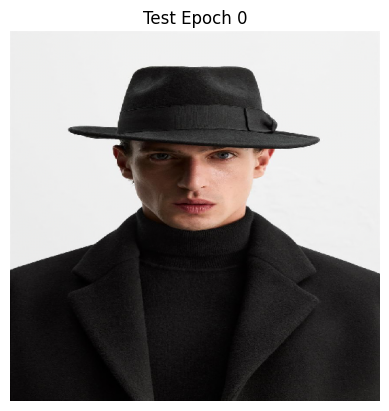

 10%|█         | 100/1000 [00:47<06:59,  2.15it/s]

Epoch 100, Total Loss: 1206.148071


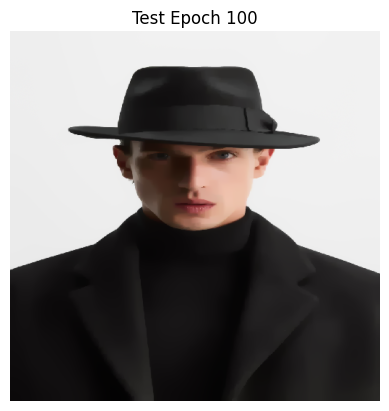

 20%|██        | 200/1000 [01:34<06:26,  2.07it/s]

Epoch 200, Total Loss: 1059.770752


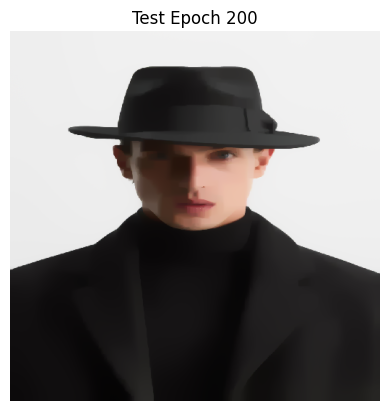

 30%|███       | 300/1000 [02:21<05:26,  2.15it/s]

Epoch 300, Total Loss: 980.005371


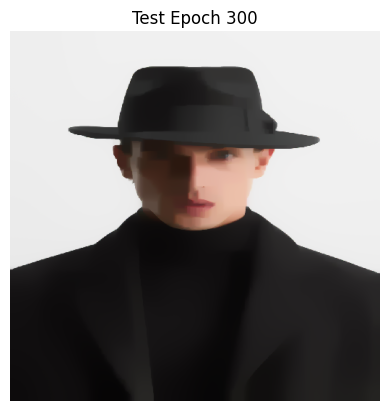

 40%|████      | 400/1000 [03:08<04:38,  2.15it/s]

Epoch 400, Total Loss: 928.216614


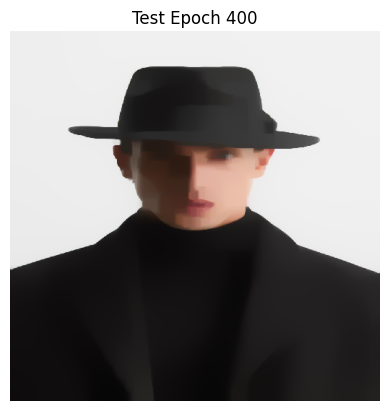

 50%|█████     | 500/1000 [03:55<03:55,  2.13it/s]

Epoch 500, Total Loss: 894.655823


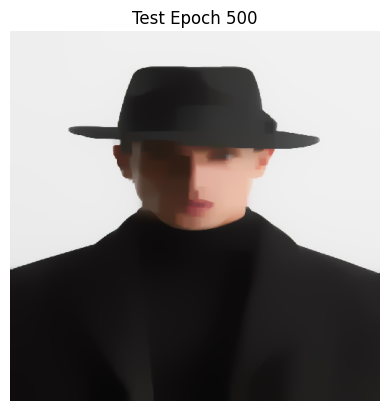

 60%|██████    | 600/1000 [04:42<03:11,  2.09it/s]

Epoch 600, Total Loss: 870.133118


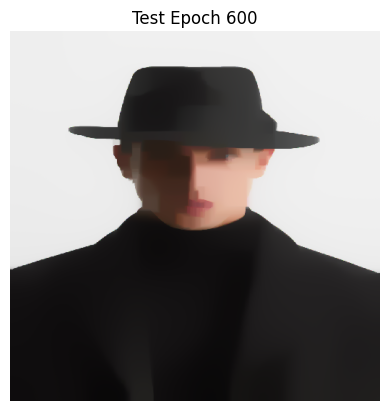

 70%|███████   | 700/1000 [05:29<02:20,  2.14it/s]

Epoch 700, Total Loss: 850.655579


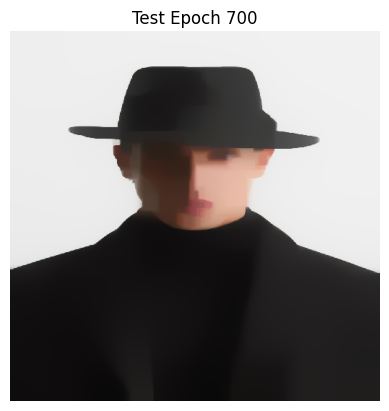

 80%|████████  | 800/1000 [06:17<01:33,  2.15it/s]

Epoch 800, Total Loss: 834.988037


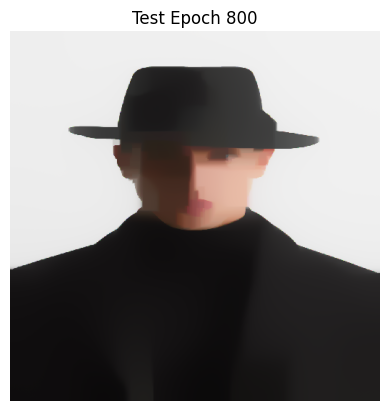

 90%|█████████ | 900/1000 [07:04<00:46,  2.13it/s]

Epoch 900, Total Loss: 822.008057


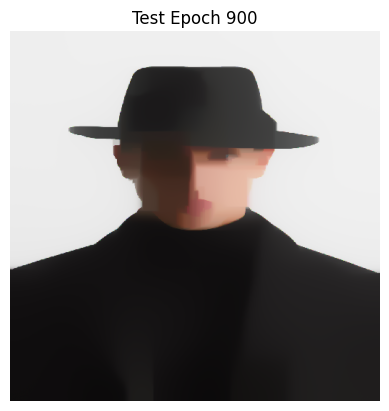

100%|█████████▉| 999/1000 [07:50<00:00,  2.10it/s]

Epoch 999, Total Loss: 811.264160


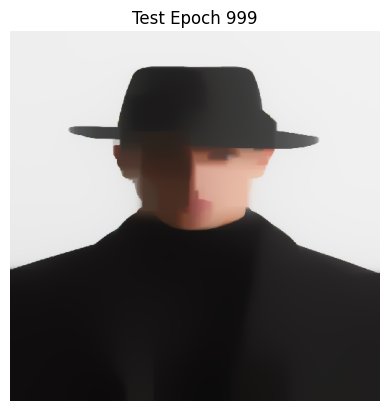

100%|██████████| 1000/1000 [07:51<00:00,  2.12it/s]

Test image with residual connection saved successfully!


In [ ]:
from tensorflow.keras.models import load_model

# Muat model dengan Self-Attention
nst_model_with_residuals = load_model(
    '/content/nst_model_with_residuals.h5',
)

# Upload Testing Content dan Style Images
print("Upload Testing Content Image")
test_content_path = upload_image()
print("Upload Testing Style Image")
test_style_path = upload_image()

# Preprocess gambar
test_content_image = preprocess_image(test_content_path)
test_style_image = preprocess_image(test_style_path)

# Inisialisasi gambar hasil
generated_image = tf.Variable(test_content_image)

# Optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

# Testing loop
epochs = 1000
for epoch in tqdm(range(epochs)):
    with tf.GradientTape() as tape:
        total_loss = compute_loss(test_content_image, test_style_image, generated_image, nst_model_with_residuals)

    gradients = tape.gradient(total_loss, [generated_image])
    optimizer.apply_gradients(zip(gradients, [generated_image]))

    if epoch % 100 == 0 or epoch == epochs - 1:
        print(f"Epoch {epoch}, Total Loss: {float(total_loss.numpy()):.6f}")
        temp_image = deprocess_image(generated_image)
        plt.imshow(temp_image)
        plt.title(f"Test Epoch {epoch}")
        plt.axis('off')
        plt.show()

# Simpan hasil
final_test_image = deprocess_image(generated_image)
tf.keras.preprocessing.image.save_img("/content/test_stylized_image_with_residuals.jpg", final_test_image)

print("Test image with residual connection saved successfully!")


model 3 =

multisclae

In [ ]:
def create_nst_model_with_multiscale():
    inputs = layers.Input(shape=(512, 512, 3))

    # Multi-scale convolutions
    scale_1 = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(inputs)
    scale_2 = layers.Conv2D(64, (5, 5), padding='same', activation='relu')(inputs)
    scale_3 = layers.Conv2D(64, (7, 7), padding='same', activation='relu')(inputs)

    # Menggabungkan semua skala
    x = layers.Concatenate()([scale_1, scale_2, scale_3])

    x = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = layers.MaxPooling2D((2, 2))(x)

    x = layers.Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = layers.MaxPooling2D((2, 2))(x)

    x = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = layers.UpSampling2D((2, 2))(x)
    x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid')(x)

    return models.Model(inputs, x)

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 512, 512, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_36 (Conv2D)        │ (None, 512, 512, 64)   │          1,792 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_37 (Conv2D)        │ (None, 512, 512, 64)   │          4,864 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_38 (Conv2D)        │ (None, 512, 512, 64)   │          9,472 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 512, 512, 192)  │              0 │ conv2d_36[0][0],       │
│                           │                        │                │ conv2d_37[0][0],       │
│                           │                        │                │ conv2d_38[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_39 (Conv2D)        │ (None, 512, 512, 128)  │        221,312 │ concatenate[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_8           │ (None, 256, 256, 128)  │              0 │ conv2d_39[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_40 (Conv2D)        │ (None, 256, 256, 256)  │        295,168 │ max_pooling2d_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_9           │ (None, 128, 128, 256)  │              0 │ conv2d_40[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_41 (Conv2D)        │ (None, 128, 128, 128)  │        295,040 │ max_pooling2d_9[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_8           │ (None, 256, 256, 128)  │              0 │ conv2d_41[0][0]        │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_42 (Conv2D)        │ (None, 256, 256, 64)   │         73,792 │ up_sampling2d_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_43 (Conv2D)        │ (None, 256, 256, 3)    │          1,731 │ conv2d_42[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 903,171 (3.45 MB)

 Trainable params: 903,171 (3.45 MB)

 Non-trainable params: 0 (0.00 B)

  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch 0, Total Loss: 10463.704102


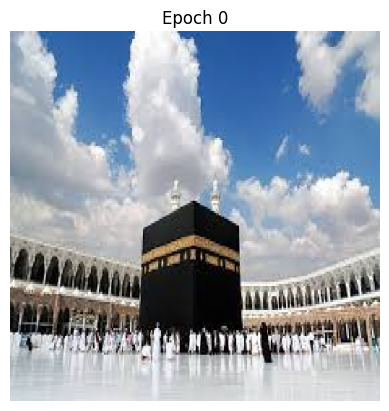

 10%|█         | 100/1000 [01:58<17:20,  1.16s/it]

Epoch 100, Total Loss: 5623.789062


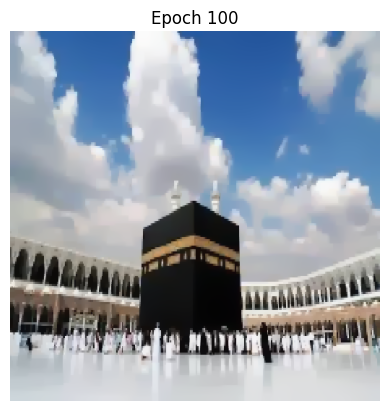

 20%|██        | 200/1000 [03:53<15:20,  1.15s/it]

Epoch 200, Total Loss: 4282.240723


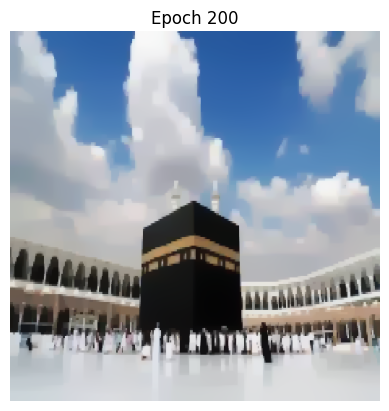

 30%|███       | 300/1000 [05:48<13:21,  1.14s/it]

Epoch 300, Total Loss: 3541.395020


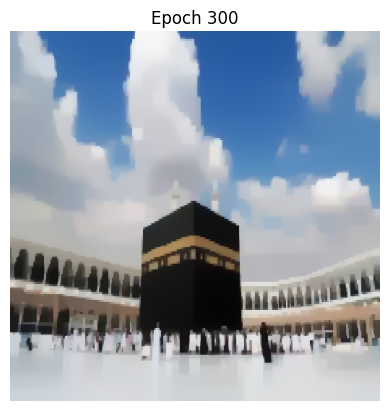

 40%|████      | 400/1000 [07:44<11:27,  1.15s/it]

Epoch 400, Total Loss: 3041.284424


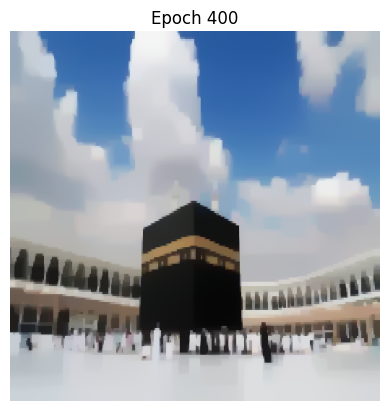

 50%|█████     | 500/1000 [09:39<09:32,  1.15s/it]

Epoch 500, Total Loss: 2674.361572


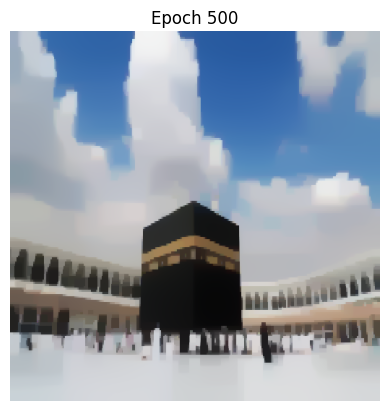

 60%|██████    | 600/1000 [11:34<07:35,  1.14s/it]

Epoch 600, Total Loss: 2395.394043


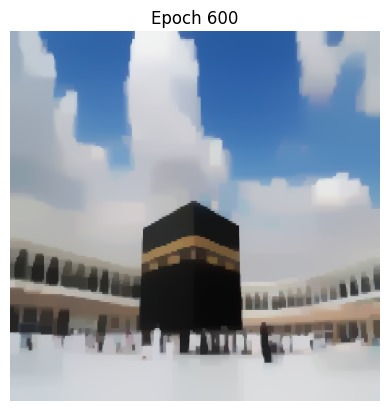

 70%|███████   | 700/1000 [13:28<05:41,  1.14s/it]

Epoch 700, Total Loss: 2181.099365


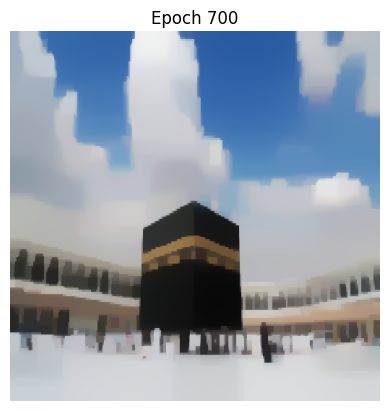

 80%|████████  | 800/1000 [15:23<03:48,  1.14s/it]

Epoch 800, Total Loss: 2011.920166


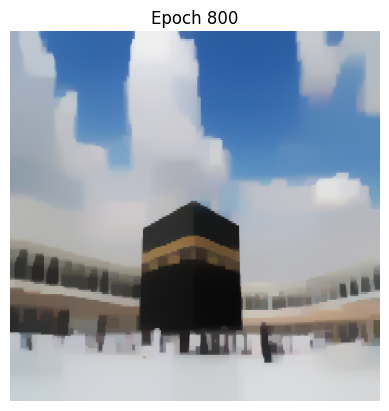

 90%|█████████ | 900/1000 [17:17<01:54,  1.14s/it]

Epoch 900, Total Loss: 1875.273926


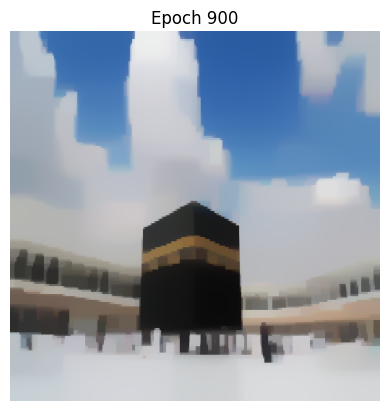

100%|█████████▉| 999/1000 [19:12<00:01,  1.14s/it]

Epoch 999, Total Loss: 1765.399902


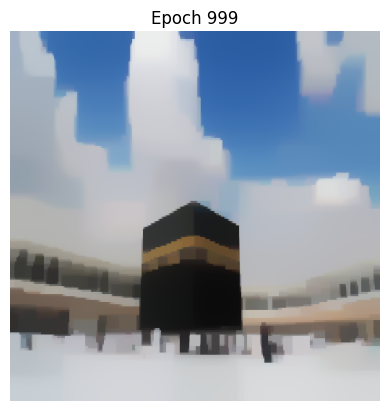

100%|██████████| 1000/1000 [19:13<00:00,  1.15s/it]


Model with multi-scale convolutions saved successfully!


In [ ]:
# Membuat model multi-scale
nst_model_with_multiscale = create_nst_model_with_multiscale()
nst_model_with_multiscale.summary()

# Training menggunakan model multi-scale
output_images_batch = train_nst_batch(content_images, style_images, nst_model_with_multiscale, epochs=1000, lr=0.001)

# Simpan model
nst_model_with_multiscale.save('/content/nst_model_with_multiscale.h5')
print("Model with multi-scale convolutions saved successfully!")


Upload Testing Content Image


Saving 09967300800-a1.jpg to 09967300800-a1 (1).jpg
Upload Testing Style Image


Saving images.jpg to images (4).jpg


  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch 0, Total Loss: 4169.328125


<ipython-input-18-1413a2ac564c>:31: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  total_loss_value = float(total_loss.numpy())  # Pastikan loss dalam bentuk scalar


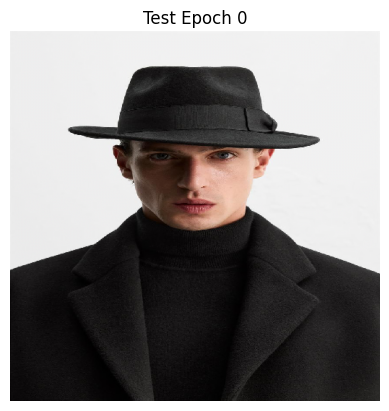

 10%|█         | 100/1000 [00:57<08:29,  1.77it/s]

Epoch 100, Total Loss: 1205.901001


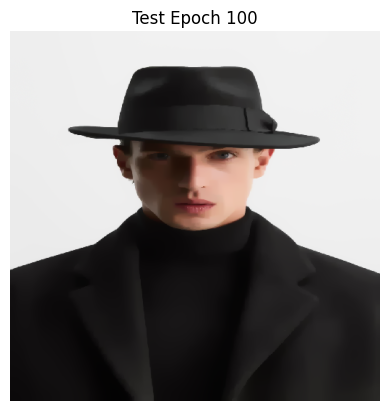

 20%|██        | 200/1000 [01:55<07:38,  1.75it/s]

Epoch 200, Total Loss: 1059.609985


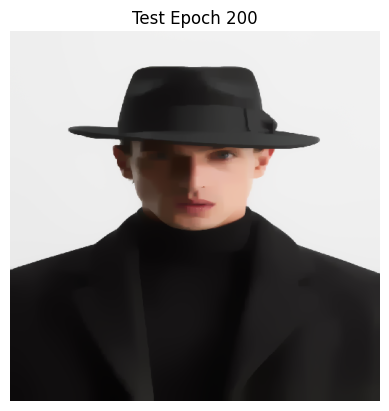

 30%|███       | 300/1000 [02:52<06:40,  1.75it/s]

Epoch 300, Total Loss: 979.737366


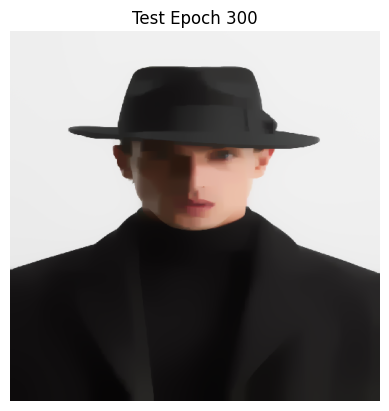

 40%|████      | 400/1000 [03:50<05:42,  1.75it/s]

Epoch 400, Total Loss: 928.044006


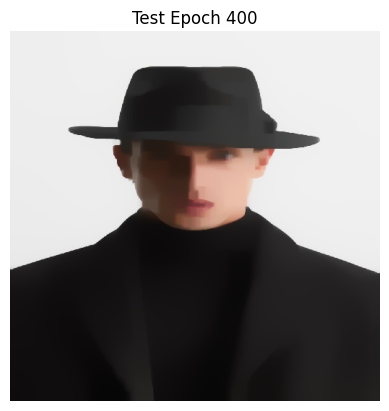

 50%|█████     | 500/1000 [04:47<04:43,  1.76it/s]

Epoch 500, Total Loss: 894.399597


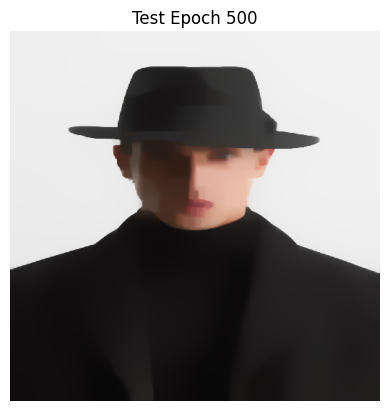

 60%|██████    | 600/1000 [05:45<03:48,  1.75it/s]

Epoch 600, Total Loss: 869.868408


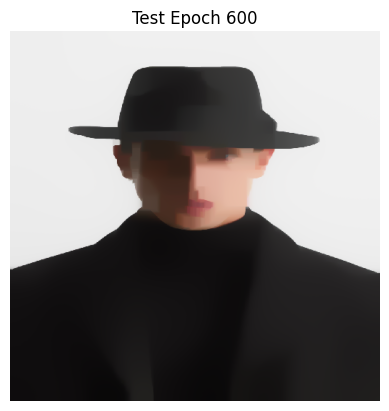

 70%|███████   | 700/1000 [06:42<02:51,  1.75it/s]

Epoch 700, Total Loss: 850.528809


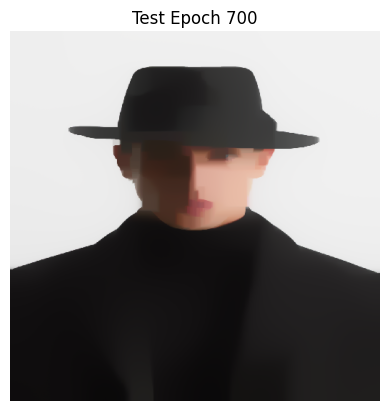

 80%|████████  | 800/1000 [07:40<01:54,  1.74it/s]

Epoch 800, Total Loss: 834.706604


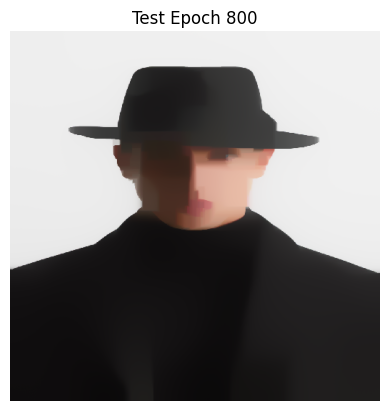

 90%|█████████ | 900/1000 [08:37<00:56,  1.77it/s]

Epoch 900, Total Loss: 821.806702


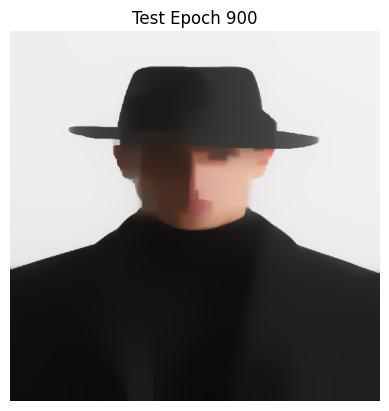

100%|█████████▉| 999/1000 [09:34<00:00,  1.74it/s]

Epoch 999, Total Loss: 811.047607


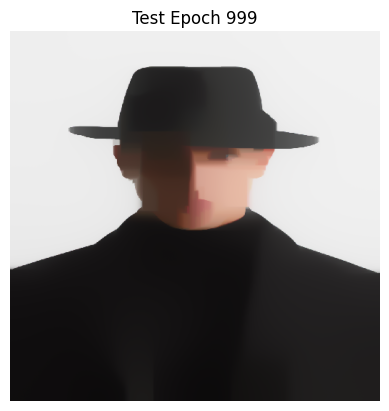

100%|██████████| 1000/1000 [09:35<00:00,  1.74it/s]


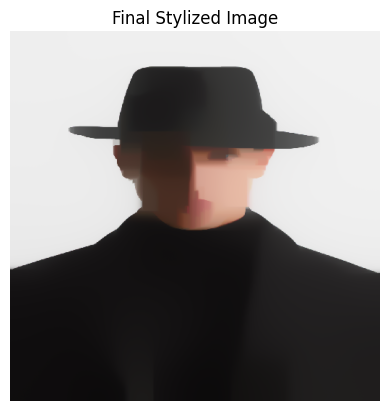

Testing image saved successfully!


In [ ]:
# Muat model multi-scale yang telah dilatih
from tensorflow.keras.models import load_model
nst_model_with_multiscale = load_model('/content/nst_model_with_multiscale.h5')

# Upload Content dan Style Images untuk testing
print("Upload Testing Content Image")
test_content_path = upload_image()
print("Upload Testing Style Image")
test_style_path = upload_image()

# Preprocess gambar
test_content_image = preprocess_image(test_content_path)
test_style_image = preprocess_image(test_style_path)

# Variable untuk gambar yang dihasilkan
generated_image = tf.Variable(test_content_image)

# Optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

# Testing loop
epochs = 1000  # Jumlah epoch lebih kecil untuk testing
for epoch in tqdm(range(epochs)):
    with tf.GradientTape() as tape:
        total_loss = compute_loss(test_content_image, test_style_image, generated_image, nst_model_with_multiscale)

    gradients = tape.gradient(total_loss, [generated_image])
    optimizer.apply_gradients(zip(gradients, [generated_image]))

    if epoch % 100 == 0 or epoch == epochs - 1:
        total_loss_value = float(total_loss.numpy())  # Pastikan loss dalam bentuk scalar
        print(f"Epoch {epoch}, Total Loss: {total_loss_value:.6f}")

        # Visualisasi hasil sementara
        temp_image = deprocess_image(generated_image)
        plt.imshow(temp_image)
        plt.title(f"Test Epoch {epoch}")
        plt.axis('off')
        plt.show()

# Simpan hasil akhir
final_image = deprocess_image(generated_image)
plt.imshow(final_image)
plt.title("Final Stylized Image")
plt.axis('off')
plt.show()

tf.keras.preprocessing.image.save_img('/content/final_test_stylized_image_multiscale.jpg', final_image)
print("Testing image saved successfully!")


# Dibawah ini merupakan percobaan menggunakan model lainnya (Trial and Error)

model 4= global context module

In [ ]:
# def create_nst_model_with_separable(input_size=(512, 512, 3)):
#     inputs = layers.Input(shape=input_size)
#     x = layers.SeparableConv2D(64, (3, 3), padding='same', activation='relu')(inputs)
#     x = layers.SeparableConv2D(64, (3, 3), padding='same', activation='relu')(x)
#     x = layers.MaxPooling2D((2, 2))(x)

#     x = layers.SeparableConv2D(128, (3, 3), padding='same', activation='relu')(x)
#     x = layers.SeparableConv2D(128, (3, 3), padding='same', activation='relu')(x)

#     x = layers.SeparableConv2D(256, (3, 3), padding='same', activation='relu')(x)
#     x = layers.UpSampling2D((2, 2))(x)
#     x = layers.SeparableConv2D(128, (3, 3), padding='same', activation='relu')(x)
#     x = layers.UpSampling2D((2, 2))(x)
#     x = layers.SeparableConv2D(64, (3, 3), padding='same', activation='relu')(x)
#     x = layers.SeparableConv2D(3, (3, 3), padding='same', activation='sigmoid')(x)

#     return models.Model(inputs, x)

# # Buat model dengan Separable Convolutions
# nst_model_with_separable = create_nst_model_with_separable(input_size=(512, 512, 3))
# nst_model_with_separable.summary()


Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_8 (InputLayer)           │ (None, 512, 512, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_8 (SeparableConv2D) │ (None, 512, 512, 64)        │             283 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_9 (SeparableConv2D) │ (None, 512, 512, 64)        │           4,736 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_13 (MaxPooling2D)      │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_10                  │ (None, 256, 256, 128)       │           8,896 │
│ (SeparableConv2D)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_11                  │ (None, 256, 256, 128)       │          17,664 │
│ (SeparableConv2D)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_12                  │ (None, 256, 256, 256)       │          34,176 │
│ (SeparableConv2D)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_19 (UpSampling2D)      │ (None, 512, 512, 256)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_13                  │ (None, 512, 512, 128)       │          35,200 │
│ (SeparableConv2D)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_20 (UpSampling2D)      │ (None, 1024, 1024, 128)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_14                  │ (None, 1024, 1024, 64)      │           9,408 │
│ (SeparableConv2D)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_15                  │ (None, 1024, 1024, 3)       │             771 │
│ (SeparableConv2D)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 111,134 (434.12 KB)

 Trainable params: 111,134 (434.12 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:

# # Training menggunakan model gc
# output_images_batch = train_nst_batch(content_images, style_images, nst_model_with_separable, epochs=1000, lr=0.001)

# # Simpan model
# nst_model_with_separable.save('/content/nst_model_with_separable.h5')
# print("Model with ppm saved successfully!")


  0%|          | 0/1000 [00:00<?, ?it/s]


ValueError: Input 0 of layer "functional_8" is incompatible with the layer: expected shape=(None, 512, 512, 3), found shape=(1, 256, 256, 3)

In [ ]:
# # Muat model multi-scale yang telah dilatih
# from tensorflow.keras.models import load_model
# nst_model_with_ppm = load_model('/content/nst_model_with_ppm.h5')

# # Upload Content dan Style Images untuk testing
# print("Upload Testing Content Image")
# test_content_path = upload_image()
# print("Upload Testing Style Image")
# test_style_path = upload_image()

# # Preprocess gambar
# test_content_image = preprocess_image(test_content_path)
# test_style_image = preprocess_image(test_style_path)

# # Variable untuk gambar yang dihasilkan
# generated_image = tf.Variable(test_content_image)

# # Optimizer
# optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

# # Testing loop
# epochs = 1000  # Jumlah epoch lebih kecil untuk testing
# for epoch in tqdm(range(epochs)):
#     with tf.GradientTape() as tape:
#         total_loss = compute_loss(test_content_image, test_style_image, generated_image, nst_model_with_ppm)

#     gradients = tape.gradient(total_loss, [generated_image])
#     optimizer.apply_gradients(zip(gradients, [generated_image]))

#     if epoch % 100 == 0 or epoch == epochs - 1:
#         total_loss_value = float(total_loss.numpy())  # Pastikan loss dalam bentuk scalar
#         print(f"Epoch {epoch}, Total Loss: {total_loss_value:.6f}")

#         # Visualisasi hasil sementara
#         temp_image = deprocess_image(generated_image)
#         plt.imshow(temp_image)
#         plt.title(f"Test Epoch {epoch}")
#         plt.axis('off')
#         plt.show()

# # Simpan hasil akhir
# final_image = deprocess_image(generated_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# tf.keras.preprocessing.image.save_img('/content/final_test_stylized_image_ppm.jpg', final_image)
# print("Testing image saved successfully!")


In [ ]:
# # Upload content dan style images
# print("Upload Content Image")
# content_image_path = upload_image()
# print("Upload Style Image")
# style_image_path = upload_image()

# # Preprocess images
# content_image = preprocess_image(content_image_path)
# style_image = preprocess_image(style_image_path)

# # Sebelum training
# start_time = time.time()

# # Train model dengan dynamic weighting
# output_image = train_nst(content_image, style_image, nst_model, epochs=1500, lr=0.001)

# # Setelah training
# end_time = time.time()

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# tf.keras.preprocessing.image.save_img("/content/final_stylized_image.jpg", final_image)


Upload Content Image


Saving istockphoto-470755508-612x612.jpg to istockphoto-470755508-612x612 (2).jpg
Upload Style Image


Saving lukisan-pablo-picassso.jpg to lukisan-pablo-picassso (2).jpg


  0%|          | 0/1500 [00:00<?, ?it/s]

Inside compute_loss:
Content Loss: 0.0, Style Loss: 1.1733524161172681e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [3626.6165], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 0, Loss: 3626.616455, Alpha: 10.0000, Beta: 10.0000


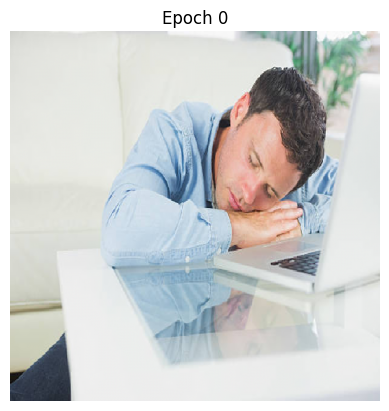

  0%|          | 2/1500 [00:01<11:45,  2.12it/s]

Inside compute_loss:
Content Loss: 3.1505881237237077e-11, Style Loss: 1.1708593774528708e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 3/1500 [00:01<11:17,  2.21it/s]

Inside compute_loss:
Content Loss: 1.0720260096297451e-10, Style Loss: 1.1702504707500339e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 4/1500 [00:01<11:12,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1044987974505602e-10, Style Loss: 1.1685050367304939e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 5/1500 [00:02<11:09,  2.23it/s]

Inside compute_loss:
Content Loss: 3.375037194164321e-10, Style Loss: 1.1663821624097181e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 6/1500 [00:02<11:03,  2.25it/s]

Inside compute_loss:
Content Loss: 4.917055096420597e-10, Style Loss: 1.164504510597908e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 7/1500 [00:03<11:01,  2.26it/s]

Inside compute_loss:
Content Loss: 6.670384244955585e-10, Style Loss: 1.1629056189121911e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 8/1500 [00:03<11:00,  2.26it/s]

Inside compute_loss:
Content Loss: 8.593283307156696e-10, Style Loss: 1.1614033610385377e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 9/1500 [00:04<11:01,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0668935734869933e-09, Style Loss: 1.16000660455029e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 10/1500 [00:04<10:55,  2.27it/s]

Inside compute_loss:
Content Loss: 1.2900859269748821e-09, Style Loss: 1.1586776054173242e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 11/1500 [00:04<10:54,  2.28it/s]

Inside compute_loss:
Content Loss: 1.528249859994446e-09, Style Loss: 1.1573933988984209e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 12/1500 [00:05<10:52,  2.28it/s]

Inside compute_loss:
Content Loss: 1.7787469275276635e-09, Style Loss: 1.1561937753867824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 13/1500 [00:05<10:52,  2.28it/s]

Inside compute_loss:
Content Loss: 2.039928892472176e-09, Style Loss: 1.1549853979886393e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 14/1500 [00:06<10:52,  2.28it/s]

Inside compute_loss:
Content Loss: 2.3116637493103553e-09, Style Loss: 1.1538610351635725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 15/1500 [00:06<10:52,  2.28it/s]

Inside compute_loss:
Content Loss: 2.5934099312507897e-09, Style Loss: 1.152744744103984e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 16/1500 [00:07<10:59,  2.25it/s]

Inside compute_loss:
Content Loss: 2.8839461929663912e-09, Style Loss: 1.151664605458791e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 17/1500 [00:07<10:51,  2.28it/s]

Inside compute_loss:
Content Loss: 3.1829545665829073e-09, Style Loss: 1.1506311921039014e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 18/1500 [00:08<11:02,  2.24it/s]

Inside compute_loss:
Content Loss: 3.4897940093259194e-09, Style Loss: 1.1496043725855998e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 19/1500 [00:08<11:03,  2.23it/s]

Inside compute_loss:
Content Loss: 3.80402687127912e-09, Style Loss: 1.1486076800792944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 20/1500 [00:08<11:02,  2.24it/s]

Inside compute_loss:
Content Loss: 4.124087293888579e-09, Style Loss: 1.1476316785774543e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 21/1500 [00:09<11:14,  2.19it/s]

Inside compute_loss:
Content Loss: 4.448325707784306e-09, Style Loss: 1.1467132026155014e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 22/1500 [00:09<11:13,  2.19it/s]

Inside compute_loss:
Content Loss: 4.777563678004526e-09, Style Loss: 1.1457889286248246e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 23/1500 [00:10<11:02,  2.23it/s]

Inside compute_loss:
Content Loss: 5.112248402383557e-09, Style Loss: 1.1448935310909292e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 24/1500 [00:10<10:56,  2.25it/s]

Inside compute_loss:
Content Loss: 5.452236440106617e-09, Style Loss: 1.1440154139563674e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 25/1500 [00:11<10:55,  2.25it/s]

Inside compute_loss:
Content Loss: 5.796135127411617e-09, Style Loss: 1.1431483244450646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 26/1500 [00:11<10:53,  2.26it/s]

Inside compute_loss:
Content Loss: 6.14413986355089e-09, Style Loss: 1.1423188652770477e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 27/1500 [00:12<10:52,  2.26it/s]

Inside compute_loss:
Content Loss: 6.4966272361743904e-09, Style Loss: 1.1414879281801404e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 28/1500 [00:12<10:53,  2.25it/s]

Inside compute_loss:
Content Loss: 6.853149159269378e-09, Style Loss: 1.1406700650695711e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 29/1500 [00:12<10:51,  2.26it/s]

Inside compute_loss:
Content Loss: 7.2128361061629676e-09, Style Loss: 1.1399099548725644e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 30/1500 [00:13<10:52,  2.25it/s]

Inside compute_loss:
Content Loss: 7.577027005822856e-09, Style Loss: 1.1391236967028817e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 31/1500 [00:13<10:51,  2.26it/s]

Inside compute_loss:
Content Loss: 7.943554258815766e-09, Style Loss: 1.1383740456949454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 32/1500 [00:14<10:52,  2.25it/s]

Inside compute_loss:
Content Loss: 8.31359336928017e-09, Style Loss: 1.1376371276128339e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 33/1500 [00:14<10:49,  2.26it/s]

Inside compute_loss:
Content Loss: 8.686470209795516e-09, Style Loss: 1.1368769037289894e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 34/1500 [00:15<10:49,  2.26it/s]

Inside compute_loss:
Content Loss: 9.061913885943795e-09, Style Loss: 1.136159994530317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 35/1500 [00:15<10:50,  2.25it/s]

Inside compute_loss:
Content Loss: 9.439586001747102e-09, Style Loss: 1.1354574098731973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 36/1500 [00:16<10:48,  2.26it/s]

Inside compute_loss:
Content Loss: 9.820371182911458e-09, Style Loss: 1.134770627686521e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 37/1500 [00:16<10:49,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0203524247742735e-08, Style Loss: 1.1340795254000113e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 38/1500 [00:16<10:48,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0589503496305497e-08, Style Loss: 1.1334315104249981e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 39/1500 [00:17<10:49,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0976688891162212e-08, Style Loss: 1.1327758784318576e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 40/1500 [00:17<10:49,  2.25it/s]

Inside compute_loss:
Content Loss: 1.1365096419524434e-08, Style Loss: 1.1321095598759712e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 41/1500 [00:18<10:50,  2.24it/s]

Inside compute_loss:
Content Loss: 1.175470742964535e-08, Style Loss: 1.1314846233290154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 42/1500 [00:18<10:49,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2146062822182557e-08, Style Loss: 1.1308643479424063e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 43/1500 [00:19<10:50,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2537999971584668e-08, Style Loss: 1.1302353186692926e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 44/1500 [00:19<10:49,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2930804871302826e-08, Style Loss: 1.1296449429210043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 45/1500 [00:20<10:55,  2.22it/s]

Inside compute_loss:
Content Loss: 1.3324718217688769e-08, Style Loss: 1.1290595693935757e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 46/1500 [00:20<10:58,  2.21it/s]

Inside compute_loss:
Content Loss: 1.3719966496239522e-08, Style Loss: 1.1284624861218617e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 47/1500 [00:21<10:59,  2.20it/s]

Inside compute_loss:
Content Loss: 1.411561090236546e-08, Style Loss: 1.1278930287517142e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 48/1500 [00:21<11:04,  2.19it/s]

Inside compute_loss:
Content Loss: 1.451158038179301e-08, Style Loss: 1.1273136806266848e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 49/1500 [00:21<11:08,  2.17it/s]

Inside compute_loss:
Content Loss: 1.4907969969613077e-08, Style Loss: 1.1267521813351777e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 50/1500 [00:22<11:13,  2.15it/s]

Inside compute_loss:
Content Loss: 1.5304408407246228e-08, Style Loss: 1.1261898862358066e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 51/1500 [00:22<11:00,  2.19it/s]

Inside compute_loss:
Content Loss: 1.570087171387513e-08, Style Loss: 1.125644985222607e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 52/1500 [00:23<10:57,  2.20it/s]

Inside compute_loss:
Content Loss: 1.6097738253506577e-08, Style Loss: 1.1251224805164384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 53/1500 [00:23<10:55,  2.21it/s]

Inside compute_loss:
Content Loss: 1.6494359655894186e-08, Style Loss: 1.1246088433836121e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 54/1500 [00:24<10:53,  2.21it/s]

Inside compute_loss:
Content Loss: 1.6891252840878224e-08, Style Loss: 1.1240883850405226e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 55/1500 [00:24<10:52,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7288366294110347e-08, Style Loss: 1.1235738384129945e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 56/1500 [00:25<10:49,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7687483477857313e-08, Style Loss: 1.1230736163270194e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 57/1500 [00:25<10:49,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8088302411456425e-08, Style Loss: 1.1225697562622372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 58/1500 [00:26<10:48,  2.22it/s]

Inside compute_loss:
Content Loss: 1.849080355498245e-08, Style Loss: 1.1220613487239461e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 59/1500 [00:26<10:49,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8893240749662255e-08, Style Loss: 1.1215761333005503e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 60/1500 [00:26<10:48,  2.22it/s]

Inside compute_loss:
Content Loss: 1.9295599784641126e-08, Style Loss: 1.1210863704036456e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 61/1500 [00:27<10:49,  2.22it/s]

Inside compute_loss:
Content Loss: 1.9696789976819673e-08, Style Loss: 1.1205958116988768e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 62/1500 [00:27<10:48,  2.22it/s]

Inside compute_loss:
Content Loss: 2.0097198571988883e-08, Style Loss: 1.1201276493011392e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 63/1500 [00:28<10:47,  2.22it/s]

Inside compute_loss:
Content Loss: 2.049767822143167e-08, Style Loss: 1.1196859759365907e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 64/1500 [00:28<10:51,  2.21it/s]

Inside compute_loss:
Content Loss: 2.0896502306300135e-08, Style Loss: 1.1191934845555807e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 65/1500 [00:29<10:45,  2.22it/s]

Inside compute_loss:
Content Loss: 2.129423215535553e-08, Style Loss: 1.1187615882590762e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 66/1500 [00:29<10:45,  2.22it/s]

Inside compute_loss:
Content Loss: 2.169112178762589e-08, Style Loss: 1.1183053629792994e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 67/1500 [00:30<10:44,  2.22it/s]

Inside compute_loss:
Content Loss: 2.208776805900925e-08, Style Loss: 1.1178797194588697e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 68/1500 [00:30<10:46,  2.22it/s]

Inside compute_loss:
Content Loss: 2.2483183315102906e-08, Style Loss: 1.117439751396887e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 69/1500 [00:30<10:45,  2.22it/s]

Inside compute_loss:
Content Loss: 2.2879044436763252e-08, Style Loss: 1.1169915978825884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 70/1500 [00:31<10:44,  2.22it/s]

Inside compute_loss:
Content Loss: 2.327486647857313e-08, Style Loss: 1.1165755040565273e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 71/1500 [00:31<10:44,  2.22it/s]

Inside compute_loss:
Content Loss: 2.3669985083074607e-08, Style Loss: 1.1161552038174705e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 72/1500 [00:32<10:44,  2.21it/s]

Inside compute_loss:
Content Loss: 2.4064512160748563e-08, Style Loss: 1.1157234212078038e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 73/1500 [00:32<10:58,  2.17it/s]

Inside compute_loss:
Content Loss: 2.4460504732815025e-08, Style Loss: 1.1153283594467212e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 74/1500 [00:33<10:53,  2.18it/s]

Inside compute_loss:
Content Loss: 2.4854813318597735e-08, Style Loss: 1.1149303418278578e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 75/1500 [00:33<10:53,  2.18it/s]

Inside compute_loss:
Content Loss: 2.5245684653896205e-08, Style Loss: 1.1145340295115602e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 76/1500 [00:34<11:03,  2.15it/s]

Inside compute_loss:
Content Loss: 2.5635996436790265e-08, Style Loss: 1.1141243021484115e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 77/1500 [00:34<11:03,  2.14it/s]

Inside compute_loss:
Content Loss: 2.6024403965152487e-08, Style Loss: 1.1137548199258163e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 78/1500 [00:35<10:50,  2.19it/s]

Inside compute_loss:
Content Loss: 2.6411425935179977e-08, Style Loss: 1.1133691941722645e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 79/1500 [00:35<10:46,  2.20it/s]

Inside compute_loss:
Content Loss: 2.6797566832215125e-08, Style Loss: 1.1129878885185462e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 80/1500 [00:36<10:42,  2.21it/s]

Inside compute_loss:
Content Loss: 2.7183929773855198e-08, Style Loss: 1.1126085155410692e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 81/1500 [00:36<10:42,  2.21it/s]

Inside compute_loss:
Content Loss: 2.7570656868647347e-08, Style Loss: 1.1122546084152418e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 82/1500 [00:36<10:40,  2.22it/s]

Inside compute_loss:
Content Loss: 2.7957836934433544e-08, Style Loss: 1.1118610245830496e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 83/1500 [00:37<10:37,  2.22it/s]

Inside compute_loss:
Content Loss: 2.8345061409140726e-08, Style Loss: 1.1114963172076386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 84/1500 [00:37<10:36,  2.22it/s]

Inside compute_loss:
Content Loss: 2.873216153886915e-08, Style Loss: 1.1111201274616178e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 85/1500 [00:38<10:36,  2.22it/s]

Inside compute_loss:
Content Loss: 2.911876784139622e-08, Style Loss: 1.1107640602858737e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 86/1500 [00:38<10:36,  2.22it/s]

Inside compute_loss:
Content Loss: 2.95038642406098e-08, Style Loss: 1.1104096984126954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 87/1500 [00:39<10:34,  2.23it/s]

Inside compute_loss:
Content Loss: 2.988830871686332e-08, Style Loss: 1.1100760275439825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 88/1500 [00:39<10:32,  2.23it/s]

Inside compute_loss:
Content Loss: 3.027344774864105e-08, Style Loss: 1.1097296237494447e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 89/1500 [00:40<10:31,  2.24it/s]

Inside compute_loss:
Content Loss: 3.065811782221317e-08, Style Loss: 1.109360709961038e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 90/1500 [00:40<10:30,  2.24it/s]

Inside compute_loss:
Content Loss: 3.104185353208777e-08, Style Loss: 1.1090162388427416e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 91/1500 [00:40<10:28,  2.24it/s]

Inside compute_loss:
Content Loss: 3.142431381775168e-08, Style Loss: 1.1086608537880238e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 92/1500 [00:41<10:27,  2.24it/s]

Inside compute_loss:
Content Loss: 3.1805072353563446e-08, Style Loss: 1.1083403705924866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 93/1500 [00:41<10:25,  2.25it/s]

Inside compute_loss:
Content Loss: 3.218490718381872e-08, Style Loss: 1.1079969226557296e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 94/1500 [00:42<10:25,  2.25it/s]

Inside compute_loss:
Content Loss: 3.2564578589244775e-08, Style Loss: 1.107666776078986e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 95/1500 [00:42<10:33,  2.22it/s]

Inside compute_loss:
Content Loss: 3.2943312078259623e-08, Style Loss: 1.1073449286413961e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 96/1500 [00:43<10:36,  2.20it/s]

Inside compute_loss:
Content Loss: 3.33217222703297e-08, Style Loss: 1.107012508327898e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 97/1500 [00:43<10:33,  2.22it/s]

Inside compute_loss:
Content Loss: 3.370303502947536e-08, Style Loss: 1.1066963452321943e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 98/1500 [00:44<10:42,  2.18it/s]

Inside compute_loss:
Content Loss: 3.408223037126845e-08, Style Loss: 1.10637222405785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 99/1500 [00:44<10:41,  2.18it/s]

Inside compute_loss:
Content Loss: 3.4459674225217896e-08, Style Loss: 1.1060506039939355e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 100/1500 [00:45<10:37,  2.20it/s]

Inside compute_loss:
Content Loss: 3.483694754891076e-08, Style Loss: 1.1057524034185917e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.5211858318007216e-08, Style Loss: 1.1054315791625413e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [1557.7767], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 100, Loss: 1557.776733, Alpha: 10.0000, Beta: 10.0000


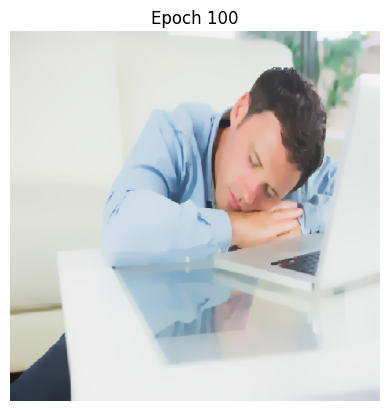

  7%|▋         | 102/1500 [00:46<11:35,  2.01it/s]

Inside compute_loss:
Content Loss: 3.558441008522095e-08, Style Loss: 1.105115643440513e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 103/1500 [00:46<11:21,  2.05it/s]

Inside compute_loss:
Content Loss: 3.595571840264711e-08, Style Loss: 1.1048196029150859e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.632662881614124e-08, Style Loss: 1.1045091241612681e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 105/1500 [00:47<10:50,  2.14it/s]

Inside compute_loss:
Content Loss: 3.669583392706954e-08, Style Loss: 1.1041948937418056e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 106/1500 [00:47<10:39,  2.18it/s]

Inside compute_loss:
Content Loss: 3.7063156099748085e-08, Style Loss: 1.1038926004403038e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 107/1500 [00:48<10:36,  2.19it/s]

Inside compute_loss:
Content Loss: 3.7429533250588065e-08, Style Loss: 1.1035989473384689e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 108/1500 [00:48<10:28,  2.21it/s]

Inside compute_loss:
Content Loss: 3.779453550123435e-08, Style Loss: 1.1033155260520289e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 109/1500 [00:49<10:29,  2.21it/s]

Inside compute_loss:
Content Loss: 3.81574487562375e-08, Style Loss: 1.1030268751710537e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 110/1500 [00:49<10:20,  2.24it/s]

Inside compute_loss:
Content Loss: 3.851885210792716e-08, Style Loss: 1.1027533446394955e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 111/1500 [00:50<10:17,  2.25it/s]

Inside compute_loss:
Content Loss: 3.887947741532116e-08, Style Loss: 1.10246969597938e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 112/1500 [00:50<10:16,  2.25it/s]

Inside compute_loss:
Content Loss: 3.9237999516217315e-08, Style Loss: 1.1021870705008041e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 113/1500 [00:51<10:14,  2.26it/s]

Inside compute_loss:
Content Loss: 3.9595430934014075e-08, Style Loss: 1.1018905752280261e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 114/1500 [00:51<10:12,  2.26it/s]

Inside compute_loss:
Content Loss: 3.9949966890162614e-08, Style Loss: 1.1016434200428193e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 115/1500 [00:51<10:10,  2.27it/s]

Inside compute_loss:
Content Loss: 4.0303188342249996e-08, Style Loss: 1.1013787570846034e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 116/1500 [00:52<10:10,  2.27it/s]

Inside compute_loss:
Content Loss: 4.065512371198565e-08, Style Loss: 1.10110249806894e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 117/1500 [00:52<10:10,  2.27it/s]

Inside compute_loss:
Content Loss: 4.1008579643175835e-08, Style Loss: 1.1008314686478116e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 118/1500 [00:53<10:09,  2.27it/s]

Inside compute_loss:
Content Loss: 4.136218834105421e-08, Style Loss: 1.1005660098817316e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 119/1500 [00:53<10:09,  2.27it/s]

Inside compute_loss:
Content Loss: 4.1715626508675996e-08, Style Loss: 1.100303279599757e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 120/1500 [00:54<10:08,  2.27it/s]

Inside compute_loss:
Content Loss: 4.206785675364699e-08, Style Loss: 1.1000211088685319e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 121/1500 [00:54<10:10,  2.26it/s]

Inside compute_loss:
Content Loss: 4.242052398240048e-08, Style Loss: 1.0997631534337415e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 122/1500 [00:55<10:08,  2.26it/s]

Inside compute_loss:
Content Loss: 4.27706225991642e-08, Style Loss: 1.0995050843121135e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 123/1500 [00:55<10:11,  2.25it/s]

Inside compute_loss:
Content Loss: 4.311655743549636e-08, Style Loss: 1.0992526995323715e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 124/1500 [00:55<10:09,  2.26it/s]

Inside compute_loss:
Content Loss: 4.3460858023536275e-08, Style Loss: 1.099000542126305e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 125/1500 [00:56<10:06,  2.27it/s]

Inside compute_loss:
Content Loss: 4.38028102678345e-08, Style Loss: 1.0987578207277693e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 126/1500 [00:56<10:06,  2.27it/s]

Inside compute_loss:
Content Loss: 4.414431842292288e-08, Style Loss: 1.0985003200403298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 127/1500 [00:57<10:12,  2.24it/s]

Inside compute_loss:
Content Loss: 4.448445167781756e-08, Style Loss: 1.098265443033597e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 128/1500 [00:57<10:12,  2.24it/s]

Inside compute_loss:
Content Loss: 4.482465598698582e-08, Style Loss: 1.098001575883245e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 129/1500 [00:58<10:11,  2.24it/s]

Inside compute_loss:
Content Loss: 4.51640183030122e-08, Style Loss: 1.0977571491821436e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 130/1500 [00:58<10:19,  2.21it/s]

Inside compute_loss:
Content Loss: 4.550237875378116e-08, Style Loss: 1.0975086297548842e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 131/1500 [00:59<10:20,  2.21it/s]

Inside compute_loss:
Content Loss: 4.584063972856711e-08, Style Loss: 1.0972852351187612e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 132/1500 [00:59<10:21,  2.20it/s]

Inside compute_loss:
Content Loss: 4.617926663286198e-08, Style Loss: 1.0970646826535813e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 133/1500 [00:59<10:07,  2.25it/s]

Inside compute_loss:
Content Loss: 4.6517765639464415e-08, Style Loss: 1.09680627247144e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 134/1500 [01:00<10:05,  2.25it/s]

Inside compute_loss:
Content Loss: 4.6854225388415216e-08, Style Loss: 1.09658572000626e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 135/1500 [01:00<10:03,  2.26it/s]

Inside compute_loss:
Content Loss: 4.7189804064373675e-08, Style Loss: 1.0963457270918298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 136/1500 [01:01<10:02,  2.26it/s]

Inside compute_loss:
Content Loss: 4.752612881020468e-08, Style Loss: 1.0960915233226842e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 137/1500 [01:01<10:02,  2.26it/s]

Inside compute_loss:
Content Loss: 4.7863654373259124e-08, Style Loss: 1.0958724487863947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 138/1500 [01:02<10:00,  2.27it/s]

Inside compute_loss:
Content Loss: 4.819992582838495e-08, Style Loss: 1.0956066489598015e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 139/1500 [01:02<09:58,  2.27it/s]

Inside compute_loss:
Content Loss: 4.853528068338164e-08, Style Loss: 1.0953962146231788e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 140/1500 [01:03<09:58,  2.27it/s]

Inside compute_loss:
Content Loss: 4.886803139925178e-08, Style Loss: 1.0951819149340736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 141/1500 [01:03<10:00,  2.26it/s]

Inside compute_loss:
Content Loss: 4.919945695291972e-08, Style Loss: 1.094948515856231e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 142/1500 [01:03<09:57,  2.27it/s]

Inside compute_loss:
Content Loss: 4.953013998942879e-08, Style Loss: 1.0947343298539636e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 143/1500 [01:04<09:56,  2.28it/s]

Inside compute_loss:
Content Loss: 4.9857849404588706e-08, Style Loss: 1.0945225312752882e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 144/1500 [01:04<09:56,  2.27it/s]

Inside compute_loss:
Content Loss: 5.0184926436713795e-08, Style Loss: 1.0942703738692217e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 145/1500 [01:05<09:55,  2.28it/s]

Inside compute_loss:
Content Loss: 5.0513691007836314e-08, Style Loss: 1.0940802894765511e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 146/1500 [01:05<09:53,  2.28it/s]

Inside compute_loss:
Content Loss: 5.084196175175748e-08, Style Loss: 1.0938460945908446e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 147/1500 [01:06<09:53,  2.28it/s]

Inside compute_loss:
Content Loss: 5.116823231787748e-08, Style Loss: 1.093638843485678e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 148/1500 [01:06<09:53,  2.28it/s]

Inside compute_loss:
Content Loss: 5.149606252530248e-08, Style Loss: 1.0934234069281956e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 149/1500 [01:07<09:53,  2.28it/s]

Inside compute_loss:
Content Loss: 5.182016593607841e-08, Style Loss: 1.0932074019365245e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 150/1500 [01:07<09:52,  2.28it/s]

Inside compute_loss:
Content Loss: 5.2143196427323346e-08, Style Loss: 1.0930101552730775e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 151/1500 [01:07<09:51,  2.28it/s]

Inside compute_loss:
Content Loss: 5.246634771083336e-08, Style Loss: 1.0927795983661781e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 152/1500 [01:08<09:51,  2.28it/s]

Inside compute_loss:
Content Loss: 5.279032322391686e-08, Style Loss: 1.0925692777163931e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 153/1500 [01:08<09:50,  2.28it/s]

Inside compute_loss:
Content Loss: 5.3113055287212774e-08, Style Loss: 1.0923841955445823e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 154/1500 [01:09<09:50,  2.28it/s]

Inside compute_loss:
Content Loss: 5.343386888512214e-08, Style Loss: 1.0921884268100257e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 155/1500 [01:09<09:49,  2.28it/s]

Inside compute_loss:
Content Loss: 5.3752717832367125e-08, Style Loss: 1.0919801525233197e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 156/1500 [01:10<10:00,  2.24it/s]

Inside compute_loss:
Content Loss: 5.406896619319923e-08, Style Loss: 1.0917633517237846e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 157/1500 [01:10<10:00,  2.24it/s]

Inside compute_loss:
Content Loss: 5.438676353719529e-08, Style Loss: 1.0915531447608373e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 158/1500 [01:11<10:04,  2.22it/s]

Inside compute_loss:
Content Loss: 5.470339203839103e-08, Style Loss: 1.091352714865934e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 159/1500 [01:11<10:06,  2.21it/s]

Inside compute_loss:
Content Loss: 5.50189760417652e-08, Style Loss: 1.0911574008787284e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 160/1500 [01:11<10:08,  2.20it/s]

Inside compute_loss:
Content Loss: 5.533344094033055e-08, Style Loss: 1.090956629923312e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 161/1500 [01:12<09:53,  2.26it/s]

Inside compute_loss:
Content Loss: 5.5648527563789685e-08, Style Loss: 1.0907588148256764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 162/1500 [01:12<09:50,  2.27it/s]

Inside compute_loss:
Content Loss: 5.596216112735419e-08, Style Loss: 1.0905755516432691e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 163/1500 [01:13<09:50,  2.27it/s]

Inside compute_loss:
Content Loss: 5.627623522741487e-08, Style Loss: 1.0903734164458e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 164/1500 [01:13<09:48,  2.27it/s]

Inside compute_loss:
Content Loss: 5.65880391434348e-08, Style Loss: 1.0901824225584278e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 165/1500 [01:14<09:45,  2.28it/s]

Inside compute_loss:
Content Loss: 5.6898567635244035e-08, Style Loss: 1.0899841527134413e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 166/1500 [01:14<09:45,  2.28it/s]

Inside compute_loss:
Content Loss: 5.720820794863357e-08, Style Loss: 1.0897856554947793e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 167/1500 [01:14<09:48,  2.27it/s]

Inside compute_loss:
Content Loss: 5.75154359694352e-08, Style Loss: 1.0896033018070739e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 168/1500 [01:15<09:43,  2.28it/s]

Inside compute_loss:
Content Loss: 5.782183620794967e-08, Style Loss: 1.089436636902974e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 169/1500 [01:15<09:44,  2.28it/s]

Inside compute_loss:
Content Loss: 5.812871961552446e-08, Style Loss: 1.0892607633650186e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 170/1500 [01:16<09:46,  2.27it/s]

Inside compute_loss:
Content Loss: 5.8435613681240284e-08, Style Loss: 1.0890507837757468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 171/1500 [01:16<09:43,  2.28it/s]

Inside compute_loss:
Content Loss: 5.873890884799948e-08, Style Loss: 1.0888537644859753e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 172/1500 [01:17<09:42,  2.28it/s]

Inside compute_loss:
Content Loss: 5.904007949197876e-08, Style Loss: 1.0886888048844412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 173/1500 [01:17<09:42,  2.28it/s]

Inside compute_loss:
Content Loss: 5.934358071613133e-08, Style Loss: 1.0885058827625471e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 174/1500 [01:18<09:42,  2.28it/s]

Inside compute_loss:
Content Loss: 5.964774629774183e-08, Style Loss: 1.0883162531172275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 175/1500 [01:18<09:41,  2.28it/s]

Inside compute_loss:
Content Loss: 5.99501248643719e-08, Style Loss: 1.0881672096729744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 176/1500 [01:18<09:40,  2.28it/s]

Inside compute_loss:
Content Loss: 6.024995258258059e-08, Style Loss: 1.0879647334149922e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 177/1500 [01:19<09:41,  2.27it/s]

Inside compute_loss:
Content Loss: 6.054715839809433e-08, Style Loss: 1.0877864724534447e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 178/1500 [01:19<09:39,  2.28it/s]

Inside compute_loss:
Content Loss: 6.084324155608556e-08, Style Loss: 1.0876032092710375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 179/1500 [01:20<09:39,  2.28it/s]

Inside compute_loss:
Content Loss: 6.114029105219743e-08, Style Loss: 1.0874243798753014e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 180/1500 [01:20<09:39,  2.28it/s]

Inside compute_loss:
Content Loss: 6.143515918211051e-08, Style Loss: 1.0872655593630043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 181/1500 [01:21<09:38,  2.28it/s]

Inside compute_loss:
Content Loss: 6.172808042492761e-08, Style Loss: 1.0871009408219834e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 182/1500 [01:21<09:39,  2.27it/s]

Inside compute_loss:
Content Loss: 6.202032665214574e-08, Style Loss: 1.0869262041524053e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 183/1500 [01:22<09:38,  2.28it/s]

Inside compute_loss:
Content Loss: 6.231110205590085e-08, Style Loss: 1.0867479431908578e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 184/1500 [01:22<09:51,  2.22it/s]

Inside compute_loss:
Content Loss: 6.260320617457182e-08, Style Loss: 1.0865634294532356e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 185/1500 [01:22<09:50,  2.23it/s]

Inside compute_loss:
Content Loss: 6.289421605742973e-08, Style Loss: 1.0864130217669299e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 186/1500 [01:23<09:52,  2.22it/s]

Inside compute_loss:
Content Loss: 6.318246192904553e-08, Style Loss: 1.0862526096389047e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 187/1500 [01:23<09:55,  2.20it/s]

Inside compute_loss:
Content Loss: 6.347072201151605e-08, Style Loss: 1.0860853763006162e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.37590247265507e-08, Style Loss: 1.085934741240635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 189/1500 [01:24<09:45,  2.24it/s]

Inside compute_loss:
Content Loss: 6.404874852705689e-08, Style Loss: 1.085745680029504e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 190/1500 [01:25<09:41,  2.25it/s]

Inside compute_loss:
Content Loss: 6.433918997572619e-08, Style Loss: 1.0855854952751542e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 191/1500 [01:25<09:43,  2.24it/s]

Inside compute_loss:
Content Loss: 6.46291269390531e-08, Style Loss: 1.0854233778445632e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 192/1500 [01:26<09:40,  2.25it/s]

Inside compute_loss:
Content Loss: 6.49162998911379e-08, Style Loss: 1.0852644436454284e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 193/1500 [01:26<09:40,  2.25it/s]

Inside compute_loss:
Content Loss: 6.520205886317854e-08, Style Loss: 1.0850941407625214e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 194/1500 [01:26<09:38,  2.26it/s]

Inside compute_loss:
Content Loss: 6.548692255137212e-08, Style Loss: 1.0849312275240663e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 195/1500 [01:27<09:39,  2.25it/s]

Inside compute_loss:
Content Loss: 6.577095490456486e-08, Style Loss: 1.084767632164585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 196/1500 [01:27<09:34,  2.27it/s]

Inside compute_loss:
Content Loss: 6.605686309058001e-08, Style Loss: 1.0846056284208316e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 197/1500 [01:28<09:33,  2.27it/s]

Inside compute_loss:
Content Loss: 6.634184046561131e-08, Style Loss: 1.0844546523003373e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 198/1500 [01:28<09:36,  2.26it/s]

Inside compute_loss:
Content Loss: 6.662411067281937e-08, Style Loss: 1.0843010613825754e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 199/1500 [01:29<09:35,  2.26it/s]

Inside compute_loss:
Content Loss: 6.690500953254741e-08, Style Loss: 1.084155428543454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 200/1500 [01:29<09:35,  2.26it/s]

Inside compute_loss:
Content Loss: 6.718519784953969e-08, Style Loss: 1.0839844435395207e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.746308400806811e-08, Style Loss: 1.0838383559530484e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [1155.6096], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 200, Loss: 1155.609619, Alpha: 10.0000, Beta: 10.0000


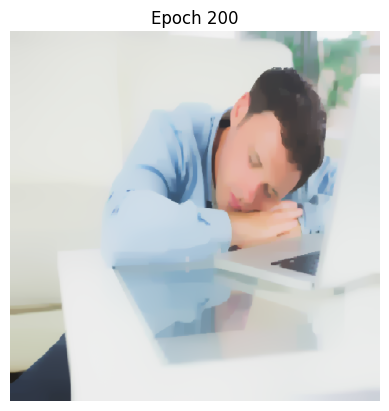

 13%|█▎        | 202/1500 [01:30<10:06,  2.14it/s]

Inside compute_loss:
Content Loss: 6.77410909588616e-08, Style Loss: 1.083682946045883e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 203/1500 [01:31<09:54,  2.18it/s]

Inside compute_loss:
Content Loss: 6.80205900494002e-08, Style Loss: 1.0835399280040292e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 204/1500 [01:31<09:51,  2.19it/s]

Inside compute_loss:
Content Loss: 6.830087784237548e-08, Style Loss: 1.0833878150151577e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 205/1500 [01:31<09:46,  2.21it/s]

Inside compute_loss:
Content Loss: 6.85816132772743e-08, Style Loss: 1.0832313819264527e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 206/1500 [01:32<09:40,  2.23it/s]

Inside compute_loss:
Content Loss: 6.886288161922494e-08, Style Loss: 1.0830723340404802e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 207/1500 [01:32<09:37,  2.24it/s]

Inside compute_loss:
Content Loss: 6.914326888818323e-08, Style Loss: 1.0829288612512755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 208/1500 [01:33<09:35,  2.25it/s]

Inside compute_loss:
Content Loss: 6.942165953205404e-08, Style Loss: 1.0827574214999913e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 209/1500 [01:33<09:32,  2.25it/s]

Inside compute_loss:
Content Loss: 6.96962700885706e-08, Style Loss: 1.08261178866087e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 210/1500 [01:34<09:30,  2.26it/s]

Inside compute_loss:
Content Loss: 6.996777557333189e-08, Style Loss: 1.0824647915796959e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 211/1500 [01:34<09:41,  2.21it/s]

Inside compute_loss:
Content Loss: 7.024049608617133e-08, Style Loss: 1.082316089195956e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 212/1500 [01:35<09:40,  2.22it/s]

Inside compute_loss:
Content Loss: 7.051425399140498e-08, Style Loss: 1.082156813936308e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 213/1500 [01:35<09:45,  2.20it/s]

Inside compute_loss:
Content Loss: 7.078509867142202e-08, Style Loss: 1.0820325542226783e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 214/1500 [01:36<09:40,  2.22it/s]

Inside compute_loss:
Content Loss: 7.105315802391488e-08, Style Loss: 1.0818944247148465e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 215/1500 [01:36<09:48,  2.18it/s]

Inside compute_loss:
Content Loss: 7.132201318427178e-08, Style Loss: 1.0817570910148788e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 216/1500 [01:36<09:51,  2.17it/s]

Inside compute_loss:
Content Loss: 7.159032833214951e-08, Style Loss: 1.0815906534844544e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 217/1500 [01:37<09:37,  2.22it/s]

Inside compute_loss:
Content Loss: 7.185659001152089e-08, Style Loss: 1.0814661663971492e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 218/1500 [01:37<09:34,  2.23it/s]

Inside compute_loss:
Content Loss: 7.212181429849807e-08, Style Loss: 1.0813398603204405e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 219/1500 [01:38<09:32,  2.24it/s]

Inside compute_loss:
Content Loss: 7.238531196662734e-08, Style Loss: 1.081187747331569e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 220/1500 [01:38<09:31,  2.24it/s]

Inside compute_loss:
Content Loss: 7.264775803150769e-08, Style Loss: 1.0810479125211714e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 221/1500 [01:39<09:30,  2.24it/s]

Inside compute_loss:
Content Loss: 7.29127762610915e-08, Style Loss: 1.0809159221025766e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 222/1500 [01:39<09:27,  2.25it/s]

Inside compute_loss:
Content Loss: 7.318029560110517e-08, Style Loss: 1.0807775652210694e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 223/1500 [01:40<09:26,  2.26it/s]

Inside compute_loss:
Content Loss: 7.344508645701353e-08, Style Loss: 1.08065478343633e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 224/1500 [01:40<09:27,  2.25it/s]

Inside compute_loss:
Content Loss: 7.371182420001787e-08, Style Loss: 1.0805177907968755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 225/1500 [01:40<09:26,  2.25it/s]

Inside compute_loss:
Content Loss: 7.397934354003155e-08, Style Loss: 1.0803655641211662e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 226/1500 [01:41<09:25,  2.25it/s]

Inside compute_loss:
Content Loss: 7.424569758995858e-08, Style Loss: 1.0802236829476897e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 227/1500 [01:41<09:25,  2.25it/s]

Inside compute_loss:
Content Loss: 7.450626071658917e-08, Style Loss: 1.0800821428347263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 228/1500 [01:42<09:23,  2.26it/s]

Inside compute_loss:
Content Loss: 7.476529617633787e-08, Style Loss: 1.0799411711559515e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 229/1500 [01:42<09:22,  2.26it/s]

Inside compute_loss:
Content Loss: 7.502419663296678e-08, Style Loss: 1.0798189578054007e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 230/1500 [01:43<09:22,  2.26it/s]

Inside compute_loss:
Content Loss: 7.528299761361268e-08, Style Loss: 1.079686967386806e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 231/1500 [01:43<09:23,  2.25it/s]

Inside compute_loss:
Content Loss: 7.554100278639453e-08, Style Loss: 1.0795671414598473e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 232/1500 [01:44<09:22,  2.25it/s]

Inside compute_loss:
Content Loss: 7.579554051062587e-08, Style Loss: 1.0794506124511827e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 233/1500 [01:44<09:22,  2.25it/s]

Inside compute_loss:
Content Loss: 7.604845819741968e-08, Style Loss: 1.0793360161187593e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 234/1500 [01:44<09:21,  2.26it/s]

Inside compute_loss:
Content Loss: 7.63002176995542e-08, Style Loss: 1.0791944760057959e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 235/1500 [01:45<09:21,  2.25it/s]

Inside compute_loss:
Content Loss: 7.655092559843979e-08, Style Loss: 1.0790586202347185e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 236/1500 [01:45<09:19,  2.26it/s]

Inside compute_loss:
Content Loss: 7.680363012241287e-08, Style Loss: 1.078943682841782e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 237/1500 [01:46<09:20,  2.26it/s]

Inside compute_loss:
Content Loss: 7.705555304937661e-08, Style Loss: 1.0788309054987621e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 238/1500 [01:46<09:19,  2.26it/s]

Inside compute_loss:
Content Loss: 7.730967155339385e-08, Style Loss: 1.0787026667458122e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 239/1500 [01:47<09:27,  2.22it/s]

Inside compute_loss:
Content Loss: 7.756386111168467e-08, Style Loss: 1.0785796575873974e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 240/1500 [01:47<09:28,  2.22it/s]

Inside compute_loss:
Content Loss: 7.781541455642582e-08, Style Loss: 1.0784611959024915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 241/1500 [01:48<09:29,  2.21it/s]

Inside compute_loss:
Content Loss: 7.806431057133523e-08, Style Loss: 1.0783170409922604e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 242/1500 [01:48<09:33,  2.19it/s]

Inside compute_loss:
Content Loss: 7.831076942466098e-08, Style Loss: 1.0782022172861616e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 243/1500 [01:49<09:39,  2.17it/s]

Inside compute_loss:
Content Loss: 7.85590756890997e-08, Style Loss: 1.0780919410535716e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 244/1500 [01:49<09:28,  2.21it/s]

Inside compute_loss:
Content Loss: 7.880682062477717e-08, Style Loss: 1.077955403161468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 245/1500 [01:49<09:24,  2.23it/s]

Inside compute_loss:
Content Loss: 7.905499899152346e-08, Style Loss: 1.0778346677398076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 246/1500 [01:50<09:22,  2.23it/s]

Inside compute_loss:
Content Loss: 7.930299261715845e-08, Style Loss: 1.0777205261547351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 247/1500 [01:50<09:19,  2.24it/s]

Inside compute_loss:
Content Loss: 7.955207337317916e-08, Style Loss: 1.0775813734653639e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 248/1500 [01:51<09:16,  2.25it/s]

Inside compute_loss:
Content Loss: 7.979812011171816e-08, Style Loss: 1.0774779184430372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 249/1500 [01:51<09:16,  2.25it/s]

Inside compute_loss:
Content Loss: 8.004275997564037e-08, Style Loss: 1.077351384992653e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 250/1500 [01:52<09:15,  2.25it/s]

Inside compute_loss:
Content Loss: 8.028631981460421e-08, Style Loss: 1.0772234873002162e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 251/1500 [01:52<09:15,  2.25it/s]

Inside compute_loss:
Content Loss: 8.052955280390961e-08, Style Loss: 1.0770987728392356e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 252/1500 [01:52<09:13,  2.25it/s]

Inside compute_loss:
Content Loss: 8.077194024735945e-08, Style Loss: 1.0769913387775887e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 253/1500 [01:53<09:15,  2.24it/s]

Inside compute_loss:
Content Loss: 8.101248027969632e-08, Style Loss: 1.0768823131002137e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 254/1500 [01:53<09:14,  2.25it/s]

Inside compute_loss:
Content Loss: 8.12495315472006e-08, Style Loss: 1.0767721505544614e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 255/1500 [01:54<09:14,  2.24it/s]

Inside compute_loss:
Content Loss: 8.148541752461824e-08, Style Loss: 1.0766672176032444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 256/1500 [01:54<09:12,  2.25it/s]

Inside compute_loss:
Content Loss: 8.17199250491285e-08, Style Loss: 1.0765540991997113e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 257/1500 [01:55<09:11,  2.25it/s]

Inside compute_loss:
Content Loss: 8.195444678449348e-08, Style Loss: 1.0764467788249021e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 258/1500 [01:55<09:11,  2.25it/s]

Inside compute_loss:
Content Loss: 8.219004854481682e-08, Style Loss: 1.0763217233034084e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 259/1500 [01:56<09:08,  2.26it/s]

Inside compute_loss:
Content Loss: 8.242608373620897e-08, Style Loss: 1.076220200957323e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 260/1500 [01:56<09:09,  2.26it/s]

Inside compute_loss:
Content Loss: 8.2662573674952e-08, Style Loss: 1.0761046951301978e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 261/1500 [01:56<09:09,  2.25it/s]

Inside compute_loss:
Content Loss: 8.289993758126002e-08, Style Loss: 1.075985778697941e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 262/1500 [01:57<09:09,  2.25it/s]

Inside compute_loss:
Content Loss: 8.313509880508718e-08, Style Loss: 1.0758907365016057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 263/1500 [01:57<09:08,  2.26it/s]

Inside compute_loss:
Content Loss: 8.33694642210503e-08, Style Loss: 1.0757606787592522e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 264/1500 [01:58<09:10,  2.25it/s]

Inside compute_loss:
Content Loss: 8.359998560081294e-08, Style Loss: 1.075654950000171e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 265/1500 [01:58<09:06,  2.26it/s]

Inside compute_loss:
Content Loss: 8.382981064869455e-08, Style Loss: 1.075547970685875e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 266/1500 [01:59<09:10,  2.24it/s]

Inside compute_loss:
Content Loss: 8.406138363170612e-08, Style Loss: 1.0754275763247279e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 267/1500 [01:59<09:16,  2.22it/s]

Inside compute_loss:
Content Loss: 8.42901570763388e-08, Style Loss: 1.0753162769105984e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 268/1500 [02:00<09:15,  2.22it/s]

Inside compute_loss:
Content Loss: 8.452071398323824e-08, Style Loss: 1.0752009984571487e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 269/1500 [02:00<09:17,  2.21it/s]

Inside compute_loss:
Content Loss: 8.475174695377063e-08, Style Loss: 1.0750982255558483e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 270/1500 [02:01<09:19,  2.20it/s]

Inside compute_loss:
Content Loss: 8.498156489622488e-08, Style Loss: 1.0749931789177936e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 271/1500 [02:01<09:23,  2.18it/s]

Inside compute_loss:
Content Loss: 8.521002570205383e-08, Style Loss: 1.0748867680376861e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 272/1500 [02:01<09:11,  2.23it/s]

Inside compute_loss:
Content Loss: 8.543712937125747e-08, Style Loss: 1.0747812666522805e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 273/1500 [02:02<09:09,  2.23it/s]

Inside compute_loss:
Content Loss: 8.566448173041863e-08, Style Loss: 1.0747039596026298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 274/1500 [02:02<09:06,  2.25it/s]

Inside compute_loss:
Content Loss: 8.588877875581602e-08, Style Loss: 1.0745972076620092e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 275/1500 [02:03<09:04,  2.25it/s]

Inside compute_loss:
Content Loss: 8.611752377873927e-08, Style Loss: 1.0744762448666734e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 276/1500 [02:03<09:03,  2.25it/s]

Inside compute_loss:
Content Loss: 8.634726356149258e-08, Style Loss: 1.074381202670338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 277/1500 [02:04<09:01,  2.26it/s]

Inside compute_loss:
Content Loss: 8.657351457941331e-08, Style Loss: 1.0742720633061253e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 278/1500 [02:04<09:01,  2.26it/s]

Inside compute_loss:
Content Loss: 8.679590024485151e-08, Style Loss: 1.0741712230810663e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 279/1500 [02:05<08:59,  2.26it/s]

Inside compute_loss:
Content Loss: 8.70194938329405e-08, Style Loss: 1.0740836842160206e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 280/1500 [02:05<09:00,  2.26it/s]

Inside compute_loss:
Content Loss: 8.724555300432257e-08, Style Loss: 1.0739909157564398e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 281/1500 [02:05<09:00,  2.26it/s]

Inside compute_loss:
Content Loss: 8.747129953690091e-08, Style Loss: 1.0738998525994248e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 282/1500 [02:06<08:58,  2.26it/s]

Inside compute_loss:
Content Loss: 8.769492154669933e-08, Style Loss: 1.073774001270067e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 283/1500 [02:06<08:57,  2.26it/s]

Inside compute_loss:
Content Loss: 8.791644745542726e-08, Style Loss: 1.0736753210949246e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 284/1500 [02:07<08:56,  2.27it/s]

Inside compute_loss:
Content Loss: 8.813700702603455e-08, Style Loss: 1.0735843716247473e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 285/1500 [02:07<08:58,  2.26it/s]

Inside compute_loss:
Content Loss: 8.835618103830711e-08, Style Loss: 1.0734814850366092e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 286/1500 [02:08<08:56,  2.26it/s]

Inside compute_loss:
Content Loss: 8.857560374053719e-08, Style Loss: 1.0733855333455722e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 287/1500 [02:08<08:58,  2.25it/s]

Inside compute_loss:
Content Loss: 8.879798230054803e-08, Style Loss: 1.0732806003943551e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 288/1500 [02:09<08:56,  2.26it/s]

Inside compute_loss:
Content Loss: 8.902126324983328e-08, Style Loss: 1.073189196176827e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 289/1500 [02:09<09:01,  2.24it/s]

Inside compute_loss:
Content Loss: 8.924215677552638e-08, Style Loss: 1.0730826716098818e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 290/1500 [02:09<08:57,  2.25it/s]

Inside compute_loss:
Content Loss: 8.945749385702584e-08, Style Loss: 1.0729983159762924e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 291/1500 [02:10<08:57,  2.25it/s]

Inside compute_loss:
Content Loss: 8.967439413254397e-08, Style Loss: 1.0728977031249087e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 292/1500 [02:10<08:56,  2.25it/s]

Inside compute_loss:
Content Loss: 8.989001543113773e-08, Style Loss: 1.0728117558755912e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 293/1500 [02:11<08:54,  2.26it/s]

Inside compute_loss:
Content Loss: 9.010530988007304e-08, Style Loss: 1.0727218295869534e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 294/1500 [02:11<08:59,  2.23it/s]

Inside compute_loss:
Content Loss: 9.031757741695401e-08, Style Loss: 1.0726216714829206e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 295/1500 [02:12<09:01,  2.23it/s]

Inside compute_loss:
Content Loss: 9.052757832250791e-08, Style Loss: 1.072543909685919e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 296/1500 [02:12<09:04,  2.21it/s]

Inside compute_loss:
Content Loss: 9.073994533537189e-08, Style Loss: 1.0724224921432324e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 297/1500 [02:13<09:03,  2.21it/s]

Inside compute_loss:
Content Loss: 9.095317210494613e-08, Style Loss: 1.0723374543886166e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 298/1500 [02:13<09:06,  2.20it/s]

Inside compute_loss:
Content Loss: 9.116553201238276e-08, Style Loss: 1.0722578736022115e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 299/1500 [02:13<09:08,  2.19it/s]

Inside compute_loss:
Content Loss: 9.137602319242433e-08, Style Loss: 1.0721651051426306e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 300/1500 [02:14<08:56,  2.24it/s]

Inside compute_loss:
Content Loss: 9.158626568250838e-08, Style Loss: 1.0720741556724533e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.179608895237834e-08, Style Loss: 1.0719923011492938e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [960.53613], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 300, Loss: 960.536133, Alpha: 10.0000, Beta: 10.0000


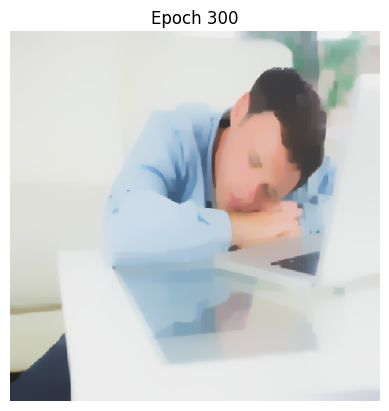

 20%|██        | 302/1500 [02:15<09:29,  2.10it/s]

Inside compute_loss:
Content Loss: 9.200616801763317e-08, Style Loss: 1.0719106739998097e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 303/1500 [02:15<09:15,  2.16it/s]

Inside compute_loss:
Content Loss: 9.222008401366111e-08, Style Loss: 1.0718188150349306e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 304/1500 [02:16<09:10,  2.17it/s]

Inside compute_loss:
Content Loss: 9.243276366532882e-08, Style Loss: 1.071720248546626e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 305/1500 [02:16<09:02,  2.20it/s]

Inside compute_loss:
Content Loss: 9.264594069691157e-08, Style Loss: 1.071635324478848e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 306/1500 [02:17<08:57,  2.22it/s]

Inside compute_loss:
Content Loss: 9.285898983080187e-08, Style Loss: 1.0715369853642187e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 307/1500 [02:17<08:54,  2.23it/s]

Inside compute_loss:
Content Loss: 9.307245818490628e-08, Style Loss: 1.0714438758441247e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 308/1500 [02:18<08:50,  2.25it/s]

Inside compute_loss:
Content Loss: 9.328033456768026e-08, Style Loss: 1.0713517895055702e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 309/1500 [02:18<08:51,  2.24it/s]

Inside compute_loss:
Content Loss: 9.348855911639475e-08, Style Loss: 1.071269366548222e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 310/1500 [02:19<08:49,  2.25it/s]

Inside compute_loss:
Content Loss: 9.369976083917209e-08, Style Loss: 1.0711800086937728e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 311/1500 [02:19<08:47,  2.25it/s]

Inside compute_loss:
Content Loss: 9.390927147023831e-08, Style Loss: 1.0710862170526525e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 312/1500 [02:19<08:45,  2.26it/s]

Inside compute_loss:
Content Loss: 9.411181167706673e-08, Style Loss: 1.0709962907640147e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 313/1500 [02:20<08:44,  2.26it/s]

Inside compute_loss:
Content Loss: 9.431275316273968e-08, Style Loss: 1.0709019306887058e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 314/1500 [02:20<08:43,  2.26it/s]

Inside compute_loss:
Content Loss: 9.45156628517907e-08, Style Loss: 1.0708139370763092e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 315/1500 [02:21<08:42,  2.27it/s]

Inside compute_loss:
Content Loss: 9.472400819277027e-08, Style Loss: 1.0707285582611803e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 316/1500 [02:21<08:42,  2.26it/s]

Inside compute_loss:
Content Loss: 9.493155062045844e-08, Style Loss: 1.070636017175275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 317/1500 [02:22<08:42,  2.26it/s]

Inside compute_loss:
Content Loss: 9.513600929267341e-08, Style Loss: 1.0705480235628784e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 318/1500 [02:22<08:41,  2.26it/s]

Inside compute_loss:
Content Loss: 9.53406811277091e-08, Style Loss: 1.0704761734814383e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 319/1500 [02:22<08:40,  2.27it/s]

Inside compute_loss:
Content Loss: 9.5544045564111e-08, Style Loss: 1.0703955695134937e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 320/1500 [02:23<08:39,  2.27it/s]

Inside compute_loss:
Content Loss: 9.574777237730814e-08, Style Loss: 1.0703074622142594e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 321/1500 [02:23<08:39,  2.27it/s]

Inside compute_loss:
Content Loss: 9.595344607760126e-08, Style Loss: 1.0702310646593105e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.615996532374993e-08, Style Loss: 1.0701462542783702e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 323/1500 [02:24<08:49,  2.22it/s]

Inside compute_loss:
Content Loss: 9.636493558673465e-08, Style Loss: 1.070065081876237e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 324/1500 [02:25<08:49,  2.22it/s]

Inside compute_loss:
Content Loss: 9.656787369749509e-08, Style Loss: 1.0699840231609414e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 325/1500 [02:25<08:52,  2.21it/s]

Inside compute_loss:
Content Loss: 9.676772805278233e-08, Style Loss: 1.069900918082567e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 326/1500 [02:26<08:57,  2.18it/s]

Inside compute_loss:
Content Loss: 9.696704950101775e-08, Style Loss: 1.069816335075302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 327/1500 [02:26<08:58,  2.18it/s]

Inside compute_loss:
Content Loss: 9.716465143583264e-08, Style Loss: 1.0697377774704364e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 328/1500 [02:27<08:46,  2.23it/s]

Inside compute_loss:
Content Loss: 9.736604766885648e-08, Style Loss: 1.069656718755141e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 329/1500 [02:27<08:41,  2.24it/s]

Inside compute_loss:
Content Loss: 9.75665770397427e-08, Style Loss: 1.0695655419112882e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 330/1500 [02:27<08:38,  2.25it/s]

Inside compute_loss:
Content Loss: 9.776658060900445e-08, Style Loss: 1.0694792536014575e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 331/1500 [02:28<08:37,  2.26it/s]

Inside compute_loss:
Content Loss: 9.79665841782662e-08, Style Loss: 1.0694052434701007e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 332/1500 [02:28<08:37,  2.26it/s]

Inside compute_loss:
Content Loss: 9.81664456389808e-08, Style Loss: 1.0693153171814629e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 333/1500 [02:29<08:35,  2.26it/s]

Inside compute_loss:
Content Loss: 9.835969194682548e-08, Style Loss: 1.0692378964449745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 334/1500 [02:29<08:34,  2.26it/s]

Inside compute_loss:
Content Loss: 9.855196481112216e-08, Style Loss: 1.0691627494452405e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 335/1500 [02:30<08:33,  2.27it/s]

Inside compute_loss:
Content Loss: 9.874701589751567e-08, Style Loss: 1.0690930594137171e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 336/1500 [02:30<08:34,  2.26it/s]

Inside compute_loss:
Content Loss: 9.8942699366944e-08, Style Loss: 1.069016320798255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 337/1500 [02:31<08:33,  2.26it/s]

Inside compute_loss:
Content Loss: 9.913622989188298e-08, Style Loss: 1.0689393548091175e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 338/1500 [02:31<08:32,  2.27it/s]

Inside compute_loss:
Content Loss: 9.933165046049908e-08, Style Loss: 1.0688677321013529e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 339/1500 [02:31<08:30,  2.27it/s]

Inside compute_loss:
Content Loss: 9.952959345582713e-08, Style Loss: 1.0687862186387065e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 340/1500 [02:32<08:31,  2.27it/s]

Inside compute_loss:
Content Loss: 9.972463743679327e-08, Style Loss: 1.0687076610338408e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 341/1500 [02:32<08:31,  2.27it/s]

Inside compute_loss:
Content Loss: 9.991784821750116e-08, Style Loss: 1.068628762368462e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 342/1500 [02:33<08:30,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0010981554842147e-07, Style Loss: 1.068567144102417e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 343/1500 [02:33<08:30,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0030132813199089e-07, Style Loss: 1.0684798326110467e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 344/1500 [02:34<08:28,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0049476628637422e-07, Style Loss: 1.0684311746445019e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 345/1500 [02:34<08:28,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0068719547007277e-07, Style Loss: 1.0683329492167104e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 346/1500 [02:35<08:28,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0087646273859718e-07, Style Loss: 1.0682675792850205e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 347/1500 [02:35<08:27,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0106685977007146e-07, Style Loss: 1.0681953881430672e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 348/1500 [02:35<08:26,  2.28it/s]

Inside compute_loss:
Content Loss: 1.0126100846719055e-07, Style Loss: 1.0681163757908507e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 349/1500 [02:36<08:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0145162576691291e-07, Style Loss: 1.0680433888410334e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 350/1500 [02:36<08:33,  2.24it/s]

Inside compute_loss:
Content Loss: 1.0164124120137785e-07, Style Loss: 1.0679739261831855e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 351/1500 [02:37<08:35,  2.23it/s]

Inside compute_loss:
Content Loss: 1.0183354248738397e-07, Style Loss: 1.0678940043362672e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 352/1500 [02:37<08:36,  2.22it/s]

Inside compute_loss:
Content Loss: 1.0202384004287524e-07, Style Loss: 1.0678447779355338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 353/1500 [02:38<08:39,  2.21it/s]

Inside compute_loss:
Content Loss: 1.0221345547734018e-07, Style Loss: 1.0677506452339003e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 354/1500 [02:38<08:45,  2.18it/s]

Inside compute_loss:
Content Loss: 1.0240272985129195e-07, Style Loss: 1.067678454091947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 355/1500 [02:39<08:43,  2.19it/s]

Inside compute_loss:
Content Loss: 1.0259540772494802e-07, Style Loss: 1.067595576387248e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 356/1500 [02:39<08:31,  2.24it/s]

Inside compute_loss:
Content Loss: 1.0278572659672136e-07, Style Loss: 1.0675400972104399e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 357/1500 [02:39<08:28,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0297859631691608e-07, Style Loss: 1.0674762052076403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 358/1500 [02:40<08:27,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0316775700403014e-07, Style Loss: 1.067396738108073e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 359/1500 [02:40<08:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0335413236362001e-07, Style Loss: 1.0673179531295318e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 360/1500 [02:41<08:23,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0354168011872389e-07, Style Loss: 1.0672588359739166e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 361/1500 [02:41<08:23,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0373005210340125e-07, Style Loss: 1.0671612926671514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 362/1500 [02:42<08:22,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0391440952162156e-07, Style Loss: 1.0671076324797468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 363/1500 [02:42<08:22,  2.26it/s]

Inside compute_loss:
Content Loss: 1.041013604208274e-07, Style Loss: 1.0670304391169338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 364/1500 [02:43<08:21,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0429061347849711e-07, Style Loss: 1.066956883732928e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 365/1500 [02:43<08:23,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0447744358543787e-07, Style Loss: 1.066882987288409e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 366/1500 [02:43<08:18,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0466421684895977e-07, Style Loss: 1.0668221648302278e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 367/1500 [02:44<08:18,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0484904322538569e-07, Style Loss: 1.0667483820725465e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 368/1500 [02:44<08:20,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0503023162300451e-07, Style Loss: 1.0666834668882075e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 369/1500 [02:45<08:19,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0521242899130812e-07, Style Loss: 1.0666221896826755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 370/1500 [02:45<08:21,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0539773143136699e-07, Style Loss: 1.0665436320778099e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 371/1500 [02:46<08:18,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0558468943600019e-07, Style Loss: 1.0664828096196288e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 372/1500 [02:46<08:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0576723497024432e-07, Style Loss: 1.066411641659215e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 373/1500 [02:47<08:16,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0594970234478751e-07, Style Loss: 1.066351615008898e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 374/1500 [02:47<08:16,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0613107548351763e-07, Style Loss: 1.0662586191756418e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 375/1500 [02:47<08:15,  2.27it/s]

Inside compute_loss:
Content Loss: 1.0631075753053665e-07, Style Loss: 1.066207119038154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 376/1500 [02:48<08:16,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0649327464307135e-07, Style Loss: 1.066142544914328e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 377/1500 [02:48<08:17,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0667800864894161e-07, Style Loss: 1.066073537003831e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 378/1500 [02:49<08:22,  2.23it/s]

Inside compute_loss:
Content Loss: 1.0686061813203196e-07, Style Loss: 1.0660039606591454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 379/1500 [02:49<08:22,  2.23it/s]

Inside compute_loss:
Content Loss: 1.0704244601811297e-07, Style Loss: 1.065953028955846e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 380/1500 [02:50<08:21,  2.23it/s]

Inside compute_loss:
Content Loss: 1.0721985432837755e-07, Style Loss: 1.0658748124114936e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 381/1500 [02:50<08:28,  2.20it/s]

Inside compute_loss:
Content Loss: 1.0739388045521991e-07, Style Loss: 1.065817059497931e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 382/1500 [02:51<08:29,  2.20it/s]

Inside compute_loss:
Content Loss: 1.0756949819779038e-07, Style Loss: 1.065757828655478e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 383/1500 [02:51<08:30,  2.19it/s]

Inside compute_loss:
Content Loss: 1.0774777337019259e-07, Style Loss: 1.0656907534212223e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 384/1500 [02:51<08:18,  2.24it/s]

Inside compute_loss:
Content Loss: 1.0792650328994569e-07, Style Loss: 1.065628794094664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 385/1500 [02:52<08:16,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0810521189341671e-07, Style Loss: 1.0655684263838339e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 386/1500 [02:52<08:16,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0828193808265496e-07, Style Loss: 1.065516130438482e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 387/1500 [02:53<08:14,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0845795372915745e-07, Style Loss: 1.0654387097019935e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 388/1500 [02:53<08:13,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0863049482168208e-07, Style Loss: 1.065396418198361e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 389/1500 [02:54<08:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0880248169087281e-07, Style Loss: 1.0653280924088904e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 390/1500 [02:54<08:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0897682045651891e-07, Style Loss: 1.065268179445411e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 391/1500 [02:55<08:10,  2.26it/s]

Inside compute_loss:
Content Loss: 1.0915173476178097e-07, Style Loss: 1.0652129276422784e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 392/1500 [02:55<08:09,  2.26it/s]

Inside compute_loss:
Content Loss: 1.093229187176803e-07, Style Loss: 1.0651615411916282e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 393/1500 [02:55<08:13,  2.24it/s]

Inside compute_loss:
Content Loss: 1.0949516848768326e-07, Style Loss: 1.0650784361132537e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 394/1500 [02:56<08:11,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0966513741550443e-07, Style Loss: 1.065021933754906e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 395/1500 [02:56<08:10,  2.25it/s]

Inside compute_loss:
Content Loss: 1.0983592346747173e-07, Style Loss: 1.0649704336174182e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 396/1500 [02:57<08:09,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1000909694303118e-07, Style Loss: 1.0649071100488072e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 397/1500 [02:57<08:08,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1018329360013013e-07, Style Loss: 1.0648368515830953e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 398/1500 [02:58<08:08,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1035811553483654e-07, Style Loss: 1.0647886483639013e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 399/1500 [02:58<08:07,  2.26it/s]

Inside compute_loss:
Content Loss: 1.105273170765031e-07, Style Loss: 1.0647119097484392e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 400/1500 [02:59<08:05,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1069707284150354e-07, Style Loss: 1.0646565442584688e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1086547857530604e-07, Style Loss: 1.0645942438713973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [842.082], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 400, Loss: 842.081970, Alpha: 10.0000, Beta: 10.0000


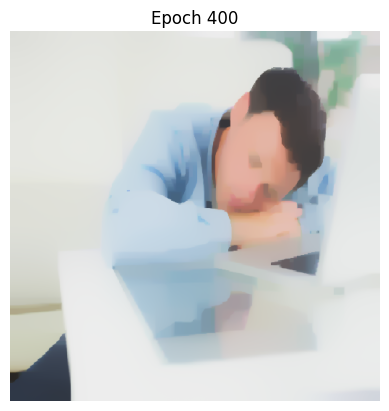

 27%|██▋       | 402/1500 [03:00<08:30,  2.15it/s]

Inside compute_loss:
Content Loss: 1.1103467301154524e-07, Style Loss: 1.0645377415130497e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 403/1500 [03:00<08:22,  2.18it/s]

Inside compute_loss:
Content Loss: 1.1120124554508948e-07, Style Loss: 1.0644860140018864e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 404/1500 [03:00<08:20,  2.19it/s]

Inside compute_loss:
Content Loss: 1.1136771149722335e-07, Style Loss: 1.0644307621987537e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 405/1500 [03:01<08:11,  2.23it/s]

Inside compute_loss:
Content Loss: 1.1153553458598253e-07, Style Loss: 1.0643830137269106e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 406/1500 [03:01<08:18,  2.19it/s]

Inside compute_loss:
Content Loss: 1.1170376978952845e-07, Style Loss: 1.0643242376318085e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 407/1500 [03:02<08:17,  2.20it/s]

Inside compute_loss:
Content Loss: 1.1187358239794776e-07, Style Loss: 1.064261141436873e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 408/1500 [03:02<08:12,  2.22it/s]

Inside compute_loss:
Content Loss: 1.1204337369008499e-07, Style Loss: 1.0642104371072492e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 409/1500 [03:03<08:15,  2.20it/s]

Inside compute_loss:
Content Loss: 1.1221205653555444e-07, Style Loss: 1.0641620065143798e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 410/1500 [03:03<08:19,  2.18it/s]

Inside compute_loss:
Content Loss: 1.1237955988008252e-07, Style Loss: 1.0641062999638962e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 411/1500 [03:04<08:18,  2.18it/s]

Inside compute_loss:
Content Loss: 1.1254365972490632e-07, Style Loss: 1.0640362688718596e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 412/1500 [03:04<08:10,  2.22it/s]

Inside compute_loss:
Content Loss: 1.1271050226469015e-07, Style Loss: 1.0639995480232756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 413/1500 [03:05<08:06,  2.23it/s]

Inside compute_loss:
Content Loss: 1.1287926326986053e-07, Style Loss: 1.0639346328389365e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 414/1500 [03:05<08:05,  2.24it/s]

Inside compute_loss:
Content Loss: 1.1304599212280664e-07, Style Loss: 1.06387358300708e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 415/1500 [03:05<08:02,  2.25it/s]

Inside compute_loss:
Content Loss: 1.1320943826831353e-07, Style Loss: 1.063815147972491e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 416/1500 [03:06<08:01,  2.25it/s]

Inside compute_loss:
Content Loss: 1.1337399286048822e-07, Style Loss: 1.0637591003614943e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 417/1500 [03:06<07:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.135354139591982e-07, Style Loss: 1.0637186278472655e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 418/1500 [03:07<07:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1369570529495832e-07, Style Loss: 1.063671447809611e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 419/1500 [03:07<07:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1385753850845504e-07, Style Loss: 1.063617560248531e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 420/1500 [03:08<07:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1402224231460423e-07, Style Loss: 1.063548893398547e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 421/1500 [03:08<07:56,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1418581635780356e-07, Style Loss: 1.0635081935106427e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 422/1500 [03:09<07:55,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1434844537916433e-07, Style Loss: 1.063448053173488e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 423/1500 [03:09<07:55,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1450837433812922e-07, Style Loss: 1.0633958709149738e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 424/1500 [03:09<07:55,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1466668325965657e-07, Style Loss: 1.0633476676957798e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 425/1500 [03:10<07:56,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1482524797656879e-07, Style Loss: 1.0632984412950464e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 426/1500 [03:10<07:54,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1498173080326524e-07, Style Loss: 1.0632501243890147e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 427/1500 [03:11<07:54,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1513990472167279e-07, Style Loss: 1.063192826222803e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 428/1500 [03:11<07:53,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1529886734251704e-07, Style Loss: 1.0631449640641222e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 429/1500 [03:12<07:51,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1545488831643524e-07, Style Loss: 1.0630857332216692e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 430/1500 [03:12<07:52,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1560670287735775e-07, Style Loss: 1.0630557198965107e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 431/1500 [03:12<07:50,  2.27it/s]

Inside compute_loss:
Content Loss: 1.157622975256345e-07, Style Loss: 1.062999672285514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 432/1500 [03:13<07:50,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1592186410780414e-07, Style Loss: 1.0629498774505919e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 433/1500 [03:13<07:50,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1608349836933485e-07, Style Loss: 1.0628995141814812e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1624248230646117e-07, Style Loss: 1.0628341442497913e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 435/1500 [03:14<07:55,  2.24it/s]

Inside compute_loss:
Content Loss: 1.163990859254227e-07, Style Loss: 1.062786850525299e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 436/1500 [03:15<07:59,  2.22it/s]

Inside compute_loss:
Content Loss: 1.1655129128484987e-07, Style Loss: 1.0627560413922765e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 437/1500 [03:15<08:01,  2.21it/s]

Inside compute_loss:
Content Loss: 1.1670596222757013e-07, Style Loss: 1.0627152278175345e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 438/1500 [03:16<08:01,  2.21it/s]

Inside compute_loss:
Content Loss: 1.1686029921520458e-07, Style Loss: 1.0626478115227656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1701700941557647e-07, Style Loss: 1.0625897175486898e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 440/1500 [03:17<07:54,  2.23it/s]

Inside compute_loss:
Content Loss: 1.1717195746996367e-07, Style Loss: 1.0625523145790794e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 441/1500 [03:17<07:55,  2.23it/s]

Inside compute_loss:
Content Loss: 1.1732575444511895e-07, Style Loss: 1.0625037702993723e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 442/1500 [03:17<07:50,  2.25it/s]

Inside compute_loss:
Content Loss: 1.1747866324185452e-07, Style Loss: 1.0624594324326608e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 443/1500 [03:18<07:48,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1763333418457478e-07, Style Loss: 1.0624012247717474e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 444/1500 [03:18<07:47,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1778785591332053e-07, Style Loss: 1.0623484740790445e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 445/1500 [03:19<07:46,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1794137577680885e-07, Style Loss: 1.0623101616147324e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 446/1500 [03:19<07:47,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1809470379375853e-07, Style Loss: 1.0622529771353584e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 447/1500 [03:20<07:44,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1824584333908206e-07, Style Loss: 1.0622138688631821e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 448/1500 [03:20<07:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1839576785632744e-07, Style Loss: 1.0621761248330586e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 449/1500 [03:21<07:43,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1854825032742156e-07, Style Loss: 1.0621305364111322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 450/1500 [03:21<07:43,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1869872906800083e-07, Style Loss: 1.0620863122312585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 451/1500 [03:21<07:42,  2.27it/s]

Inside compute_loss:
Content Loss: 1.188511191685393e-07, Style Loss: 1.0620376542647136e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 452/1500 [03:22<07:42,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1900217344873454e-07, Style Loss: 1.061983198269445e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 453/1500 [03:22<07:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1915420117247777e-07, Style Loss: 1.0619500017128303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 454/1500 [03:23<07:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1930428911455238e-07, Style Loss: 1.0618999795042328e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 455/1500 [03:23<07:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1945047617700766e-07, Style Loss: 1.0618828127917368e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 456/1500 [03:24<07:41,  2.26it/s]

Inside compute_loss:
Content Loss: 1.1959430423758022e-07, Style Loss: 1.0618447277011e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 457/1500 [03:24<07:40,  2.27it/s]

Inside compute_loss:
Content Loss: 1.197392833773847e-07, Style Loss: 1.0617787893352215e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 458/1500 [03:24<07:39,  2.27it/s]

Inside compute_loss:
Content Loss: 1.1988859682787734e-07, Style Loss: 1.0617102361720754e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 459/1500 [03:25<07:39,  2.27it/s]

Inside compute_loss:
Content Loss: 1.2003799554349825e-07, Style Loss: 1.0616602139634779e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 460/1500 [03:25<07:43,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2018931272450573e-07, Style Loss: 1.0616105328153935e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 461/1500 [03:26<07:39,  2.26it/s]

Inside compute_loss:
Content Loss: 1.203395214588454e-07, Style Loss: 1.0615688097459497e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 462/1500 [03:26<07:42,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2049078179643402e-07, Style Loss: 1.0615354995024973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 463/1500 [03:27<07:41,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2064104737419257e-07, Style Loss: 1.0614809298203909e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 464/1500 [03:27<07:42,  2.24it/s]

Inside compute_loss:
Content Loss: 1.207876607622893e-07, Style Loss: 1.0614287475618767e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 465/1500 [03:28<07:45,  2.22it/s]

Inside compute_loss:
Content Loss: 1.2093038037619408e-07, Style Loss: 1.0613862286845688e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 466/1500 [03:28<07:49,  2.20it/s]

Inside compute_loss:
Content Loss: 1.2107364000257803e-07, Style Loss: 1.0613490530886338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 467/1500 [03:29<07:52,  2.19it/s]

Inside compute_loss:
Content Loss: 1.2122099235511996e-07, Style Loss: 1.0612997130010626e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 468/1500 [03:29<07:42,  2.23it/s]

Inside compute_loss:
Content Loss: 1.2136875682244863e-07, Style Loss: 1.0612710639179568e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 469/1500 [03:29<07:40,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2151257067216648e-07, Style Loss: 1.0612450296321185e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 470/1500 [03:30<07:37,  2.25it/s]

Inside compute_loss:
Content Loss: 1.216548639604298e-07, Style Loss: 1.0612070582283195e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 471/1500 [03:30<07:37,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2179448560800665e-07, Style Loss: 1.0611618108669063e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 472/1500 [03:31<07:35,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2193058296361414e-07, Style Loss: 1.0611242942104582e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 473/1500 [03:31<07:34,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2206911037537793e-07, Style Loss: 1.0610796152832336e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 474/1500 [03:32<07:34,  2.26it/s]

Inside compute_loss:
Content Loss: 1.222125831645826e-07, Style Loss: 1.0610333447402809e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 475/1500 [03:32<07:33,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2235632596002688e-07, Style Loss: 1.0610042409098241e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 476/1500 [03:33<07:33,  2.26it/s]

Inside compute_loss:
Content Loss: 1.224965586743565e-07, Style Loss: 1.0609595619825996e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 477/1500 [03:33<07:32,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2263970461390272e-07, Style Loss: 1.0609257969917962e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 478/1500 [03:33<07:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2278125893772085e-07, Style Loss: 1.060874069480633e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 479/1500 [03:34<07:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2292215956222208e-07, Style Loss: 1.06083280115854e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 480/1500 [03:34<07:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2306503549552872e-07, Style Loss: 1.0607986951072235e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 481/1500 [03:35<07:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2320928988174273e-07, Style Loss: 1.0607586773403455e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 482/1500 [03:35<07:30,  2.26it/s]

Inside compute_loss:
Content Loss: 1.233528479360757e-07, Style Loss: 1.0607141120999586e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 483/1500 [03:36<07:28,  2.27it/s]

Inside compute_loss:
Content Loss: 1.2349575229109178e-07, Style Loss: 1.060683757714287e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 484/1500 [03:36<07:30,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2364024826183595e-07, Style Loss: 1.0606503337839968e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 485/1500 [03:36<07:30,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2378467317830655e-07, Style Loss: 1.0606088380882284e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 486/1500 [03:37<07:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2392582959819265e-07, Style Loss: 1.0605692750687012e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 487/1500 [03:37<07:29,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2406661653585616e-07, Style Loss: 1.0605225497783977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 488/1500 [03:38<07:30,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2420541395385953e-07, Style Loss: 1.0604857152429759e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 489/1500 [03:38<07:28,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2434114182724443e-07, Style Loss: 1.0604503586364444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 490/1500 [03:39<07:33,  2.23it/s]

Inside compute_loss:
Content Loss: 1.2447996766695724e-07, Style Loss: 1.060414206222049e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 491/1500 [03:39<07:32,  2.23it/s]

Inside compute_loss:
Content Loss: 1.2462092513487733e-07, Style Loss: 1.0603705504763639e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 492/1500 [03:40<07:34,  2.22it/s]

Inside compute_loss:
Content Loss: 1.2476171207254083e-07, Style Loss: 1.0603278042253805e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 493/1500 [03:40<07:36,  2.21it/s]

Inside compute_loss:
Content Loss: 1.2490430378875317e-07, Style Loss: 1.0602710744933574e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 494/1500 [03:41<07:40,  2.18it/s]

Inside compute_loss:
Content Loss: 1.2504906976573693e-07, Style Loss: 1.0602241218293784e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 495/1500 [03:41<07:39,  2.19it/s]

Inside compute_loss:
Content Loss: 1.2518971459485329e-07, Style Loss: 1.0601943358778954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 496/1500 [03:41<07:29,  2.23it/s]

Inside compute_loss:
Content Loss: 1.2532758830730018e-07, Style Loss: 1.0601747817418072e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 497/1500 [03:42<07:30,  2.23it/s]

Inside compute_loss:
Content Loss: 1.2546480832043017e-07, Style Loss: 1.0601422673062189e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 498/1500 [03:42<07:27,  2.24it/s]

Inside compute_loss:
Content Loss: 1.256019714901413e-07, Style Loss: 1.060094405147538e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 499/1500 [03:43<07:26,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2573516983138688e-07, Style Loss: 1.0600439281915897e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 500/1500 [03:43<07:24,  2.25it/s]

Inside compute_loss:
Content Loss: 1.258676576298967e-07, Style Loss: 1.060016870724212e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.26002916545076e-07, Style Loss: 1.059986175278027e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [763.1872], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 500, Loss: 763.187195, Alpha: 10.0000, Beta: 10.0000


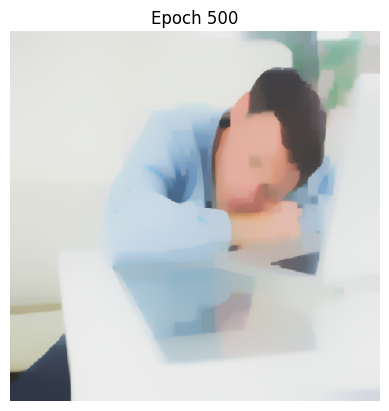

 33%|███▎      | 502/1500 [03:44<07:45,  2.14it/s]

Inside compute_loss:
Content Loss: 1.2613831756880245e-07, Style Loss: 1.0599429742796929e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 503/1500 [03:45<07:35,  2.19it/s]

Inside compute_loss:
Content Loss: 1.2627192802483478e-07, Style Loss: 1.0598959079288761e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 504/1500 [03:45<07:34,  2.19it/s]

Inside compute_loss:
Content Loss: 1.264064763972783e-07, Style Loss: 1.0598636208669632e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 505/1500 [03:46<07:29,  2.21it/s]

Inside compute_loss:
Content Loss: 1.2654189163185947e-07, Style Loss: 1.0598316748655634e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 506/1500 [03:46<07:26,  2.23it/s]

Inside compute_loss:
Content Loss: 1.2667810267430468e-07, Style Loss: 1.059797568814247e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 507/1500 [03:46<07:23,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2681368843914242e-07, Style Loss: 1.0597593700367725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 508/1500 [03:47<07:22,  2.24it/s]

Inside compute_loss:
Content Loss: 1.269502405421008e-07, Style Loss: 1.059709347828175e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 509/1500 [03:47<07:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2708557051155367e-07, Style Loss: 1.0596912716209772e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 510/1500 [03:48<07:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2721902464818413e-07, Style Loss: 1.0596373840598972e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 511/1500 [03:48<07:17,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2735077348224877e-07, Style Loss: 1.0595994126560981e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 512/1500 [03:49<07:16,  2.27it/s]

Inside compute_loss:
Content Loss: 1.2748473920964898e-07, Style Loss: 1.0595734920570976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 513/1500 [03:49<07:17,  2.26it/s]

Inside compute_loss:
Content Loss: 1.276171275321758e-07, Style Loss: 1.0595481398922857e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 514/1500 [03:50<07:15,  2.27it/s]

Inside compute_loss:
Content Loss: 1.277523864473551e-07, Style Loss: 1.059503119904548e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 515/1500 [03:50<07:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2788767378424382e-07, Style Loss: 1.0594635568850208e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 516/1500 [03:50<07:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2802044579984795e-07, Style Loss: 1.0594461627988494e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 517/1500 [03:51<07:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2815094407869765e-07, Style Loss: 1.059414103110612e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 518/1500 [03:51<07:21,  2.22it/s]

Inside compute_loss:
Content Loss: 1.282797086332721e-07, Style Loss: 1.0593832939775893e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 519/1500 [03:52<07:23,  2.21it/s]

Inside compute_loss:
Content Loss: 1.2840696683724673e-07, Style Loss: 1.0593506658551632e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 520/1500 [03:52<07:21,  2.22it/s]

Inside compute_loss:
Content Loss: 1.2853446662575152e-07, Style Loss: 1.0592975741019472e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 521/1500 [03:53<07:22,  2.21it/s]

Inside compute_loss:
Content Loss: 1.286619522034016e-07, Style Loss: 1.059263809111144e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 522/1500 [03:53<07:29,  2.18it/s]

Inside compute_loss:
Content Loss: 1.2879368682661152e-07, Style Loss: 1.0592398211883847e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 523/1500 [03:54<07:29,  2.17it/s]

Inside compute_loss:
Content Loss: 1.2892614620341192e-07, Style Loss: 1.0592132184683578e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 524/1500 [03:54<07:19,  2.22it/s]

Inside compute_loss:
Content Loss: 1.290584918933746e-07, Style Loss: 1.0591660384307033e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 525/1500 [03:55<07:16,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2918756908675277e-07, Style Loss: 1.0591354566713562e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 526/1500 [03:55<07:14,  2.24it/s]

Inside compute_loss:
Content Loss: 1.2931450044106896e-07, Style Loss: 1.0591033969831187e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 527/1500 [03:55<07:12,  2.25it/s]

Inside compute_loss:
Content Loss: 1.29441289686838e-07, Style Loss: 1.059070655173855e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 528/1500 [03:56<07:11,  2.25it/s]

Inside compute_loss:
Content Loss: 1.2956930106611253e-07, Style Loss: 1.0590499641693896e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 529/1500 [03:56<07:10,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2970019724889426e-07, Style Loss: 1.0590028978185728e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 530/1500 [03:57<07:08,  2.27it/s]

Inside compute_loss:
Content Loss: 1.2982944497252902e-07, Style Loss: 1.0589707244434976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 531/1500 [03:57<07:09,  2.26it/s]

Inside compute_loss:
Content Loss: 1.2995457154829637e-07, Style Loss: 1.0589616294964799e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 532/1500 [03:58<07:08,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3008103394440695e-07, Style Loss: 1.0589083103695884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 533/1500 [03:58<07:15,  2.22it/s]

Inside compute_loss:
Content Loss: 1.3020738265367982e-07, Style Loss: 1.0588832992652897e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 534/1500 [03:59<07:13,  2.23it/s]

Inside compute_loss:
Content Loss: 1.3033560719577508e-07, Style Loss: 1.0588536270006443e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 535/1500 [03:59<07:14,  2.22it/s]

Inside compute_loss:
Content Loss: 1.3046168589880835e-07, Style Loss: 1.0588265695332666e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 536/1500 [03:59<07:18,  2.20it/s]

Inside compute_loss:
Content Loss: 1.3058551928679663e-07, Style Loss: 1.0587973520159721e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 537/1500 [04:00<07:19,  2.19it/s]

Inside compute_loss:
Content Loss: 1.3070769000478322e-07, Style Loss: 1.058773705153726e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 538/1500 [04:00<07:21,  2.18it/s]

Inside compute_loss:
Content Loss: 1.3083101180200174e-07, Style Loss: 1.058752900462423e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 539/1500 [04:01<07:11,  2.22it/s]

Inside compute_loss:
Content Loss: 1.3096018847136293e-07, Style Loss: 1.0587133374428959e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 540/1500 [04:01<07:08,  2.24it/s]

Inside compute_loss:
Content Loss: 1.3108937935157883e-07, Style Loss: 1.058681050380983e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 541/1500 [04:02<07:06,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3121334063725953e-07, Style Loss: 1.0586301186776836e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 542/1500 [04:02<07:04,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3133831089362502e-07, Style Loss: 1.0586204552964773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 543/1500 [04:03<07:05,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3146886601589358e-07, Style Loss: 1.058575662682415e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 544/1500 [04:03<07:04,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3159700529286056e-07, Style Loss: 1.0585346217339975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 545/1500 [04:03<07:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3172710566777823e-07, Style Loss: 1.0585077916402952e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 546/1500 [04:04<07:10,  2.21it/s]

Inside compute_loss:
Content Loss: 1.3185272962346062e-07, Style Loss: 1.058477209880948e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 547/1500 [04:04<07:13,  2.20it/s]

Inside compute_loss:
Content Loss: 1.3197859516367316e-07, Style Loss: 1.0584459460005746e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 548/1500 [04:05<07:09,  2.22it/s]

Inside compute_loss:
Content Loss: 1.321058533676478e-07, Style Loss: 1.058413545251824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 549/1500 [04:05<07:11,  2.20it/s]

Inside compute_loss:
Content Loss: 1.3223264261341683e-07, Style Loss: 1.0583892162685515e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 550/1500 [04:06<07:13,  2.19it/s]

Inside compute_loss:
Content Loss: 1.3235724338755972e-07, Style Loss: 1.0583581797618535e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 551/1500 [04:06<07:13,  2.19it/s]

Inside compute_loss:
Content Loss: 1.324813609926423e-07, Style Loss: 1.0583408993625198e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 552/1500 [04:07<07:04,  2.23it/s]

Inside compute_loss:
Content Loss: 1.3260508069379284e-07, Style Loss: 1.0583147513898439e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 553/1500 [04:07<07:02,  2.24it/s]

Inside compute_loss:
Content Loss: 1.3273209731323732e-07, Style Loss: 1.0582895129118697e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 554/1500 [04:08<07:00,  2.25it/s]

Inside compute_loss:
Content Loss: 1.328570533587481e-07, Style Loss: 1.0582633649391937e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 555/1500 [04:08<06:58,  2.26it/s]

Inside compute_loss:
Content Loss: 1.329831604834908e-07, Style Loss: 1.058240741258487e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 556/1500 [04:08<06:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.331057291054094e-07, Style Loss: 1.0582043614704162e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 557/1500 [04:09<06:56,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3323018777100515e-07, Style Loss: 1.0581677543086698e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 558/1500 [04:09<06:56,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3335646542600443e-07, Style Loss: 1.0581383094177e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 559/1500 [04:10<06:56,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3348061145279644e-07, Style Loss: 1.0580964726614184e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 560/1500 [04:10<06:54,  2.27it/s]

Inside compute_loss:
Content Loss: 1.336058375045468e-07, Style Loss: 1.0580698699413915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 561/1500 [04:11<06:54,  2.27it/s]

Inside compute_loss:
Content Loss: 1.3373424678775336e-07, Style Loss: 1.0580228035905748e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 562/1500 [04:11<06:54,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3385853492309252e-07, Style Loss: 1.058009274856886e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 563/1500 [04:12<06:53,  2.27it/s]

Inside compute_loss:
Content Loss: 1.339753623597062e-07, Style Loss: 1.0580048410702148e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 564/1500 [04:12<06:53,  2.27it/s]

Inside compute_loss:
Content Loss: 1.3408946131221455e-07, Style Loss: 1.057972895068815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 565/1500 [04:12<06:52,  2.27it/s]

Inside compute_loss:
Content Loss: 1.3420853406387323e-07, Style Loss: 1.0579309446256957e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 566/1500 [04:13<06:53,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3432632783860754e-07, Style Loss: 1.0579076388239628e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 567/1500 [04:13<06:51,  2.27it/s]

Inside compute_loss:
Content Loss: 1.34444064769923e-07, Style Loss: 1.0578811497907736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 568/1500 [04:14<06:52,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3456323699756467e-07, Style Loss: 1.0578539786365582e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 569/1500 [04:14<06:51,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3468343240674585e-07, Style Loss: 1.0578219189483207e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 570/1500 [04:15<06:50,  2.26it/s]

Inside compute_loss:
Content Loss: 1.348044378346458e-07, Style Loss: 1.05780100057018e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 571/1500 [04:15<06:49,  2.27it/s]

Inside compute_loss:
Content Loss: 1.3492936545844714e-07, Style Loss: 1.0577741704764776e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 572/1500 [04:15<06:50,  2.26it/s]

Inside compute_loss:
Content Loss: 1.350493477048076e-07, Style Loss: 1.057737677001569e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 573/1500 [04:16<06:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3517021102416038e-07, Style Loss: 1.057718463925994e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 574/1500 [04:16<06:55,  2.23it/s]

Inside compute_loss:
Content Loss: 1.3528908482385305e-07, Style Loss: 1.0576916338322917e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 575/1500 [04:17<06:56,  2.22it/s]

Inside compute_loss:
Content Loss: 1.354110423790189e-07, Style Loss: 1.0576578688414884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 576/1500 [04:17<06:54,  2.23it/s]

Inside compute_loss:
Content Loss: 1.355314367401661e-07, Style Loss: 1.0576375188975362e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 577/1500 [04:18<06:59,  2.20it/s]

Inside compute_loss:
Content Loss: 1.356508221306285e-07, Style Loss: 1.0576067097645137e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 578/1500 [04:18<06:59,  2.20it/s]

Inside compute_loss:
Content Loss: 1.3576799062775535e-07, Style Loss: 1.0575924989097985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 579/1500 [04:19<06:59,  2.19it/s]

Inside compute_loss:
Content Loss: 1.358855428179595e-07, Style Loss: 1.0575773785603815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 580/1500 [04:19<06:50,  2.24it/s]

Inside compute_loss:
Content Loss: 1.3600329396012967e-07, Style Loss: 1.057530994330591e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 581/1500 [04:20<06:48,  2.25it/s]

Inside compute_loss:
Content Loss: 1.361198087579396e-07, Style Loss: 1.0575038231763756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 582/1500 [04:20<06:49,  2.24it/s]

Inside compute_loss:
Content Loss: 1.362398194260095e-07, Style Loss: 1.0574876796454191e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 583/1500 [04:20<06:47,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3635921902732662e-07, Style Loss: 1.057473809851217e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 584/1500 [04:21<06:47,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3648094920881704e-07, Style Loss: 1.057441977536655e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 585/1500 [04:21<06:47,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3660137199167366e-07, Style Loss: 1.057415033756115e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 586/1500 [04:22<06:45,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3671971998974186e-07, Style Loss: 1.0573938880042988e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 587/1500 [04:22<06:45,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3684253019619064e-07, Style Loss: 1.0573764939181274e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 588/1500 [04:23<06:44,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3696698886178638e-07, Style Loss: 1.057342728927324e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 589/1500 [04:23<06:44,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3708852009131078e-07, Style Loss: 1.0573074860076304e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 590/1500 [04:24<06:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.372089428741674e-07, Style Loss: 1.0572713335932349e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 591/1500 [04:24<06:41,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3732704928770545e-07, Style Loss: 1.0572534847597126e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 592/1500 [04:24<06:41,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3743972715474229e-07, Style Loss: 1.0572225619398523e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 593/1500 [04:25<06:40,  2.27it/s]

Inside compute_loss:
Content Loss: 1.3755553140981647e-07, Style Loss: 1.0571989150776062e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 594/1500 [04:25<06:39,  2.27it/s]

Inside compute_loss:
Content Loss: 1.3767551365617692e-07, Style Loss: 1.0571684470050968e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 595/1500 [04:26<06:40,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3779531116142607e-07, Style Loss: 1.057134909387969e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 596/1500 [04:26<06:39,  2.26it/s]

Inside compute_loss:
Content Loss: 1.379075200702573e-07, Style Loss: 1.0571110351520474e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 597/1500 [04:27<06:38,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3801771103771898e-07, Style Loss: 1.0570978474788717e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 598/1500 [04:27<06:38,  2.26it/s]

Inside compute_loss:
Content Loss: 1.381329894911687e-07, Style Loss: 1.057081362887402e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 599/1500 [04:28<06:37,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3824858058342215e-07, Style Loss: 1.0570428230494144e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 600/1500 [04:28<06:37,  2.26it/s]

Inside compute_loss:
Content Loss: 1.3836601908678858e-07, Style Loss: 1.0570098538664752e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3848118385340058e-07, Style Loss: 1.0569930282144924e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [707.83374], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 600, Loss: 707.833740, Alpha: 10.0000, Beta: 10.0000


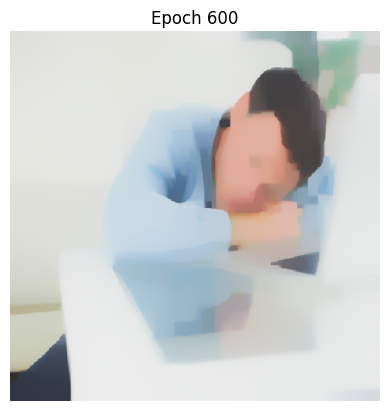

 40%|████      | 602/1500 [04:29<07:07,  2.10it/s]

Inside compute_loss:
Content Loss: 1.3859633440915786e-07, Style Loss: 1.0569708592811367e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 603/1500 [04:29<06:59,  2.14it/s]

Inside compute_loss:
Content Loss: 1.3870833015516837e-07, Style Loss: 1.0569578989816364e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 604/1500 [04:30<06:54,  2.16it/s]

Inside compute_loss:
Content Loss: 1.3882151961297495e-07, Style Loss: 1.056931068887934e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 605/1500 [04:30<06:54,  2.16it/s]

Inside compute_loss:
Content Loss: 1.3893921391172626e-07, Style Loss: 1.0569078767730389e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 606/1500 [04:31<06:54,  2.16it/s]

Inside compute_loss:
Content Loss: 1.390528296951743e-07, Style Loss: 1.056886162587034e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 607/1500 [04:31<06:54,  2.16it/s]

Inside compute_loss:
Content Loss: 1.3916199748109648e-07, Style Loss: 1.0568696779955644e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 608/1500 [04:32<06:42,  2.21it/s]

Inside compute_loss:
Content Loss: 1.3927423481163714e-07, Style Loss: 1.0568327297733049e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 609/1500 [04:32<06:42,  2.21it/s]

Inside compute_loss:
Content Loss: 1.39389456421668e-07, Style Loss: 1.0568251127551775e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 610/1500 [04:33<06:37,  2.24it/s]

Inside compute_loss:
Content Loss: 1.3949924948519765e-07, Style Loss: 1.0567982826614752e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 611/1500 [04:33<06:35,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3960678302282759e-07, Style Loss: 1.0567707704467466e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 612/1500 [04:34<06:34,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3971553869396303e-07, Style Loss: 1.0567589470156236e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 613/1500 [04:34<06:34,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3983006397211284e-07, Style Loss: 1.05673018424568e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 614/1500 [04:34<06:33,  2.25it/s]

Inside compute_loss:
Content Loss: 1.3994558401009272e-07, Style Loss: 1.056697897183767e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 615/1500 [04:35<06:32,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4005853188336914e-07, Style Loss: 1.0566787977950298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 616/1500 [04:35<06:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4017069815963623e-07, Style Loss: 1.0566477612883318e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 617/1500 [04:36<06:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4028735506599332e-07, Style Loss: 1.0566315040705376e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 618/1500 [04:36<06:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4039675022559095e-07, Style Loss: 1.0566070614004275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 619/1500 [04:37<06:28,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4050669960852247e-07, Style Loss: 1.0565719321675715e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 620/1500 [04:37<06:28,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4061696163025772e-07, Style Loss: 1.0565568118181545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 621/1500 [04:38<06:27,  2.27it/s]

Inside compute_loss:
Content Loss: 1.407278062970363e-07, Style Loss: 1.056534188137448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 622/1500 [04:38<06:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4083620669680386e-07, Style Loss: 1.0565187267275178e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 623/1500 [04:38<06:28,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4094554501298262e-07, Style Loss: 1.0564938293100568e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 624/1500 [04:39<06:29,  2.25it/s]

Inside compute_loss:
Content Loss: 1.410581802474553e-07, Style Loss: 1.0564813237579074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 625/1500 [04:39<06:26,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4116876911884901e-07, Style Loss: 1.0564554031589068e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 626/1500 [04:40<06:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4128049485861993e-07, Style Loss: 1.056430392054608e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 627/1500 [04:40<06:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4138939263830252e-07, Style Loss: 1.0564158401393797e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 628/1500 [04:41<06:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4149571825328167e-07, Style Loss: 1.0563869636825984e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 629/1500 [04:41<06:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.416059660641622e-07, Style Loss: 1.0563794603513088e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 630/1500 [04:41<06:28,  2.24it/s]

Inside compute_loss:
Content Loss: 1.417187860397462e-07, Style Loss: 1.0563621799519751e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 631/1500 [04:42<06:28,  2.24it/s]

Inside compute_loss:
Content Loss: 1.4183149232849246e-07, Style Loss: 1.056359337781032e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 632/1500 [04:42<06:29,  2.23it/s]

Inside compute_loss:
Content Loss: 1.4194074537954293e-07, Style Loss: 1.0563383057160536e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 633/1500 [04:43<06:31,  2.21it/s]

Inside compute_loss:
Content Loss: 1.4204664466888062e-07, Style Loss: 1.0563229579929612e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 634/1500 [04:43<06:32,  2.20it/s]

Inside compute_loss:
Content Loss: 1.421494459918904e-07, Style Loss: 1.0562935131019913e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 635/1500 [04:44<06:38,  2.17it/s]

Inside compute_loss:
Content Loss: 1.4225297206849064e-07, Style Loss: 1.056278506439412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 636/1500 [04:44<06:28,  2.22it/s]

Inside compute_loss:
Content Loss: 1.4235826029107557e-07, Style Loss: 1.0562595207375125e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 637/1500 [04:45<06:25,  2.24it/s]

Inside compute_loss:
Content Loss: 1.4246690227537329e-07, Style Loss: 1.0562249599388451e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 638/1500 [04:45<06:23,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4257940961215354e-07, Style Loss: 1.056200062521384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 639/1500 [04:46<06:21,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4269363646235433e-07, Style Loss: 1.0561763019723003e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 640/1500 [04:46<06:21,  2.25it/s]

Inside compute_loss:
Content Loss: 1.428044669182782e-07, Style Loss: 1.056152314049541e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 641/1500 [04:46<06:20,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4291032357505173e-07, Style Loss: 1.0561375347606372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 642/1500 [04:47<06:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4301366491054068e-07, Style Loss: 1.0561242334006238e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 643/1500 [04:47<06:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.43120630013982e-07, Style Loss: 1.056089445228281e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 644/1500 [04:48<06:19,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4322777985853463e-07, Style Loss: 1.0560682994764647e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 645/1500 [04:48<06:18,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4333694764445681e-07, Style Loss: 1.0560521559455083e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 646/1500 [04:49<06:16,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4344978183089552e-07, Style Loss: 1.0560291912042885e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 647/1500 [04:49<06:16,  2.27it/s]

Inside compute_loss:
Content Loss: 1.435603564914345e-07, Style Loss: 1.056010205502389e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 648/1500 [04:50<06:16,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4366864320436434e-07, Style Loss: 1.0559986094449414e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 649/1500 [04:50<06:16,  2.26it/s]

Inside compute_loss:
Content Loss: 1.437746988131039e-07, Style Loss: 1.0559720067249145e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 650/1500 [04:50<06:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.438855719015919e-07, Style Loss: 1.0559682550592697e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 651/1500 [04:51<06:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.439923238422125e-07, Style Loss: 1.0559449492575368e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 652/1500 [04:51<06:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4409521043035056e-07, Style Loss: 1.0559145948718651e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 653/1500 [04:52<06:13,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4419946126054128e-07, Style Loss: 1.055888105838676e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 654/1500 [04:52<06:13,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4430780481688998e-07, Style Loss: 1.0558865142229479e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 655/1500 [04:53<06:12,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4441333462400507e-07, Style Loss: 1.0558569556451403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 656/1500 [04:53<06:11,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4451960339556535e-07, Style Loss: 1.0558463827692322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 657/1500 [04:53<06:11,  2.27it/s]

Inside compute_loss:
Content Loss: 1.4462916908541956e-07, Style Loss: 1.05583501408546e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 658/1500 [04:54<06:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.447329651682594e-07, Style Loss: 1.0558046596997883e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 659/1500 [04:54<06:18,  2.22it/s]

Inside compute_loss:
Content Loss: 1.4483633492545778e-07, Style Loss: 1.0557885161688318e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 660/1500 [04:55<06:19,  2.21it/s]

Inside compute_loss:
Content Loss: 1.4493969047180144e-07, Style Loss: 1.0557629366303445e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 661/1500 [04:55<06:16,  2.23it/s]

Inside compute_loss:
Content Loss: 1.4504944090276695e-07, Style Loss: 1.0557376981523703e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 662/1500 [04:56<06:23,  2.19it/s]

Inside compute_loss:
Content Loss: 1.45152029062956e-07, Style Loss: 1.0557306495684315e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 663/1500 [04:56<06:23,  2.18it/s]

Inside compute_loss:
Content Loss: 1.4525670621878817e-07, Style Loss: 1.0557233736108174e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 664/1500 [04:57<06:16,  2.22it/s]

Inside compute_loss:
Content Loss: 1.453603175605167e-07, Style Loss: 1.055695747709251e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 665/1500 [04:57<06:16,  2.22it/s]

Inside compute_loss:
Content Loss: 1.4546039039942116e-07, Style Loss: 1.055681423167698e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 666/1500 [04:58<06:13,  2.23it/s]

Inside compute_loss:
Content Loss: 1.455632485658498e-07, Style Loss: 1.0556502729741624e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 667/1500 [04:58<06:14,  2.23it/s]

Inside compute_loss:
Content Loss: 1.4566903416834975e-07, Style Loss: 1.0556367442404735e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 668/1500 [04:58<06:08,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4577285867289902e-07, Style Loss: 1.0556292409091839e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 669/1500 [04:59<06:07,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4587358521112037e-07, Style Loss: 1.0556175311648985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 670/1500 [04:59<06:06,  2.26it/s]

Inside compute_loss:
Content Loss: 1.459778502521658e-07, Style Loss: 1.0555987728366745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 671/1500 [05:00<06:05,  2.27it/s]

Inside compute_loss:
Content Loss: 1.460848864098807e-07, Style Loss: 1.055581378750503e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 672/1500 [05:00<06:06,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4619409682836704e-07, Style Loss: 1.0555612561802263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 673/1500 [05:01<06:05,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4630413147642685e-07, Style Loss: 1.0555468179518357e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 674/1500 [05:01<06:06,  2.25it/s]

Inside compute_loss:
Content Loss: 1.464052274968708e-07, Style Loss: 1.0555337439654977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 675/1500 [05:02<06:05,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4650831303697487e-07, Style Loss: 1.0555289691183134e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 676/1500 [05:02<06:05,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4661094382972806e-07, Style Loss: 1.0555116887189797e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 677/1500 [05:02<06:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4671201142846257e-07, Style Loss: 1.0554979326116154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 678/1500 [05:03<06:04,  2.26it/s]

Inside compute_loss:
Content Loss: 1.468111321401011e-07, Style Loss: 1.0554806522122817e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 679/1500 [05:03<06:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4691183025661303e-07, Style Loss: 1.0554676919127814e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 680/1500 [05:04<06:02,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4701535633321328e-07, Style Loss: 1.0554609843893559e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 681/1500 [05:04<06:03,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4711980611537e-07, Style Loss: 1.0554355185377062e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 682/1500 [05:05<06:02,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4722859020821488e-07, Style Loss: 1.055403799909982e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 683/1500 [05:05<06:02,  2.26it/s]

Inside compute_loss:
Content Loss: 1.473349868774676e-07, Style Loss: 1.0553924312262097e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 684/1500 [05:06<06:01,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4743886822543573e-07, Style Loss: 1.0553904985499685e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 685/1500 [05:06<06:00,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4754003530015325e-07, Style Loss: 1.0553801530477358e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 686/1500 [05:06<06:01,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4763820388452586e-07, Style Loss: 1.0553607125984854e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 687/1500 [05:07<06:08,  2.21it/s]

Inside compute_loss:
Content Loss: 1.4773642931231734e-07, Style Loss: 1.0553451375017175e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 688/1500 [05:07<06:07,  2.21it/s]

Inside compute_loss:
Content Loss: 1.4783658741635008e-07, Style Loss: 1.0553213769526337e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 689/1500 [05:08<06:05,  2.22it/s]

Inside compute_loss:
Content Loss: 1.4793668867696397e-07, Style Loss: 1.0553037554927869e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 690/1500 [05:08<06:11,  2.18it/s]

Inside compute_loss:
Content Loss: 1.4803508463501203e-07, Style Loss: 1.0552885214565322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 691/1500 [05:09<06:10,  2.19it/s]

Inside compute_loss:
Content Loss: 1.4813447535289015e-07, Style Loss: 1.0552836329225102e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 692/1500 [05:09<06:03,  2.23it/s]

Inside compute_loss:
Content Loss: 1.482304412547819e-07, Style Loss: 1.055264874594286e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 693/1500 [05:10<06:01,  2.23it/s]

Inside compute_loss:
Content Loss: 1.4832986039436946e-07, Style Loss: 1.0552367939453688e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 694/1500 [05:10<06:01,  2.23it/s]

Inside compute_loss:
Content Loss: 1.4843031692635122e-07, Style Loss: 1.055224061019544e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 695/1500 [05:10<05:58,  2.24it/s]

Inside compute_loss:
Content Loss: 1.4853148400106875e-07, Style Loss: 1.0552042795097805e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 696/1500 [05:11<05:57,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4863064734527143e-07, Style Loss: 1.055202005773026e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 697/1500 [05:11<05:56,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4872975384605525e-07, Style Loss: 1.055179154718644e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 698/1500 [05:12<05:57,  2.25it/s]

Inside compute_loss:
Content Loss: 1.4883092092077277e-07, Style Loss: 1.0551921150181442e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 699/1500 [05:12<05:54,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4893231536916574e-07, Style Loss: 1.0551661944191437e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 700/1500 [05:13<05:53,  2.26it/s]

Inside compute_loss:
Content Loss: 1.4903169187618914e-07, Style Loss: 1.0551430023042485e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4912851042936381e-07, Style Loss: 1.0551316336204764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [667.0254], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 700, Loss: 667.025391, Alpha: 10.0000, Beta: 10.0000


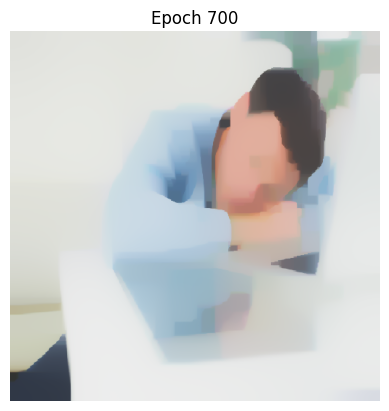

 47%|████▋     | 702/1500 [05:14<06:15,  2.13it/s]

Inside compute_loss:
Content Loss: 1.4922868274425127e-07, Style Loss: 1.0551214018050814e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 703/1500 [05:14<06:08,  2.16it/s]

Inside compute_loss:
Content Loss: 1.4932868452888215e-07, Style Loss: 1.0550992328717257e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 704/1500 [05:15<06:05,  2.18it/s]

Inside compute_loss:
Content Loss: 1.4942644099846802e-07, Style Loss: 1.055085590451199e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 705/1500 [05:15<06:00,  2.20it/s]

Inside compute_loss:
Content Loss: 1.4952586013805558e-07, Style Loss: 1.0550769502515323e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 706/1500 [05:16<05:58,  2.21it/s]

Inside compute_loss:
Content Loss: 1.4962513716909598e-07, Style Loss: 1.055057055054931e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 707/1500 [05:16<05:55,  2.23it/s]

Inside compute_loss:
Content Loss: 1.497267589911644e-07, Style Loss: 1.0550213573878864e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 708/1500 [05:16<05:53,  2.24it/s]

Inside compute_loss:
Content Loss: 1.4982879292801954e-07, Style Loss: 1.0550115803198423e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 709/1500 [05:17<05:54,  2.23it/s]

Inside compute_loss:
Content Loss: 1.4992944841196731e-07, Style Loss: 1.0549903208811884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 710/1500 [05:17<05:51,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5003043074557354e-07, Style Loss: 1.054973722602881e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 711/1500 [05:18<05:49,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5013036147593084e-07, Style Loss: 1.0549582611929509e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 712/1500 [05:18<05:50,  2.25it/s]

Inside compute_loss:
Content Loss: 1.502282884757733e-07, Style Loss: 1.0549489388722577e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 713/1500 [05:19<05:50,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5032863132091734e-07, Style Loss: 1.0549309763518977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 714/1500 [05:19<05:55,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5042817835819733e-07, Style Loss: 1.0549081252975157e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 715/1500 [05:20<05:55,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5052815172111877e-07, Style Loss: 1.054903123076656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 716/1500 [05:20<05:53,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5062367708651436e-07, Style Loss: 1.054888343787752e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 717/1500 [05:20<05:54,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5071726977566868e-07, Style Loss: 1.0548758382356027e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 718/1500 [05:21<05:56,  2.19it/s]

Inside compute_loss:
Content Loss: 1.508168452346581e-07, Style Loss: 1.0548519639996812e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 719/1500 [05:21<05:59,  2.17it/s]

Inside compute_loss:
Content Loss: 1.5091833915903408e-07, Style Loss: 1.0548411637500976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 720/1500 [05:22<05:51,  2.22it/s]

Inside compute_loss:
Content Loss: 1.5102123995802685e-07, Style Loss: 1.0548228601692244e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 721/1500 [05:22<05:49,  2.23it/s]

Inside compute_loss:
Content Loss: 1.5112105700154643e-07, Style Loss: 1.0548111504249391e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 722/1500 [05:23<05:48,  2.23it/s]

Inside compute_loss:
Content Loss: 1.5121912610993604e-07, Style Loss: 1.0547914826020133e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 723/1500 [05:23<05:46,  2.24it/s]

Inside compute_loss:
Content Loss: 1.5131786312849727e-07, Style Loss: 1.0547967121965485e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 724/1500 [05:24<05:45,  2.25it/s]

Inside compute_loss:
Content Loss: 1.514185754558639e-07, Style Loss: 1.0547857982601272e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 725/1500 [05:24<05:44,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5151759669151943e-07, Style Loss: 1.0547840929575614e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 726/1500 [05:24<05:43,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5161360522597533e-07, Style Loss: 1.054774884323706e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 727/1500 [05:25<05:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5170998324265383e-07, Style Loss: 1.054748281603679e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 728/1500 [05:25<05:42,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5180991397301113e-07, Style Loss: 1.0547329338805866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 729/1500 [05:26<05:45,  2.23it/s]

Inside compute_loss:
Content Loss: 1.5191257318747375e-07, Style Loss: 1.0547196325205732e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 730/1500 [05:26<05:39,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5201024439193134e-07, Style Loss: 1.054724179994082e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 731/1500 [05:27<05:39,  2.26it/s]

Inside compute_loss:
Content Loss: 1.52109109308185e-07, Style Loss: 1.0547159945417661e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 732/1500 [05:27<05:40,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5220477678212774e-07, Style Loss: 1.0547013289397e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 733/1500 [05:28<05:38,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5229872474264994e-07, Style Loss: 1.0546752946538618e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 734/1500 [05:28<05:39,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5239533013300388e-07, Style Loss: 1.0546635849095765e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 735/1500 [05:28<05:38,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5249348450652178e-07, Style Loss: 1.0546564226388e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 736/1500 [05:29<05:36,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5259401209277712e-07, Style Loss: 1.0546476687522954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 737/1500 [05:29<05:36,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5269434072706645e-07, Style Loss: 1.0546322073423653e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 738/1500 [05:30<05:37,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5279455567451805e-07, Style Loss: 1.0546142448220053e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 739/1500 [05:30<05:35,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5289064947410225e-07, Style Loss: 1.0545934401307022e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 740/1500 [05:31<05:34,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5298799382890138e-07, Style Loss: 1.0545896884650574e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 741/1500 [05:31<05:35,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5308619083498343e-07, Style Loss: 1.0545744544288027e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 742/1500 [05:32<05:41,  2.22it/s]

Inside compute_loss:
Content Loss: 1.5317986878926604e-07, Style Loss: 1.0545691111474298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 743/1500 [05:32<05:41,  2.22it/s]

Inside compute_loss:
Content Loss: 1.5327361779782223e-07, Style Loss: 1.0545685427132412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 744/1500 [05:32<05:38,  2.23it/s]

Inside compute_loss:
Content Loss: 1.533696973865517e-07, Style Loss: 1.054545350598346e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 745/1500 [05:33<05:43,  2.20it/s]

Inside compute_loss:
Content Loss: 1.5346562065587932e-07, Style Loss: 1.054524545907043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 746/1500 [05:33<05:44,  2.19it/s]

Inside compute_loss:
Content Loss: 1.535567406563132e-07, Style Loss: 1.0545201121203718e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 747/1500 [05:34<05:44,  2.18it/s]

Inside compute_loss:
Content Loss: 1.5364861383204698e-07, Style Loss: 1.0545029454078758e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 748/1500 [05:34<05:36,  2.23it/s]

Inside compute_loss:
Content Loss: 1.5374628503650456e-07, Style Loss: 1.0544912356635905e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 749/1500 [05:35<05:35,  2.24it/s]

Inside compute_loss:
Content Loss: 1.538386698030081e-07, Style Loss: 1.0544895303610247e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 750/1500 [05:35<05:35,  2.24it/s]

Inside compute_loss:
Content Loss: 1.539354315127639e-07, Style Loss: 1.054464064509375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 751/1500 [05:36<05:33,  2.25it/s]

Inside compute_loss:
Content Loss: 1.540334864102988e-07, Style Loss: 1.0544595170358662e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 752/1500 [05:36<05:33,  2.24it/s]

Inside compute_loss:
Content Loss: 1.5412820175697561e-07, Style Loss: 1.054451786330901e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 753/1500 [05:37<05:30,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5422187971125823e-07, Style Loss: 1.054433028002677e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 754/1500 [05:37<05:31,  2.25it/s]

Inside compute_loss:
Content Loss: 1.54313852362975e-07, Style Loss: 1.0544233646214707e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 755/1500 [05:37<05:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.544097614214479e-07, Style Loss: 1.0544143833612907e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 756/1500 [05:38<05:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5450625312496413e-07, Style Loss: 1.054404037859058e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 757/1500 [05:38<05:28,  2.26it/s]

Inside compute_loss:
Content Loss: 1.546042938116443e-07, Style Loss: 1.0543964208409307e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 758/1500 [05:39<05:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.547025334502905e-07, Style Loss: 1.054373797160224e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 759/1500 [05:39<05:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5479541559670906e-07, Style Loss: 1.0543700454945792e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 760/1500 [05:40<05:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5488905091842753e-07, Style Loss: 1.0543858479650225e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 761/1500 [05:40<05:25,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5498328309604403e-07, Style Loss: 1.0543574262555921e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 762/1500 [05:41<05:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5508109640904877e-07, Style Loss: 1.0543486723690876e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 763/1500 [05:41<05:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5517981921675528e-07, Style Loss: 1.0543284361119731e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 764/1500 [05:41<05:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5527680830018653e-07, Style Loss: 1.0543105872784508e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 765/1500 [05:42<05:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5536863884335617e-07, Style Loss: 1.054307290360157e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 766/1500 [05:42<05:24,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5546031306712393e-07, Style Loss: 1.054303993441863e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 767/1500 [05:43<05:23,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5555212939943885e-07, Style Loss: 1.0542938753133058e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 768/1500 [05:43<05:23,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5564735633688542e-07, Style Loss: 1.0543016060182708e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 769/1500 [05:44<05:23,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5574569545151462e-07, Style Loss: 1.0542756854192703e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 770/1500 [05:44<05:23,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5583913182126707e-07, Style Loss: 1.054277049661323e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 771/1500 [05:45<05:29,  2.21it/s]

Inside compute_loss:
Content Loss: 1.559327245104214e-07, Style Loss: 1.0542781865297002e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 772/1500 [05:45<05:29,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5602530822889094e-07, Style Loss: 1.0542651125433622e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 773/1500 [05:45<05:27,  2.22it/s]

Inside compute_loss:
Content Loss: 1.561210041245431e-07, Style Loss: 1.0542421478021424e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 774/1500 [05:46<05:31,  2.19it/s]

Inside compute_loss:
Content Loss: 1.5621937166088173e-07, Style Loss: 1.0542423751758179e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 775/1500 [05:46<05:32,  2.18it/s]

Inside compute_loss:
Content Loss: 1.5631626126832998e-07, Style Loss: 1.0542205473029753e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 776/1500 [05:47<05:24,  2.23it/s]

Inside compute_loss:
Content Loss: 1.5641192874227272e-07, Style Loss: 1.0542127029111725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 777/1500 [05:47<05:22,  2.24it/s]

Inside compute_loss:
Content Loss: 1.565078093790362e-07, Style Loss: 1.0542113386691199e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 778/1500 [05:48<05:22,  2.24it/s]

Inside compute_loss:
Content Loss: 1.566054947943485e-07, Style Loss: 1.054202698469453e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 779/1500 [05:48<05:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5670271125145518e-07, Style Loss: 1.0541861001911457e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 780/1500 [05:49<05:20,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5680151932428998e-07, Style Loss: 1.0541841675149044e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 781/1500 [05:49<05:19,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5690055477080023e-07, Style Loss: 1.0541747315073735e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 782/1500 [05:49<05:20,  2.24it/s]

Inside compute_loss:
Content Loss: 1.5699488642439974e-07, Style Loss: 1.054172116710106e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 783/1500 [05:50<05:17,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5708866385466536e-07, Style Loss: 1.054161089086847e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 784/1500 [05:50<05:16,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5718285339971771e-07, Style Loss: 1.0541551773712854e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 785/1500 [05:51<05:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5727756874639454e-07, Style Loss: 1.0541432402533246e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 786/1500 [05:51<05:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5737413150418433e-07, Style Loss: 1.0541274377828813e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 787/1500 [05:52<05:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.574684205252197e-07, Style Loss: 1.05411004369671e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 788/1500 [05:52<05:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5756316429360595e-07, Style Loss: 1.0541049277890124e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 789/1500 [05:53<05:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5765924388233543e-07, Style Loss: 1.0540896937527577e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 790/1500 [05:53<05:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5775519557337248e-07, Style Loss: 1.0540857147134375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 791/1500 [05:53<05:13,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5784640083893464e-07, Style Loss: 1.054076506079582e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 792/1500 [05:54<05:13,  2.26it/s]

Inside compute_loss:
Content Loss: 1.579400361606531e-07, Style Loss: 1.054075255524367e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 793/1500 [05:54<05:12,  2.27it/s]

Inside compute_loss:
Content Loss: 1.5803853159468417e-07, Style Loss: 1.054054450833064e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 794/1500 [05:55<05:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5813397169495147e-07, Style Loss: 1.0540394441704848e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 795/1500 [05:55<05:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5822948284949234e-07, Style Loss: 1.054018525792344e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 796/1500 [05:56<05:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5832411293104087e-07, Style Loss: 1.0539984032220673e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 797/1500 [05:56<05:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.584165971735274e-07, Style Loss: 1.0540112498347298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 798/1500 [05:57<05:11,  2.25it/s]

Inside compute_loss:
Content Loss: 1.585084845601159e-07, Style Loss: 1.0539940831222339e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 799/1500 [05:57<05:17,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5860173618875706e-07, Style Loss: 1.0539935146880453e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 800/1500 [05:57<05:16,  2.21it/s]

Inside compute_loss:
Content Loss: 1.586942204312436e-07, Style Loss: 1.0539868071646197e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5878926262757886e-07, Style Loss: 1.05397282368358e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [634.8628], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 800, Loss: 634.862793, Alpha: 10.0000, Beta: 10.0000


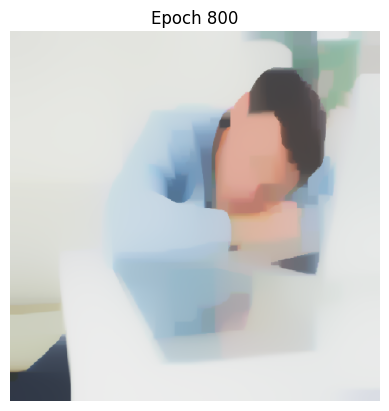

 53%|█████▎    | 802/1500 [05:59<05:44,  2.02it/s]

Inside compute_loss:
Content Loss: 1.588802405194656e-07, Style Loss: 1.053975665854523e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 803/1500 [05:59<05:38,  2.06it/s]

Inside compute_loss:
Content Loss: 1.5897010996468453e-07, Style Loss: 1.0539578170210007e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 804/1500 [05:59<05:25,  2.14it/s]

Inside compute_loss:
Content Loss: 1.590603773138355e-07, Style Loss: 1.0539578170210007e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 805/1500 [06:00<05:20,  2.17it/s]

Inside compute_loss:
Content Loss: 1.5915445317205013e-07, Style Loss: 1.0539594086367288e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 806/1500 [06:00<05:16,  2.19it/s]

Inside compute_loss:
Content Loss: 1.5924844376513647e-07, Style Loss: 1.0539423556110705e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 807/1500 [06:01<05:13,  2.21it/s]

Inside compute_loss:
Content Loss: 1.5934089958591358e-07, Style Loss: 1.053931100614136e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 808/1500 [06:01<05:09,  2.23it/s]

Inside compute_loss:
Content Loss: 1.5943386699746043e-07, Style Loss: 1.0539174581936095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 809/1500 [06:02<05:07,  2.24it/s]

Inside compute_loss:
Content Loss: 1.5952561227550177e-07, Style Loss: 1.0539154118305305e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 810/1500 [06:02<05:06,  2.25it/s]

Inside compute_loss:
Content Loss: 1.5961806809627888e-07, Style Loss: 1.0539210961724166e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 811/1500 [06:03<05:07,  2.24it/s]

Inside compute_loss:
Content Loss: 1.5971244238244253e-07, Style Loss: 1.0539147297095042e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 812/1500 [06:03<05:06,  2.25it/s]

Inside compute_loss:
Content Loss: 1.598028944727048e-07, Style Loss: 1.0539057484493242e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 813/1500 [06:03<05:05,  2.25it/s]

Inside compute_loss:
Content Loss: 1.598981640427155e-07, Style Loss: 1.053879259416135e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 814/1500 [06:04<05:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.5999030722468888e-07, Style Loss: 1.0538850574448588e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 815/1500 [06:04<05:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6008347358820174e-07, Style Loss: 1.0538730066400603e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 816/1500 [06:05<05:02,  2.26it/s]

Inside compute_loss:
Content Loss: 1.60174025154447e-07, Style Loss: 1.0538868764342624e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 817/1500 [06:05<05:02,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6026625360154867e-07, Style Loss: 1.053867435985012e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 818/1500 [06:06<05:00,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6035879468745406e-07, Style Loss: 1.0538655033087707e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 819/1500 [06:06<05:00,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6045673589815124e-07, Style Loss: 1.0538606147747487e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 820/1500 [06:07<05:00,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6055274443260714e-07, Style Loss: 1.0538517472014064e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 821/1500 [06:07<04:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6064704766449722e-07, Style Loss: 1.0538308288232656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 822/1500 [06:07<04:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.607419903848495e-07, Style Loss: 1.053815935847524e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 823/1500 [06:08<04:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6083419041024172e-07, Style Loss: 1.0538107062529889e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 824/1500 [06:08<04:58,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6092364774067391e-07, Style Loss: 1.05380865988991e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 825/1500 [06:09<04:57,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6101800781598286e-07, Style Loss: 1.0538001333770808e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 826/1500 [06:09<04:58,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6111334844026715e-07, Style Loss: 1.0537739854044048e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 827/1500 [06:10<05:03,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6120661427976302e-07, Style Loss: 1.0537746675254311e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 828/1500 [06:10<05:02,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6130053381857579e-07, Style Loss: 1.0537872867644182e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 829/1500 [06:11<05:02,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6139904346346157e-07, Style Loss: 1.0537793286857777e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6149397197295912e-07, Style Loss: 1.0537789876252646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 831/1500 [06:12<05:06,  2.18it/s]

Inside compute_loss:
Content Loss: 1.6158413984612707e-07, Style Loss: 1.0537753496464575e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 832/1500 [06:12<05:00,  2.23it/s]

Inside compute_loss:
Content Loss: 1.616718492414293e-07, Style Loss: 1.0537540902078035e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 833/1500 [06:12<04:58,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6176225869912741e-07, Style Loss: 1.0537569323787466e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 834/1500 [06:13<04:58,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6185640561161563e-07, Style Loss: 1.0537416983424919e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 835/1500 [06:13<04:56,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6194944407743606e-07, Style Loss: 1.0537337402638514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 836/1500 [06:14<04:54,  2.25it/s]

Inside compute_loss:
Content Loss: 1.62046248419756e-07, Style Loss: 1.0537164598645177e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 837/1500 [06:14<04:54,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6214380593737587e-07, Style Loss: 1.0536883792156004e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 838/1500 [06:15<04:52,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6223708598772646e-07, Style Loss: 1.0536872423472232e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 839/1500 [06:15<04:52,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6232722543918499e-07, Style Loss: 1.0536740546740475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 840/1500 [06:15<04:52,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6241729383636994e-07, Style Loss: 1.0536775789660169e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 841/1500 [06:16<04:51,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6250442058662884e-07, Style Loss: 1.0536800800764468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 842/1500 [06:16<04:51,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6259726010048325e-07, Style Loss: 1.0536726904319949e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 843/1500 [06:17<04:51,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6269446234673524e-07, Style Loss: 1.0536692798268632e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 844/1500 [06:17<04:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.627859518293917e-07, Style Loss: 1.053649384630262e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 845/1500 [06:18<04:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6287754078803118e-07, Style Loss: 1.0536472245803452e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 846/1500 [06:18<04:50,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6297269667120418e-07, Style Loss: 1.0536321042309282e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 847/1500 [06:19<04:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6306654515574337e-07, Style Loss: 1.0536292620599852e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 848/1500 [06:19<04:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6315804884925456e-07, Style Loss: 1.0536269883232308e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 849/1500 [06:19<04:47,  2.27it/s]

Inside compute_loss:
Content Loss: 1.632471793300283e-07, Style Loss: 1.0536157333262963e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 850/1500 [06:20<04:46,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6334125518824294e-07, Style Loss: 1.0536083436818444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 851/1500 [06:20<04:46,  2.27it/s]

Inside compute_loss:
Content Loss: 1.634354447332953e-07, Style Loss: 1.053608116308169e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 852/1500 [06:21<04:46,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6352943532638164e-07, Style Loss: 1.0536103900449234e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 853/1500 [06:21<04:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6362274379844166e-07, Style Loss: 1.0536010677242302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 854/1500 [06:22<04:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6371875233289757e-07, Style Loss: 1.053596633937559e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 855/1500 [06:22<04:50,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6381476086735347e-07, Style Loss: 1.053586856869515e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 856/1500 [06:23<04:50,  2.22it/s]

Inside compute_loss:
Content Loss: 1.639112525708697e-07, Style Loss: 1.053572191267449e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 857/1500 [06:23<04:50,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6400497315771645e-07, Style Loss: 1.0535724186411244e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 858/1500 [06:24<04:54,  2.18it/s]

Inside compute_loss:
Content Loss: 1.6410133696354023e-07, Style Loss: 1.0535628689467558e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 859/1500 [06:24<04:54,  2.17it/s]

Inside compute_loss:
Content Loss: 1.6419511439380585e-07, Style Loss: 1.0535454748605844e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 860/1500 [06:24<04:50,  2.20it/s]

Inside compute_loss:
Content Loss: 1.642856517491964e-07, Style Loss: 1.0535559340496548e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 861/1500 [06:25<04:46,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6437805072655465e-07, Style Loss: 1.0535484307183651e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 862/1500 [06:25<04:44,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6446919914869795e-07, Style Loss: 1.0535311503190314e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 863/1500 [06:26<04:43,  2.25it/s]

Inside compute_loss:
Content Loss: 1.645588980636603e-07, Style Loss: 1.0535479759710142e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 864/1500 [06:26<04:42,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6464986174469232e-07, Style Loss: 1.0535441106185317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 865/1500 [06:27<04:42,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6474392339205224e-07, Style Loss: 1.0535279670875752e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 866/1500 [06:27<04:41,  2.26it/s]

Inside compute_loss:
Content Loss: 1.648362513151369e-07, Style Loss: 1.053521486937825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 867/1500 [06:28<04:40,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6492488441599562e-07, Style Loss: 1.0535143246670486e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 868/1500 [06:28<04:40,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6501904553933855e-07, Style Loss: 1.0535128467381583e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 869/1500 [06:28<04:39,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6511881995029398e-07, Style Loss: 1.0535065939620836e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 870/1500 [06:29<04:39,  2.25it/s]

Inside compute_loss:
Content Loss: 1.652153969189385e-07, Style Loss: 1.0534861303312937e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 871/1500 [06:29<04:39,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6530873381270794e-07, Style Loss: 1.053481469170947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 872/1500 [06:30<04:38,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6539944169835508e-07, Style Loss: 1.053479422807868e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 873/1500 [06:30<04:37,  2.26it/s]

Inside compute_loss:
Content Loss: 1.654934180805867e-07, Style Loss: 1.0534776038184646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 874/1500 [06:31<04:37,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6558618654016755e-07, Style Loss: 1.0534914736126666e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 875/1500 [06:31<04:36,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6567564387059974e-07, Style Loss: 1.0534780585658154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 876/1500 [06:32<04:35,  2.27it/s]

Inside compute_loss:
Content Loss: 1.657654280506904e-07, Style Loss: 1.0534687362451223e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 877/1500 [06:32<04:34,  2.27it/s]

Inside compute_loss:
Content Loss: 1.6585472906172072e-07, Style Loss: 1.0534763532632496e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 878/1500 [06:32<04:36,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6594530904967542e-07, Style Loss: 1.0534575949350256e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 879/1500 [06:33<04:35,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6604002439635224e-07, Style Loss: 1.0534563443798106e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 880/1500 [06:33<04:34,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6613499553841393e-07, Style Loss: 1.0534494094827096e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 881/1500 [06:34<04:33,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6623083354261325e-07, Style Loss: 1.0534336070122663e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 882/1500 [06:34<04:33,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6632573363040137e-07, Style Loss: 1.0534162129260949e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 883/1500 [06:35<04:37,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6642002265143674e-07, Style Loss: 1.0534032526265946e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 884/1500 [06:35<04:38,  2.21it/s]

Inside compute_loss:
Content Loss: 1.6651442535930983e-07, Style Loss: 1.0534155308050686e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 885/1500 [06:36<04:36,  2.22it/s]

Inside compute_loss:
Content Loss: 1.666047069193155e-07, Style Loss: 1.0534103012105334e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.666949174250476e-07, Style Loss: 1.0534097327763448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 887/1500 [06:36<04:40,  2.19it/s]

Inside compute_loss:
Content Loss: 1.6678397685154778e-07, Style Loss: 1.053410869644722e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 888/1500 [06:37<04:35,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6687310733232152e-07, Style Loss: 1.0534004104556516e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 889/1500 [06:37<04:33,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6696715476882673e-07, Style Loss: 1.053397795658384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 890/1500 [06:38<04:33,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6706445649106172e-07, Style Loss: 1.0533865406614495e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 891/1500 [06:38<04:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6716312245534937e-07, Style Loss: 1.0533780141486204e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 892/1500 [06:39<04:29,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6725641671655467e-07, Style Loss: 1.0533698286963045e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 893/1500 [06:39<04:29,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6734323082800984e-07, Style Loss: 1.0533651675359579e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 894/1500 [06:40<04:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6743221920023643e-07, Style Loss: 1.0533681233937386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 895/1500 [06:40<04:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.675268777034944e-07, Style Loss: 1.0533568683968042e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 896/1500 [06:40<04:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.6761931931341678e-07, Style Loss: 1.05336755495955e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 897/1500 [06:41<04:26,  2.26it/s]

Inside compute_loss:
Content Loss: 1.677103824704318e-07, Style Loss: 1.0533502745602163e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 898/1500 [06:41<04:26,  2.26it/s]

Inside compute_loss:
Content Loss: 1.678040462138597e-07, Style Loss: 1.053346295520896e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 899/1500 [06:42<04:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.678972552099367e-07, Style Loss: 1.0533248087085667e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 900/1500 [06:42<04:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.679874657156688e-07, Style Loss: 1.0533318572925054e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.680741235077221e-07, Style Loss: 1.0533353815844748e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [607.4604], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 900, Loss: 607.460388, Alpha: 10.0000, Beta: 10.0000


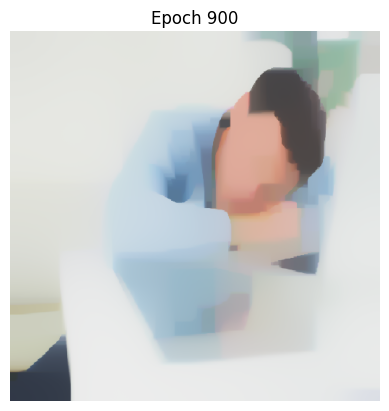

 60%|██████    | 902/1500 [06:43<04:39,  2.14it/s]

Inside compute_loss:
Content Loss: 1.6816210290926392e-07, Style Loss: 1.0533302656767773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 903/1500 [06:44<04:33,  2.18it/s]

Inside compute_loss:
Content Loss: 1.6825067916670378e-07, Style Loss: 1.0533293561820756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 904/1500 [06:44<04:32,  2.19it/s]

Inside compute_loss:
Content Loss: 1.6834617611038993e-07, Style Loss: 1.0533171916904394e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 905/1500 [06:45<04:28,  2.22it/s]

Inside compute_loss:
Content Loss: 1.684396266909971e-07, Style Loss: 1.0533130989642814e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 906/1500 [06:45<04:26,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6852921191912174e-07, Style Loss: 1.053306277754018e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 907/1500 [06:45<04:25,  2.24it/s]

Inside compute_loss:
Content Loss: 1.6861916662946896e-07, Style Loss: 1.0533168506299262e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 908/1500 [06:46<04:23,  2.24it/s]

Inside compute_loss:
Content Loss: 1.6871121033545933e-07, Style Loss: 1.053305481946154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 909/1500 [06:46<04:22,  2.25it/s]

Inside compute_loss:
Content Loss: 1.688028987700818e-07, Style Loss: 1.0533061640671804e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 910/1500 [06:47<04:25,  2.22it/s]

Inside compute_loss:
Content Loss: 1.688985094006057e-07, Style Loss: 1.0532816077102325e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 911/1500 [06:47<04:25,  2.22it/s]

Inside compute_loss:
Content Loss: 1.689942337179673e-07, Style Loss: 1.0532871783652809e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 912/1500 [06:48<04:24,  2.22it/s]

Inside compute_loss:
Content Loss: 1.6908857958242152e-07, Style Loss: 1.0532712622079998e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 913/1500 [06:48<04:25,  2.21it/s]

Inside compute_loss:
Content Loss: 1.691812059334552e-07, Style Loss: 1.0532684200370568e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 914/1500 [06:49<04:27,  2.19it/s]

Inside compute_loss:
Content Loss: 1.6927504020713968e-07, Style Loss: 1.0532481837799423e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.693668565394546e-07, Style Loss: 1.053260575645254e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 916/1500 [06:50<04:21,  2.23it/s]

Inside compute_loss:
Content Loss: 1.6945598702022835e-07, Style Loss: 1.0532702390264603e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 917/1500 [06:50<04:20,  2.24it/s]

Inside compute_loss:
Content Loss: 1.6954669490587548e-07, Style Loss: 1.0532506848903722e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 918/1500 [06:50<04:18,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6964219184956164e-07, Style Loss: 1.0532489795878064e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 919/1500 [06:51<04:18,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6973596927982726e-07, Style Loss: 1.0532598935242277e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 920/1500 [06:51<04:17,  2.25it/s]

Inside compute_loss:
Content Loss: 1.698305140962475e-07, Style Loss: 1.0532505712035345e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 921/1500 [06:52<04:16,  2.25it/s]

Inside compute_loss:
Content Loss: 1.6992463258702628e-07, Style Loss: 1.0532367014093325e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 922/1500 [06:52<04:16,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7001759999857313e-07, Style Loss: 1.05323283605685e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 923/1500 [06:53<04:15,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7011457487114967e-07, Style Loss: 1.0532273790886393e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 924/1500 [06:53<04:15,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7021010023654526e-07, Style Loss: 1.0532252190387226e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 925/1500 [06:54<04:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7030367871484486e-07, Style Loss: 1.0532244232308585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 926/1500 [06:54<04:14,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7039845090494055e-07, Style Loss: 1.053224195857183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 927/1500 [06:54<04:14,  2.25it/s]

Inside compute_loss:
Content Loss: 1.704935783664041e-07, Style Loss: 1.053236474035657e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 928/1500 [06:55<04:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7058795265256776e-07, Style Loss: 1.0532216947467532e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 929/1500 [06:55<04:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.706839043436048e-07, Style Loss: 1.053219762070512e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 930/1500 [06:56<04:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7077564962164615e-07, Style Loss: 1.0532048690947704e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 931/1500 [06:56<04:14,  2.24it/s]

Inside compute_loss:
Content Loss: 1.708632879626748e-07, Style Loss: 1.053209075507766e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 932/1500 [06:57<04:10,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7095250370857684e-07, Style Loss: 1.0532089618209284e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 933/1500 [06:57<04:10,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7103998573020363e-07, Style Loss: 1.0531989573792089e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 934/1500 [06:58<04:10,  2.26it/s]

Inside compute_loss:
Content Loss: 1.71127638282087e-07, Style Loss: 1.0531858833928709e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 935/1500 [06:58<04:09,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7121475082149118e-07, Style Loss: 1.0531859970797086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 936/1500 [06:58<04:09,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7130219021055382e-07, Style Loss: 1.0531912266742438e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 937/1500 [06:59<04:09,  2.26it/s]

Inside compute_loss:
Content Loss: 1.713904254074805e-07, Style Loss: 1.0531894076848403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 938/1500 [06:59<04:11,  2.23it/s]

Inside compute_loss:
Content Loss: 1.7147873165868077e-07, Style Loss: 1.0531847465244937e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 939/1500 [07:00<04:11,  2.23it/s]

Inside compute_loss:
Content Loss: 1.7156894216441287e-07, Style Loss: 1.053178493748419e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 940/1500 [07:00<04:11,  2.22it/s]

Inside compute_loss:
Content Loss: 1.716602042733939e-07, Style Loss: 1.0531758789511514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 941/1500 [07:01<04:13,  2.20it/s]

Inside compute_loss:
Content Loss: 1.7175317168494075e-07, Style Loss: 1.0531762200116646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 942/1500 [07:01<04:13,  2.20it/s]

Inside compute_loss:
Content Loss: 1.7184682121751393e-07, Style Loss: 1.0531629186516511e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7194066970205313e-07, Style Loss: 1.0531721272855066e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 944/1500 [07:02<04:09,  2.23it/s]

Inside compute_loss:
Content Loss: 1.720355271572771e-07, Style Loss: 1.0531693988014013e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 945/1500 [07:02<04:10,  2.22it/s]

Inside compute_loss:
Content Loss: 1.721320899150669e-07, Style Loss: 1.0531591669860063e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 946/1500 [07:03<04:06,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7222835424490768e-07, Style Loss: 1.0531488214837736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 947/1500 [07:03<04:05,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7232336801953352e-07, Style Loss: 1.0531431371418876e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 948/1500 [07:04<04:04,  2.26it/s]

Inside compute_loss:
Content Loss: 1.724144027548391e-07, Style Loss: 1.0531304042160627e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 949/1500 [07:04<04:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7250094686005468e-07, Style Loss: 1.0531293810345232e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 950/1500 [07:05<04:04,  2.25it/s]

Inside compute_loss:
Content Loss: 1.725875193869797e-07, Style Loss: 1.0531248335610144e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 951/1500 [07:05<04:03,  2.26it/s]

Inside compute_loss:
Content Loss: 1.726796909906625e-07, Style Loss: 1.0531185807849397e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 952/1500 [07:06<04:03,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7277194785947358e-07, Style Loss: 1.0531138059377554e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 953/1500 [07:06<04:01,  2.26it/s]

Inside compute_loss:
Content Loss: 1.728655405486279e-07, Style Loss: 1.0531039151828736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 954/1500 [07:06<04:00,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7295597842803545e-07, Style Loss: 1.0531206271480187e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 955/1500 [07:07<04:02,  2.25it/s]

Inside compute_loss:
Content Loss: 1.730450094328262e-07, Style Loss: 1.0531093721510842e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 956/1500 [07:07<04:00,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7313659839146567e-07, Style Loss: 1.0531146017456194e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 957/1500 [07:08<04:00,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7322788892215613e-07, Style Loss: 1.0531070984143298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 958/1500 [07:08<04:00,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7331628043848468e-07, Style Loss: 1.0531098268984351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 959/1500 [07:09<03:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7340390456865862e-07, Style Loss: 1.0531098268984351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 960/1500 [07:09<03:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7349556458157167e-07, Style Loss: 1.0531055067986017e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 961/1500 [07:10<03:58,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7358769355269033e-07, Style Loss: 1.053101300385606e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 962/1500 [07:10<03:58,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7368172677834082e-07, Style Loss: 1.053082542057382e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 963/1500 [07:10<03:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.737721078143295e-07, Style Loss: 1.0530790177654126e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 964/1500 [07:11<03:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7385976036621287e-07, Style Loss: 1.0530810641284916e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 965/1500 [07:11<03:55,  2.27it/s]

Inside compute_loss:
Content Loss: 1.739465460559586e-07, Style Loss: 1.0530778808970354e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 966/1500 [07:12<03:56,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7403175434083096e-07, Style Loss: 1.0530960707910708e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 967/1500 [07:12<04:00,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7411717578852404e-07, Style Loss: 1.0530815188758424e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 968/1500 [07:13<03:59,  2.22it/s]

Inside compute_loss:
Content Loss: 1.742123032499876e-07, Style Loss: 1.053073560797202e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 969/1500 [07:13<03:59,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7430863863410195e-07, Style Loss: 1.0530504823691444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 970/1500 [07:14<04:03,  2.18it/s]

Inside compute_loss:
Content Loss: 1.7440238764265814e-07, Style Loss: 1.0530418421694776e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7449070810471312e-07, Style Loss: 1.0530488907534163e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 972/1500 [07:15<04:04,  2.16it/s]

Inside compute_loss:
Content Loss: 1.745810891407018e-07, Style Loss: 1.0530422969168285e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 973/1500 [07:15<04:04,  2.16it/s]

Inside compute_loss:
Content Loss: 1.746726070450677e-07, Style Loss: 1.0530299050515168e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 974/1500 [07:15<04:01,  2.17it/s]

Inside compute_loss:
Content Loss: 1.7476033065122465e-07, Style Loss: 1.0530397958063986e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 975/1500 [07:16<04:01,  2.17it/s]

Inside compute_loss:
Content Loss: 1.748465621176365e-07, Style Loss: 1.053028654496302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 976/1500 [07:16<04:01,  2.17it/s]

Inside compute_loss:
Content Loss: 1.74934356778067e-07, Style Loss: 1.0530278586884378e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 977/1500 [07:17<04:00,  2.17it/s]

Inside compute_loss:
Content Loss: 1.7502588889328763e-07, Style Loss: 1.053031496667245e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 978/1500 [07:17<03:56,  2.21it/s]

Inside compute_loss:
Content Loss: 1.751165399355159e-07, Style Loss: 1.053028199748951e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 979/1500 [07:18<03:54,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7520541462090478e-07, Style Loss: 1.053040023180074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 980/1500 [07:18<03:53,  2.23it/s]

Inside compute_loss:
Content Loss: 1.7529673357330466e-07, Style Loss: 1.0530255849516834e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 981/1500 [07:19<03:51,  2.24it/s]

Inside compute_loss:
Content Loss: 1.7539021257562126e-07, Style Loss: 1.053017626873043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 982/1500 [07:19<03:51,  2.24it/s]

Inside compute_loss:
Content Loss: 1.754814746846023e-07, Style Loss: 1.053008986673376e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 983/1500 [07:19<03:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7557125886469294e-07, Style Loss: 1.0530100098549156e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 984/1500 [07:20<03:48,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7566138410529675e-07, Style Loss: 1.053017172125692e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 985/1500 [07:20<03:48,  2.26it/s]

Inside compute_loss:
Content Loss: 1.757521204126533e-07, Style Loss: 1.053014329954749e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 986/1500 [07:21<03:48,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7584648048796225e-07, Style Loss: 1.053020014296635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 987/1500 [07:21<03:47,  2.26it/s]

Inside compute_loss:
Content Loss: 1.759388936761752e-07, Style Loss: 1.0530259260121966e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 988/1500 [07:22<03:46,  2.26it/s]

Inside compute_loss:
Content Loss: 1.76031065279858e-07, Style Loss: 1.0530193321756087e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 989/1500 [07:22<03:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7612586589166312e-07, Style Loss: 1.0530091003602138e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 990/1500 [07:23<03:44,  2.27it/s]

Inside compute_loss:
Content Loss: 1.762154937523519e-07, Style Loss: 1.0529896599109634e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 991/1500 [07:23<03:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7630686954817065e-07, Style Loss: 1.0530002327868715e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 992/1500 [07:23<03:44,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7640185490108706e-07, Style Loss: 1.0529939800107968e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 993/1500 [07:24<03:44,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7649320227519638e-07, Style Loss: 1.0529768132983008e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 994/1500 [07:24<03:44,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7658460649272456e-07, Style Loss: 1.0529828387007e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 995/1500 [07:25<03:48,  2.21it/s]

Inside compute_loss:
Content Loss: 1.766774744282884e-07, Style Loss: 1.0529770406719763e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 996/1500 [07:25<03:47,  2.21it/s]

Inside compute_loss:
Content Loss: 1.76771052906588e-07, Style Loss: 1.0529769269851386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 997/1500 [07:26<03:46,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7686382136616885e-07, Style Loss: 1.0529880682952353e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 998/1500 [07:26<03:49,  2.19it/s]

Inside compute_loss:
Content Loss: 1.7695701615139114e-07, Style Loss: 1.0529901146583143e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 999/1500 [07:27<03:49,  2.19it/s]

Inside compute_loss:
Content Loss: 1.7704645927096863e-07, Style Loss: 1.052970219461713e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1000/1500 [07:27<03:50,  2.17it/s]

Inside compute_loss:
Content Loss: 1.7713828981413826e-07, Style Loss: 1.052975903803599e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.772302056224362e-07, Style Loss: 1.052964080372476e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [583.6201], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 1000, Loss: 583.620117, Alpha: 10.0000, Beta: 10.0000


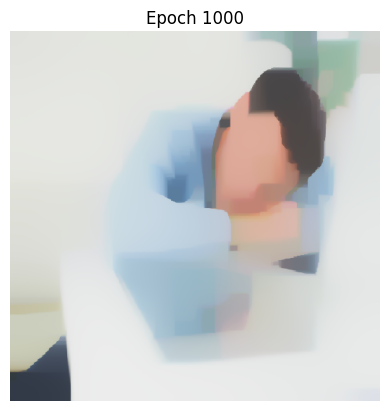

 67%|██████▋   | 1002/1500 [07:28<03:54,  2.12it/s]

Inside compute_loss:
Content Loss: 1.7731854029534588e-07, Style Loss: 1.05296737729077e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1003/1500 [07:29<03:49,  2.17it/s]

Inside compute_loss:
Content Loss: 1.774121329845002e-07, Style Loss: 1.0529488463362213e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1004/1500 [07:29<03:47,  2.18it/s]

Inside compute_loss:
Content Loss: 1.7750609515587712e-07, Style Loss: 1.052946117852116e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1005/1500 [07:29<03:44,  2.20it/s]

Inside compute_loss:
Content Loss: 1.7759953152562957e-07, Style Loss: 1.052945322044252e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1006/1500 [07:30<03:42,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7768707039067522e-07, Style Loss: 1.0529355449762079e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1007/1500 [07:30<03:40,  2.24it/s]

Inside compute_loss:
Content Loss: 1.777740834540964e-07, Style Loss: 1.052947368407331e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1008/1500 [07:31<03:39,  2.24it/s]

Inside compute_loss:
Content Loss: 1.7786295813948527e-07, Style Loss: 1.0529480505283573e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1009/1500 [07:31<03:38,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7795269968701177e-07, Style Loss: 1.0529388418945018e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1010/1500 [07:32<03:37,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7804417495881353e-07, Style Loss: 1.0529410019444185e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1011/1500 [07:32<03:36,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7813493968787952e-07, Style Loss: 1.0529436167416861e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1012/1500 [07:33<03:36,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7822958398028277e-07, Style Loss: 1.0529456631047651e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1013/1500 [07:33<03:36,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7832324772371067e-07, Style Loss: 1.0529485052757082e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1014/1500 [07:33<03:34,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7841584565303492e-07, Style Loss: 1.0529311111895368e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1015/1500 [07:34<03:33,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7851084521680605e-07, Style Loss: 1.052934294420993e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1016/1500 [07:34<03:33,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7860786272194673e-07, Style Loss: 1.0529236078582471e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1017/1500 [07:35<03:33,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7870058854896342e-07, Style Loss: 1.0529359997235588e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1018/1500 [07:35<03:32,  2.27it/s]

Inside compute_loss:
Content Loss: 1.7878808478144492e-07, Style Loss: 1.0529433893680107e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1019/1500 [07:36<03:32,  2.26it/s]

Inside compute_loss:
Content Loss: 1.7888015690914472e-07, Style Loss: 1.052946117852116e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1020/1500 [07:36<03:32,  2.26it/s]

Inside compute_loss:
Content Loss: 1.789763359738572e-07, Style Loss: 1.0529215614951681e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1021/1500 [07:37<03:31,  2.27it/s]

Inside compute_loss:
Content Loss: 1.790725150385697e-07, Style Loss: 1.0529215614951681e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1022/1500 [07:37<03:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.791654540284071e-07, Style Loss: 1.05292247098987e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1023/1500 [07:37<03:35,  2.22it/s]

Inside compute_loss:
Content Loss: 1.792561192814901e-07, Style Loss: 1.0529147402849048e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1024/1500 [07:38<03:34,  2.22it/s]

Inside compute_loss:
Content Loss: 1.793495130186784e-07, Style Loss: 1.0529049632168608e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1025/1500 [07:38<03:34,  2.21it/s]

Inside compute_loss:
Content Loss: 1.7944154251381406e-07, Style Loss: 1.0529047358431853e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1026/1500 [07:39<03:35,  2.20it/s]

Inside compute_loss:
Content Loss: 1.7953119879621227e-07, Style Loss: 1.0528995062486501e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.796163928702299e-07, Style Loss: 1.0528957545830053e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1027/1500 [07:39<03:38,  2.16it/s]

Inside compute_loss:
Content Loss: 1.7970653232168843e-07, Style Loss: 1.0528988241276238e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1029/1500 [07:40<03:33,  2.21it/s]

Inside compute_loss:
Content Loss: 1.7980046607135591e-07, Style Loss: 1.0528918892305228e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1030/1500 [07:41<03:31,  2.22it/s]

Inside compute_loss:
Content Loss: 1.7989219713854254e-07, Style Loss: 1.0528998473091633e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1031/1500 [07:41<03:28,  2.25it/s]

Inside compute_loss:
Content Loss: 1.7997530221691704e-07, Style Loss: 1.052899165188137e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1032/1500 [07:42<03:27,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8005805202392366e-07, Style Loss: 1.0529075780141284e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1033/1500 [07:42<03:27,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8014775093888602e-07, Style Loss: 1.052908146448317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1034/1500 [07:42<03:27,  2.25it/s]

Inside compute_loss:
Content Loss: 1.802445694920607e-07, Style Loss: 1.0529170140216593e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1035/1500 [07:43<03:26,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8034278070899745e-07, Style Loss: 1.0529015526117291e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1036/1500 [07:43<03:26,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8043608918105747e-07, Style Loss: 1.052906100085238e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1037/1500 [07:44<03:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8052799077850068e-07, Style Loss: 1.0528951861488167e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1038/1500 [07:44<03:24,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8061996343021747e-07, Style Loss: 1.0528933671594132e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1039/1500 [07:45<03:24,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8071166607569467e-07, Style Loss: 1.0529015526117291e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1040/1500 [07:45<03:23,  2.26it/s]

Inside compute_loss:
Content Loss: 1.80799020199629e-07, Style Loss: 1.0528949587751413e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1041/1500 [07:46<03:22,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8089083653194393e-07, Style Loss: 1.052891434483172e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1042/1500 [07:46<03:22,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8097851750553673e-07, Style Loss: 1.0528797247388866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1043/1500 [07:46<03:21,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8106787535998592e-07, Style Loss: 1.052877109941619e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1044/1500 [07:47<03:21,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8115861166734248e-07, Style Loss: 1.0528797247388866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1045/1500 [07:47<03:21,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8124842426914256e-07, Style Loss: 1.052873813023325e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1046/1500 [07:48<03:20,  2.26it/s]

Inside compute_loss:
Content Loss: 1.813408090356461e-07, Style Loss: 1.0528618759053643e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1047/1500 [07:48<03:20,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8142804947274271e-07, Style Loss: 1.0528642633289564e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1048/1500 [07:49<03:19,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8151536096411292e-07, Style Loss: 1.0528929124120623e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1049/1500 [07:49<03:19,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8160467618599796e-07, Style Loss: 1.0528995062486501e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1050/1500 [07:49<03:18,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8169600934925256e-07, Style Loss: 1.0528970051382203e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1051/1500 [07:50<03:20,  2.24it/s]

Inside compute_loss:
Content Loss: 1.8178798200096935e-07, Style Loss: 1.0528997336223256e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1052/1500 [07:50<03:20,  2.23it/s]

Inside compute_loss:
Content Loss: 1.8188228523285943e-07, Style Loss: 1.0528864322623122e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1053/1500 [07:51<03:21,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8197819429133233e-07, Style Loss: 1.0528933671594132e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1054/1500 [07:51<03:20,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8207235541467526e-07, Style Loss: 1.0528888196859043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1055/1500 [07:52<03:22,  2.20it/s]

Inside compute_loss:
Content Loss: 1.8216161379314144e-07, Style Loss: 1.0528815437282901e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1056/1500 [07:52<03:23,  2.19it/s]

Inside compute_loss:
Content Loss: 1.822471062951081e-07, Style Loss: 1.0528690381761407e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1057/1500 [07:53<03:18,  2.23it/s]

Inside compute_loss:
Content Loss: 1.82334233045367e-07, Style Loss: 1.0528735856496496e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1058/1500 [07:53<03:18,  2.23it/s]

Inside compute_loss:
Content Loss: 1.8242354826725204e-07, Style Loss: 1.0528902976147947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1059/1500 [07:54<03:16,  2.24it/s]

Inside compute_loss:
Content Loss: 1.825199689164947e-07, Style Loss: 1.052868924489303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1060/1500 [07:54<03:16,  2.23it/s]

Inside compute_loss:
Content Loss: 1.8261677325881465e-07, Style Loss: 1.052865286510496e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1061/1500 [07:54<03:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.827125544195951e-07, Style Loss: 1.0528700613576802e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1062/1500 [07:55<03:14,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8280969982242823e-07, Style Loss: 1.052869379236654e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1063/1500 [07:55<03:13,  2.26it/s]

Inside compute_loss:
Content Loss: 1.829028661859411e-07, Style Loss: 1.0528797247388866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1064/1500 [07:56<03:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8299085979833762e-07, Style Loss: 1.0528788152441848e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1065/1500 [07:56<03:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8308111293663387e-07, Style Loss: 1.0528773373152944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1066/1500 [07:57<03:12,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8316673333629296e-07, Style Loss: 1.0528740403970005e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1067/1500 [07:57<03:11,  2.26it/s]

Inside compute_loss:
Content Loss: 1.832550111657838e-07, Style Loss: 1.0528605116633116e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1068/1500 [07:58<03:10,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8334058893287875e-07, Style Loss: 1.0528482334848377e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1069/1500 [07:58<03:10,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8342463192766445e-07, Style Loss: 1.052865286510496e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1070/1500 [07:58<03:09,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8351556718698703e-07, Style Loss: 1.0528705161050311e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1071/1500 [07:59<03:09,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8360815090545657e-07, Style Loss: 1.052861193784338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1072/1500 [07:59<03:08,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8370432997016906e-07, Style Loss: 1.0528767688811058e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1073/1500 [08:00<03:08,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8379761002051964e-07, Style Loss: 1.052879952112562e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1074/1500 [08:00<03:08,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8388799105650833e-07, Style Loss: 1.0528855227676104e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1075/1500 [08:01<03:07,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8397561518668226e-07, Style Loss: 1.0528671054998995e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1076/1500 [08:01<03:07,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8406792889891221e-07, Style Loss: 1.0528721077207592e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1077/1500 [08:01<03:06,  2.26it/s]

Inside compute_loss:
Content Loss: 1.841569172711388e-07, Style Loss: 1.052864831763145e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1078/1500 [08:02<03:06,  2.26it/s]

Inside compute_loss:
Content Loss: 1.842453372091768e-07, Style Loss: 1.0528651728236582e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1079/1500 [08:02<03:06,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8433577508858434e-07, Style Loss: 1.052857896866044e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1080/1500 [08:03<03:09,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8442943883201224e-07, Style Loss: 1.0528688108024653e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1081/1500 [08:03<03:09,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8452031724791595e-07, Style Loss: 1.0528659686315223e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1082/1500 [08:04<03:08,  2.21it/s]

Inside compute_loss:
Content Loss: 1.846113235615121e-07, Style Loss: 1.0528675602472504e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8469923190878035e-07, Style Loss: 1.0528552820687764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1084/1500 [08:05<03:09,  2.20it/s]

Inside compute_loss:
Content Loss: 1.8479022401152179e-07, Style Loss: 1.0528506209084298e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1085/1500 [08:05<03:08,  2.20it/s]

Inside compute_loss:
Content Loss: 1.84884470399993e-07, Style Loss: 1.052844822879706e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1086/1500 [08:06<03:06,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8497576093068346e-07, Style Loss: 1.0528505072215921e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1087/1500 [08:06<03:05,  2.23it/s]

Inside compute_loss:
Content Loss: 1.850659145929967e-07, Style Loss: 1.052834591064311e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1088/1500 [08:06<03:04,  2.23it/s]

Inside compute_loss:
Content Loss: 1.8515991939693777e-07, Style Loss: 1.052846869242785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1089/1500 [08:07<03:03,  2.24it/s]

Inside compute_loss:
Content Loss: 1.8525376788147696e-07, Style Loss: 1.0528492566663772e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1090/1500 [08:07<03:03,  2.23it/s]

Inside compute_loss:
Content Loss: 1.8534932166858198e-07, Style Loss: 1.0528442544455174e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1091/1500 [08:08<03:01,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8543921953551035e-07, Style Loss: 1.0528357279326883e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1092/1500 [08:08<03:00,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8553646441432647e-07, Style Loss: 1.052838342729956e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1093/1500 [08:09<03:00,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8563265768989368e-07, Style Loss: 1.052841980708763e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1094/1500 [08:09<02:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.857202818200676e-07, Style Loss: 1.0528417533350876e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1095/1500 [08:10<02:59,  2.25it/s]

Inside compute_loss:
Content Loss: 1.858084175410113e-07, Style Loss: 1.0528400480325217e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1096/1500 [08:10<02:59,  2.25it/s]

Inside compute_loss:
Content Loss: 1.858974059132379e-07, Style Loss: 1.0528414122745744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1097/1500 [08:10<02:58,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8598773010580771e-07, Style Loss: 1.0528315215196926e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1098/1500 [08:11<02:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8607897800393403e-07, Style Loss: 1.0528149232413853e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1099/1500 [08:11<02:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8616957220274344e-07, Style Loss: 1.0528344773774734e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1100/1500 [08:12<02:56,  2.27it/s]

Inside compute_loss:
Content Loss: 1.8626258224685444e-07, Style Loss: 1.0528409575272235e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8635114429343957e-07, Style Loss: 1.0528453913138947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [562.2888], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 1100, Loss: 562.288818, Alpha: 10.0000, Beta: 10.0000


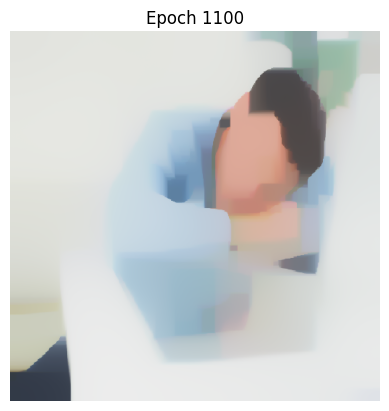

 73%|███████▎  | 1102/1500 [08:13<03:06,  2.14it/s]

Inside compute_loss:
Content Loss: 1.8644152532942826e-07, Style Loss: 1.0528431175771402e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1103/1500 [08:13<03:01,  2.18it/s]

Inside compute_loss:
Content Loss: 1.86530655810202e-07, Style Loss: 1.0528465281822719e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1104/1500 [08:14<03:01,  2.18it/s]

Inside compute_loss:
Content Loss: 1.866186067900344e-07, Style Loss: 1.0528498251005658e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1105/1500 [08:14<02:58,  2.21it/s]

Inside compute_loss:
Content Loss: 1.8670812096388545e-07, Style Loss: 1.0528393659114954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1106/1500 [08:15<02:56,  2.23it/s]

Inside compute_loss:
Content Loss: 1.8679770619201008e-07, Style Loss: 1.0528320899538812e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1107/1500 [08:15<02:57,  2.21it/s]

Inside compute_loss:
Content Loss: 1.868843781949181e-07, Style Loss: 1.0528324310143944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1108/1500 [08:16<02:58,  2.20it/s]

Inside compute_loss:
Content Loss: 1.8697151915603172e-07, Style Loss: 1.0528414122745744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1109/1500 [08:16<02:56,  2.21it/s]

Inside compute_loss:
Content Loss: 1.8706062121509603e-07, Style Loss: 1.0528380016694427e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1110/1500 [08:16<02:55,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8715138594416203e-07, Style Loss: 1.0528433449508157e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1111/1500 [08:17<02:58,  2.18it/s]

Inside compute_loss:
Content Loss: 1.8724161066074885e-07, Style Loss: 1.0528393659114954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1112/1500 [08:17<02:58,  2.17it/s]

Inside compute_loss:
Content Loss: 1.873322474921224e-07, Style Loss: 1.0528334541959339e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1113/1500 [08:18<02:54,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8742848340025375e-07, Style Loss: 1.0528406164667103e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1114/1500 [08:18<02:53,  2.23it/s]

Inside compute_loss:
Content Loss: 1.875281867569356e-07, Style Loss: 1.0528397069720086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1115/1500 [08:19<02:51,  2.24it/s]

Inside compute_loss:
Content Loss: 1.8761859621463373e-07, Style Loss: 1.052841980708763e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1116/1500 [08:19<02:50,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8770674614643212e-07, Style Loss: 1.0528374332352541e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1117/1500 [08:20<02:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.877959903140436e-07, Style Loss: 1.0528449365665438e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1118/1500 [08:20<02:49,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8788692557336617e-07, Style Loss: 1.0528408438403858e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1119/1500 [08:20<02:48,  2.26it/s]

Inside compute_loss:
Content Loss: 1.879780029412359e-07, Style Loss: 1.0528401617193595e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1120/1500 [08:21<02:47,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8807099877449218e-07, Style Loss: 1.0528503935347544e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1121/1500 [08:21<02:47,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8816227509432792e-07, Style Loss: 1.05285459994775e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1122/1500 [08:22<02:47,  2.26it/s]

Inside compute_loss:
Content Loss: 1.882547877585239e-07, Style Loss: 1.0528575558055309e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1123/1500 [08:22<02:47,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8834401771528064e-07, Style Loss: 1.0528592611080967e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1124/1500 [08:23<02:46,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8843320503947325e-07, Style Loss: 1.0528483471716754e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1125/1500 [08:23<02:46,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8851893912597006e-07, Style Loss: 1.052856305250316e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1126/1500 [08:24<02:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.88606563256144e-07, Style Loss: 1.0528623306527152e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1127/1500 [08:24<02:45,  2.26it/s]

Inside compute_loss:
Content Loss: 1.886979958953816e-07, Style Loss: 1.052874267770676e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1128/1500 [08:24<02:44,  2.26it/s]

Inside compute_loss:
Content Loss: 1.887910912046209e-07, Style Loss: 1.0528606253501493e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1129/1500 [08:25<02:43,  2.26it/s]

Inside compute_loss:
Content Loss: 1.888876681732654e-07, Style Loss: 1.0528488019190263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1130/1500 [08:25<02:43,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8898221298968565e-07, Style Loss: 1.0528552820687764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1131/1500 [08:26<02:43,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8907149978986126e-07, Style Loss: 1.0528573284318554e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1132/1500 [08:26<02:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8915862654012017e-07, Style Loss: 1.0528573284318554e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1133/1500 [08:27<02:42,  2.26it/s]

Inside compute_loss:
Content Loss: 1.892489649435447e-07, Style Loss: 1.0528594884817721e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1134/1500 [08:27<02:42,  2.25it/s]

Inside compute_loss:
Content Loss: 1.8934245815671602e-07, Style Loss: 1.0528588063607458e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1135/1500 [08:28<02:41,  2.26it/s]

Inside compute_loss:
Content Loss: 1.8943222812595195e-07, Style Loss: 1.0528582379265572e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1136/1500 [08:28<02:44,  2.21it/s]

Inside compute_loss:
Content Loss: 1.895202359492032e-07, Style Loss: 1.0528551683819387e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1137/1500 [08:28<02:44,  2.21it/s]

Inside compute_loss:
Content Loss: 1.8961132752792764e-07, Style Loss: 1.0528547136345878e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1138/1500 [08:29<02:44,  2.20it/s]

Inside compute_loss:
Content Loss: 1.8970256121519924e-07, Style Loss: 1.0528692655498162e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1139/1500 [08:29<02:45,  2.18it/s]

Inside compute_loss:
Content Loss: 1.8979640969973843e-07, Style Loss: 1.0528477787374868e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1140/1500 [08:30<02:45,  2.17it/s]

Inside compute_loss:
Content Loss: 1.8989170769145858e-07, Style Loss: 1.0528615348448511e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1141/1500 [08:30<02:42,  2.22it/s]

Inside compute_loss:
Content Loss: 1.8998507300693745e-07, Style Loss: 1.052846869242785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1142/1500 [08:31<02:40,  2.23it/s]

Inside compute_loss:
Content Loss: 1.900791630760068e-07, Style Loss: 1.0528428902034648e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1143/1500 [08:31<02:40,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9017056729353499e-07, Style Loss: 1.0528488019190263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1144/1500 [08:32<02:38,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9026253994525177e-07, Style Loss: 1.0528508482821053e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1145/1500 [08:32<02:38,  2.23it/s]

Inside compute_loss:
Content Loss: 1.903510025158539e-07, Style Loss: 1.0528534630793729e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1146/1500 [08:32<02:36,  2.26it/s]

Inside compute_loss:
Content Loss: 1.904426909504764e-07, Style Loss: 1.052857896866044e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1147/1500 [08:33<02:36,  2.26it/s]

Inside compute_loss:
Content Loss: 1.905311250993691e-07, Style Loss: 1.0528500524742412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1148/1500 [08:33<02:35,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9062484568621585e-07, Style Loss: 1.0528494840400526e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1149/1500 [08:34<02:35,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9071485723998194e-07, Style Loss: 1.0528510756557807e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1150/1500 [08:34<02:34,  2.26it/s]

Inside compute_loss:
Content Loss: 1.908014866103258e-07, Style Loss: 1.0528470966164605e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1151/1500 [08:35<02:33,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9089414138306893e-07, Style Loss: 1.0528316352065303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1152/1500 [08:35<02:34,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9098148129614856e-07, Style Loss: 1.0528488019190263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1153/1500 [08:36<02:33,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9106660431589262e-07, Style Loss: 1.0528527809583466e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1154/1500 [08:36<02:32,  2.26it/s]

Inside compute_loss:
Content Loss: 1.911514715402518e-07, Style Loss: 1.052848915605864e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1155/1500 [08:36<02:32,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9123778827179194e-07, Style Loss: 1.0528470966164605e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1156/1500 [08:37<02:31,  2.27it/s]

Inside compute_loss:
Content Loss: 1.913276719278656e-07, Style Loss: 1.0528474376769736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1157/1500 [08:37<02:31,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9142150620155007e-07, Style Loss: 1.052839934345684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1158/1500 [08:38<02:30,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9152003005729057e-07, Style Loss: 1.0528534630793729e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1159/1500 [08:38<02:30,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9161444697601837e-07, Style Loss: 1.0528581242397195e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1160/1500 [08:39<02:29,  2.27it/s]

Inside compute_loss:
Content Loss: 1.917100149739781e-07, Style Loss: 1.0528499387874035e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1161/1500 [08:39<02:29,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9180360766313242e-07, Style Loss: 1.052843231263978e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1162/1500 [08:40<02:29,  2.27it/s]

Inside compute_loss:
Content Loss: 1.918966034963887e-07, Style Loss: 1.0528500524742412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1163/1500 [08:40<02:28,  2.26it/s]

Inside compute_loss:
Content Loss: 1.919864303090435e-07, Style Loss: 1.052847665050649e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1164/1500 [08:40<02:30,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9207853085845272e-07, Style Loss: 1.05284561868757e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1165/1500 [08:41<02:30,  2.22it/s]

Inside compute_loss:
Content Loss: 1.9216734870042274e-07, Style Loss: 1.0528549410082633e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1166/1500 [08:41<02:30,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9225343805828743e-07, Style Loss: 1.0528572147450177e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1167/1500 [08:42<02:31,  2.20it/s]

Inside compute_loss:
Content Loss: 1.9234248327393288e-07, Style Loss: 1.0528616485316888e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1168/1500 [08:42<02:31,  2.19it/s]

Inside compute_loss:
Content Loss: 1.924331769487253e-07, Style Loss: 1.052847665050649e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1169/1500 [08:43<02:31,  2.19it/s]

Inside compute_loss:
Content Loss: 1.9252252059231978e-07, Style Loss: 1.0528424354561139e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1170/1500 [08:43<02:27,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9261017314420315e-07, Style Loss: 1.0528556231292896e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1171/1500 [08:44<02:26,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9269732831617148e-07, Style Loss: 1.052850166161079e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1172/1500 [08:44<02:25,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9278388663224177e-07, Style Loss: 1.0528488019190263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1173/1500 [08:44<02:25,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9287550401259068e-07, Style Loss: 1.0528561915634782e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1174/1500 [08:45<02:24,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9296668085644342e-07, Style Loss: 1.0528533493925352e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1175/1500 [08:45<02:24,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9305666398850008e-07, Style Loss: 1.0528584653002326e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1176/1500 [08:46<02:23,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9314741450671136e-07, Style Loss: 1.0528475513638114e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1177/1500 [08:46<02:22,  2.26it/s]

Inside compute_loss:
Content Loss: 1.93241689316892e-07, Style Loss: 1.0528464144954341e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1178/1500 [08:47<02:22,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9333522516262747e-07, Style Loss: 1.052847665050649e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1179/1500 [08:47<02:22,  2.26it/s]

Inside compute_loss:
Content Loss: 1.934247251256238e-07, Style Loss: 1.0528551683819387e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1180/1500 [08:48<02:22,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9351409719092771e-07, Style Loss: 1.0528746088311891e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1181/1500 [08:48<02:21,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9360679459623498e-07, Style Loss: 1.0528769962547813e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1182/1500 [08:48<02:21,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9370268944385316e-07, Style Loss: 1.0528725624681101e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1183/1500 [08:49<02:20,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9379774585104315e-07, Style Loss: 1.0528671054998995e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1184/1500 [08:49<02:19,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9389186434182193e-07, Style Loss: 1.0528710845392197e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1185/1500 [08:50<02:19,  2.26it/s]

Inside compute_loss:
Content Loss: 1.939871054901232e-07, Style Loss: 1.0528638085816056e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1186/1500 [08:50<02:18,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9407998763654177e-07, Style Loss: 1.0528768825679435e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1187/1500 [08:51<02:18,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9417014129885501e-07, Style Loss: 1.0528685834287899e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1188/1500 [08:51<02:18,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9425722541654977e-07, Style Loss: 1.052879156304698e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1189/1500 [08:52<02:17,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9434678222296498e-07, Style Loss: 1.0528651728236582e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1190/1500 [08:52<02:17,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9444217969066813e-07, Style Loss: 1.0528596021686099e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1191/1500 [08:52<02:16,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9453494815024897e-07, Style Loss: 1.0528602842896362e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1192/1500 [08:53<02:17,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9462522971025464e-07, Style Loss: 1.0528839311518823e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1193/1500 [08:53<02:17,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9471887924282782e-07, Style Loss: 1.0528888196859043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1194/1500 [08:54<02:18,  2.21it/s]

Inside compute_loss:
Content Loss: 1.9481137769616907e-07, Style Loss: 1.0528782468099962e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1195/1500 [08:54<02:18,  2.20it/s]

Inside compute_loss:
Content Loss: 1.948983481270261e-07, Style Loss: 1.0528822258493165e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1196/1500 [08:55<02:18,  2.20it/s]

Inside compute_loss:
Content Loss: 1.9498990866395616e-07, Style Loss: 1.0528838174650446e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1197/1500 [08:55<02:18,  2.18it/s]

Inside compute_loss:
Content Loss: 1.950778170112244e-07, Style Loss: 1.0528794973652111e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1198/1500 [08:56<02:15,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9516879490311112e-07, Style Loss: 1.0528694929234916e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1199/1500 [08:56<02:14,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9526042649431474e-07, Style Loss: 1.052874267770676e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1200/1500 [08:57<02:13,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9535328021902387e-07, Style Loss: 1.0528723350944347e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9544467022569734e-07, Style Loss: 1.0528767688811058e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [543.2563], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 1200, Loss: 543.256287, Alpha: 10.0000, Beta: 10.0000


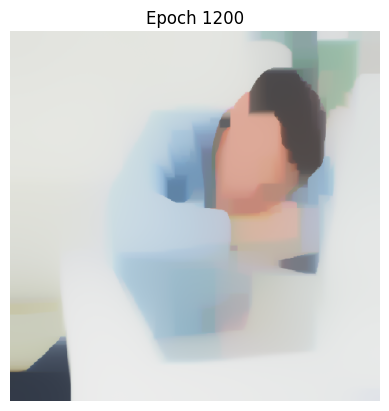

 80%|████████  | 1202/1500 [08:58<02:19,  2.13it/s]

Inside compute_loss:
Content Loss: 1.9553546337647276e-07, Style Loss: 1.0528796110520489e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1203/1500 [08:58<02:16,  2.17it/s]

Inside compute_loss:
Content Loss: 1.9562781972126686e-07, Style Loss: 1.052876655194268e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1204/1500 [08:58<02:15,  2.19it/s]

Inside compute_loss:
Content Loss: 1.9571598386391997e-07, Style Loss: 1.0528825669098296e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1205/1500 [08:59<02:13,  2.21it/s]

Inside compute_loss:
Content Loss: 1.9580558330289932e-07, Style Loss: 1.0528863185754744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1206/1500 [08:59<02:12,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9589816702136886e-07, Style Loss: 1.0528826805966673e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1207/1500 [09:00<02:12,  2.22it/s]

Inside compute_loss:
Content Loss: 1.959916744453949e-07, Style Loss: 1.052869720297167e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1208/1500 [09:00<02:10,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9609136359122203e-07, Style Loss: 1.052879952112562e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1209/1500 [09:01<02:10,  2.24it/s]

Inside compute_loss:
Content Loss: 1.961912516890152e-07, Style Loss: 1.0528747225180268e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1210/1500 [09:01<02:09,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9628812708560872e-07, Style Loss: 1.0528694929234916e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1211/1500 [09:02<02:08,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9638048343040282e-07, Style Loss: 1.0528915481700096e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1212/1500 [09:02<02:07,  2.25it/s]

Inside compute_loss:
Content Loss: 1.964724418712649e-07, Style Loss: 1.05288404483872e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1213/1500 [09:02<02:07,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9656619087982108e-07, Style Loss: 1.0528846132729086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1214/1500 [09:03<02:06,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9666167361265252e-07, Style Loss: 1.0528899565542815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1215/1500 [09:03<02:06,  2.26it/s]

Inside compute_loss:
Content Loss: 1.967541010117202e-07, Style Loss: 1.0528846132729086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1216/1500 [09:04<02:05,  2.26it/s]

Inside compute_loss:
Content Loss: 1.968453346989918e-07, Style Loss: 1.0528899565542815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1217/1500 [09:04<02:05,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9693122510489047e-07, Style Loss: 1.0528904113016324e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1218/1500 [09:05<02:04,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9701839448771352e-07, Style Loss: 1.0528814300414524e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1219/1500 [09:05<02:04,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9710518017745926e-07, Style Loss: 1.0528806342335884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1220/1500 [09:06<02:05,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9719421118225e-07, Style Loss: 1.0528751772653777e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1221/1500 [09:06<02:05,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9728709332866856e-07, Style Loss: 1.0528888196859043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1222/1500 [09:06<02:04,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9738587297979393e-07, Style Loss: 1.0529059863984003e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1223/1500 [09:07<02:05,  2.21it/s]

Inside compute_loss:
Content Loss: 1.9747388080304518e-07, Style Loss: 1.0529115570534486e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1224/1500 [09:07<02:06,  2.18it/s]

Inside compute_loss:
Content Loss: 1.9756173230689456e-07, Style Loss: 1.0529172413953347e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1225/1500 [09:08<02:06,  2.18it/s]

Inside compute_loss:
Content Loss: 1.9765069225741172e-07, Style Loss: 1.0529111023060977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1226/1500 [09:08<02:02,  2.23it/s]

Inside compute_loss:
Content Loss: 1.9774437021169433e-07, Style Loss: 1.0529067822062643e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1227/1500 [09:09<02:02,  2.24it/s]

Inside compute_loss:
Content Loss: 1.978350070430679e-07, Style Loss: 1.0528896154937684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1228/1500 [09:09<02:01,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9792047112332511e-07, Style Loss: 1.0528932534725755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1229/1500 [09:10<02:00,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9801115058726282e-07, Style Loss: 1.0529070095799398e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1230/1500 [09:10<02:00,  2.25it/s]

Inside compute_loss:
Content Loss: 1.981074291279583e-07, Style Loss: 1.0529206520004664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1231/1500 [09:11<01:59,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9820278396309732e-07, Style Loss: 1.0529015526117291e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1232/1500 [09:11<01:59,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9829415975891607e-07, Style Loss: 1.0529054179642117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1233/1500 [09:11<01:58,  2.26it/s]

Inside compute_loss:
Content Loss: 1.983844839514859e-07, Style Loss: 1.052920424626791e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1234/1500 [09:12<01:57,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9848295096380753e-07, Style Loss: 1.0529209930609795e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1235/1500 [09:12<01:57,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9857607469475624e-07, Style Loss: 1.0529131486691767e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1236/1500 [09:13<01:56,  2.26it/s]

Inside compute_loss:
Content Loss: 1.986688715760465e-07, Style Loss: 1.0529194014452514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1237/1500 [09:13<01:56,  2.25it/s]

Inside compute_loss:
Content Loss: 1.9875852785844472e-07, Style Loss: 1.0529103064982337e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1238/1500 [09:14<01:55,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9884839730366366e-07, Style Loss: 1.0529225846767076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1239/1500 [09:14<01:55,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9893791147751472e-07, Style Loss: 1.0529452083574142e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1240/1500 [09:15<01:54,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9902803671811853e-07, Style Loss: 1.0529175824558479e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1241/1500 [09:15<01:54,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9911720983145642e-07, Style Loss: 1.052929405886971e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1242/1500 [09:15<01:54,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9920501870274165e-07, Style Loss: 1.0529300880079973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1243/1500 [09:16<01:53,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9929650818539812e-07, Style Loss: 1.052944071489037e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1244/1500 [09:16<01:53,  2.26it/s]

Inside compute_loss:
Content Loss: 1.993938099076331e-07, Style Loss: 1.0529266774028656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1245/1500 [09:17<01:52,  2.26it/s]

Inside compute_loss:
Content Loss: 1.9948807050695905e-07, Style Loss: 1.0529298606343218e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1246/1500 [09:17<01:51,  2.27it/s]

Inside compute_loss:
Content Loss: 1.995828142753453e-07, Style Loss: 1.0529304290685104e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1247/1500 [09:18<01:51,  2.27it/s]

Inside compute_loss:
Content Loss: 1.9967427533629234e-07, Style Loss: 1.052942479873309e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1248/1500 [09:18<01:52,  2.24it/s]

Inside compute_loss:
Content Loss: 1.9976596377091482e-07, Style Loss: 1.0529313385632122e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1249/1500 [09:19<01:53,  2.22it/s]

Inside compute_loss:
Content Loss: 1.998569842953657e-07, Style Loss: 1.0529221299293567e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1250/1500 [09:19<01:52,  2.21it/s]

Inside compute_loss:
Content Loss: 1.9994475053408678e-07, Style Loss: 1.0529292922001332e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1251/1500 [09:19<01:52,  2.21it/s]

Inside compute_loss:
Content Loss: 2.0003164991067024e-07, Style Loss: 1.0529422524996335e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1252/1500 [09:20<01:53,  2.19it/s]

Inside compute_loss:
Content Loss: 2.0011422918742028e-07, Style Loss: 1.0529257679081638e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1253/1500 [09:20<01:53,  2.18it/s]

Inside compute_loss:
Content Loss: 2.0020603130888048e-07, Style Loss: 1.0529270184633788e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1254/1500 [09:21<01:50,  2.23it/s]

Inside compute_loss:
Content Loss: 2.003041004172701e-07, Style Loss: 1.0529397513892036e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1255/1500 [09:21<01:49,  2.24it/s]

Inside compute_loss:
Content Loss: 2.0039682624428679e-07, Style Loss: 1.0529452083574142e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1256/1500 [09:22<01:48,  2.24it/s]

Inside compute_loss:
Content Loss: 2.004878041361735e-07, Style Loss: 1.0529589644647785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1257/1500 [09:22<01:48,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0057962046848843e-07, Style Loss: 1.0529498695177608e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1258/1500 [09:23<01:47,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0067385264610493e-07, Style Loss: 1.0529549854254583e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1259/1500 [09:23<01:46,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0077230544757185e-07, Style Loss: 1.052946117852116e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1260/1500 [09:23<01:47,  2.24it/s]

Inside compute_loss:
Content Loss: 2.008681718734806e-07, Style Loss: 1.0529513474466512e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1261/1500 [09:24<01:45,  2.26it/s]

Inside compute_loss:
Content Loss: 2.009606276942577e-07, Style Loss: 1.052949755830923e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1262/1500 [09:24<01:44,  2.27it/s]

Inside compute_loss:
Content Loss: 2.0105188980323874e-07, Style Loss: 1.0529470273468178e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1263/1500 [09:25<01:44,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0114269716486888e-07, Style Loss: 1.0529569181016996e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1264/1500 [09:25<01:44,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0123309241171228e-07, Style Loss: 1.0529553264859715e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1265/1500 [09:26<01:43,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0132536349137808e-07, Style Loss: 1.0529529390623793e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1266/1500 [09:26<01:43,  2.26it/s]

Inside compute_loss:
Content Loss: 2.014194109278833e-07, Style Loss: 1.0529677183512831e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1267/1500 [09:27<01:43,  2.25it/s]

Inside compute_loss:
Content Loss: 2.015086835172042e-07, Style Loss: 1.0529747669352219e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1268/1500 [09:27<01:42,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0160071301233984e-07, Style Loss: 1.0529711289564148e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1269/1500 [09:27<01:42,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0169716208329191e-07, Style Loss: 1.0529545306781074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1270/1500 [09:28<01:41,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0178664783543354e-07, Style Loss: 1.0529506653256249e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1271/1500 [09:28<01:41,  2.26it/s]

Inside compute_loss:
Content Loss: 2.018789615476635e-07, Style Loss: 1.0529711289564148e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1272/1500 [09:29<01:40,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0197232686314237e-07, Style Loss: 1.0529685141591472e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1273/1500 [09:29<01:40,  2.26it/s]

Inside compute_loss:
Content Loss: 2.02063858978363e-07, Style Loss: 1.0529766996114631e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1274/1500 [09:30<01:40,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0215394158640265e-07, Style Loss: 1.052968173098634e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1275/1500 [09:30<01:39,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0224136676461058e-07, Style Loss: 1.0529788596613798e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1276/1500 [09:31<01:39,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0232937458786182e-07, Style Loss: 1.0529830660743755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1277/1500 [09:31<01:40,  2.21it/s]

Inside compute_loss:
Content Loss: 2.024181640081224e-07, Style Loss: 1.0529895462241257e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1278/1500 [09:31<01:40,  2.21it/s]

Inside compute_loss:
Content Loss: 2.0250615762051893e-07, Style Loss: 1.0529778364798403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1279/1500 [09:32<01:40,  2.21it/s]

Inside compute_loss:
Content Loss: 2.0259420807633433e-07, Style Loss: 1.0529893188504502e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1280/1500 [09:32<01:40,  2.18it/s]

Inside compute_loss:
Content Loss: 2.0268107903120836e-07, Style Loss: 1.0529879546083976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.027704795182217e-07, Style Loss: 1.0529752216825727e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1282/1500 [09:33<01:38,  2.22it/s]

Inside compute_loss:
Content Loss: 2.0286053370455193e-07, Style Loss: 1.0529872724873712e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1283/1500 [09:34<01:37,  2.23it/s]

Inside compute_loss:
Content Loss: 2.0295345848353463e-07, Style Loss: 1.0529852261242922e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1284/1500 [09:34<01:36,  2.24it/s]

Inside compute_loss:
Content Loss: 2.0304723591380025e-07, Style Loss: 1.0529950031923363e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1285/1500 [09:35<01:35,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0313723325671162e-07, Style Loss: 1.0529927294555819e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1286/1500 [09:35<01:35,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0322782745552104e-07, Style Loss: 1.0530083045523497e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1287/1500 [09:35<01:34,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0331918904048507e-07, Style Loss: 1.053020810104499e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1288/1500 [09:36<01:34,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0340506523552904e-07, Style Loss: 1.053022060659714e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1289/1500 [09:36<01:33,  2.26it/s]

Inside compute_loss:
Content Loss: 2.034968247244251e-07, Style Loss: 1.0530129657126963e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1290/1500 [09:37<01:33,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0358886843041546e-07, Style Loss: 1.0530279723752756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1291/1500 [09:37<01:32,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0368315745145082e-07, Style Loss: 1.0530036433920031e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1292/1500 [09:38<01:31,  2.27it/s]

Inside compute_loss:
Content Loss: 2.037805302279594e-07, Style Loss: 1.053006940310297e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1293/1500 [09:38<01:31,  2.26it/s]

Inside compute_loss:
Content Loss: 2.038712096918971e-07, Style Loss: 1.0530064855629462e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1294/1500 [09:39<01:31,  2.26it/s]

Inside compute_loss:
Content Loss: 2.039619744209631e-07, Style Loss: 1.0530153531362885e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1295/1500 [09:39<01:30,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0405205702900275e-07, Style Loss: 1.0530161489441525e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1296/1500 [09:39<01:30,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0413973800259555e-07, Style Loss: 1.0530147847020999e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1297/1500 [09:40<01:30,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0422993429747294e-07, Style Loss: 1.0530067129366216e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1298/1500 [09:40<01:29,  2.27it/s]

Inside compute_loss:
Content Loss: 2.0432055691799178e-07, Style Loss: 1.0530218332860386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1299/1500 [09:41<01:28,  2.27it/s]

Inside compute_loss:
Content Loss: 2.044122737743237e-07, Style Loss: 1.0530303597988677e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1300/1500 [09:41<01:28,  2.27it/s]

Inside compute_loss:
Content Loss: 2.045022000629615e-07, Style Loss: 1.0530366125749424e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0458908522869024e-07, Style Loss: 1.053035930453916e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [526.2448], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 1300, Loss: 526.244812, Alpha: 10.0000, Beta: 10.0000


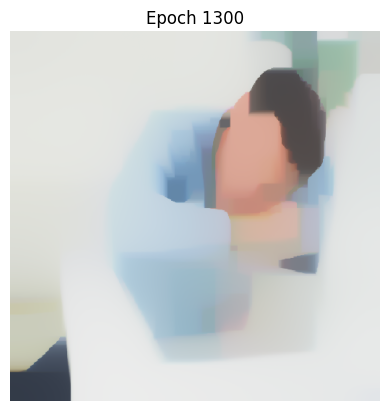

 87%|████████▋ | 1302/1500 [09:42<01:32,  2.13it/s]

Inside compute_loss:
Content Loss: 2.0467969363835437e-07, Style Loss: 1.0530357030802406e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1303/1500 [09:43<01:30,  2.18it/s]

Inside compute_loss:
Content Loss: 2.0477186524203717e-07, Style Loss: 1.0530475265113637e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1304/1500 [09:43<01:30,  2.16it/s]

Inside compute_loss:
Content Loss: 2.048657421482858e-07, Style Loss: 1.0530221743465518e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1305/1500 [09:44<01:29,  2.17it/s]

Inside compute_loss:
Content Loss: 2.0495896535521752e-07, Style Loss: 1.0530268355068984e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1306/1500 [09:44<01:28,  2.18it/s]

Inside compute_loss:
Content Loss: 2.0504927533693262e-07, Style Loss: 1.053026608133223e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1307/1500 [09:45<01:28,  2.18it/s]

Inside compute_loss:
Content Loss: 2.051383489742875e-07, Style Loss: 1.0530254712648457e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.052292842336101e-07, Style Loss: 1.0530293366173282e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1309/1500 [09:45<01:27,  2.17it/s]

Inside compute_loss:
Content Loss: 2.0532360167635488e-07, Style Loss: 1.0530137615205604e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1310/1500 [09:46<01:25,  2.22it/s]

Inside compute_loss:
Content Loss: 2.054114816019137e-07, Style Loss: 1.0530230838412535e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1311/1500 [09:46<01:24,  2.23it/s]

Inside compute_loss:
Content Loss: 2.0550423585063982e-07, Style Loss: 1.0530210374781745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1312/1500 [09:47<01:24,  2.23it/s]

Inside compute_loss:
Content Loss: 2.0560308655603876e-07, Style Loss: 1.053022060659714e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1313/1500 [09:47<01:23,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0569881087340036e-07, Style Loss: 1.0530238796491176e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1314/1500 [09:48<01:22,  2.26it/s]

Inside compute_loss:
Content Loss: 2.057926167253754e-07, Style Loss: 1.0530389999985346e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1315/1500 [09:48<01:22,  2.24it/s]

Inside compute_loss:
Content Loss: 2.0588781524111255e-07, Style Loss: 1.053016376317828e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1316/1500 [09:49<01:21,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0597849470505025e-07, Style Loss: 1.0530243343964685e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1317/1500 [09:49<01:20,  2.26it/s]

Inside compute_loss:
Content Loss: 2.060701405071086e-07, Style Loss: 1.0530487770665786e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1318/1500 [09:49<01:20,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0615711093796563e-07, Style Loss: 1.0530353620197275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1319/1500 [09:50<01:20,  2.26it/s]

Inside compute_loss:
Content Loss: 2.062438255734378e-07, Style Loss: 1.053028995556815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1320/1500 [09:50<01:19,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0633194708352676e-07, Style Loss: 1.0530487770665786e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1321/1500 [09:51<01:20,  2.23it/s]

Inside compute_loss:
Content Loss: 2.0642102072088164e-07, Style Loss: 1.053055143529491e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1322/1500 [09:51<01:18,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0651532395277172e-07, Style Loss: 1.0530603731240262e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1323/1500 [09:52<01:18,  2.26it/s]

Inside compute_loss:
Content Loss: 2.066137341216745e-07, Style Loss: 1.053047412824526e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1324/1500 [09:52<01:17,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0670444200732163e-07, Style Loss: 1.0530626468607807e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1325/1500 [09:53<01:17,  2.26it/s]

Inside compute_loss:
Content Loss: 2.067988162934853e-07, Style Loss: 1.053062078426592e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1326/1500 [09:53<01:17,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0689073210178321e-07, Style Loss: 1.053060032063513e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1327/1500 [09:53<01:16,  2.26it/s]

Inside compute_loss:
Content Loss: 2.069826194883717e-07, Style Loss: 1.0530676490816404e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1328/1500 [09:54<01:16,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0707723535906553e-07, Style Loss: 1.0530541203479515e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1329/1500 [09:54<01:15,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0716608162274497e-07, Style Loss: 1.0530534382269252e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1330/1500 [09:55<01:15,  2.26it/s]

Inside compute_loss:
Content Loss: 2.072560505439469e-07, Style Loss: 1.0530434337852057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1331/1500 [09:55<01:14,  2.26it/s]

Inside compute_loss:
Content Loss: 2.073514764333595e-07, Style Loss: 1.0530436611588812e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1332/1500 [09:56<01:14,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0744845130593603e-07, Style Loss: 1.053046958077175e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1333/1500 [09:56<01:15,  2.22it/s]

Inside compute_loss:
Content Loss: 2.0754184504312434e-07, Style Loss: 1.0530454801482847e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1334/1500 [09:57<01:14,  2.22it/s]

Inside compute_loss:
Content Loss: 2.0763094710218866e-07, Style Loss: 1.0530629879212938e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1335/1500 [09:57<01:14,  2.21it/s]

Inside compute_loss:
Content Loss: 2.0772239395228098e-07, Style Loss: 1.0530683312026667e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1336/1500 [09:58<01:14,  2.20it/s]

Inside compute_loss:
Content Loss: 2.0781469345365622e-07, Style Loss: 1.0530618510529166e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1337/1500 [09:58<01:14,  2.19it/s]

Inside compute_loss:
Content Loss: 2.07906467153407e-07, Style Loss: 1.0530679901421536e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1338/1500 [09:58<01:14,  2.18it/s]

Inside compute_loss:
Content Loss: 2.0799616606836935e-07, Style Loss: 1.0530627605476184e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1339/1500 [09:59<01:12,  2.22it/s]

Inside compute_loss:
Content Loss: 2.080827670170038e-07, Style Loss: 1.053065375344886e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1340/1500 [09:59<01:11,  2.23it/s]

Inside compute_loss:
Content Loss: 2.0817647339299583e-07, Style Loss: 1.0530698091315571e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1341/1500 [10:00<01:10,  2.24it/s]

Inside compute_loss:
Content Loss: 2.0826531965667527e-07, Style Loss: 1.0530746976655792e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1342/1500 [10:00<01:10,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0835581437950168e-07, Style Loss: 1.0530767440286581e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1343/1500 [10:01<01:09,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0845125447976898e-07, Style Loss: 1.05307515241293e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1344/1500 [10:01<01:09,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0854780302670406e-07, Style Loss: 1.0530642384765088e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1345/1500 [10:02<01:08,  2.26it/s]

Inside compute_loss:
Content Loss: 2.086430157532959e-07, Style Loss: 1.0530712870604475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1346/1500 [10:02<01:08,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0873643791219365e-07, Style Loss: 1.0530698091315571e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1347/1500 [10:02<01:07,  2.25it/s]

Inside compute_loss:
Content Loss: 2.088240762532223e-07, Style Loss: 1.053064920597535e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1348/1500 [10:03<01:07,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0891620522434096e-07, Style Loss: 1.0530783356443862e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1349/1500 [10:03<01:06,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0900876052110107e-07, Style Loss: 1.0530819736231933e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1350/1500 [10:04<01:06,  2.26it/s]

Inside compute_loss:
Content Loss: 2.091000368409368e-07, Style Loss: 1.0530775398365222e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1351/1500 [10:04<01:06,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0918905363487283e-07, Style Loss: 1.0530925464991014e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1352/1500 [10:05<01:05,  2.26it/s]

Inside compute_loss:
Content Loss: 2.092801736353067e-07, Style Loss: 1.053098003467312e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1353/1500 [10:05<01:05,  2.26it/s]

Inside compute_loss:
Content Loss: 2.093757984766853e-07, Style Loss: 1.0530989129620139e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1354/1500 [10:05<01:04,  2.26it/s]

Inside compute_loss:
Content Loss: 2.094761839543935e-07, Style Loss: 1.053095957104233e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1355/1500 [10:06<01:04,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0957270407961914e-07, Style Loss: 1.0530927738727769e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1356/1500 [10:06<01:03,  2.26it/s]

Inside compute_loss:
Content Loss: 2.096676325891167e-07, Style Loss: 1.053093569680641e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1357/1500 [10:07<01:03,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0976266057459725e-07, Style Loss: 1.0530906138228602e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1358/1500 [10:07<01:02,  2.26it/s]

Inside compute_loss:
Content Loss: 2.0985258686323505e-07, Style Loss: 1.0530919780649128e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1359/1500 [10:08<01:02,  2.25it/s]

Inside compute_loss:
Content Loss: 2.0994114890982019e-07, Style Loss: 1.0531026646276587e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1360/1500 [10:08<01:01,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1002942673931102e-07, Style Loss: 1.0531047109907377e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1361/1500 [10:09<01:01,  2.26it/s]

Inside compute_loss:
Content Loss: 2.101218541383787e-07, Style Loss: 1.0531073257880053e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1362/1500 [10:09<01:02,  2.22it/s]

Inside compute_loss:
Content Loss: 2.102201079878796e-07, Style Loss: 1.0531177849770756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1363/1500 [10:10<01:01,  2.21it/s]

Inside compute_loss:
Content Loss: 2.103161023114808e-07, Style Loss: 1.0531209682085318e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1364/1500 [10:10<01:01,  2.21it/s]

Inside compute_loss:
Content Loss: 2.1040783337866742e-07, Style Loss: 1.0531208545216941e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1365/1500 [10:10<01:01,  2.19it/s]

Inside compute_loss:
Content Loss: 2.1050141185696702e-07, Style Loss: 1.0531305179029005e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1366/1500 [10:11<01:01,  2.18it/s]

Inside compute_loss:
Content Loss: 2.10591679206118e-07, Style Loss: 1.0531161933613475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1367/1500 [10:11<01:00,  2.20it/s]

Inside compute_loss:
Content Loss: 2.106798433487711e-07, Style Loss: 1.0531207408348564e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1368/1500 [10:12<00:59,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1076787959373178e-07, Style Loss: 1.0531165344218607e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1369/1500 [10:12<00:58,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1086172807827097e-07, Style Loss: 1.0531234693189617e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1370/1500 [10:13<00:57,  2.24it/s]

Inside compute_loss:
Content Loss: 2.1095685553973453e-07, Style Loss: 1.0531084626563825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1371/1500 [10:13<00:57,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1105374514718278e-07, Style Loss: 1.053121764016396e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1372/1500 [10:14<00:56,  2.25it/s]

Inside compute_loss:
Content Loss: 2.111501515855707e-07, Style Loss: 1.0531128964430536e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1373/1500 [10:14<00:56,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1124513693848712e-07, Style Loss: 1.0531182397244265e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1374/1500 [10:14<00:55,  2.26it/s]

Inside compute_loss:
Content Loss: 2.113371095902039e-07, Style Loss: 1.0531252883083653e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1375/1500 [10:15<00:55,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1142854222944152e-07, Style Loss: 1.0531306315897382e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1376/1500 [10:15<00:54,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1151812745756615e-07, Style Loss: 1.053130290529225e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1377/1500 [10:16<00:54,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1161434915484278e-07, Style Loss: 1.05312005871383e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1378/1500 [10:16<00:54,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1171256037177955e-07, Style Loss: 1.053126652550418e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1379/1500 [10:17<00:53,  2.26it/s]

Inside compute_loss:
Content Loss: 2.118034814202474e-07, Style Loss: 1.0531276757319574e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1380/1500 [10:17<00:53,  2.26it/s]

Inside compute_loss:
Content Loss: 2.118921003102514e-07, Style Loss: 1.053126652550418e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1381/1500 [10:18<00:52,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1198322031068528e-07, Style Loss: 1.0531332463870058e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1382/1500 [10:18<00:52,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1207544875778694e-07, Style Loss: 1.0531424550208612e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1383/1500 [10:18<00:51,  2.26it/s]

Inside compute_loss:
Content Loss: 2.121712299185674e-07, Style Loss: 1.0531450698181288e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1384/1500 [10:19<00:51,  2.25it/s]

Inside compute_loss:
Content Loss: 2.122635720525068e-07, Style Loss: 1.0531467751206947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1385/1500 [10:19<00:51,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1235128144780901e-07, Style Loss: 1.0531539373914711e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1386/1500 [10:20<00:50,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1244430570277473e-07, Style Loss: 1.0531485941100982e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1387/1500 [10:20<00:50,  2.25it/s]

Inside compute_loss:
Content Loss: 2.125403710806495e-07, Style Loss: 1.0531499583521509e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1388/1500 [10:21<00:49,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1263576854835264e-07, Style Loss: 1.0531382486078655e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1389/1500 [10:21<00:49,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1273244499298016e-07, Style Loss: 1.0531459793128306e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1282374973452534e-07, Style Loss: 1.0531427960813744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1391/1500 [10:22<00:49,  2.21it/s]

Inside compute_loss:
Content Loss: 2.1291613450102886e-07, Style Loss: 1.0531437055760762e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1392/1500 [10:22<00:49,  2.18it/s]

Inside compute_loss:
Content Loss: 2.130057197291535e-07, Style Loss: 1.0531368843658129e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1393/1500 [10:23<00:48,  2.19it/s]

Inside compute_loss:
Content Loss: 2.1309504916189326e-07, Style Loss: 1.0531499583521509e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1318562914984795e-07, Style Loss: 1.0531628049648134e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1395/1500 [10:24<00:48,  2.18it/s]

Inside compute_loss:
Content Loss: 2.132750296368613e-07, Style Loss: 1.0531500720389886e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1396/1500 [10:24<00:46,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1336948918815324e-07, Style Loss: 1.053146206686506e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1397/1500 [10:25<00:45,  2.24it/s]

Inside compute_loss:
Content Loss: 2.1346222922602465e-07, Style Loss: 1.0531407497182954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1398/1500 [10:25<00:45,  2.25it/s]

Inside compute_loss:
Content Loss: 2.135506065314985e-07, Style Loss: 1.0531401812841068e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1399/1500 [10:26<00:44,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1364239444210398e-07, Style Loss: 1.053144160323427e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1400/1500 [10:26<00:44,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1373466552176978e-07, Style Loss: 1.0531607586017344e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1382707870998274e-07, Style Loss: 1.0531573479966028e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [510.87384], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 1400, Loss: 510.873840, Alpha: 10.0000, Beta: 10.0000


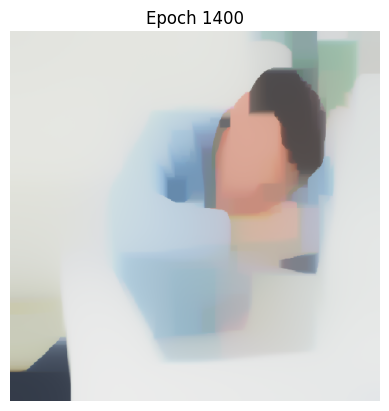

 93%|█████████▎| 1402/1500 [10:27<00:46,  2.12it/s]

Inside compute_loss:
Content Loss: 2.139206998208465e-07, Style Loss: 1.053164169206866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1403/1500 [10:28<00:44,  2.17it/s]

Inside compute_loss:
Content Loss: 2.1401656624675525e-07, Style Loss: 1.0531675798119977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1404/1500 [10:28<00:44,  2.18it/s]

Inside compute_loss:
Content Loss: 2.1411096895462833e-07, Style Loss: 1.0531909993005684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1405/1500 [10:28<00:43,  2.20it/s]

Inside compute_loss:
Content Loss: 2.1420557061446743e-07, Style Loss: 1.0531953194004018e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1406/1500 [10:29<00:42,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1429708851883333e-07, Style Loss: 1.053194864653051e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1407/1500 [10:29<00:41,  2.23it/s]

Inside compute_loss:
Content Loss: 2.1439366548747785e-07, Style Loss: 1.0531856560191954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1408/1500 [10:30<00:41,  2.23it/s]

Inside compute_loss:
Content Loss: 2.1449368148296344e-07, Style Loss: 1.0531717862249934e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1409/1500 [10:30<00:40,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1459511856392055e-07, Style Loss: 1.0531766747590154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1410/1500 [10:31<00:40,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1469298872034415e-07, Style Loss: 1.0531729230933706e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1411/1500 [10:31<00:39,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1478898304394534e-07, Style Loss: 1.0531753105169628e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1412/1500 [10:32<00:39,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1487828405497567e-07, Style Loss: 1.0531798579904716e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1413/1500 [10:32<00:38,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1496565238976473e-07, Style Loss: 1.0531858833928709e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1505353231532354e-07, Style Loss: 1.053197252076643e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1415/1500 [10:33<00:38,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1514385650789336e-07, Style Loss: 1.0532135092944372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1416/1500 [10:33<00:37,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1523847237858718e-07, Style Loss: 1.0532044143474195e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1417/1500 [10:34<00:37,  2.20it/s]

Inside compute_loss:
Content Loss: 2.1533583094424102e-07, Style Loss: 1.0532036185395555e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.154345111193834e-07, Style Loss: 1.053201344802801e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1418/1500 [10:34<00:38,  2.16it/s]

Inside compute_loss:
Content Loss: 2.1553250917349942e-07, Style Loss: 1.0531995258133975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1420/1500 [10:35<00:37,  2.14it/s]

Inside compute_loss:
Content Loss: 2.1562688345966308e-07, Style Loss: 1.053193614097836e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1421/1500 [10:36<00:36,  2.16it/s]

Inside compute_loss:
Content Loss: 2.1571706554368575e-07, Style Loss: 1.0532088481340907e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1422/1500 [10:36<00:36,  2.16it/s]

Inside compute_loss:
Content Loss: 2.15809563997027e-07, Style Loss: 1.0532158967180294e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1423/1500 [10:37<00:35,  2.16it/s]

Inside compute_loss:
Content Loss: 2.158995044965195e-07, Style Loss: 1.0532189662626479e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1424/1500 [10:37<00:35,  2.16it/s]

Inside compute_loss:
Content Loss: 2.1598935973088373e-07, Style Loss: 1.0532235137361567e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1425/1500 [10:38<00:34,  2.20it/s]

Inside compute_loss:
Content Loss: 2.1608263978123432e-07, Style Loss: 1.0532354508541175e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1426/1500 [10:38<00:33,  2.22it/s]

Inside compute_loss:
Content Loss: 2.161797425515033e-07, Style Loss: 1.0532395435802755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1427/1500 [10:38<00:32,  2.23it/s]

Inside compute_loss:
Content Loss: 2.162730510235633e-07, Style Loss: 1.0532505712035345e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1428/1500 [10:39<00:32,  2.24it/s]

Inside compute_loss:
Content Loss: 2.1636974167904555e-07, Style Loss: 1.0532411351960036e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1429/1500 [10:39<00:31,  2.25it/s]

Inside compute_loss:
Content Loss: 2.164626238254641e-07, Style Loss: 1.0532389751460869e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1430/1500 [10:40<00:31,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1655729653957678e-07, Style Loss: 1.0532469332247274e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1431/1500 [10:40<00:30,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1665105975898769e-07, Style Loss: 1.0532453416089993e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1432/1500 [10:41<00:30,  2.27it/s]

Inside compute_loss:
Content Loss: 2.1674584615993808e-07, Style Loss: 1.0532518217587494e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1433/1500 [10:41<00:29,  2.26it/s]

Inside compute_loss:
Content Loss: 2.168461605833727e-07, Style Loss: 1.0532389751460869e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1434/1500 [10:42<00:29,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1693968221825344e-07, Style Loss: 1.0532562555454206e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1435/1500 [10:42<00:28,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1703401387185295e-07, Style Loss: 1.0532477290325915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1436/1500 [10:42<00:28,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1712423858843977e-07, Style Loss: 1.053240112014464e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1437/1500 [10:43<00:27,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1721052689827047e-07, Style Loss: 1.0532517080719117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1438/1500 [10:43<00:27,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1730157584443077e-07, Style Loss: 1.0532589840295259e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1439/1500 [10:44<00:26,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1739954547683737e-07, Style Loss: 1.053255687111232e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1440/1500 [10:44<00:26,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1749498557710467e-07, Style Loss: 1.0532547776165302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1441/1500 [10:45<00:26,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1758545187822165e-07, Style Loss: 1.0532535270613153e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1442/1500 [10:45<00:25,  2.25it/s]

Inside compute_loss:
Content Loss: 2.1767873192857223e-07, Style Loss: 1.0532480700931046e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1443/1500 [10:46<00:25,  2.26it/s]

Inside compute_loss:
Content Loss: 2.177726372565303e-07, Style Loss: 1.0532427268117317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1444/1500 [10:46<00:24,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1786802051337872e-07, Style Loss: 1.0532480700931046e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1445/1500 [10:46<00:24,  2.27it/s]

Inside compute_loss:
Content Loss: 2.179648390665534e-07, Style Loss: 1.0532471605984028e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1446/1500 [10:47<00:23,  2.27it/s]

Inside compute_loss:
Content Loss: 2.1805618644066271e-07, Style Loss: 1.05325079857721e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1447/1500 [10:47<00:23,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1814992123836419e-07, Style Loss: 1.0532700116527849e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1448/1500 [10:48<00:23,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1824213547461113e-07, Style Loss: 1.0532783107919386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1449/1500 [10:48<00:22,  2.22it/s]

Inside compute_loss:
Content Loss: 2.183351170970127e-07, Style Loss: 1.0532645546845743e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1450/1500 [10:49<00:22,  2.22it/s]

Inside compute_loss:
Content Loss: 2.1842811293026898e-07, Style Loss: 1.0532603482715786e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1451/1500 [10:49<00:22,  2.18it/s]

Inside compute_loss:
Content Loss: 2.185296494872091e-07, Style Loss: 1.053262622008333e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1452/1500 [10:50<00:21,  2.19it/s]

Inside compute_loss:
Content Loss: 2.1862673804662336e-07, Style Loss: 1.0532672831686796e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1453/1500 [10:50<00:21,  2.20it/s]

Inside compute_loss:
Content Loss: 2.1872307343073771e-07, Style Loss: 1.0532720580158639e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1454/1500 [10:50<00:20,  2.21it/s]

Inside compute_loss:
Content Loss: 2.1882077305690473e-07, Style Loss: 1.0532685337238945e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1455/1500 [10:51<00:20,  2.23it/s]

Inside compute_loss:
Content Loss: 2.189187995327302e-07, Style Loss: 1.053278992912965e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1456/1500 [10:51<00:19,  2.24it/s]

Inside compute_loss:
Content Loss: 2.1901281854752597e-07, Style Loss: 1.0532770602367236e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1457/1500 [10:52<00:19,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1910504699462763e-07, Style Loss: 1.0532719443290262e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1458/1500 [10:52<00:18,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1919585435625777e-07, Style Loss: 1.0532686474107322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1459/1500 [10:53<00:18,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1928725857378595e-07, Style Loss: 1.0532935448281933e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1460/1500 [10:53<00:17,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1937819383310853e-07, Style Loss: 1.0532929763940047e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1461/1500 [10:54<00:17,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1946618744550506e-07, Style Loss: 1.0532962733122986e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1462/1500 [10:54<00:16,  2.27it/s]

Inside compute_loss:
Content Loss: 2.195566111140579e-07, Style Loss: 1.0533071872487199e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1463/1500 [10:54<00:16,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1964798690987664e-07, Style Loss: 1.053301843967347e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1464/1500 [10:55<00:15,  2.27it/s]

Inside compute_loss:
Content Loss: 2.1974346964270808e-07, Style Loss: 1.053294909070246e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1465/1500 [10:55<00:15,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1984011766562617e-07, Style Loss: 1.0533071872487199e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1466/1500 [10:56<00:15,  2.26it/s]

Inside compute_loss:
Content Loss: 2.1993230348016368e-07, Style Loss: 1.053288769981009e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1467/1500 [10:56<00:14,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2002554089795012e-07, Style Loss: 1.0533066188145312e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1468/1500 [10:57<00:14,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2011397504684282e-07, Style Loss: 1.0533140084589832e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1469/1500 [10:57<00:13,  2.24it/s]

Inside compute_loss:
Content Loss: 2.2020456924565224e-07, Style Loss: 1.0533302656767773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1470/1500 [10:58<00:13,  2.27it/s]

Inside compute_loss:
Content Loss: 2.2029882984497817e-07, Style Loss: 1.0533312888583168e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1471/1500 [10:58<00:12,  2.27it/s]

Inside compute_loss:
Content Loss: 2.203987037319166e-07, Style Loss: 1.0533221939112991e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1472/1500 [10:58<00:12,  2.27it/s]

Inside compute_loss:
Content Loss: 2.204989897336418e-07, Style Loss: 1.053321852850786e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1473/1500 [10:59<00:11,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2059525406348257e-07, Style Loss: 1.0533202612350578e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1474/1500 [10:59<00:11,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2068684302212205e-07, Style Loss: 1.0533293561820756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1475/1500 [11:00<00:11,  2.27it/s]

Inside compute_loss:
Content Loss: 2.2078104677802912e-07, Style Loss: 1.0533362910791766e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1476/1500 [11:00<00:10,  2.22it/s]

Inside compute_loss:
Content Loss: 2.2087574791385123e-07, Style Loss: 1.0533383374422556e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1477/1500 [11:01<00:10,  2.22it/s]

Inside compute_loss:
Content Loss: 2.2097458440839546e-07, Style Loss: 1.0533427712289267e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1478/1500 [11:01<00:09,  2.22it/s]

Inside compute_loss:
Content Loss: 2.2107461461473576e-07, Style Loss: 1.0533448175920057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1479/1500 [11:02<00:09,  2.20it/s]

Inside compute_loss:
Content Loss: 2.2116977049790876e-07, Style Loss: 1.0533444765314925e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1480/1500 [11:02<00:09,  2.18it/s]

Inside compute_loss:
Content Loss: 2.212637610909951e-07, Style Loss: 1.0533534577916726e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2135964172775857e-07, Style Loss: 1.0533401564316591e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1482/1500 [11:03<00:08,  2.22it/s]

Inside compute_loss:
Content Loss: 2.2145587763588992e-07, Style Loss: 1.0533374279475538e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1483/1500 [11:03<00:07,  2.23it/s]

Inside compute_loss:
Content Loss: 2.2155182932692696e-07, Style Loss: 1.0533401564316591e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1484/1500 [11:04<00:07,  2.23it/s]

Inside compute_loss:
Content Loss: 2.2164111612710258e-07, Style Loss: 1.053344249157817e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1485/1500 [11:04<00:06,  2.25it/s]

Inside compute_loss:
Content Loss: 2.2172893920924253e-07, Style Loss: 1.053354480973212e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1486/1500 [11:05<00:06,  2.25it/s]

Inside compute_loss:
Content Loss: 2.2182685199823027e-07, Style Loss: 1.0533640306675807e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1487/1500 [11:05<00:05,  2.25it/s]

Inside compute_loss:
Content Loss: 2.219238126599521e-07, Style Loss: 1.0533522072364576e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1488/1500 [11:06<00:05,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2201807325927803e-07, Style Loss: 1.0533584600125323e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1489/1500 [11:06<00:04,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2211565919860732e-07, Style Loss: 1.0533625527386903e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1490/1500 [11:06<00:04,  2.26it/s]

Inside compute_loss:
Content Loss: 2.22212676703748e-07, Style Loss: 1.053372898240923e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1491/1500 [11:07<00:03,  2.27it/s]

Inside compute_loss:
Content Loss: 2.223111010835055e-07, Style Loss: 1.0533624390518526e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1492/1500 [11:07<00:03,  2.27it/s]

Inside compute_loss:
Content Loss: 2.2240190844513563e-07, Style Loss: 1.0533781278354581e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1493/1500 [11:08<00:03,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2249446374189574e-07, Style Loss: 1.0533763088460546e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1494/1500 [11:08<00:02,  2.27it/s]

Inside compute_loss:
Content Loss: 2.2258774379224633e-07, Style Loss: 1.05337653621973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1495/1500 [11:09<00:02,  2.26it/s]

Inside compute_loss:
Content Loss: 2.2267964538968954e-07, Style Loss: 1.0533864269746118e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1496/1500 [11:09<00:01,  2.27it/s]

Inside compute_loss:
Content Loss: 2.2277662026226608e-07, Style Loss: 1.0533946124269278e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1497/1500 [11:10<00:01,  2.27it/s]

Inside compute_loss:
Content Loss: 2.22870781385609e-07, Style Loss: 1.0533956356084673e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1498/1500 [11:10<00:00,  2.27it/s]

Inside compute_loss:
Content Loss: 2.22966036744765e-07, Style Loss: 1.0533984777794103e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1499/1500 [11:10<00:00,  2.27it/s]

Inside compute_loss:
Content Loss: 2.2306154789930588e-07, Style Loss: 1.053401092576678e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2315315106880007e-07, Style Loss: 1.0534163266129326e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Debug sebelum print:
Loss: [496.94308], Type: <class 'numpy.ndarray'>
Alpha: 10.0, Type: <class 'float'>
Beta: 10.0, Type: <class 'float'>
Epoch 1499, Loss: 496.943085, Alpha: 10.0000, Beta: 10.0000


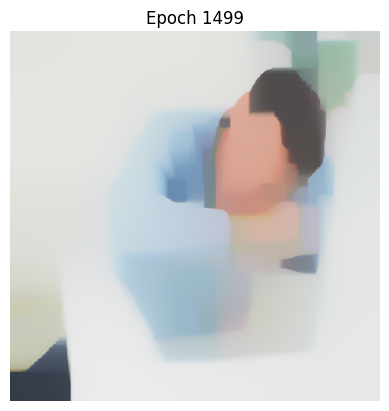

100%|██████████| 1500/1500 [11:11<00:00,  2.23it/s]


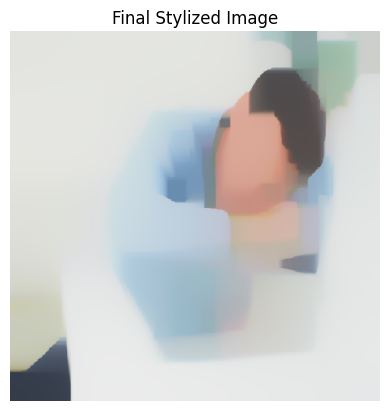

In [ ]:
# # Upload content dan style images
# print("Upload Content Image")
# content_image_path = upload_image()
# print("Upload Style Image")
# style_image_path = upload_image()

# # Preprocess images
# content_image = preprocess_image(content_image_path)
# style_image = preprocess_image(style_image_path)

# # Sebelum training
# start_time = time.time()

# # Train model dengan dynamic weighting
# output_image = train_nst(content_image, style_image, nst_model, epochs=1500, lr=0.001)

# # Setelah training
# end_time = time.time()

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# tf.keras.preprocessing.image.save_img("/content/final_stylized_image.jpg", final_image)


Ditambahkan lebih banyak lapisan convolutional, termasuk lapisan Bottleneck (lapisan tengah dengan lebih banyak filter) untuk menangkap fitur yang lebih kompleks.
Ukuran kernel diperluas untuk memungkinkan model mempelajari konteks yang lebih luas dari gambar.
Lapisan Batch Normalization ditambahkan untuk menstabilkan pelatihan dan mempercepat konvergensi.
Fungsi aktivasi diubah dari sigmoid menjadi ReLU untuk lapisan convolutional awal, memberikan gradien yang lebih kuat selama pelatihan.

Arsitektur yang lebih kompleks: Memungkinkan model mempelajari fitur yang lebih kaya dari gambar.
Dynamic Weighting: Menyediakan keseimbangan adaptif antara content dan style, menghasilkan gambar yang lebih seimbang.
Noise Reduction: Variation loss mengurangi artefak visual pada gambar hasil.
Stabilitas Pelatihan: Batch Normalization membantu mengurangi fluktuasi selama pelatihan.
Debugging Lebih Baik: Membantu melacak error dan memonitor kualitas model di setiap langkah.

Model 1 (Primitif)
Urutan: 1

Alasan:
Model ini hanya terdiri dari layer-layer dasar seperti Conv2D, MaxPooling2D, dan UpSampling2D, tanpa fitur tambahan.
Tidak ada penggunaan Batch Normalization, residual connections, atau mekanisme self-attention.
Desainnya paling sederhana dan tidak dirancang untuk menangkap hubungan kompleks dalam input style.
Model 3 (Menengah)
Urutan: 2

Alasan:
Menambahkan Batch Normalization, yang membantu stabilisasi dan percepatan training dengan menormalisasi aktivasi layer.
Namun, tidak menggunakan fitur yang lebih canggih seperti self-attention atau residual connections.
Model ini memiliki sedikit peningkatan dibandingkan Model 1, tetapi tetap sederhana dalam memahami hubungan kompleks.
Model 2 (Advanced)
Urutan: 3

Alasan:
Menggunakan self-attention mechanism, yang memungkinkan model untuk menangkap dependensi jarak jauh antara piksel.
Menggunakan residual connections yang membantu dalam melatih model lebih dalam tanpa kehilangan informasi penting.
Total parameter lebih besar, dan desainnya dirancang untuk menghasilkan hasil yang lebih halus dan dinamis berdasarkan input style.
Kesimpulan Urutan
Model 1 (Primitif)
Model 3 (Menengah, dengan Batch Normalization)
Model 2 (Advanced, dengan Self-Attention dan Residual Connections)

In [ ]:
# # Self-Attention Layer
# class SelfAttention(layers.Layer):
#     def __init__(self, channels):
#         super(SelfAttention, self).__init__()
#         self.query = layers.Conv2D(channels // 8, kernel_size=1)
#         self.key = layers.Conv2D(channels // 8, kernel_size=1)
#         self.value = layers.Conv2D(channels, kernel_size=1)

#     def call(self, x):
#         q = self.query(x)
#         k = self.key(x)
#         v = self.value(x)

#         attn = tf.nn.softmax(tf.matmul(q, k, transpose_b=True))
#         attn_output = tf.matmul(attn, v)
#         return attn_output + x

# # Residual Block
# def residual_block(x, filters):
#     shortcut = x
#     x = layers.Conv2D(filters, (3, 3), padding='same', activation='relu')(x)
#     x = layers.Conv2D(filters, (3, 3), padding='same')(x)
#     return layers.Add()([x, shortcut])

# # Model NST dengan Self-Attention dan Residual Blocks
# def create_nst_model():
#     inputs = layers.Input(shape=(512, 512, 3))
#     x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(inputs)
#     x = residual_block(x, 64)
#     x = layers.MaxPooling2D((2, 2))(x)

#     x = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
#     x = SelfAttention(128)(x)
#     x = residual_block(x, 128)
#     x = layers.MaxPooling2D((2, 2))(x)

#     x = layers.Conv2D(256, (3, 3), padding='same', activation='relu')(x)
#     x = SelfAttention(256)(x)
#     x = residual_block(x, 256)

#     x = layers.UpSampling2D((2, 2))(x)
#     x = layers.Conv2D(128, (3, 3), padding='same', activation='relu')(x)
#     x = layers.UpSampling2D((2, 2))(x)
#     x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(x)
#     outputs = layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid')(x)

#     return models.Model(inputs, outputs)

# # Fungsi pelatihan
# def train_nst(content_image, style_image, model, epochs=1500, lr=0.001):
#     generated_image = tf.Variable(content_image)
#     optimizer = tf.keras.optimizers.Adam(learning_rate=lr)

#     for epoch in tqdm(range(epochs)):
#         with tf.GradientTape() as tape:
#             loss, alpha, beta = compute_loss(content_image, style_image, generated_image, model)

#         gradients = tape.gradient(loss, [generated_image])
#         optimizer.apply_gradients(zip(gradients, [generated_image]))

#         if epoch % 100 == 0 or epoch == epochs - 1:
#             # Konversi alpha dan beta ke float Python jika masih berupa array/tensor
#             alpha_value = float(alpha) if isinstance(alpha, (np.ndarray, tf.Tensor)) else alpha
#             beta_value = float(beta) if isinstance(beta, (np.ndarray, tf.Tensor)) else beta

#             # Konversi loss ke skalar Python float
#             loss_value = float(loss.numpy()) if isinstance(loss.numpy(), (np.ndarray, tf.Tensor)) else loss.numpy()

#             # Cetak informasi pelatihan
#             print(f"Epoch {epoch}, Loss: {loss_value:.6f}, Alpha: {alpha_value:.4f}, Beta: {beta_value:.4f}")

#             # Visualisasi hasil
#             img = deprocess_image(generated_image)
#             plt.imshow(img)
#             plt.title(f"Epoch {epoch}")
#             plt.axis('off')
#             plt.show()

#     return generated_image

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 512, 512, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_27 (Conv2D)        │ (None, 512, 512, 64)   │          1,792 │ input_layer_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_28 (Conv2D)        │ (None, 512, 512, 64)   │         36,928 │ conv2d_27[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_29 (Conv2D)        │ (None, 512, 512, 64)   │         36,928 │ conv2d_28[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 512, 512, 64)   │              0 │ conv2d_29[0][0],       │
│                           │                        │                │ conv2d_27[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_6           │ (None, 256, 256, 64)   │              0 │ add[0][0]              │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_30 (Conv2D)        │ (None, 256, 256, 128)  │         73,856 │ max_pooling2d_6[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ self_attention            │ (None, 256, 256, 128)  │         20,640 │ conv2d_30[0][0]        │
│ (SelfAttention)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_34 (Conv2D)        │ (None, 256, 256, 128)  │        147,584 │ self_attention[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_35 (Conv2D)        │ (None, 256, 256, 128)  │        147,584 │ conv2d_34[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_1 (Add)               │ (None, 256, 256, 128)  │              0 │ conv2d_35[0][0],       │
│                           │                        │                │ self_attention[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_7           │ (None, 128, 128, 128)  │              0 │ add_1[0][0]            │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_36 (Conv2D)        │ (None, 128, 128, 256)  │        295,168 │ max_pooling2d_7[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ self_attention_1          │ (None, 128, 128, 256)  │         82,240 │ conv2d_36[0][0]        │
│ (SelfAttention)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_40 (Conv2D)        │ (None, 128, 128, 256)  │        590,080 │ self_attention_1[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_41 (Conv2D)        │ (None, 128, 128, 256)  │        590,080 │ conv2d_40[0][0]        │
├──────────────────────

 Total params: 2,393,443 (9.13 MB)

 Trainable params: 2,393,443 (9.13 MB)

 Non-trainable params: 0 (0.00 B)

  0%|          | 0/1500 [00:00<?, ?it/s]

Inside compute_loss:
Content Loss: 0.0, Style Loss: 5.445552346827753e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 0, Loss: 4169.328125, Alpha: 10.0000, Beta: 10.0000


<ipython-input-13-a941beb22b1f>:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  loss_value = float(loss.numpy()) if isinstance(loss.numpy(), (np.ndarray, tf.Tensor)) else loss.numpy()


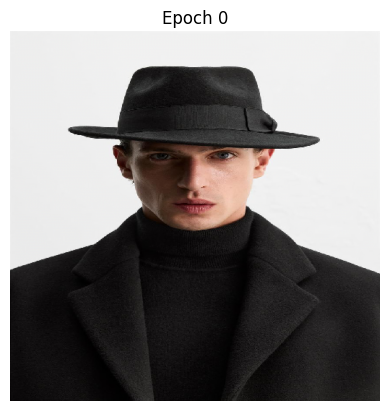

  0%|          | 1/1500 [00:00<22:56,  1.09it/s]

Inside compute_loss:
Content Loss: 1.563297380435813e-09, Style Loss: 5.389676402955956e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 2/1500 [00:01<15:29,  1.61it/s]

Inside compute_loss:
Content Loss: 5.500164323990475e-09, Style Loss: 5.395501716520812e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 3/1500 [00:01<15:59,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1304931213373948e-08, Style Loss: 5.355343546398217e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 4/1500 [00:02<15:46,  1.58it/s]

Inside compute_loss:
Content Loss: 1.900331092485885e-08, Style Loss: 5.303177772475465e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 5/1500 [00:03<15:47,  1.58it/s]

Inside compute_loss:
Content Loss: 2.8558995168737056e-08, Style Loss: 5.256852659840661e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 7/1500 [00:04<15:23,  1.62it/s]

Inside compute_loss:
Content Loss: 3.9426016229526795e-08, Style Loss: 5.221688752499176e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 8/1500 [00:05<15:27,  1.61it/s]

Inside compute_loss:
Content Loss: 5.134331715339613e-08, Style Loss: 5.191445779928472e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 9/1500 [00:05<15:28,  1.61it/s]

Inside compute_loss:
Content Loss: 6.417483433551752e-08, Style Loss: 5.162157208360441e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 10/1500 [00:06<15:30,  1.60it/s]

Inside compute_loss:
Content Loss: 7.792543499363092e-08, Style Loss: 5.132963565301907e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.237837872433374e-08, Style Loss: 5.105127911519958e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 11/1500 [00:07<15:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0726362376090037e-07, Style Loss: 5.079689913145558e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 13/1500 [00:08<15:30,  1.60it/s]

Inside compute_loss:
Content Loss: 1.2243910418874293e-07, Style Loss: 5.056427880845149e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.379385565769553e-07, Style Loss: 5.034532364334154e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 14/1500 [00:08<15:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.536676137448012e-07, Style Loss: 5.012900032852485e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 15/1500 [00:09<15:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6954896864262992e-07, Style Loss: 4.99160933031817e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 16/1500 [00:10<15:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8553072322902153e-07, Style Loss: 4.970997906639241e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 17/1500 [00:10<15:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0156731750375911e-07, Style Loss: 4.950850325258216e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 18/1500 [00:11<15:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1759707635737868e-07, Style Loss: 4.931627017867868e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 19/1500 [00:12<15:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3350280287104397e-07, Style Loss: 4.913060251965362e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 20/1500 [00:12<15:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.492555495337001e-07, Style Loss: 4.895057372777956e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 22/1500 [00:13<15:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.64791850668189e-07, Style Loss: 4.877530841440603e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.8004822638649784e-07, Style Loss: 4.860842750531447e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 23/1500 [00:14<15:49,  1.56it/s]

Inside compute_loss:
Content Loss: 2.9499813081201864e-07, Style Loss: 4.844640102419362e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 24/1500 [00:15<15:50,  1.55it/s]

Inside compute_loss:
Content Loss: 3.0963227004576765e-07, Style Loss: 4.82895075037959e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 25/1500 [00:15<15:58,  1.54it/s]

Inside compute_loss:
Content Loss: 3.238809256345121e-07, Style Loss: 4.813758209820662e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 27/1500 [00:17<15:33,  1.58it/s]

Inside compute_loss:
Content Loss: 3.3776345276237407e-07, Style Loss: 4.799255179932516e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 28/1500 [00:17<15:35,  1.57it/s]

Inside compute_loss:
Content Loss: 3.51337661186335e-07, Style Loss: 4.785032388099353e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.645864978807367e-07, Style Loss: 4.771247290591418e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 29/1500 [00:18<15:38,  1.57it/s]

Inside compute_loss:
Content Loss: 3.776070514049934e-07, Style Loss: 4.7576966721862846e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 30/1500 [00:19<15:38,  1.57it/s]

Inside compute_loss:
Content Loss: 3.9026551235110674e-07, Style Loss: 4.744756552099716e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 31/1500 [00:19<15:38,  1.56it/s]

Inside compute_loss:
Content Loss: 4.025447708499996e-07, Style Loss: 4.7322950535999553e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 32/1500 [00:20<15:37,  1.57it/s]

Inside compute_loss:
Content Loss: 4.144504828218487e-07, Style Loss: 4.7201896791193576e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 33/1500 [00:20<15:38,  1.56it/s]

Inside compute_loss:
Content Loss: 4.2602525240909017e-07, Style Loss: 4.708608685177751e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 34/1500 [00:21<15:41,  1.56it/s]

Inside compute_loss:
Content Loss: 4.3722977238758176e-07, Style Loss: 4.6973914891168533e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 35/1500 [00:22<15:36,  1.56it/s]

Inside compute_loss:
Content Loss: 4.4807765675614064e-07, Style Loss: 4.6866554725966125e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 36/1500 [00:22<15:39,  1.56it/s]

Inside compute_loss:
Content Loss: 4.5859201236453373e-07, Style Loss: 4.676197420394601e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 37/1500 [00:23<15:39,  1.56it/s]

Inside compute_loss:
Content Loss: 4.6878903958713636e-07, Style Loss: 4.6664919750583067e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 38/1500 [00:24<15:39,  1.56it/s]

Inside compute_loss:
Content Loss: 4.786755312125024e-07, Style Loss: 4.6569942924179486e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 39/1500 [00:24<15:39,  1.55it/s]

Inside compute_loss:
Content Loss: 4.882406301476294e-07, Style Loss: 4.647685045711114e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 40/1500 [00:25<15:42,  1.55it/s]

Inside compute_loss:
Content Loss: 4.97486951189785e-07, Style Loss: 4.638812072244036e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 41/1500 [00:26<15:40,  1.55it/s]

Inside compute_loss:
Content Loss: 5.064025572210085e-07, Style Loss: 4.6303699718919233e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 42/1500 [00:26<15:57,  1.52it/s]

Inside compute_loss:
Content Loss: 5.149945536686573e-07, Style Loss: 4.6221006755331473e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 43/1500 [00:27<15:53,  1.53it/s]

Inside compute_loss:
Content Loss: 5.232571425040078e-07, Style Loss: 4.614207114173041e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 44/1500 [00:28<15:53,  1.53it/s]

Inside compute_loss:
Content Loss: 5.312108442012686e-07, Style Loss: 4.6067711423347646e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 45/1500 [00:28<16:04,  1.51it/s]

Inside compute_loss:
Content Loss: 5.389195507632394e-07, Style Loss: 4.599598639742908e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 46/1500 [00:29<15:37,  1.55it/s]

Inside compute_loss:
Content Loss: 5.46373883025808e-07, Style Loss: 4.5924929281682125e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 47/1500 [00:30<15:38,  1.55it/s]

Inside compute_loss:
Content Loss: 5.534952833841089e-07, Style Loss: 4.5859482611376734e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 48/1500 [00:30<15:37,  1.55it/s]

Inside compute_loss:
Content Loss: 5.602999522125174e-07, Style Loss: 4.5797747816322953e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 49/1500 [00:31<15:37,  1.55it/s]

Inside compute_loss:
Content Loss: 5.668291009897075e-07, Style Loss: 4.5737266418655054e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 50/1500 [00:31<15:33,  1.55it/s]

Inside compute_loss:
Content Loss: 5.731507144446368e-07, Style Loss: 4.5679962568101473e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 52/1500 [00:33<15:32,  1.55it/s]

Inside compute_loss:
Content Loss: 5.792108481728064e-07, Style Loss: 4.562577089473052e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 5.850114348504576e-07, Style Loss: 4.5574202545139997e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 53/1500 [00:33<15:32,  1.55it/s]

Inside compute_loss:
Content Loss: 5.906294404667278e-07, Style Loss: 4.5523685798798397e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 54/1500 [00:34<15:34,  1.55it/s]

Inside compute_loss:
Content Loss: 5.960724820397445e-07, Style Loss: 4.5475860588339856e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 55/1500 [00:35<15:27,  1.56it/s]

Inside compute_loss:
Content Loss: 6.012767244101269e-07, Style Loss: 4.542909834981401e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 56/1500 [00:35<15:33,  1.55it/s]

Inside compute_loss:
Content Loss: 6.062328452571819e-07, Style Loss: 4.538479743132484e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 57/1500 [00:36<15:23,  1.56it/s]

Inside compute_loss:
Content Loss: 6.110596473263286e-07, Style Loss: 4.534161064384534e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 58/1500 [00:37<15:24,  1.56it/s]

Inside compute_loss:
Content Loss: 6.157620759950078e-07, Style Loss: 4.5302274997993663e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 59/1500 [00:37<15:24,  1.56it/s]

Inside compute_loss:
Content Loss: 6.203126758919097e-07, Style Loss: 4.5264400228006707e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 60/1500 [00:38<15:21,  1.56it/s]

Inside compute_loss:
Content Loss: 6.247237820389273e-07, Style Loss: 4.522570407061721e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 61/1500 [00:39<15:39,  1.53it/s]

Inside compute_loss:
Content Loss: 6.289706107054371e-07, Style Loss: 4.518951755017042e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 62/1500 [00:39<15:29,  1.55it/s]

Inside compute_loss:
Content Loss: 6.33130866845022e-07, Style Loss: 4.515504201663134e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 63/1500 [00:40<15:34,  1.54it/s]

Inside compute_loss:
Content Loss: 6.371940912686114e-07, Style Loss: 4.5121953462512465e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 64/1500 [00:41<15:40,  1.53it/s]

Inside compute_loss:
Content Loss: 6.41144936253113e-07, Style Loss: 4.509017514919833e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 65/1500 [00:41<15:11,  1.57it/s]

Inside compute_loss:
Content Loss: 6.449756142501428e-07, Style Loss: 4.505942854393652e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 66/1500 [00:42<15:30,  1.54it/s]

Inside compute_loss:
Content Loss: 6.486793608928565e-07, Style Loss: 4.5029830175735697e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 67/1500 [00:42<15:25,  1.55it/s]

Inside compute_loss:
Content Loss: 6.522694206978485e-07, Style Loss: 4.5000999193689495e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 68/1500 [00:43<15:39,  1.52it/s]

Inside compute_loss:
Content Loss: 6.557415304087044e-07, Style Loss: 4.4972097157369717e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 69/1500 [00:44<15:24,  1.55it/s]

Inside compute_loss:
Content Loss: 6.592181307496503e-07, Style Loss: 4.49445792582992e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 70/1500 [00:44<15:18,  1.56it/s]

Inside compute_loss:
Content Loss: 6.626076469729014e-07, Style Loss: 4.491915035487182e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 71/1500 [00:45<15:12,  1.57it/s]

Inside compute_loss:
Content Loss: 6.658981988039159e-07, Style Loss: 4.489497769100126e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 72/1500 [00:46<15:06,  1.58it/s]

Inside compute_loss:
Content Loss: 6.690995064673189e-07, Style Loss: 4.487112335027632e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 73/1500 [00:46<15:02,  1.58it/s]

Inside compute_loss:
Content Loss: 6.722637522216246e-07, Style Loss: 4.484507201141241e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 74/1500 [00:47<15:01,  1.58it/s]

Inside compute_loss:
Content Loss: 6.753968477823946e-07, Style Loss: 4.482282065509935e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 75/1500 [00:48<14:56,  1.59it/s]

Inside compute_loss:
Content Loss: 6.784252946090419e-07, Style Loss: 4.4799662646255456e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 76/1500 [00:48<14:56,  1.59it/s]

Inside compute_loss:
Content Loss: 6.813809818595473e-07, Style Loss: 4.477768698052387e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 77/1500 [00:49<15:00,  1.58it/s]

Inside compute_loss:
Content Loss: 6.843452524663007e-07, Style Loss: 4.475665775771631e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 78/1500 [00:49<14:53,  1.59it/s]

Inside compute_loss:
Content Loss: 6.8725034907402e-07, Style Loss: 4.473461387988209e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 79/1500 [00:50<14:50,  1.60it/s]

Inside compute_loss:
Content Loss: 6.901081519572472e-07, Style Loss: 4.4715372382597707e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 80/1500 [00:51<14:49,  1.60it/s]

Inside compute_loss:
Content Loss: 6.929068945282779e-07, Style Loss: 4.469553687158623e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 81/1500 [00:51<15:06,  1.56it/s]

Inside compute_loss:
Content Loss: 6.956268521207676e-07, Style Loss: 4.4676400534626737e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 82/1500 [00:52<15:03,  1.57it/s]

Inside compute_loss:
Content Loss: 6.983611342548102e-07, Style Loss: 4.4656928821495967e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 83/1500 [00:53<15:13,  1.55it/s]

Inside compute_loss:
Content Loss: 7.010694389464334e-07, Style Loss: 4.4637474161390855e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 85/1500 [00:54<14:46,  1.60it/s]

Inside compute_loss:
Content Loss: 7.037659202069335e-07, Style Loss: 4.4617459593609965e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 86/1500 [00:54<14:46,  1.60it/s]

Inside compute_loss:
Content Loss: 7.063715088406752e-07, Style Loss: 4.4599053694582835e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.089612950039736e-07, Style Loss: 4.4579962832358433e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 88/1500 [00:56<14:43,  1.60it/s]

Inside compute_loss:
Content Loss: 7.115048106243194e-07, Style Loss: 4.45630888634696e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 89/1500 [00:56<14:43,  1.60it/s]

Inside compute_loss:
Content Loss: 7.140217803680571e-07, Style Loss: 4.454544750842615e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 90/1500 [00:57<14:41,  1.60it/s]

Inside compute_loss:
Content Loss: 7.165417628129944e-07, Style Loss: 4.4527146769723913e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 91/1500 [00:58<14:40,  1.60it/s]

Inside compute_loss:
Content Loss: 7.19032243523543e-07, Style Loss: 4.451141251138324e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 92/1500 [00:58<14:39,  1.60it/s]

Inside compute_loss:
Content Loss: 7.214750894490862e-07, Style Loss: 4.4495814677247836e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 93/1500 [00:59<14:38,  1.60it/s]

Inside compute_loss:
Content Loss: 7.238713237711636e-07, Style Loss: 4.448010599844565e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.262478902703151e-07, Style Loss: 4.4464357529250265e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 94/1500 [00:59<14:39,  1.60it/s]

Inside compute_loss:
Content Loss: 7.286137702067208e-07, Style Loss: 4.445152796961338e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 96/1500 [01:01<14:32,  1.61it/s]

Inside compute_loss:
Content Loss: 7.309949978662189e-07, Style Loss: 4.4436455937102437e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 97/1500 [01:01<14:33,  1.61it/s]

Inside compute_loss:
Content Loss: 7.333596272474097e-07, Style Loss: 4.4419721234589815e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 98/1500 [01:02<14:31,  1.61it/s]

Inside compute_loss:
Content Loss: 7.357002687058412e-07, Style Loss: 4.440490783963469e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 99/1500 [01:03<14:31,  1.61it/s]

Inside compute_loss:
Content Loss: 7.379820203823328e-07, Style Loss: 4.439078509221872e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.402090318464616e-07, Style Loss: 4.43769096136748e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 100/1500 [01:03<14:34,  1.60it/s]

Inside compute_loss:
Content Loss: 7.424166028613399e-07, Style Loss: 4.436374752003758e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 100, Loss: 1206.028564, Alpha: 10.0000, Beta: 10.0000


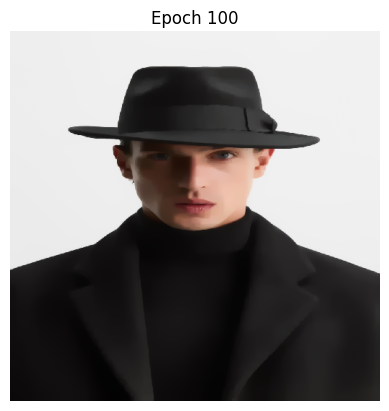

  7%|▋         | 101/1500 [01:04<17:58,  1.30it/s]

Inside compute_loss:
Content Loss: 7.44687156384316e-07, Style Loss: 4.434977540768159e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 102/1500 [01:05<15:43,  1.48it/s]

Inside compute_loss:
Content Loss: 7.469236038559757e-07, Style Loss: 4.4337554072626517e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 103/1500 [01:05<15:32,  1.50it/s]

Inside compute_loss:
Content Loss: 7.491674409720872e-07, Style Loss: 4.432428966083535e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 105/1500 [01:07<14:47,  1.57it/s]

Inside compute_loss:
Content Loss: 7.514204867220542e-07, Style Loss: 4.4310613134257437e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 106/1500 [01:07<14:40,  1.58it/s]

Inside compute_loss:
Content Loss: 7.536480666203715e-07, Style Loss: 4.4297718204688863e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 107/1500 [01:08<14:35,  1.59it/s]

Inside compute_loss:
Content Loss: 7.558562629128573e-07, Style Loss: 4.4284914224590466e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.579926091239031e-07, Style Loss: 4.427231772297091e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 108/1500 [01:09<14:36,  1.59it/s]

Inside compute_loss:
Content Loss: 7.601193487971614e-07, Style Loss: 4.4259317633077444e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 109/1500 [01:09<14:32,  1.59it/s]

Inside compute_loss:
Content Loss: 7.622989528499602e-07, Style Loss: 4.424625501542323e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 110/1500 [01:10<14:32,  1.59it/s]

Inside compute_loss:
Content Loss: 7.644682114005263e-07, Style Loss: 4.423492327987333e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 111/1500 [01:10<14:33,  1.59it/s]

Inside compute_loss:
Content Loss: 7.665876182727516e-07, Style Loss: 4.4223179429536685e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 113/1500 [01:12<14:22,  1.61it/s]

Inside compute_loss:
Content Loss: 7.68690995300858e-07, Style Loss: 4.4211193994669884e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.70819099216169e-07, Style Loss: 4.419922561282874e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 115/1500 [01:13<14:21,  1.61it/s]

Inside compute_loss:
Content Loss: 7.729170761194837e-07, Style Loss: 4.4187402181705693e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.749963515379932e-07, Style Loss: 4.417429408931639e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 116/1500 [01:14<14:31,  1.59it/s]

Inside compute_loss:
Content Loss: 7.770940442242136e-07, Style Loss: 4.416315277921967e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 118/1500 [01:15<14:22,  1.60it/s]

Inside compute_loss:
Content Loss: 7.792150995555858e-07, Style Loss: 4.4150525013719744e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 119/1500 [01:15<14:22,  1.60it/s]

Inside compute_loss:
Content Loss: 7.812919307070842e-07, Style Loss: 4.4138465682408423e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.833598942852404e-07, Style Loss: 4.41281031271501e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 120/1500 [01:16<14:40,  1.57it/s]

Inside compute_loss:
Content Loss: 7.853514603084477e-07, Style Loss: 4.411735403664352e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 121/1500 [01:17<14:39,  1.57it/s]

Inside compute_loss:
Content Loss: 7.873890695009322e-07, Style Loss: 4.4105607344135933e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 122/1500 [01:17<14:47,  1.55it/s]

Inside compute_loss:
Content Loss: 7.894203122305044e-07, Style Loss: 4.4094062445765303e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 124/1500 [01:19<14:16,  1.61it/s]

Inside compute_loss:
Content Loss: 7.914420052657078e-07, Style Loss: 4.408346683248965e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 125/1500 [01:19<14:18,  1.60it/s]

Inside compute_loss:
Content Loss: 7.935215649013116e-07, Style Loss: 4.4072470473111025e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.955731575748359e-07, Style Loss: 4.406101652421057e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 126/1500 [01:20<14:19,  1.60it/s]

Inside compute_loss:
Content Loss: 7.975827429618221e-07, Style Loss: 4.405107745242276e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 128/1500 [01:21<14:19,  1.60it/s]

Inside compute_loss:
Content Loss: 7.995769806257158e-07, Style Loss: 4.4039472868462326e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.015742309908092e-07, Style Loss: 4.402864419716934e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 129/1500 [01:22<14:24,  1.59it/s]

Inside compute_loss:
Content Loss: 8.035521545934898e-07, Style Loss: 4.4018690914526815e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 131/1500 [01:23<14:16,  1.60it/s]

Inside compute_loss:
Content Loss: 8.055547482399561e-07, Style Loss: 4.4007231281284476e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.075009532149124e-07, Style Loss: 4.399743147587287e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 132/1500 [01:24<14:20,  1.59it/s]

Inside compute_loss:
Content Loss: 8.094382906165265e-07, Style Loss: 4.3987918729726516e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 133/1500 [01:24<14:18,  1.59it/s]

Inside compute_loss:
Content Loss: 8.113997864711564e-07, Style Loss: 4.3978309349768097e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 134/1500 [01:25<14:17,  1.59it/s]

Inside compute_loss:
Content Loss: 8.133652613651066e-07, Style Loss: 4.396904103032284e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 135/1500 [01:26<14:40,  1.55it/s]

Inside compute_loss:
Content Loss: 8.152584882736846e-07, Style Loss: 4.395936628043273e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 137/1500 [01:27<14:18,  1.59it/s]

Inside compute_loss:
Content Loss: 8.171823537850287e-07, Style Loss: 4.394972563659394e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.191427696147002e-07, Style Loss: 4.3940269733866444e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 138/1500 [01:27<14:16,  1.59it/s]

Inside compute_loss:
Content Loss: 8.210437840716622e-07, Style Loss: 4.392962580368476e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 139/1500 [01:28<14:17,  1.59it/s]

Inside compute_loss:
Content Loss: 8.229464469877712e-07, Style Loss: 4.3920283587794984e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 140/1500 [01:29<14:30,  1.56it/s]

Inside compute_loss:
Content Loss: 8.248294420809543e-07, Style Loss: 4.3910918634537666e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 141/1500 [01:29<14:25,  1.57it/s]

Inside compute_loss:
Content Loss: 8.267796260952309e-07, Style Loss: 4.390219885408442e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 142/1500 [01:30<14:39,  1.54it/s]

Inside compute_loss:
Content Loss: 8.286902470899804e-07, Style Loss: 4.389386276670848e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 143/1500 [01:31<14:40,  1.54it/s]

Inside compute_loss:
Content Loss: 8.306171821459429e-07, Style Loss: 4.3884745082323207e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 145/1500 [01:32<14:11,  1.59it/s]

Inside compute_loss:
Content Loss: 8.325036446876766e-07, Style Loss: 4.387412104733812e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.343220656570338e-07, Style Loss: 4.3865597376679943e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 146/1500 [01:32<14:11,  1.59it/s]

Inside compute_loss:
Content Loss: 8.361342338503164e-07, Style Loss: 4.3858165099663893e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 147/1500 [01:33<14:10,  1.59it/s]

Inside compute_loss:
Content Loss: 8.379612950193405e-07, Style Loss: 4.384955332170648e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 148/1500 [01:34<14:10,  1.59it/s]

Inside compute_loss:
Content Loss: 8.397726105613401e-07, Style Loss: 4.3841620822604455e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 149/1500 [01:34<14:12,  1.59it/s]

Inside compute_loss:
Content Loss: 8.416357673013408e-07, Style Loss: 4.383356611015188e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 150/1500 [01:35<14:07,  1.59it/s]

Inside compute_loss:
Content Loss: 8.43505688408186e-07, Style Loss: 4.382463885121979e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 151/1500 [01:36<14:07,  1.59it/s]

Inside compute_loss:
Content Loss: 8.453516215922718e-07, Style Loss: 4.3816558559228724e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 152/1500 [01:36<14:08,  1.59it/s]

Inside compute_loss:
Content Loss: 8.471699857182102e-07, Style Loss: 4.3807162342091033e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 153/1500 [01:37<14:07,  1.59it/s]

Inside compute_loss:
Content Loss: 8.490103482472477e-07, Style Loss: 4.3799207105621463e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 154/1500 [01:38<14:07,  1.59it/s]

Inside compute_loss:
Content Loss: 8.508162068210368e-07, Style Loss: 4.3791291659545095e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 155/1500 [01:38<14:12,  1.58it/s]

Inside compute_loss:
Content Loss: 8.526380952389445e-07, Style Loss: 4.378415212613618e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 156/1500 [01:39<14:06,  1.59it/s]

Inside compute_loss:
Content Loss: 8.544032539248292e-07, Style Loss: 4.377599225335871e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 157/1500 [01:39<14:08,  1.58it/s]

Inside compute_loss:
Content Loss: 8.561492563785578e-07, Style Loss: 4.376967410735233e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 158/1500 [01:40<14:05,  1.59it/s]

Inside compute_loss:
Content Loss: 8.579170867051289e-07, Style Loss: 4.376157676233561e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 159/1500 [01:41<14:13,  1.57it/s]

Inside compute_loss:
Content Loss: 8.597260148235364e-07, Style Loss: 4.375295077352348e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 160/1500 [01:41<14:22,  1.55it/s]

Inside compute_loss:
Content Loss: 8.615050433036231e-07, Style Loss: 4.3745896505242854e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 161/1500 [01:42<14:15,  1.56it/s]

Inside compute_loss:
Content Loss: 8.6327457893276e-07, Style Loss: 4.37408345987933e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 162/1500 [01:43<14:28,  1.54it/s]

Inside compute_loss:
Content Loss: 8.650749805383384e-07, Style Loss: 4.373169417704048e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 164/1500 [01:44<14:01,  1.59it/s]

Inside compute_loss:
Content Loss: 8.668696978020307e-07, Style Loss: 4.3725088971768855e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.686274100000446e-07, Style Loss: 4.371717636786343e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 165/1500 [01:45<14:05,  1.58it/s]

Inside compute_loss:
Content Loss: 8.703659659659024e-07, Style Loss: 4.3710451791412197e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 167/1500 [01:46<14:02,  1.58it/s]

Inside compute_loss:
Content Loss: 8.720823529984045e-07, Style Loss: 4.370375279449945e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.737670214031823e-07, Style Loss: 4.3696587681552046e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 168/1500 [01:46<14:05,  1.58it/s]

Inside compute_loss:
Content Loss: 8.754328177928983e-07, Style Loss: 4.369139219306817e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 170/1500 [01:48<14:00,  1.58it/s]

Inside compute_loss:
Content Loss: 8.771057764533907e-07, Style Loss: 4.3685096784429334e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 171/1500 [01:48<13:59,  1.58it/s]

Inside compute_loss:
Content Loss: 8.787839647084184e-07, Style Loss: 4.3679068539859145e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 172/1500 [01:49<13:57,  1.58it/s]

Inside compute_loss:
Content Loss: 8.804387903182942e-07, Style Loss: 4.36739611586745e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.821289725347015e-07, Style Loss: 4.366719394965912e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 173/1500 [01:50<14:01,  1.58it/s]

Inside compute_loss:
Content Loss: 8.838977123559744e-07, Style Loss: 4.3658747017616406e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 174/1500 [01:50<13:58,  1.58it/s]

Inside compute_loss:
Content Loss: 8.856409294821788e-07, Style Loss: 4.3651985492942913e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 175/1500 [01:51<13:56,  1.58it/s]

Inside compute_loss:
Content Loss: 8.873521437635645e-07, Style Loss: 4.3645312075568654e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 176/1500 [01:52<14:02,  1.57it/s]

Inside compute_loss:
Content Loss: 8.889844593795715e-07, Style Loss: 4.36386983437842e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 177/1500 [01:52<13:55,  1.58it/s]

Inside compute_loss:
Content Loss: 8.906031325750519e-07, Style Loss: 4.3632860524667194e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 178/1500 [01:53<13:55,  1.58it/s]

Inside compute_loss:
Content Loss: 8.921952030505054e-07, Style Loss: 4.3628628532133007e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 179/1500 [01:53<14:08,  1.56it/s]

Inside compute_loss:
Content Loss: 8.939305189414881e-07, Style Loss: 4.3622017642519495e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 180/1500 [01:54<14:06,  1.56it/s]

Inside compute_loss:
Content Loss: 8.956746455623943e-07, Style Loss: 4.361448588952044e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 181/1500 [01:55<14:03,  1.56it/s]

Inside compute_loss:
Content Loss: 8.973384524324501e-07, Style Loss: 4.3608912392301136e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 182/1500 [01:55<14:17,  1.54it/s]

Inside compute_loss:
Content Loss: 8.990452329271648e-07, Style Loss: 4.360117600299418e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 183/1500 [01:56<14:17,  1.54it/s]

Inside compute_loss:
Content Loss: 9.007168841890234e-07, Style Loss: 4.3595869669843523e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 184/1500 [01:57<13:55,  1.58it/s]

Inside compute_loss:
Content Loss: 9.022958806781389e-07, Style Loss: 4.3590074483290664e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 185/1500 [01:57<13:50,  1.58it/s]

Inside compute_loss:
Content Loss: 9.03875900348794e-07, Style Loss: 4.358455782949022e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 186/1500 [01:58<13:50,  1.58it/s]

Inside compute_loss:
Content Loss: 9.055154919224151e-07, Style Loss: 4.357932255061314e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 187/1500 [01:59<13:50,  1.58it/s]

Inside compute_loss:
Content Loss: 9.07186233689572e-07, Style Loss: 4.35731521974958e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 188/1500 [01:59<13:51,  1.58it/s]

Inside compute_loss:
Content Loss: 9.088424235415005e-07, Style Loss: 4.3567246166276163e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 190/1500 [02:00<13:46,  1.59it/s]

Inside compute_loss:
Content Loss: 9.104621199185203e-07, Style Loss: 4.356107297098788e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 191/1500 [02:01<13:45,  1.59it/s]

Inside compute_loss:
Content Loss: 9.120538493334607e-07, Style Loss: 4.355557905455498e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.136712719737261e-07, Style Loss: 4.354995155608776e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 192/1500 [02:02<13:50,  1.57it/s]

Inside compute_loss:
Content Loss: 9.15180692118156e-07, Style Loss: 4.354559450803208e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 194/1500 [02:03<13:44,  1.58it/s]

Inside compute_loss:
Content Loss: 9.167164876089373e-07, Style Loss: 4.3540896399463236e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.183302722703957e-07, Style Loss: 4.353486247055116e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 195/1500 [02:04<13:44,  1.58it/s]

Inside compute_loss:
Content Loss: 9.199193300446495e-07, Style Loss: 4.3528734749997966e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 196/1500 [02:04<13:46,  1.58it/s]

Inside compute_loss:
Content Loss: 9.215182217303663e-07, Style Loss: 4.352324367573601e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 197/1500 [02:05<13:49,  1.57it/s]

Inside compute_loss:
Content Loss: 9.231023341271793e-07, Style Loss: 4.351826987658569e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 198/1500 [02:05<13:45,  1.58it/s]

Inside compute_loss:
Content Loss: 9.247126513400872e-07, Style Loss: 4.3512758907127136e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 199/1500 [02:06<13:57,  1.55it/s]

Inside compute_loss:
Content Loss: 9.263349056709558e-07, Style Loss: 4.350693814103579e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 200/1500 [02:07<13:49,  1.57it/s]

Inside compute_loss:
Content Loss: 9.279122537009243e-07, Style Loss: 4.350176254774851e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 200, Loss: 1059.643555, Alpha: 10.0000, Beta: 10.0000


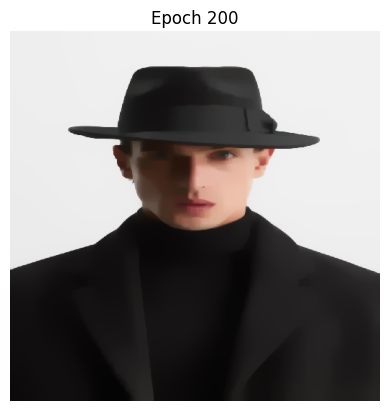

 13%|█▎        | 201/1500 [02:08<16:43,  1.29it/s]

Inside compute_loss:
Content Loss: 9.294178653362906e-07, Style Loss: 4.3499034063643194e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 202/1500 [02:08<14:55,  1.45it/s]

Inside compute_loss:
Content Loss: 9.310068094237067e-07, Style Loss: 4.3494512169672817e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 203/1500 [02:09<14:10,  1.53it/s]

Inside compute_loss:
Content Loss: 9.325644327873306e-07, Style Loss: 4.3489828271958686e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 204/1500 [02:10<14:01,  1.54it/s]

Inside compute_loss:
Content Loss: 9.340769793197978e-07, Style Loss: 4.3485772494022967e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 205/1500 [02:10<13:58,  1.54it/s]

Inside compute_loss:
Content Loss: 9.356363079859875e-07, Style Loss: 4.347967887952109e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 206/1500 [02:11<13:47,  1.56it/s]

Inside compute_loss:
Content Loss: 9.372133149554429e-07, Style Loss: 4.347362505541241e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 207/1500 [02:11<13:44,  1.57it/s]

Inside compute_loss:
Content Loss: 9.38745927214768e-07, Style Loss: 4.3469597699186124e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 208/1500 [02:12<13:37,  1.58it/s]

Inside compute_loss:
Content Loss: 9.40354937029042e-07, Style Loss: 4.3465195176395355e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 209/1500 [02:13<13:33,  1.59it/s]

Inside compute_loss:
Content Loss: 9.419054549653083e-07, Style Loss: 4.345992010712507e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 210/1500 [02:13<13:34,  1.58it/s]

Inside compute_loss:
Content Loss: 9.434140224584553e-07, Style Loss: 4.3454539877529896e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 211/1500 [02:14<13:31,  1.59it/s]

Inside compute_loss:
Content Loss: 9.44912073919113e-07, Style Loss: 4.345007482697838e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 212/1500 [02:15<13:30,  1.59it/s]

Inside compute_loss:
Content Loss: 9.464268373449158e-07, Style Loss: 4.344684896295803e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 213/1500 [02:15<13:28,  1.59it/s]

Inside compute_loss:
Content Loss: 9.480086760049744e-07, Style Loss: 4.3440462604849017e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 214/1500 [02:16<13:30,  1.59it/s]

Inside compute_loss:
Content Loss: 9.495188351138495e-07, Style Loss: 4.34364068269133e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 215/1500 [02:16<13:26,  1.59it/s]

Inside compute_loss:
Content Loss: 9.510011409474828e-07, Style Loss: 4.3432112306618365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 216/1500 [02:17<13:25,  1.59it/s]

Inside compute_loss:
Content Loss: 9.524937922833487e-07, Style Loss: 4.342831232406752e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 217/1500 [02:18<13:25,  1.59it/s]

Inside compute_loss:
Content Loss: 9.540273140373756e-07, Style Loss: 4.3423773377071484e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 218/1500 [02:18<13:26,  1.59it/s]

Inside compute_loss:
Content Loss: 9.5549410161766e-07, Style Loss: 4.3419893813734234e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 219/1500 [02:19<13:41,  1.56it/s]

Inside compute_loss:
Content Loss: 9.569974963596906e-07, Style Loss: 4.341547708008875e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 220/1500 [02:20<13:37,  1.57it/s]

Inside compute_loss:
Content Loss: 9.585113502907916e-07, Style Loss: 4.3410921080067055e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 221/1500 [02:20<13:45,  1.55it/s]

Inside compute_loss:
Content Loss: 9.600138355381205e-07, Style Loss: 4.340723194218299e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 222/1500 [02:21<13:48,  1.54it/s]

Inside compute_loss:
Content Loss: 9.614922191758524e-07, Style Loss: 4.340380144185474e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 223/1500 [02:22<13:26,  1.58it/s]

Inside compute_loss:
Content Loss: 9.629939086153172e-07, Style Loss: 4.3398256366344867e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 225/1500 [02:23<13:17,  1.60it/s]

Inside compute_loss:
Content Loss: 9.64496848609997e-07, Style Loss: 4.3393532678237534e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.66001266533567e-07, Style Loss: 4.3390116388764e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 226/1500 [02:23<13:17,  1.60it/s]

Inside compute_loss:
Content Loss: 9.67446567301522e-07, Style Loss: 4.3387652226556384e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 227/1500 [02:24<13:16,  1.60it/s]

Inside compute_loss:
Content Loss: 9.688768614068977e-07, Style Loss: 4.33836646607233e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 228/1500 [02:25<13:17,  1.59it/s]

Inside compute_loss:
Content Loss: 9.703204568722867e-07, Style Loss: 4.337859138558997e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 229/1500 [02:25<13:16,  1.60it/s]

Inside compute_loss:
Content Loss: 9.717662123875925e-07, Style Loss: 4.3375359837227734e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 231/1500 [02:27<13:13,  1.60it/s]

Inside compute_loss:
Content Loss: 9.733024626257247e-07, Style Loss: 4.337081236371887e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.748267757458962e-07, Style Loss: 4.3366085833440593e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 232/1500 [02:27<13:15,  1.59it/s]

Inside compute_loss:
Content Loss: 9.763277830643347e-07, Style Loss: 4.3361600887692475e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 233/1500 [02:28<13:13,  1.60it/s]

Inside compute_loss:
Content Loss: 9.778149205885711e-07, Style Loss: 4.3357047729841725e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 234/1500 [02:28<13:12,  1.60it/s]

Inside compute_loss:
Content Loss: 9.79283072410908e-07, Style Loss: 4.3354046397325874e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 235/1500 [02:29<13:13,  1.59it/s]

Inside compute_loss:
Content Loss: 9.807048400034546e-07, Style Loss: 4.334930565619288e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 236/1500 [02:30<13:14,  1.59it/s]

Inside compute_loss:
Content Loss: 9.821516187002999e-07, Style Loss: 4.334693812779733e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 237/1500 [02:30<13:11,  1.60it/s]

Inside compute_loss:
Content Loss: 9.835933951762854e-07, Style Loss: 4.334349057444342e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 238/1500 [02:31<13:13,  1.59it/s]

Inside compute_loss:
Content Loss: 9.850550668488722e-07, Style Loss: 4.334051482146606e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 239/1500 [02:32<13:24,  1.57it/s]

Inside compute_loss:
Content Loss: 9.865494803307229e-07, Style Loss: 4.333714400672761e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 240/1500 [02:32<13:21,  1.57it/s]

Inside compute_loss:
Content Loss: 9.880729976430302e-07, Style Loss: 4.3332622112757235e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 241/1500 [02:33<13:36,  1.54it/s]

Inside compute_loss:
Content Loss: 9.895337598209153e-07, Style Loss: 4.33298993129938e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 242/1500 [02:34<13:31,  1.55it/s]

Inside compute_loss:
Content Loss: 9.909181244438514e-07, Style Loss: 4.332599701228901e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 243/1500 [02:34<13:08,  1.59it/s]

Inside compute_loss:
Content Loss: 9.923764991981443e-07, Style Loss: 4.332223397796042e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 245/1500 [02:35<13:04,  1.60it/s]

Inside compute_loss:
Content Loss: 9.938189577951562e-07, Style Loss: 4.331932359491475e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.952369737220579e-07, Style Loss: 4.3316833853168646e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 246/1500 [02:36<13:10,  1.59it/s]

Inside compute_loss:
Content Loss: 9.96647031570319e-07, Style Loss: 4.3311936792633787e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 247/1500 [02:37<13:05,  1.59it/s]

Inside compute_loss:
Content Loss: 9.980791446650983e-07, Style Loss: 4.33083584994165e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 248/1500 [02:37<13:04,  1.60it/s]

Inside compute_loss:
Content Loss: 9.995585514843697e-07, Style Loss: 4.330300384935981e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 249/1500 [02:38<13:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0009849802372628e-06, Style Loss: 4.3298800278535055e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 250/1500 [02:39<13:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0024022003563005e-06, Style Loss: 4.3295182194924564e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 251/1500 [02:39<13:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0038664868261549e-06, Style Loss: 4.3292752138768265e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 252/1500 [02:40<13:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0052236802948755e-06, Style Loss: 4.3289077211738913e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 253/1500 [02:40<13:01,  1.60it/s]

Inside compute_loss:
Content Loss: 1.0066305549116805e-06, Style Loss: 4.3284788375785865e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 254/1500 [02:41<13:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0079921821670723e-06, Style Loss: 4.32826311680401e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 255/1500 [02:42<13:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0093813216371927e-06, Style Loss: 4.3279749206703855e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 256/1500 [02:42<13:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0107859225172433e-06, Style Loss: 4.3277339045744156e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 257/1500 [02:43<13:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0121332252310822e-06, Style Loss: 4.327366127654386e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 258/1500 [02:44<12:57,  1.60it/s]

Inside compute_loss:
Content Loss: 1.01349155556818e-06, Style Loss: 4.326969644807832e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 259/1500 [02:44<13:12,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0148797855435987e-06, Style Loss: 4.326646205754514e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 260/1500 [02:45<13:12,  1.56it/s]

Inside compute_loss:
Content Loss: 1.0162292483073543e-06, Style Loss: 4.326458338255179e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 261/1500 [02:46<13:23,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0175821216762415e-06, Style Loss: 4.32614342571469e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 262/1500 [02:46<13:26,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0189529575654888e-06, Style Loss: 4.3258913251520426e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 263/1500 [02:47<12:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0203325473412406e-06, Style Loss: 4.325517011238844e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 265/1500 [02:48<12:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0216551800112939e-06, Style Loss: 4.325259794768499e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.022985202325799e-06, Style Loss: 4.3249525560895563e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 266/1500 [02:49<12:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0243034012091812e-06, Style Loss: 4.324670044297818e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 267/1500 [02:49<13:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.025645019581134e-06, Style Loss: 4.324514861764328e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 269/1500 [02:51<12:51,  1.60it/s]

Inside compute_loss:
Content Loss: 1.0269928907291614e-06, Style Loss: 4.324197675487085e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 270/1500 [02:51<12:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0283985147907515e-06, Style Loss: 4.3238458147243364e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.029770487548376e-06, Style Loss: 4.323481732626533e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 271/1500 [02:52<12:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0311156302122981e-06, Style Loss: 4.3232719804109365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 272/1500 [02:52<12:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0324333743483294e-06, Style Loss: 4.322974973547389e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 274/1500 [02:54<12:48,  1.60it/s]

Inside compute_loss:
Content Loss: 1.0338103493268136e-06, Style Loss: 4.3226839352428215e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 275/1500 [02:54<12:47,  1.60it/s]

Inside compute_loss:
Content Loss: 1.0351110404371866e-06, Style Loss: 4.322356517150183e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.036465846482315e-06, Style Loss: 4.322108395626856e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 277/1500 [02:56<12:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.037830656969163e-06, Style Loss: 4.321898074977071e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0392033118478139e-06, Style Loss: 4.321603626067372e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 278/1500 [02:56<12:53,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0405658485979075e-06, Style Loss: 4.321302924381598e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 279/1500 [02:57<13:07,  1.55it/s]

Inside compute_loss:
Content Loss: 1.0418784768262412e-06, Style Loss: 4.321093172166002e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 280/1500 [02:58<13:02,  1.56it/s]

Inside compute_loss:
Content Loss: 1.0432016779304831e-06, Style Loss: 4.32090814683761e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 281/1500 [02:58<13:09,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0445731959407567e-06, Style Loss: 4.320523885326111e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 283/1500 [02:59<12:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0459646091476316e-06, Style Loss: 4.320153834669327e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 284/1500 [03:00<12:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0473495422047563e-06, Style Loss: 4.3198917865083786e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0486917290108977e-06, Style Loss: 4.319537083574687e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 285/1500 [03:01<12:47,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0500843927729875e-06, Style Loss: 4.3191624854443944e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 286/1500 [03:01<12:47,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0514037285247468e-06, Style Loss: 4.319000481700641e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 288/1500 [03:03<12:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0526933920118609e-06, Style Loss: 4.3187458231841447e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.053938490258588e-06, Style Loss: 4.3185511344745464e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 289/1500 [03:03<12:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0552460025792243e-06, Style Loss: 4.318227411204134e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 290/1500 [03:04<12:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.056618316397362e-06, Style Loss: 4.3179969111406535e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 291/1500 [03:04<12:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.057952090377512e-06, Style Loss: 4.317693651501031e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 292/1500 [03:05<12:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0591987802399672e-06, Style Loss: 4.317269883813424e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 293/1500 [03:06<12:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.060449335454905e-06, Style Loss: 4.3171490915483446e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 295/1500 [03:07<12:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0617596899464843e-06, Style Loss: 4.3169788455088565e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0630747055984102e-06, Style Loss: 4.3167443664060556e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 297/1500 [03:08<12:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0643492487361073e-06, Style Loss: 4.316654269587161e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.065619812834484e-06, Style Loss: 4.3164629914826946e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 298/1500 [03:09<12:56,  1.55it/s]

Inside compute_loss:
Content Loss: 1.0669218681869097e-06, Style Loss: 4.316177353302919e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 299/1500 [03:10<12:48,  1.56it/s]

Inside compute_loss:
Content Loss: 1.0682448419174762e-06, Style Loss: 4.315965043133474e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 300/1500 [03:10<12:51,  1.56it/s]

Inside compute_loss:
Content Loss: 1.069605218617653e-06, Style Loss: 4.315778312502516e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 300, Loss: 979.800110, Alpha: 10.0000, Beta: 10.0000


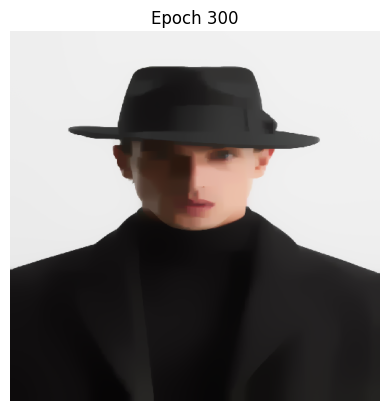

 20%|██        | 301/1500 [03:11<15:05,  1.32it/s]

Inside compute_loss:
Content Loss: 1.07085281797481e-06, Style Loss: 4.315430146561994e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 302/1500 [03:12<13:01,  1.53it/s]

Inside compute_loss:
Content Loss: 1.0720622185544926e-06, Style Loss: 4.3153028173037455e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 303/1500 [03:12<12:49,  1.55it/s]

Inside compute_loss:
Content Loss: 1.0733142516983207e-06, Style Loss: 4.3150689066351333e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 304/1500 [03:13<12:45,  1.56it/s]

Inside compute_loss:
Content Loss: 1.0745962981673074e-06, Style Loss: 4.314810553296411e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 305/1500 [03:14<12:39,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0758508324215654e-06, Style Loss: 4.3146519601577893e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 306/1500 [03:14<12:38,  1.57it/s]

Inside compute_loss:
Content Loss: 1.077101842383854e-06, Style Loss: 4.314439649988344e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 308/1500 [03:15<12:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0783659263324807e-06, Style Loss: 4.3142568983967067e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0795532716656453e-06, Style Loss: 4.314036630148621e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 310/1500 [03:17<12:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0807941634993767e-06, Style Loss: 4.3138322780578164e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.08203596482781e-06, Style Loss: 4.313612009809731e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 311/1500 [03:17<12:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0832482075784355e-06, Style Loss: 4.3135071337019326e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 312/1500 [03:18<12:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.084456812350254e-06, Style Loss: 4.313259864829888e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 313/1500 [03:19<12:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0857371535166749e-06, Style Loss: 4.31297536351849e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 315/1500 [03:20<12:20,  1.60it/s]

Inside compute_loss:
Content Loss: 1.0870326150325127e-06, Style Loss: 4.312571775244578e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0882631613640115e-06, Style Loss: 4.3123807813572057e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 316/1500 [03:20<12:29,  1.58it/s]

Inside compute_loss:
Content Loss: 1.089519969355024e-06, Style Loss: 4.3120084569636674e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 317/1500 [03:21<12:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0907418754868559e-06, Style Loss: 4.3120451209688326e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 318/1500 [03:22<12:36,  1.56it/s]

Inside compute_loss:
Content Loss: 1.0919694659605739e-06, Style Loss: 4.311748114105285e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 319/1500 [03:22<12:33,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0931728411378572e-06, Style Loss: 4.3114766867802246e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 320/1500 [03:23<12:44,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0944563655357342e-06, Style Loss: 4.3112549974466674e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 322/1500 [03:24<12:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0957062386296457e-06, Style Loss: 4.3110719616379356e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0969430377372191e-06, Style Loss: 4.310917915972823e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 324/1500 [03:26<12:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0981640343743493e-06, Style Loss: 4.3108437353112095e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0993949217663612e-06, Style Loss: 4.310467716095445e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 326/1500 [03:27<12:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1006198974428116e-06, Style Loss: 4.310203109980648e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 327/1500 [03:27<12:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1017740462193615e-06, Style Loss: 4.3101510982523905e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 328/1500 [03:28<12:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.102936494135065e-06, Style Loss: 4.3101013602608873e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1041403240596992e-06, Style Loss: 4.309769963128929e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 330/1500 [03:29<12:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1053576827180223e-06, Style Loss: 4.3096068225167983e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1065271792176645e-06, Style Loss: 4.3093294266327575e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 331/1500 [03:30<12:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1076629107265035e-06, Style Loss: 4.3092228452223935e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 332/1500 [03:31<12:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.108875153477129e-06, Style Loss: 4.3089545442853705e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 334/1500 [03:32<12:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1101030850113602e-06, Style Loss: 4.308708412281703e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1112214224340278e-06, Style Loss: 4.308701875288534e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 335/1500 [03:32<12:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1123033800686244e-06, Style Loss: 4.3087311496492475e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 336/1500 [03:33<12:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.113410235120682e-06, Style Loss: 4.308637073791033e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 337/1500 [03:34<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1145815506097279e-06, Style Loss: 4.308402594688232e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 338/1500 [03:34<12:26,  1.56it/s]

Inside compute_loss:
Content Loss: 1.115722511713102e-06, Style Loss: 4.308292034238548e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 339/1500 [03:35<12:21,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1168717719556298e-06, Style Loss: 4.3080990508315153e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 340/1500 [03:36<12:34,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1180312640135526e-06, Style Loss: 4.3080410705442773e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 342/1500 [03:37<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1190973054908682e-06, Style Loss: 4.3078964040432766e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1202772611795808e-06, Style Loss: 4.3078151179543056e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 343/1500 [03:38<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.121476202570193e-06, Style Loss: 4.307492815769365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 344/1500 [03:38<12:14,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1226303513467428e-06, Style Loss: 4.307352696741873e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 346/1500 [03:39<12:01,  1.60it/s]

Inside compute_loss:
Content Loss: 1.123795414059714e-06, Style Loss: 4.307237020384491e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 347/1500 [03:40<12:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1249206863794825e-06, Style Loss: 4.307049152885156e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 348/1500 [03:41<12:01,  1.60it/s]

Inside compute_loss:
Content Loss: 1.1260558494541328e-06, Style Loss: 4.30680046292764e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1271556559222518e-06, Style Loss: 4.306621690375323e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 349/1500 [03:41<12:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1283126468697446e-06, Style Loss: 4.30663931183517e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 350/1500 [03:42<12:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.129451902670553e-06, Style Loss: 4.306402843212709e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 351/1500 [03:43<12:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1305778571113478e-06, Style Loss: 4.3061780274911143e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 353/1500 [03:44<11:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1316874406475108e-06, Style Loss: 4.3061987753389985e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 354/1500 [03:44<11:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1328467053317581e-06, Style Loss: 4.306076846205542e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1340141554683214e-06, Style Loss: 4.3059921495114395e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 356/1500 [03:46<11:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1350829254297423e-06, Style Loss: 4.3059566223746515e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1362348004695377e-06, Style Loss: 4.30571418519321e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 357/1500 [03:46<12:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1373182360330247e-06, Style Loss: 4.305525180825498e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 358/1500 [03:47<12:16,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1384075833120733e-06, Style Loss: 4.305338165977446e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 359/1500 [03:48<12:12,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1394654393370729e-06, Style Loss: 4.305280185690208e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 360/1500 [03:48<12:19,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1406218618503772e-06, Style Loss: 4.3049340092693456e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 361/1500 [03:49<12:15,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1417638461352908e-06, Style Loss: 4.304795027110231e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 362/1500 [03:50<11:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1428588777562254e-06, Style Loss: 4.3047384679084644e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 363/1500 [03:50<11:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1439614127084496e-06, Style Loss: 4.3046190967288567e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 364/1500 [03:51<11:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.145099872701394e-06, Style Loss: 4.304550031974941e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 366/1500 [03:52<11:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1462176416898728e-06, Style Loss: 4.304381207020924e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.147360649156326e-06, Style Loss: 4.3041433173129917e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 367/1500 [03:53<11:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1484421520435717e-06, Style Loss: 4.303954881379468e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 368/1500 [03:53<11:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.149562649516156e-06, Style Loss: 4.303851710574236e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 369/1500 [03:54<11:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1506114105941379e-06, Style Loss: 4.303680896100559e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 370/1500 [03:55<11:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1517036000441294e-06, Style Loss: 4.3035549879277823e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 371/1500 [03:55<11:54,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1528497907420387e-06, Style Loss: 4.303450964471267e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 372/1500 [03:56<11:46,  1.60it/s]

Inside compute_loss:
Content Loss: 1.1539337947397144e-06, Style Loss: 4.3033176666540385e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 373/1500 [03:56<11:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1549828968782094e-06, Style Loss: 4.303237801650539e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 374/1500 [03:57<11:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1560050552361645e-06, Style Loss: 4.3031727159359434e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 375/1500 [03:58<12:02,  1.56it/s]

Inside compute_loss:
Content Loss: 1.156980488303816e-06, Style Loss: 4.3031980112573365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 376/1500 [03:58<12:01,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1580274303923943e-06, Style Loss: 4.3031670315940573e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 377/1500 [03:59<12:09,  1.54it/s]

Inside compute_loss:
Content Loss: 1.159124053629057e-06, Style Loss: 4.3030578922298446e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 378/1500 [04:00<12:14,  1.53it/s]

Inside compute_loss:
Content Loss: 1.1602292033785488e-06, Style Loss: 4.302816876133875e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 379/1500 [04:00<12:19,  1.52it/s]

Inside compute_loss:
Content Loss: 1.1612874004640616e-06, Style Loss: 4.3027324636568665e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 380/1500 [04:01<12:02,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1622920510490076e-06, Style Loss: 4.302686420487589e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 381/1500 [04:02<12:07,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1633683243417181e-06, Style Loss: 4.3025323748224764e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 382/1500 [04:02<12:05,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1644045798675506e-06, Style Loss: 4.3023894136240415e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 383/1500 [04:03<11:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1654087757051457e-06, Style Loss: 4.3023359808103123e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 384/1500 [04:04<11:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1664146768453065e-06, Style Loss: 4.302222578189685e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 385/1500 [04:04<11:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1674196684907656e-06, Style Loss: 4.302177671888785e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 386/1500 [04:05<11:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1684323908411898e-06, Style Loss: 4.302091838326305e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 387/1500 [04:05<11:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.169513325294247e-06, Style Loss: 4.301917044813308e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 389/1500 [04:07<11:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.170523205473728e-06, Style Loss: 4.301913918425271e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 390/1500 [04:07<11:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1715359278241522e-06, Style Loss: 4.3018988549192727e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 391/1500 [04:08<11:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1724949899871717e-06, Style Loss: 4.3017229245378985e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1734368854376953e-06, Style Loss: 4.30167943932247e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 392/1500 [04:09<11:39,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1744468793040141e-06, Style Loss: 4.3016240169890807e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 394/1500 [04:10<11:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.175460170088627e-06, Style Loss: 4.3016436279685877e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 395/1500 [04:10<11:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.176490854959411e-06, Style Loss: 4.3016564177378314e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1775110806411249e-06, Style Loss: 4.301506351112039e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 396/1500 [04:11<11:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1785905371652916e-06, Style Loss: 4.3013733375119045e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 397/1500 [04:12<11:35,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1795964383054525e-06, Style Loss: 4.301306262277649e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 398/1500 [04:12<11:49,  1.55it/s]

Inside compute_loss:
Content Loss: 1.180552203550178e-06, Style Loss: 4.301276703699841e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 399/1500 [04:13<11:45,  1.56it/s]

Inside compute_loss:
Content Loss: 1.181502966574044e-06, Style Loss: 4.3011939965253987e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 400/1500 [04:14<11:43,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1824790817627218e-06, Style Loss: 4.301267324535729e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 400, Loss: 928.040039, Alpha: 10.0000, Beta: 10.0000


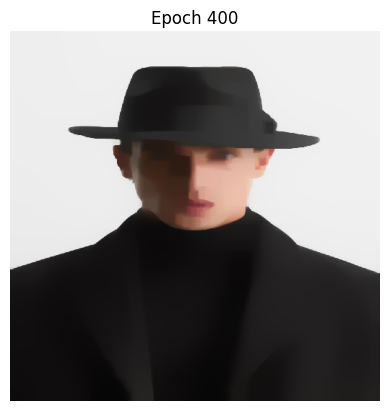

 27%|██▋       | 401/1500 [04:15<14:06,  1.30it/s]

Inside compute_loss:
Content Loss: 1.1834126780740917e-06, Style Loss: 4.301225828839961e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 402/1500 [04:15<12:19,  1.49it/s]

Inside compute_loss:
Content Loss: 1.1843868605865282e-06, Style Loss: 4.301183764710004e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 403/1500 [04:16<12:00,  1.52it/s]

Inside compute_loss:
Content Loss: 1.1853620662805042e-06, Style Loss: 4.301012097585044e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 405/1500 [04:17<11:46,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1862625797220971e-06, Style Loss: 4.300992486605537e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1872299410242704e-06, Style Loss: 4.300934222101205e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 406/1500 [04:18<11:38,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1881303407790256e-06, Style Loss: 4.3009984551645175e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 407/1500 [04:18<11:37,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1890100495293154e-06, Style Loss: 4.3010237504859106e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 408/1500 [04:19<11:36,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1899689980054973e-06, Style Loss: 4.3009984551645175e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 409/1500 [04:20<11:29,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1909628483408596e-06, Style Loss: 4.300906368825963e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 410/1500 [04:20<11:30,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1919299822693574e-06, Style Loss: 4.3008645889131003e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 411/1500 [04:21<11:27,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1928801768590347e-06, Style Loss: 4.3009751493627846e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 412/1500 [04:21<11:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1938576562897651e-06, Style Loss: 4.300936211620865e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 414/1500 [04:23<11:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1948295650654472e-06, Style Loss: 4.3008367356378585e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 415/1500 [04:23<11:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1957488368352642e-06, Style Loss: 4.3009029582208314e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 416/1500 [04:24<11:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1966197916990495e-06, Style Loss: 4.3009646333302953e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 417/1500 [04:25<11:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1974944982284796e-06, Style Loss: 4.3009836758756137e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1984542425125255e-06, Style Loss: 4.3009160322071693e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 418/1500 [04:25<11:41,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1994342230536859e-06, Style Loss: 4.3007861449950724e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 419/1500 [04:26<11:33,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2002952871625894e-06, Style Loss: 4.3007881345147325e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 420/1500 [04:27<11:34,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2011586250082473e-06, Style Loss: 4.300807461277145e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 422/1500 [04:28<11:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2021358770653023e-06, Style Loss: 4.3006104988307925e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 423/1500 [04:28<11:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.203038550556812e-06, Style Loss: 4.300587761463248e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2039769217153662e-06, Style Loss: 4.3005346128666133e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 425/1500 [04:30<11:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2049084716636571e-06, Style Loss: 4.300465832329792e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2058836773576331e-06, Style Loss: 4.300506191157183e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 426/1500 [04:30<11:22,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2068558135069907e-06, Style Loss: 4.3003495875382214e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 428/1500 [04:32<11:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2078487543476513e-06, Style Loss: 4.300439115922927e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 429/1500 [04:32<11:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.208798721563653e-06, Style Loss: 4.3003515770578815e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2096949149054126e-06, Style Loss: 4.3003890937143296e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 430/1500 [04:33<11:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2105799669370754e-06, Style Loss: 4.300516422972578e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 431/1500 [04:34<11:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2114386436223867e-06, Style Loss: 4.300452189909265e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 432/1500 [04:34<11:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2123560964028002e-06, Style Loss: 4.300443663396436e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 433/1500 [04:35<11:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2133276641179691e-06, Style Loss: 4.300256648548384e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 435/1500 [04:36<11:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.214230678669992e-06, Style Loss: 4.3003078076253587e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2151359669587691e-06, Style Loss: 4.300161151604698e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 437/1500 [04:37<11:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2160309097453137e-06, Style Loss: 4.3000943605875364e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2169409728812752e-06, Style Loss: 4.3000460436815047e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 438/1500 [04:38<11:22,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2177820281067397e-06, Style Loss: 4.3000898131140275e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 439/1500 [04:39<11:19,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2186663980173762e-06, Style Loss: 4.300089528896933e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 440/1500 [04:39<11:26,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2196167062938912e-06, Style Loss: 4.300032401260978e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 441/1500 [04:40<11:29,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2205108532725717e-06, Style Loss: 4.3000403593396186e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 442/1500 [04:41<11:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2214400157972705e-06, Style Loss: 4.300030695958412e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 443/1500 [04:41<11:07,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2223013072798494e-06, Style Loss: 4.299900524529221e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 444/1500 [04:42<11:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2231903383508325e-06, Style Loss: 4.29983970207104e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 445/1500 [04:42<11:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2240633395776968e-06, Style Loss: 4.2999076299565786e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 446/1500 [04:43<11:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.224959191858943e-06, Style Loss: 4.2998402705052285e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 447/1500 [04:44<11:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.225831510964781e-06, Style Loss: 4.299875229207828e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 448/1500 [04:44<11:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.226669496645627e-06, Style Loss: 4.299964189158345e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 449/1500 [04:45<11:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2275173730813549e-06, Style Loss: 4.3000559912798053e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 450/1500 [04:46<10:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2283778687560698e-06, Style Loss: 4.300048033201165e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 451/1500 [04:46<10:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2292498468013946e-06, Style Loss: 4.300028422221658e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 452/1500 [04:47<11:07,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2301311471674126e-06, Style Loss: 4.2998655658266216e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 453/1500 [04:47<10:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2310150623306981e-06, Style Loss: 4.2998524918402836e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 454/1500 [04:48<11:00,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2319475217736908e-06, Style Loss: 4.2999104721275216e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 455/1500 [04:49<10:59,  1.58it/s]

Inside compute_loss:
Content Loss: 1.232863837685727e-06, Style Loss: 4.2997785953957646e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 456/1500 [04:49<10:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2336946610957966e-06, Style Loss: 4.299986358091701e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 457/1500 [04:50<10:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2346139328656136e-06, Style Loss: 4.299793943118857e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 458/1500 [04:51<11:11,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2355035323707853e-06, Style Loss: 4.299826628084702e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 459/1500 [04:51<11:09,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2362755796857527e-06, Style Loss: 4.299926672501897e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 460/1500 [04:52<11:16,  1.54it/s]

Inside compute_loss:
Content Loss: 1.237135506926279e-06, Style Loss: 4.2999101879104273e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 461/1500 [04:53<11:14,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2380301086523104e-06, Style Loss: 4.2998524918402836e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 462/1500 [04:53<10:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2388990171530168e-06, Style Loss: 4.299817533137684e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 463/1500 [04:54<10:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2397749742376618e-06, Style Loss: 4.299734257529053e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 464/1500 [04:54<10:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2406444511725567e-06, Style Loss: 4.2997569948965975e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 465/1500 [04:55<10:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2414225238899235e-06, Style Loss: 4.2998129856641754e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 466/1500 [04:56<10:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2422323152350145e-06, Style Loss: 4.2997965010727057e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 467/1500 [04:56<10:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.243043129761645e-06, Style Loss: 4.2998166804864013e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 468/1500 [04:57<10:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2438254088920075e-06, Style Loss: 4.299917577554879e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 469/1500 [04:58<10:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2446124628695543e-06, Style Loss: 4.2999909055652097e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 471/1500 [04:59<10:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2454260058802902e-06, Style Loss: 4.3000721916541806e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2462847962524393e-06, Style Loss: 4.3000636651413515e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 473/1500 [05:00<10:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.247101636181469e-06, Style Loss: 4.299903366700164e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2479846418500529e-06, Style Loss: 4.299873239688168e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 474/1500 [05:01<10:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2488627589846146e-06, Style Loss: 4.2999423044420837e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 475/1500 [05:02<11:46,  1.45it/s]

Inside compute_loss:
Content Loss: 1.2496931276473333e-06, Style Loss: 4.299912461647182e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 476/1500 [05:02<11:28,  1.49it/s]

Inside compute_loss:
Content Loss: 1.2504339110819274e-06, Style Loss: 4.299941451790801e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 477/1500 [05:03<11:26,  1.49it/s]

Inside compute_loss:
Content Loss: 1.2512082321336493e-06, Style Loss: 4.3000980554097623e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 478/1500 [05:04<12:14,  1.39it/s]

Inside compute_loss:
Content Loss: 1.2520066547949682e-06, Style Loss: 4.3000261484849034e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 479/1500 [05:04<11:33,  1.47it/s]

Inside compute_loss:
Content Loss: 1.2528093975561205e-06, Style Loss: 4.299945430830121e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 480/1500 [05:05<11:21,  1.50it/s]

Inside compute_loss:
Content Loss: 1.253597361028369e-06, Style Loss: 4.300111697830289e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 481/1500 [05:05<10:57,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2544082892418373e-06, Style Loss: 4.300030695958412e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 482/1500 [05:06<10:53,  1.56it/s]

Inside compute_loss:
Content Loss: 1.255247639164736e-06, Style Loss: 4.300044338378939e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 483/1500 [05:07<10:46,  1.57it/s]

Inside compute_loss:
Content Loss: 1.256078689948481e-06, Style Loss: 4.299979821098532e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 484/1500 [05:07<10:43,  1.58it/s]

Inside compute_loss:
Content Loss: 1.256920768355485e-06, Style Loss: 4.2999096194762387e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 485/1500 [05:08<10:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2577429515658878e-06, Style Loss: 4.2998524918402836e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 486/1500 [05:09<10:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2585610420501325e-06, Style Loss: 4.299915588035219e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 487/1500 [05:09<10:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2593749261213816e-06, Style Loss: 4.2997550053769373e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 488/1500 [05:10<10:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.260182898477069e-06, Style Loss: 4.2996185811716714e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 489/1500 [05:11<10:40,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2610045132532832e-06, Style Loss: 4.299668603380269e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 491/1500 [05:12<10:32,  1.60it/s]

Inside compute_loss:
Content Loss: 1.2617991842489573e-06, Style Loss: 4.299723741496564e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2626602483578608e-06, Style Loss: 4.2998215121770045e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 492/1500 [05:12<10:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2635433677132824e-06, Style Loss: 4.2997888272111595e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 493/1500 [05:13<10:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.264386014554475e-06, Style Loss: 4.2997231730623753e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 494/1500 [05:14<10:36,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2651388487938675e-06, Style Loss: 4.299766942494898e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 496/1500 [05:15<10:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2659024832828436e-06, Style Loss: 4.2997328364435816e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2666326938415295e-06, Style Loss: 4.2997908167308196e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 497/1500 [05:16<10:44,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2674078107011155e-06, Style Loss: 4.2998439653274545e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 498/1500 [05:16<10:41,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2681442740358762e-06, Style Loss: 4.2999170091206906e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 499/1500 [05:17<10:49,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2689368986684713e-06, Style Loss: 4.299970726151514e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 500/1500 [05:18<10:48,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2697514648607466e-06, Style Loss: 4.299992042433587e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 500, Loss: 894.388306, Alpha: 10.0000, Beta: 10.0000


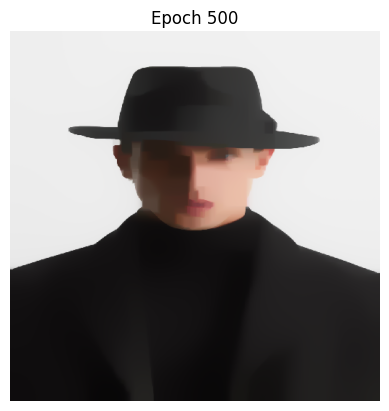

 33%|███▎      | 501/1500 [05:19<12:23,  1.34it/s]

Inside compute_loss:
Content Loss: 1.270561938326864e-06, Style Loss: 4.300083844555047e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 502/1500 [05:19<10:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.271412997994048e-06, Style Loss: 4.300081855035387e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 504/1500 [05:20<10:32,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2721874327326077e-06, Style Loss: 4.300133298329456e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.272950612474233e-06, Style Loss: 4.3001702465517155e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 505/1500 [05:21<10:33,  1.57it/s]

Inside compute_loss:
Content Loss: 1.273695829695498e-06, Style Loss: 4.300258638068044e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 506/1500 [05:21<10:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.274435021514364e-06, Style Loss: 4.3003188920920365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 507/1500 [05:22<10:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2751597751048394e-06, Style Loss: 4.3003421978937695e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 508/1500 [05:23<10:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.275929321309377e-06, Style Loss: 4.3004496319554164e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 509/1500 [05:23<10:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2767035286742612e-06, Style Loss: 4.3004487793041335e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 511/1500 [05:25<10:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2774920605806983e-06, Style Loss: 4.300402736134856e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2782655858245562e-06, Style Loss: 4.300506191157183e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 512/1500 [05:25<10:23,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2790384289473877e-06, Style Loss: 4.300441673876776e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 513/1500 [05:26<10:23,  1.58it/s]

Inside compute_loss:
Content Loss: 1.279812181564921e-06, Style Loss: 4.3003308292099973e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 514/1500 [05:26<10:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.280589344787586e-06, Style Loss: 4.300345608498901e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 515/1500 [05:27<10:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2813821967938566e-06, Style Loss: 4.300329408124526e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 516/1500 [05:28<10:30,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2821573136534425e-06, Style Loss: 4.300407283608365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 517/1500 [05:28<10:25,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2829578963646782e-06, Style Loss: 4.300442526528059e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 518/1500 [05:29<10:31,  1.56it/s]

Inside compute_loss:
Content Loss: 1.283720848732628e-06, Style Loss: 4.3004956751246937e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 519/1500 [05:30<10:32,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2844989214499947e-06, Style Loss: 4.300586624594871e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 521/1500 [05:31<10:11,  1.60it/s]

Inside compute_loss:
Content Loss: 1.28529552512191e-06, Style Loss: 4.300484590658016e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2859851494795294e-06, Style Loss: 4.300601403883775e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 522/1500 [05:32<10:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.286732185690198e-06, Style Loss: 4.3007219119317597e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 524/1500 [05:33<10:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2875678976342897e-06, Style Loss: 4.3006471628359577e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2883496083304635e-06, Style Loss: 4.300578098082042e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 525/1500 [05:33<10:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.289084480049496e-06, Style Loss: 4.3007094063796103e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 526/1500 [05:34<10:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2898776731162798e-06, Style Loss: 4.300833609249821e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 527/1500 [05:35<10:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2907092923342134e-06, Style Loss: 4.3007881345147325e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 528/1500 [05:35<10:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2915273828184581e-06, Style Loss: 4.300807461277145e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 530/1500 [05:37<10:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2923184158353251e-06, Style Loss: 4.300779039567715e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2931424180351314e-06, Style Loss: 4.3006957639590837e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 531/1500 [05:37<10:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2939120779265068e-06, Style Loss: 4.300771649923263e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 532/1500 [05:38<10:13,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2946571814609342e-06, Style Loss: 4.300863452044723e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 533/1500 [05:39<10:11,  1.58it/s]

Inside compute_loss:
Content Loss: 1.29537193060969e-06, Style Loss: 4.3009154637729807e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 534/1500 [05:39<10:10,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2961085076312884e-06, Style Loss: 4.301069225220999e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 535/1500 [05:40<10:09,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2968763485332602e-06, Style Loss: 4.300956106817466e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 536/1500 [05:40<10:16,  1.56it/s]

Inside compute_loss:
Content Loss: 1.297639641961723e-06, Style Loss: 4.301047340504738e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 537/1500 [05:41<10:17,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2984461363885202e-06, Style Loss: 4.3008432726310275e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 538/1500 [05:42<10:14,  1.57it/s]

Inside compute_loss:
Content Loss: 1.299218524764001e-06, Style Loss: 4.3008861894122674e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 539/1500 [05:42<10:24,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2999465752727701e-06, Style Loss: 4.3009964656448574e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 541/1500 [05:44<10:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3007135066800402e-06, Style Loss: 4.30090750569434e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 542/1500 [05:44<10:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3013917623538873e-06, Style Loss: 4.301123226468917e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3021325457884814e-06, Style Loss: 4.301188880617701e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 543/1500 [05:45<10:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3029022056798567e-06, Style Loss: 4.3012227024519234e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 544/1500 [05:45<09:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.303665726481995e-06, Style Loss: 4.301306546494743e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 545/1500 [05:46<09:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3044738125245203e-06, Style Loss: 4.3012863670810475e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 546/1500 [05:47<09:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3052091389909037e-06, Style Loss: 4.3013227468691184e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 547/1500 [05:47<09:57,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3059211596555542e-06, Style Loss: 4.301463718547893e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 548/1500 [05:48<09:56,  1.60it/s]

Inside compute_loss:
Content Loss: 1.306640001530468e-06, Style Loss: 4.30150578267785e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 549/1500 [05:49<10:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3073935178908869e-06, Style Loss: 4.3015248252231686e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 550/1500 [05:49<09:53,  1.60it/s]

Inside compute_loss:
Content Loss: 1.308131800215051e-06, Style Loss: 4.3015501205445617e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 551/1500 [05:50<09:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3088814512229874e-06, Style Loss: 4.301538467643695e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 552/1500 [05:51<09:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3096085922370548e-06, Style Loss: 4.301651301830134e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 553/1500 [05:51<09:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.310395077780413e-06, Style Loss: 4.301648743876285e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 554/1500 [05:52<09:52,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3111662156006787e-06, Style Loss: 4.301717808630201e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 555/1500 [05:52<09:52,  1.60it/s]

Inside compute_loss:
Content Loss: 1.311937126047269e-06, Style Loss: 4.301775504700345e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 556/1500 [05:53<09:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3127460078976583e-06, Style Loss: 4.301680576190847e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 557/1500 [05:54<10:04,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3135326071278541e-06, Style Loss: 4.3017021766900143e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 558/1500 [05:54<10:02,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3142825991963036e-06, Style Loss: 4.301752198898612e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 559/1500 [05:55<10:06,  1.55it/s]

Inside compute_loss:
Content Loss: 1.314974269917002e-06, Style Loss: 4.3018229689550935e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 561/1500 [05:56<09:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3156767408872838e-06, Style Loss: 4.3018638962166733e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3163780749891885e-06, Style Loss: 4.301979288356961e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 562/1500 [05:57<09:56,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3171567161407438e-06, Style Loss: 4.3020378370783874e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 563/1500 [05:57<09:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3178756717024953e-06, Style Loss: 4.3020585849262716e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 565/1500 [05:59<09:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3185905345380888e-06, Style Loss: 4.302154081869958e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 566/1500 [05:59<09:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3194066923460923e-06, Style Loss: 4.3021353235417337e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3201546380514628e-06, Style Loss: 4.3022387785640603e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 567/1500 [06:00<09:49,  1.58it/s]

Inside compute_loss:
Content Loss: 1.320909291280259e-06, Style Loss: 4.302406750866794e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 568/1500 [06:01<09:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3216698562246165e-06, Style Loss: 4.3023101170547307e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 569/1500 [06:01<09:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3223926771388506e-06, Style Loss: 4.302288800772658e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 570/1500 [06:02<09:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.323132096331392e-06, Style Loss: 4.3023706552958174e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 571/1500 [06:03<09:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3238586689112708e-06, Style Loss: 4.302471268147201e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 572/1500 [06:03<09:48,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3246163916846854e-06, Style Loss: 4.302530953737005e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 573/1500 [06:04<09:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3254153827801929e-06, Style Loss: 4.302431761971093e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 574/1500 [06:04<09:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3261789035823313e-06, Style Loss: 4.3024633100685605e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 575/1500 [06:05<09:45,  1.58it/s]

Inside compute_loss:
Content Loss: 1.326906726717425e-06, Style Loss: 4.302569323044736e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 576/1500 [06:06<09:50,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3276694517116994e-06, Style Loss: 4.302577849557565e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 577/1500 [06:06<09:47,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3284166016092058e-06, Style Loss: 4.3026659568567993e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 578/1500 [06:07<09:48,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3292001312947832e-06, Style Loss: 4.3026102503063157e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 579/1500 [06:08<09:53,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3298534895511693e-06, Style Loss: 4.302799254674028e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 580/1500 [06:08<09:57,  1.54it/s]

Inside compute_loss:
Content Loss: 1.3305422044140869e-06, Style Loss: 4.3029206153732957e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 581/1500 [06:09<09:40,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3313220961208572e-06, Style Loss: 4.302924594412616e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 582/1500 [06:10<09:39,  1.58it/s]

Inside compute_loss:
Content Loss: 1.33203150198824e-06, Style Loss: 4.302844160974928e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 583/1500 [06:10<09:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3328171917237341e-06, Style Loss: 4.302837623981759e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 584/1500 [06:11<09:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3336203892322374e-06, Style Loss: 4.30278419116803e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 586/1500 [06:12<09:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3344036915441393e-06, Style Loss: 4.302839613501419e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 587/1500 [06:13<09:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3351110510484432e-06, Style Loss: 4.3030615870520705e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3358367141336203e-06, Style Loss: 4.303187211007753e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 588/1500 [06:13<09:35,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3365880704441224e-06, Style Loss: 4.303063008137542e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 589/1500 [06:14<09:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3373164620134048e-06, Style Loss: 4.303051923670864e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 590/1500 [06:15<09:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3380481505009811e-06, Style Loss: 4.3030988194914244e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 591/1500 [06:15<09:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3387834769673645e-06, Style Loss: 4.3031857899222814e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 592/1500 [06:16<09:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3394355846685357e-06, Style Loss: 4.303176126541075e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 593/1500 [06:16<09:33,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3401777323451824e-06, Style Loss: 4.303375362724182e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 594/1500 [06:17<09:31,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3410062820184976e-06, Style Loss: 4.303292939766834e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 595/1500 [06:18<09:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3418092521533254e-06, Style Loss: 4.3032812868659676e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 596/1500 [06:18<09:33,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3426032410279731e-06, Style Loss: 4.30331709821985e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 597/1500 [06:19<09:42,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3433336789603345e-06, Style Loss: 4.303261107452272e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 598/1500 [06:20<09:35,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3440694601740688e-06, Style Loss: 4.303365699342976e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 599/1500 [06:20<09:46,  1.53it/s]

Inside compute_loss:
Content Loss: 1.3447744322547805e-06, Style Loss: 4.3034617647208506e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 600/1500 [06:21<09:35,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3454691725200973e-06, Style Loss: 4.3035410612901615e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 600, Loss: 869.866821, Alpha: 10.0000, Beta: 10.0000


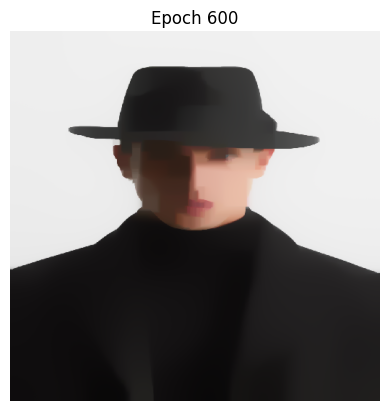

 40%|████      | 601/1500 [06:22<11:10,  1.34it/s]

Inside compute_loss:
Content Loss: 1.3461839216688531e-06, Style Loss: 4.303569767216686e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 602/1500 [06:22<09:42,  1.54it/s]

Inside compute_loss:
Content Loss: 1.3468757060763892e-06, Style Loss: 4.303655600779166e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 603/1500 [06:23<09:32,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3476011417878908e-06, Style Loss: 4.3035990415773995e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 604/1500 [06:24<09:34,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3483549992088228e-06, Style Loss: 4.3037354657826654e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 605/1500 [06:24<09:26,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3491371646523476e-06, Style Loss: 4.303591936150042e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 606/1500 [06:25<09:24,  1.58it/s]

Inside compute_loss:
Content Loss: 1.349838953501603e-06, Style Loss: 4.3035691987824976e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 607/1500 [06:25<09:24,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3505472225006088e-06, Style Loss: 4.3035626617893286e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 608/1500 [06:26<09:24,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3512404848370352e-06, Style Loss: 4.303821867779334e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 609/1500 [06:27<09:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3519338608602993e-06, Style Loss: 4.303925038584566e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 611/1500 [06:28<09:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.352611093352607e-06, Style Loss: 4.304094147755677e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3533044693758711e-06, Style Loss: 4.3040850528086594e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 612/1500 [06:29<09:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.353917468804866e-06, Style Loss: 4.304188223613892e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 613/1500 [06:29<09:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3545810588766471e-06, Style Loss: 4.304195897475438e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 614/1500 [06:30<09:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.355282279291714e-06, Style Loss: 4.304368133034586e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 615/1500 [06:31<09:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3560012348534656e-06, Style Loss: 4.3043721120739065e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 616/1500 [06:31<09:27,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3567563428296125e-06, Style Loss: 4.304468177451781e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 617/1500 [06:32<09:23,  1.57it/s]

Inside compute_loss:
Content Loss: 1.357391624878801e-06, Style Loss: 4.304546337152715e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 618/1500 [06:32<09:25,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3580616951003321e-06, Style Loss: 4.3047282360930694e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 620/1500 [06:34<09:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3587782632384915e-06, Style Loss: 4.3047873532486847e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3595505379271344e-06, Style Loss: 4.3048365228059993e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 621/1500 [06:34<09:15,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3603198567579966e-06, Style Loss: 4.304783942643553e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 622/1500 [06:35<09:16,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3610588212031871e-06, Style Loss: 4.304843059799168e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 623/1500 [06:36<09:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.361791532872303e-06, Style Loss: 4.3050079057138646e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 624/1500 [06:36<09:12,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3625216297441511e-06, Style Loss: 4.3049919895565836e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 625/1500 [06:37<09:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3632306945510209e-06, Style Loss: 4.3050872022831754e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 626/1500 [06:38<09:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3639760254591238e-06, Style Loss: 4.3050806652900064e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 628/1500 [06:39<09:05,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3646939578393358e-06, Style Loss: 4.305132677018264e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3654072290592012e-06, Style Loss: 4.3050854969806096e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 629/1500 [06:39<09:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3661806406162214e-06, Style Loss: 4.3053179865637503e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 630/1500 [06:40<09:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3669009604200255e-06, Style Loss: 4.305454410769016e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 631/1500 [06:41<09:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3676475418833434e-06, Style Loss: 4.3053464082731807e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 632/1500 [06:41<09:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3683115867024753e-06, Style Loss: 4.305497895984445e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 633/1500 [06:42<09:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.368985522276489e-06, Style Loss: 4.305673826365819e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 634/1500 [06:43<09:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.369659003103152e-06, Style Loss: 4.305742891119735e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 635/1500 [06:43<09:08,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3704485581911285e-06, Style Loss: 4.30575312293513e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 636/1500 [06:44<09:13,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3712232203033636e-06, Style Loss: 4.305831851070252e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 637/1500 [06:44<09:12,  1.56it/s]

Inside compute_loss:
Content Loss: 1.371973667119164e-06, Style Loss: 4.3058491883130046e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 638/1500 [06:45<09:14,  1.55it/s]

Inside compute_loss:
Content Loss: 1.372697283841262e-06, Style Loss: 4.305847483010439e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 639/1500 [06:46<09:19,  1.54it/s]

Inside compute_loss:
Content Loss: 1.3734261301578954e-06, Style Loss: 4.3058287246822147e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 640/1500 [06:46<09:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.374171574752836e-06, Style Loss: 4.3059162635472603e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 641/1500 [06:47<09:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3748361880061566e-06, Style Loss: 4.3061248788944795e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 642/1500 [06:48<08:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3754892052020296e-06, Style Loss: 4.3061592691628903e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 643/1500 [06:48<08:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3762601156486198e-06, Style Loss: 4.3062379972980125e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 644/1500 [06:49<08:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3769664519713842e-06, Style Loss: 4.30631246217672e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 645/1500 [06:50<08:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3775614888800192e-06, Style Loss: 4.306590710712044e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 647/1500 [06:51<08:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3781987036054488e-06, Style Loss: 4.3066185639872856e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3789154991172836e-06, Style Loss: 4.3066464172625274e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 648/1500 [06:51<08:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3796924349662731e-06, Style Loss: 4.306657501729205e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 650/1500 [06:53<08:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3804148011331563e-06, Style Loss: 4.3066827970505983e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3811041981171002e-06, Style Loss: 4.306830305722542e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 652/1500 [06:54<08:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.381738115924236e-06, Style Loss: 4.30695365594147e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3824597999700927e-06, Style Loss: 4.3071318600595987e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 653/1500 [06:55<08:56,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3832385548084858e-06, Style Loss: 4.3070485844509676e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 654/1500 [06:55<08:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3840108294971287e-06, Style Loss: 4.3071037225672626e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 655/1500 [06:56<08:56,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3847488844476175e-06, Style Loss: 4.307158292249369e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 656/1500 [06:57<09:04,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3854732969775796e-06, Style Loss: 4.3070571109637967e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 657/1500 [06:57<09:00,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3861989600627567e-06, Style Loss: 4.307254641844338e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 658/1500 [06:58<09:03,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3869452004655614e-06, Style Loss: 4.3073026745332754e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 659/1500 [06:58<09:07,  1.54it/s]

Inside compute_loss:
Content Loss: 1.3876768889531377e-06, Style Loss: 4.3074578570667654e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 660/1500 [06:59<08:50,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3884329064239864e-06, Style Loss: 4.3074149402855255e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 661/1500 [07:00<08:52,  1.57it/s]

Inside compute_loss:
Content Loss: 1.389132648910163e-06, Style Loss: 4.3075618805232807e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 662/1500 [07:00<08:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3897719099986716e-06, Style Loss: 4.307767653699557e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 664/1500 [07:02<08:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3904742672821158e-06, Style Loss: 4.3078318867628695e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3911604810346034e-06, Style Loss: 4.307828760374832e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 665/1500 [07:02<08:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3918673857915564e-06, Style Loss: 4.3079307943116874e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 666/1500 [07:03<08:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3925988469054573e-06, Style Loss: 4.3080115119664697e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 667/1500 [07:03<08:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3932536830907338e-06, Style Loss: 4.308143388698227e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 668/1500 [07:04<08:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3939562677478534e-06, Style Loss: 4.308103598305024e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 669/1500 [07:05<08:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3945974615126033e-06, Style Loss: 4.3083431933155225e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 670/1500 [07:05<08:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3952006838735542e-06, Style Loss: 4.308527081775537e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 671/1500 [07:06<08:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3958742783870548e-06, Style Loss: 4.308627694626921e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 672/1500 [07:07<08:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3965319567432743e-06, Style Loss: 4.308780034989468e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 673/1500 [07:07<08:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3972490933156223e-06, Style Loss: 4.308751329062943e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 675/1500 [07:08<08:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3979737332192599e-06, Style Loss: 4.30872802326121e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3986326621306944e-06, Style Loss: 4.308759855575772e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 676/1500 [07:09<08:48,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3992142839924782e-06, Style Loss: 4.308932375352015e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 677/1500 [07:10<08:48,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3998679833093775e-06, Style Loss: 4.309086989451316e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 678/1500 [07:10<08:53,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4005073580847238e-06, Style Loss: 4.3092444457215606e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 680/1500 [07:12<08:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4011176290296135e-06, Style Loss: 4.3094527768516855e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4018388583281194e-06, Style Loss: 4.3094834722978703e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 681/1500 [07:12<08:37,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4025681593921036e-06, Style Loss: 4.309468408791872e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 682/1500 [07:13<08:46,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4033058732820791e-06, Style Loss: 4.309439134431159e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 683/1500 [07:14<08:41,  1.57it/s]

Inside compute_loss:
Content Loss: 1.4040379028301686e-06, Style Loss: 4.3095658952552185e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 684/1500 [07:14<08:45,  1.55it/s]

Inside compute_loss:
Content Loss: 1.404764702783723e-06, Style Loss: 4.309609380470647e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 685/1500 [07:15<08:51,  1.53it/s]

Inside compute_loss:
Content Loss: 1.405530383635778e-06, Style Loss: 4.3096451918245293e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 686/1500 [07:16<08:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4062866284803022e-06, Style Loss: 4.3097128354929737e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 688/1500 [07:17<08:28,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4069831877350225e-06, Style Loss: 4.3096937929476553e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4076216530156671e-06, Style Loss: 4.3099257140966074e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 690/1500 [07:18<08:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4081657582210028e-06, Style Loss: 4.3100939706164354e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4088404896028806e-06, Style Loss: 4.310186341172084e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 691/1500 [07:19<08:32,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4095618325882242e-06, Style Loss: 4.3101519509036734e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 692/1500 [07:19<08:32,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4103102330409456e-06, Style Loss: 4.310184351652424e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 693/1500 [07:20<08:31,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4110049733062624e-06, Style Loss: 4.310331860324368e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 695/1500 [07:21<08:28,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4117314321993035e-06, Style Loss: 4.3104398628202034e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.412419806001708e-06, Style Loss: 4.3103622715534584e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 696/1500 [07:22<08:39,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4130755516816862e-06, Style Loss: 4.3106308567075757e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 697/1500 [07:23<08:35,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4137755215415382e-06, Style Loss: 4.310664962758892e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 698/1500 [07:23<08:39,  1.54it/s]

Inside compute_loss:
Content Loss: 1.414441271663236e-06, Style Loss: 4.310603287649428e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 699/1500 [07:24<08:39,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4151459026834345e-06, Style Loss: 4.310825545417174e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 700/1500 [07:24<08:27,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4158721342028002e-06, Style Loss: 4.3107991132274037e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 700, Loss: 850.504517, Alpha: 10.0000, Beta: 10.0000


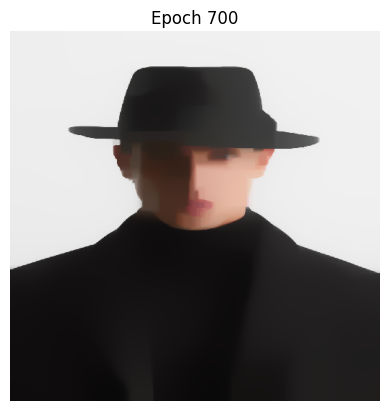

 47%|████▋     | 701/1500 [07:25<09:54,  1.34it/s]

Inside compute_loss:
Content Loss: 1.4165148058964405e-06, Style Loss: 4.310859935685585e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 702/1500 [07:26<08:35,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4172446753946133e-06, Style Loss: 4.3109204739266715e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 703/1500 [07:27<08:33,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4180033076627296e-06, Style Loss: 4.3109690750497975e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 704/1500 [07:27<08:29,  1.56it/s]

Inside compute_loss:
Content Loss: 1.418681108589226e-06, Style Loss: 4.311079635499482e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 705/1500 [07:28<08:23,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4193470860845991e-06, Style Loss: 4.3112129333167104e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 706/1500 [07:28<08:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.419994873685937e-06, Style Loss: 4.3113362835356384e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 707/1500 [07:29<08:20,  1.58it/s]

Inside compute_loss:
Content Loss: 1.420673584107135e-06, Style Loss: 4.3112711978210427e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 709/1500 [07:30<08:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4213504755389295e-06, Style Loss: 4.3115363723700284e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.422059199285286e-06, Style Loss: 4.3116662595821253e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 711/1500 [07:32<08:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4227193787519354e-06, Style Loss: 4.3116429537803924e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4234429954740335e-06, Style Loss: 4.3116403958265437e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 712/1500 [07:32<08:17,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4241016970117926e-06, Style Loss: 4.3115673520333075e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 713/1500 [07:33<08:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.424779043190938e-06, Style Loss: 4.311788472932676e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 714/1500 [07:33<08:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.425444679625798e-06, Style Loss: 4.311764882913849e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 715/1500 [07:34<08:23,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4261305523177725e-06, Style Loss: 4.3119058545926237e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 716/1500 [07:35<08:25,  1.55it/s]

Inside compute_loss:
Content Loss: 1.426867925147235e-06, Style Loss: 4.312030625897023e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 717/1500 [07:35<08:19,  1.57it/s]

Inside compute_loss:
Content Loss: 1.4275829016696662e-06, Style Loss: 4.312179271437344e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 718/1500 [07:36<08:22,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4283150449045934e-06, Style Loss: 4.3122068404954916e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 719/1500 [07:37<08:20,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4289877299233922e-06, Style Loss: 4.3122457782374113e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 720/1500 [07:37<08:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4296938388724811e-06, Style Loss: 4.312363444114453e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 721/1500 [07:38<08:12,  1.58it/s]

Inside compute_loss:
Content Loss: 1.430426095794246e-06, Style Loss: 4.312454962018819e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 722/1500 [07:39<08:11,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4311759741758578e-06, Style Loss: 4.31240152920509e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 723/1500 [07:39<08:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4318387684397749e-06, Style Loss: 4.312597923217254e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 724/1500 [07:40<08:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4325236179502099e-06, Style Loss: 4.312742021284066e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 725/1500 [07:40<08:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4331661759570125e-06, Style Loss: 4.3127946014465124e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 726/1500 [07:41<08:04,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4338082792164641e-06, Style Loss: 4.312840928832884e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 727/1500 [07:42<08:04,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4344522014653194e-06, Style Loss: 4.312831549668772e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 728/1500 [07:42<08:03,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4350149513120414e-06, Style Loss: 4.3131311144861684e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 729/1500 [07:43<08:06,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4357025293065817e-06, Style Loss: 4.3131498728143924e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 730/1500 [07:44<08:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4363876061906922e-06, Style Loss: 4.3131967686349526e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 731/1500 [07:44<08:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4371588576977956e-06, Style Loss: 4.3133798044436844e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 732/1500 [07:45<08:01,  1.60it/s]

Inside compute_loss:
Content Loss: 1.437884407096135e-06, Style Loss: 4.313464501137787e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 733/1500 [07:45<07:59,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4385004760697484e-06, Style Loss: 4.3136483895978017e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 734/1500 [07:46<08:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4390828937393962e-06, Style Loss: 4.313845920478343e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 735/1500 [07:47<08:12,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4397406857824535e-06, Style Loss: 4.3139138483638817e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 736/1500 [07:47<08:05,  1.57it/s]

Inside compute_loss:
Content Loss: 1.440429855392722e-06, Style Loss: 4.3140184402545856e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 737/1500 [07:48<08:04,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4410912854145863e-06, Style Loss: 4.3141920968992054e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 738/1500 [07:49<08:10,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4417695410884335e-06, Style Loss: 4.314319994591642e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 739/1500 [07:49<08:13,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4424339269680786e-06, Style Loss: 4.3144680716977746e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 740/1500 [07:50<07:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4430876262849779e-06, Style Loss: 4.3144530081917765e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 741/1500 [07:51<07:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4437565596381319e-06, Style Loss: 4.314437660468684e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 743/1500 [07:52<07:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.444419353902049e-06, Style Loss: 4.3144473238498904e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 744/1500 [07:52<07:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.445064185645606e-06, Style Loss: 4.3146792449988425e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4457215229413123e-06, Style Loss: 4.314808563776751e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 745/1500 [07:53<07:53,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4464347941611777e-06, Style Loss: 4.314850059472519e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 746/1500 [07:54<07:52,  1.60it/s]

Inside compute_loss:
Content Loss: 1.447096224183042e-06, Style Loss: 4.314918840009341e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 747/1500 [07:54<07:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4477808463198016e-06, Style Loss: 4.3150132000846497e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 748/1500 [07:55<07:50,  1.60it/s]

Inside compute_loss:
Content Loss: 1.448490024813509e-06, Style Loss: 4.314931913995679e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 749/1500 [07:56<07:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4491971569441375e-06, Style Loss: 4.3150299688932137e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 750/1500 [07:56<07:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4498226619252819e-06, Style Loss: 4.3151689510523283e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 751/1500 [07:57<07:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4504325918096583e-06, Style Loss: 4.315211867833568e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 752/1500 [07:57<07:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.451059574719693e-06, Style Loss: 4.315312764902046e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 753/1500 [07:58<07:48,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4516568853650824e-06, Style Loss: 4.3154847162441e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 754/1500 [07:59<07:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4522997844323982e-06, Style Loss: 4.315643309382722e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 755/1500 [07:59<07:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4529715599564952e-06, Style Loss: 4.3157757545486675e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 756/1500 [08:00<07:58,  1.56it/s]

Inside compute_loss:
Content Loss: 1.45361400427646e-06, Style Loss: 4.315704416057997e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 757/1500 [08:01<07:54,  1.57it/s]

Inside compute_loss:
Content Loss: 1.4543398947353126e-06, Style Loss: 4.315785702146968e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 758/1500 [08:01<07:58,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4549158322552103e-06, Style Loss: 4.3159121787539334e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 759/1500 [08:02<07:58,  1.55it/s]

Inside compute_loss:
Content Loss: 1.455560322938254e-06, Style Loss: 4.316098056733608e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 760/1500 [08:03<07:47,  1.58it/s]

Inside compute_loss:
Content Loss: 1.456265636079479e-06, Style Loss: 4.3160423501831247e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 761/1500 [08:03<07:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4569550330634229e-06, Style Loss: 4.3161440999028855e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 762/1500 [08:04<07:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4576320381820551e-06, Style Loss: 4.3161878693354083e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 763/1500 [08:04<07:40,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4583100664822268e-06, Style Loss: 4.316334525356069e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 764/1500 [08:05<07:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.458984229429916e-06, Style Loss: 4.3165042029613687e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 765/1500 [08:06<07:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4596630535379518e-06, Style Loss: 4.316526940328913e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 766/1500 [08:06<07:40,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4603056115447544e-06, Style Loss: 4.316649437896558e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 767/1500 [08:07<07:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.460951807530364e-06, Style Loss: 4.3167472085769987e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 768/1500 [08:08<07:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4616667840527953e-06, Style Loss: 4.316795241265936e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 769/1500 [08:08<07:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4623404922531336e-06, Style Loss: 4.316842705520685e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 770/1500 [08:09<07:37,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4630110172220157e-06, Style Loss: 4.3170257413294166e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 771/1500 [08:09<07:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4636492551289848e-06, Style Loss: 4.317192576763773e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 772/1500 [08:10<07:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4643051144958008e-06, Style Loss: 4.3173875496904657e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 773/1500 [08:11<07:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4649785953224637e-06, Style Loss: 4.317398065722955e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 774/1500 [08:11<07:35,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4657375686510932e-06, Style Loss: 4.3173218955416814e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 775/1500 [08:12<07:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4664429954791558e-06, Style Loss: 4.317347475080169e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 776/1500 [08:13<07:44,  1.56it/s]

Inside compute_loss:
Content Loss: 1.467084871364932e-06, Style Loss: 4.31750009965981e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 777/1500 [08:13<07:42,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4676728596896282e-06, Style Loss: 4.317600144077005e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 778/1500 [08:14<07:49,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4683437257190235e-06, Style Loss: 4.3177180941711413e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 779/1500 [08:15<07:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4690207308376557e-06, Style Loss: 4.3178079067729414e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 780/1500 [08:15<07:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.469780613660987e-06, Style Loss: 4.3179332465115294e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 781/1500 [08:16<07:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4704559134770534e-06, Style Loss: 4.317955983879074e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 782/1500 [08:16<07:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4711512221765588e-06, Style Loss: 4.3180892816963024e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 784/1500 [08:18<07:27,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4717885505888262e-06, Style Loss: 4.3181867681596486e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4723996173415799e-06, Style Loss: 4.3182990339118987e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 785/1500 [08:18<07:27,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4729915847055963e-06, Style Loss: 4.3183950992897735e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 786/1500 [08:19<07:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.473660631745588e-06, Style Loss: 4.3185866616113344e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 787/1500 [08:20<07:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4743401379746501e-06, Style Loss: 4.318796698044025e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 788/1500 [08:20<07:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4750550008102437e-06, Style Loss: 4.3188344989175675e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 789/1500 [08:21<07:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.475678459428309e-06, Style Loss: 4.318722517382412e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 790/1500 [08:21<07:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4762675846213824e-06, Style Loss: 4.3189982079638867e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 791/1500 [08:22<07:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4769422023164225e-06, Style Loss: 4.3189589860048727e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 792/1500 [08:23<07:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.477582713960146e-06, Style Loss: 4.3190999576836475e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 793/1500 [08:23<07:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4782534663027036e-06, Style Loss: 4.3193111309847154e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 794/1500 [08:24<07:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4789688975724857e-06, Style Loss: 4.3191766962991096e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 795/1500 [08:25<07:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.47972514241701e-06, Style Loss: 4.319271624808607e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 796/1500 [08:25<07:35,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4803754311287776e-06, Style Loss: 4.3194773979848833e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 797/1500 [08:26<07:29,  1.56it/s]

Inside compute_loss:
Content Loss: 1.481007871007023e-06, Style Loss: 4.319363142712973e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 798/1500 [08:27<07:32,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4816463362876675e-06, Style Loss: 4.319598474467057e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 799/1500 [08:27<07:34,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4823317542322911e-06, Style Loss: 4.319662139096181e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 800/1500 [08:28<07:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4830161489953753e-06, Style Loss: 4.3196803289902164e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 800, Loss: 834.767090, Alpha: 10.0000, Beta: 10.0000


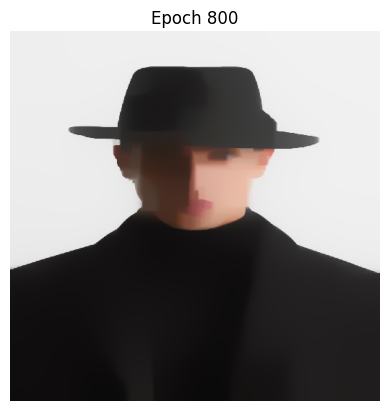

 53%|█████▎    | 801/1500 [08:29<08:39,  1.35it/s]

Inside compute_loss:
Content Loss: 1.4836820128039108e-06, Style Loss: 4.319899744587019e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 802/1500 [08:29<07:29,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4843163853583974e-06, Style Loss: 4.320102391375258e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 803/1500 [08:30<07:26,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4849647413939238e-06, Style Loss: 4.320185666983889e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 804/1500 [08:30<07:22,  1.57it/s]

Inside compute_loss:
Content Loss: 1.4856415191388805e-06, Style Loss: 4.3201347921240085e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 805/1500 [08:31<07:20,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4862511079627438e-06, Style Loss: 4.3203402810831903e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 807/1500 [08:32<07:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.486946075601736e-06, Style Loss: 4.3203377231293416e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4876299019306316e-06, Style Loss: 4.320416735481558e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 809/1500 [08:34<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4883006542731891e-06, Style Loss: 4.320434356941405e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4889465091982856e-06, Style Loss: 4.3207032263126166e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 810/1500 [08:34<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4895531421643682e-06, Style Loss: 4.320907294186327e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 811/1500 [08:35<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4901467011441127e-06, Style Loss: 4.321078677094192e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 812/1500 [08:35<07:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4907337799741072e-06, Style Loss: 4.32121851190459e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 813/1500 [08:36<07:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.491401576458884e-06, Style Loss: 4.321311450894427e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 814/1500 [08:37<07:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4920516377969761e-06, Style Loss: 4.3213529465901956e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 815/1500 [08:37<07:20,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4926721405572607e-06, Style Loss: 4.321535413964739e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 816/1500 [08:38<07:17,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4933839338482358e-06, Style Loss: 4.321521771544212e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 817/1500 [08:39<07:19,  1.55it/s]

Inside compute_loss:
Content Loss: 1.494142566116352e-06, Style Loss: 4.321531719142513e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 818/1500 [08:39<07:18,  1.55it/s]

Inside compute_loss:
Content Loss: 1.494788648415124e-06, Style Loss: 4.321637447901594e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 819/1500 [08:40<07:15,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4954042626413866e-06, Style Loss: 4.321690880715323e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 820/1500 [08:41<07:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.496031359238259e-06, Style Loss: 4.321897506542882e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 821/1500 [08:41<07:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.496719505666988e-06, Style Loss: 4.32188812737877e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 822/1500 [08:42<07:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4974613122831215e-06, Style Loss: 4.3218258838351176e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 824/1500 [08:43<07:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.498112851550104e-06, Style Loss: 4.321900064496731e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.498731194260472e-06, Style Loss: 4.3221811552029976e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 825/1500 [08:44<07:03,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4993798913565115e-06, Style Loss: 4.3222709678047977e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 826/1500 [08:44<07:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5000038047219277e-06, Style Loss: 4.3225176682426536e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 828/1500 [08:46<07:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5006406783868442e-06, Style Loss: 4.322502036302467e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5011642062745523e-06, Style Loss: 4.322761242292472e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 829/1500 [08:46<07:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5017653822724242e-06, Style Loss: 4.3228567392361583e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 830/1500 [08:47<07:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5023871355879237e-06, Style Loss: 4.32297042607388e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 831/1500 [08:47<06:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.502982399870234e-06, Style Loss: 4.3231960944467573e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 832/1500 [08:48<07:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5036384866107255e-06, Style Loss: 4.32325833799041e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 833/1500 [08:49<06:58,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5042674021970015e-06, Style Loss: 4.3234589952589886e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 834/1500 [08:49<06:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5048584600663162e-06, Style Loss: 4.323484574797476e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 835/1500 [08:50<07:09,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5054611139930785e-06, Style Loss: 4.3236317992523254e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 836/1500 [08:51<07:03,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5061096974022803e-06, Style Loss: 4.323786413351627e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 837/1500 [08:51<07:01,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5068263792272774e-06, Style Loss: 4.3237616864644224e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 838/1500 [08:52<07:08,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5075274859555066e-06, Style Loss: 4.323781865878118e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 839/1500 [08:53<07:04,  1.56it/s]

Inside compute_loss:
Content Loss: 1.508231321167841e-06, Style Loss: 4.3237955082986446e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 840/1500 [08:53<06:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.508951754658483e-06, Style Loss: 4.323852920151694e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 841/1500 [08:54<06:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5095641856532893e-06, Style Loss: 4.323875373302144e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 842/1500 [08:54<06:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5101880990187055e-06, Style Loss: 4.3240439140390663e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 844/1500 [08:56<06:50,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5107557373994496e-06, Style Loss: 4.324216718032403e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.511371806373063e-06, Style Loss: 4.3243713321317045e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 845/1500 [08:56<06:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5120239140742342e-06, Style Loss: 4.3243329628239735e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 846/1500 [08:57<06:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5127094457056955e-06, Style Loss: 4.3245543679404364e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 847/1500 [08:58<06:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5133583701754105e-06, Style Loss: 4.3246225800430693e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 848/1500 [08:58<06:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5140167306526564e-06, Style Loss: 4.324773499320145e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 849/1500 [08:59<06:47,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5146732721404987e-06, Style Loss: 4.3248303427390056e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 850/1500 [08:59<06:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5153644881138462e-06, Style Loss: 4.324785152221011e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 851/1500 [09:00<06:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5160591146923252e-06, Style Loss: 4.324805331634707e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 852/1500 [09:01<06:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5167188394116238e-06, Style Loss: 4.3249676195955544e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 853/1500 [09:01<06:49,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5173833389781066e-06, Style Loss: 4.32498978852891e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 854/1500 [09:02<06:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5179915635599173e-06, Style Loss: 4.3250986436760286e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 855/1500 [09:03<06:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5186010386969429e-06, Style Loss: 4.3253228909634345e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 856/1500 [09:03<06:49,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5193045328487642e-06, Style Loss: 4.3254371462353447e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 857/1500 [09:04<06:51,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5199797189779929e-06, Style Loss: 4.325484042055905e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 858/1500 [09:05<06:53,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5206284160740324e-06, Style Loss: 4.3255835180389113e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 859/1500 [09:05<06:53,  1.55it/s]

Inside compute_loss:
Content Loss: 1.521296326245647e-06, Style Loss: 4.3256255821688683e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 860/1500 [09:06<06:40,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5219748092931695e-06, Style Loss: 4.3254760839772644e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 861/1500 [09:06<06:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5226905816234648e-06, Style Loss: 4.325513316416618e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 862/1500 [09:07<06:39,  1.60it/s]

Inside compute_loss:
Content Loss: 1.523403170722304e-06, Style Loss: 4.325659972437279e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 863/1500 [09:08<06:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.524072445135971e-06, Style Loss: 4.3257153947706684e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 865/1500 [09:09<06:37,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5246370139720966e-06, Style Loss: 4.3259035464870976e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5252775256158202e-06, Style Loss: 4.3259737481093907e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 866/1500 [09:10<06:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5259821566360188e-06, Style Loss: 4.3258901882836653e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 867/1500 [09:10<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5266965647242614e-06, Style Loss: 4.325969200635882e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 868/1500 [09:11<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5273312783392612e-06, Style Loss: 4.32618435297627e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 869/1500 [09:11<06:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5280392062777537e-06, Style Loss: 4.326299460899463e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 870/1500 [09:12<06:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5287159840227105e-06, Style Loss: 4.3264014948363183e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 871/1500 [09:13<06:37,  1.58it/s]

Inside compute_loss:
Content Loss: 1.529383439446974e-06, Style Loss: 4.32642934811156e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 872/1500 [09:13<06:32,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5300056475098245e-06, Style Loss: 4.3264884652671753e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 874/1500 [09:15<06:31,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5306177374441177e-06, Style Loss: 4.326509781549248e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5311725292121992e-06, Style Loss: 4.3267306182315224e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 875/1500 [09:15<06:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5317522183977417e-06, Style Loss: 4.3267652927170275e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 876/1500 [09:16<06:42,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5323386151067098e-06, Style Loss: 4.326987266267679e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 877/1500 [09:17<06:38,  1.56it/s]

Inside compute_loss:
Content Loss: 1.532911483081989e-06, Style Loss: 4.327073099830159e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 878/1500 [09:17<06:41,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5335890566348098e-06, Style Loss: 4.327133353854151e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 879/1500 [09:18<06:41,  1.55it/s]

Inside compute_loss:
Content Loss: 1.534274247205758e-06, Style Loss: 4.327204408127727e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 880/1500 [09:18<06:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.53495375343482e-06, Style Loss: 4.3272652305859083e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 881/1500 [09:19<06:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5356457652160316e-06, Style Loss: 4.327287399519264e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 882/1500 [09:20<06:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5363197007900453e-06, Style Loss: 4.327208955601236e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 883/1500 [09:20<06:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5369292896139086e-06, Style Loss: 4.327320084485109e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 884/1500 [09:21<06:28,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5375379689430702e-06, Style Loss: 4.3275019834254635e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 885/1500 [09:22<06:25,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5382014453280135e-06, Style Loss: 4.327629312683712e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 886/1500 [09:22<06:24,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5388667407023604e-06, Style Loss: 4.327641534018767e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 887/1500 [09:23<06:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5395665968753747e-06, Style Loss: 4.3276850192341954e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 888/1500 [09:23<06:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5402389408336603e-06, Style Loss: 4.327737030962453e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 889/1500 [09:24<06:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5408231774927117e-06, Style Loss: 4.327789611124899e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 890/1500 [09:25<06:22,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5414279914693907e-06, Style Loss: 4.327904434830998e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 891/1500 [09:25<06:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5420770296259434e-06, Style Loss: 4.3280545014567906e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 892/1500 [09:26<06:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5426663821926923e-06, Style Loss: 4.3280994077576906e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 893/1500 [09:27<06:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5432743794008275e-06, Style Loss: 4.32819774687232e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 894/1500 [09:27<06:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5438150740010315e-06, Style Loss: 4.3283665718263364e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 895/1500 [09:28<06:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.54444535382936e-06, Style Loss: 4.328352360971621e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 896/1500 [09:29<06:26,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5450069668077049e-06, Style Loss: 4.3286536310915835e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 897/1500 [09:29<06:27,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5455894981641904e-06, Style Loss: 4.3287434436933836e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 898/1500 [09:30<06:30,  1.54it/s]

Inside compute_loss:
Content Loss: 1.546168732602382e-06, Style Loss: 4.3288108031447337e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 899/1500 [09:30<06:28,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5467579714822932e-06, Style Loss: 4.3290623352731927e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 900/1500 [09:31<06:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5473484609174193e-06, Style Loss: 4.329208422859665e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 900, Loss: 821.856628, Alpha: 10.0000, Beta: 10.0000


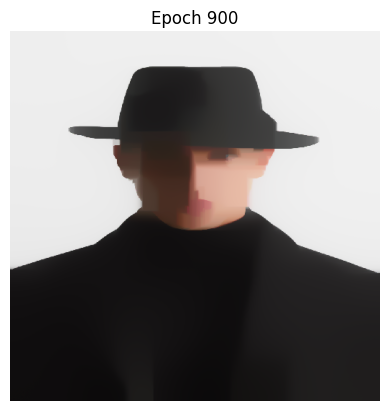

 60%|██████    | 901/1500 [09:32<07:24,  1.35it/s]

Inside compute_loss:
Content Loss: 1.5480255797228892e-06, Style Loss: 4.3292209284118144e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 902/1500 [09:32<06:26,  1.55it/s]

Inside compute_loss:
Content Loss: 1.548677005303034e-06, Style Loss: 4.3293499629726284e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 903/1500 [09:33<06:23,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5493183127546217e-06, Style Loss: 4.3294312490615994e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 904/1500 [09:34<06:19,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5500227164011449e-06, Style Loss: 4.32939430083934e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 905/1500 [09:34<06:19,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5507363286815234e-06, Style Loss: 4.329270950620412e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 906/1500 [09:35<06:15,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5514223150603357e-06, Style Loss: 4.3293124463161803e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 907/1500 [09:36<06:16,  1.57it/s]

Inside compute_loss:
Content Loss: 1.552096023260674e-06, Style Loss: 4.32937781624787e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 908/1500 [09:36<06:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5527566574746743e-06, Style Loss: 4.329346836584591e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 909/1500 [09:37<06:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5534157000729465e-06, Style Loss: 4.329546925418981e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 910/1500 [09:38<06:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5540417734882794e-06, Style Loss: 4.329626221988292e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 911/1500 [09:38<06:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5546571603408665e-06, Style Loss: 4.329715181938809e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 912/1500 [09:39<06:08,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5552959666820243e-06, Style Loss: 4.3297566776345775e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 913/1500 [09:39<06:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5558989616692998e-06, Style Loss: 4.329869227603922e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 914/1500 [09:40<06:06,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5565537978545763e-06, Style Loss: 4.3298484797560377e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 915/1500 [09:41<06:14,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5571500853184261e-06, Style Loss: 4.3298976493133523e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 916/1500 [09:41<06:12,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5578065131194307e-06, Style Loss: 4.3300437368998246e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 917/1500 [09:42<06:12,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5584032553306315e-06, Style Loss: 4.3300849483784987e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 918/1500 [09:43<06:13,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5590134125886834e-06, Style Loss: 4.330217961978633e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 919/1500 [09:43<06:13,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5595704780935193e-06, Style Loss: 4.330270542141079e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 920/1500 [09:44<06:03,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5601714267177158e-06, Style Loss: 4.3303558072693704e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 921/1500 [09:44<06:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5608126204824657e-06, Style Loss: 4.330360070525785e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 922/1500 [09:45<06:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.561444719300198e-06, Style Loss: 4.330322553869337e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 923/1500 [09:46<06:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5621502598150983e-06, Style Loss: 4.3303802499394806e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 925/1500 [09:47<06:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5628476148776826e-06, Style Loss: 4.3303913344061584e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5635379213563283e-06, Style Loss: 4.3305439589857997e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 926/1500 [09:48<06:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5641290929124807e-06, Style Loss: 4.3307215946697397e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 927/1500 [09:48<06:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5647432292098529e-06, Style Loss: 4.3306783936714055e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 928/1500 [09:49<05:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5653195077902637e-06, Style Loss: 4.330775880134752e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 929/1500 [09:49<05:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5659124983358197e-06, Style Loss: 4.330933336404996e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 930/1500 [09:50<05:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5664663806091994e-06, Style Loss: 4.3311513309163274e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 931/1500 [09:51<05:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5670866559958085e-06, Style Loss: 4.33128093391133e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 932/1500 [09:51<05:56,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5677004512326675e-06, Style Loss: 4.331416505465313e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 933/1500 [09:52<05:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.568234438309446e-06, Style Loss: 4.331648426614265e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 934/1500 [09:53<05:54,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5689032579757622e-06, Style Loss: 4.331730281137425e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 935/1500 [09:53<05:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5695135289206519e-06, Style Loss: 4.3318152620486217e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 936/1500 [09:54<06:01,  1.56it/s]

Inside compute_loss:
Content Loss: 1.570124027239217e-06, Style Loss: 4.3319337805769464e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 937/1500 [09:55<05:58,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5706800695625134e-06, Style Loss: 4.33223448226272e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 938/1500 [09:55<06:02,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5713063703515218e-06, Style Loss: 4.3322927467670524e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 940/1500 [09:56<05:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5719905377409304e-06, Style Loss: 4.332117669036961e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 941/1500 [09:57<05:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5725809134892188e-06, Style Loss: 4.3322168608028733e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 942/1500 [09:58<05:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5732099427623325e-06, Style Loss: 4.332511309712572e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.573828399159538e-06, Style Loss: 4.332447645083448e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 944/1500 [09:59<05:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5744766415082267e-06, Style Loss: 4.332558773967321e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5751571709188283e-06, Style Loss: 4.332650291871687e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 945/1500 [10:00<05:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.57587362537015e-06, Style Loss: 4.33267359767342e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 946/1500 [10:00<05:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5765867829031777e-06, Style Loss: 4.332696903475153e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 947/1500 [10:01<05:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5772117194501334e-06, Style Loss: 4.332790695116273e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 948/1500 [10:02<05:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5777847011122503e-06, Style Loss: 4.332979415266891e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 949/1500 [10:02<05:49,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5783574554006918e-06, Style Loss: 4.3330041421540955e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 950/1500 [10:03<05:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5789840972502134e-06, Style Loss: 4.33300442637119e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 951/1500 [10:03<05:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5795279750818736e-06, Style Loss: 4.333259084887686e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 952/1500 [10:04<05:43,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5801533663761802e-06, Style Loss: 4.333303706971492e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 953/1500 [10:05<05:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.580787625243829e-06, Style Loss: 4.3333707822057477e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 954/1500 [10:05<05:42,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5813526488273055e-06, Style Loss: 4.3334088672963844e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 955/1500 [10:06<05:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5819683767404058e-06, Style Loss: 4.3336194721632637e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 956/1500 [10:07<05:50,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5825967238924932e-06, Style Loss: 4.3336623889445036e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 957/1500 [10:07<05:45,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5832691815376165e-06, Style Loss: 4.333533638600784e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 958/1500 [10:08<05:51,  1.54it/s]

Inside compute_loss:
Content Loss: 1.583855009812396e-06, Style Loss: 4.333687115831708e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 960/1500 [10:09<05:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5843698975004372e-06, Style Loss: 4.3339625221960887e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.584997221470985e-06, Style Loss: 4.3339429112165817e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 961/1500 [10:10<05:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5855980564083438e-06, Style Loss: 4.334116283644107e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 963/1500 [10:11<05:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5861904785197112e-06, Style Loss: 4.334342520451173e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5868123455220484e-06, Style Loss: 4.33436213143068e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 965/1500 [10:12<05:35,  1.60it/s]

Inside compute_loss:
Content Loss: 1.587415681569837e-06, Style Loss: 4.334532945904357e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5879622878856026e-06, Style Loss: 4.3347128553250514e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 967/1500 [10:14<05:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5885667608017684e-06, Style Loss: 4.334777941039647e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5893077716100379e-06, Style Loss: 4.3347074552002596e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 968/1500 [10:14<05:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5899591971901827e-06, Style Loss: 4.334717971232749e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 970/1500 [10:15<05:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5905889085843228e-06, Style Loss: 4.334918060067139e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.591248746990459e-06, Style Loss: 4.3349689349270193e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 971/1500 [10:16<05:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5918803910608403e-06, Style Loss: 4.3350914324946643e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 972/1500 [10:17<05:33,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5924644003462163e-06, Style Loss: 4.3352923739803373e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 973/1500 [10:17<05:29,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5930933159324923e-06, Style Loss: 4.335390997312061e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 974/1500 [10:18<05:29,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5937130228849128e-06, Style Loss: 4.3355871071071306e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 975/1500 [10:19<05:28,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5943305697874166e-06, Style Loss: 4.335656740295235e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 976/1500 [10:19<05:35,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5949350427035824e-06, Style Loss: 4.335865355642454e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 977/1500 [10:20<05:32,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5955729395500384e-06, Style Loss: 4.335833523327892e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 978/1500 [10:20<05:36,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5962031056915293e-06, Style Loss: 4.3358841139706783e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 980/1500 [10:22<05:25,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5967693798302207e-06, Style Loss: 4.336035317464848e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.597400228092738e-06, Style Loss: 4.3360452650631487e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 981/1500 [10:22<05:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5980061789377942e-06, Style Loss: 4.3360901713640487e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 982/1500 [10:23<05:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5985319805622566e-06, Style Loss: 4.336141898875212e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 983/1500 [10:24<05:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5991096233847202e-06, Style Loss: 4.336297934059985e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 984/1500 [10:24<05:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.599730808266031e-06, Style Loss: 4.3364201474105357e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 986/1500 [10:25<05:22,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6003923519747332e-06, Style Loss: 4.3365949409235327e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6010538956834353e-06, Style Loss: 4.3367117541492917e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 987/1500 [10:26<05:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6017228290365892e-06, Style Loss: 4.3366975432945765e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 988/1500 [10:27<05:20,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6023601574488566e-06, Style Loss: 4.3367546709305316e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 989/1500 [10:27<05:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6029722473831498e-06, Style Loss: 4.3369931290726527e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 990/1500 [10:28<05:28,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6036347005865537e-06, Style Loss: 4.3370650359975116e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 991/1500 [10:29<05:24,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6043928781073191e-06, Style Loss: 4.33699426594103e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 992/1500 [10:29<05:25,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6050240674303495e-06, Style Loss: 4.337260008924204e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 993/1500 [10:30<05:25,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6057106222433504e-06, Style Loss: 4.337195207426703e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 994/1500 [10:31<05:27,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6063454495451879e-06, Style Loss: 4.337334758020006e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 995/1500 [10:31<05:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.607006538506539e-06, Style Loss: 4.3373680114200397e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 996/1500 [10:32<05:22,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6076120346042444e-06, Style Loss: 4.337537404808245e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 997/1500 [10:33<05:20,  1.57it/s]

Inside compute_loss:
Content Loss: 1.608195361768594e-06, Style Loss: 4.3377400515964837e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 998/1500 [10:33<05:25,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6087988115032203e-06, Style Loss: 4.337892960393219e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 999/1500 [10:34<05:23,  1.55it/s]

Inside compute_loss:
Content Loss: 1.609412720426917e-06, Style Loss: 4.3379699832257756e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1000/1500 [10:34<05:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6099602362373844e-06, Style Loss: 4.3380896386224777e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1000, Loss: 810.903625, Alpha: 10.0000, Beta: 10.0000


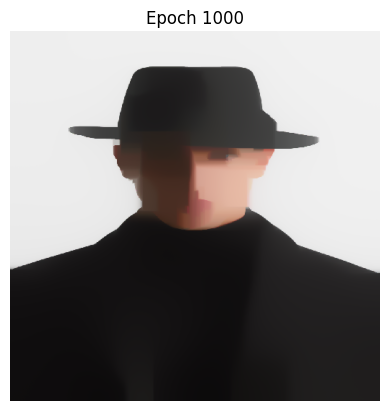

 67%|██████▋   | 1001/1500 [10:35<06:09,  1.35it/s]

Inside compute_loss:
Content Loss: 1.6105306031022337e-06, Style Loss: 4.3381987779866904e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1002/1500 [10:36<05:20,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6111274590002722e-06, Style Loss: 4.338238568379893e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1003/1500 [10:36<05:17,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6117083987410297e-06, Style Loss: 4.3383110437389405e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1004/1500 [10:37<05:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6124346302603954e-06, Style Loss: 4.3383008119235456e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1005/1500 [10:38<05:13,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6130725271068513e-06, Style Loss: 4.338428141181794e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1006/1500 [10:38<05:14,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6136690419443767e-06, Style Loss: 4.3385711023802287e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1007/1500 [10:39<05:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.614290454199363e-06, Style Loss: 4.338632209055504e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1008/1500 [10:40<05:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6149260773090646e-06, Style Loss: 4.338864130204456e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1009/1500 [10:40<05:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6156260471689166e-06, Style Loss: 4.3388297399360454e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1010/1500 [10:41<05:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6162663314389647e-06, Style Loss: 4.3389138681959594e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1011/1500 [10:41<05:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6169527725651278e-06, Style Loss: 4.338958206062671e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1012/1500 [10:42<05:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.617643306417449e-06, Style Loss: 4.3389297843532404e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1013/1500 [10:43<05:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6182588069568737e-06, Style Loss: 4.339071324466204e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1014/1500 [10:43<05:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6188733980015968e-06, Style Loss: 4.3390596715653373e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1015/1500 [10:44<05:10,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6195130001506186e-06, Style Loss: 4.339260328833916e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1016/1500 [10:45<05:09,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6201255448322627e-06, Style Loss: 4.3393487203502445e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1017/1500 [10:45<05:09,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6207636690523941e-06, Style Loss: 4.339515555784601e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1018/1500 [10:46<05:07,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6214402194236754e-06, Style Loss: 4.3395962734393834e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1019/1500 [10:47<05:08,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6221723626586027e-06, Style Loss: 4.3395226612119586e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1020/1500 [10:47<05:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6228572121690377e-06, Style Loss: 4.339692338817258e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1021/1500 [10:48<05:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6235177326962003e-06, Style Loss: 4.3396255478000967e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1022/1500 [10:48<04:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6241366438407567e-06, Style Loss: 4.339740939940384e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1023/1500 [10:49<04:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6247228131760494e-06, Style Loss: 4.339813699516526e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1024/1500 [10:50<04:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6252921568593592e-06, Style Loss: 4.340089390098001e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1026/1500 [10:51<04:56,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6258269397440017e-06, Style Loss: 4.340306247740955e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6263830957541359e-06, Style Loss: 4.340418513493205e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1027/1500 [10:52<04:56,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6270018932118546e-06, Style Loss: 4.3405441374488873e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1028/1500 [10:52<04:55,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6276477481369511e-06, Style Loss: 4.3407058569755463e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1029/1500 [10:53<04:54,  1.60it/s]

Inside compute_loss:
Content Loss: 1.628301220080175e-06, Style Loss: 4.340829775628663e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1030/1500 [10:53<04:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6290065332213999e-06, Style Loss: 4.340745931585843e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1031/1500 [10:54<04:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6296313560815179e-06, Style Loss: 4.340748773756786e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1032/1500 [10:55<04:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6303343954859884e-06, Style Loss: 4.340772079558519e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1034/1500 [10:56<04:51,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6309776356138173e-06, Style Loss: 4.3407928274064034e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6316502069457783e-06, Style Loss: 4.340938346558687e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1035/1500 [10:57<04:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.63227434768487e-06, Style Loss: 4.341115129591344e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1036/1500 [10:57<04:56,  1.57it/s]

Inside compute_loss:
Content Loss: 1.63293100285955e-06, Style Loss: 4.341156056852924e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1037/1500 [10:58<04:56,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6336034605046734e-06, Style Loss: 4.3410969396973087e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1038/1500 [10:59<04:57,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6341995205948479e-06, Style Loss: 4.3411415617811144e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1039/1500 [10:59<04:58,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6348359395124135e-06, Style Loss: 4.341185046996543e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1041/1500 [11:00<04:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.635541025279963e-06, Style Loss: 4.3411202454990416e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1042/1500 [11:01<04:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6362067754016607e-06, Style Loss: 4.3412399008957436e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6368421711376868e-06, Style Loss: 4.34140474681044e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1043/1500 [11:02<04:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6375429368054029e-06, Style Loss: 4.3414885908532597e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1044/1500 [11:02<04:48,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6382533658543252e-06, Style Loss: 4.3414809169917135e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1045/1500 [11:03<04:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6388434005421004e-06, Style Loss: 4.3415107597866154e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1046/1500 [11:04<04:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.639476977288723e-06, Style Loss: 4.341587782619172e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1047/1500 [11:04<04:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6400750837419764e-06, Style Loss: 4.3418054929134087e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1049/1500 [11:05<04:42,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6406348777309177e-06, Style Loss: 4.342039403582021e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6413268895121291e-06, Style Loss: 4.3420448037068127e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1050/1500 [11:06<04:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6419445501014707e-06, Style Loss: 4.342199417806114e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1051/1500 [11:07<04:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6425419744336978e-06, Style Loss: 4.3423773377071484e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1052/1500 [11:07<04:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6431635003755218e-06, Style Loss: 4.34233584201138e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1053/1500 [11:08<04:44,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6437601288998849e-06, Style Loss: 4.342362842635339e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1054/1500 [11:09<04:39,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6443578942926251e-06, Style Loss: 4.342563784121012e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1055/1500 [11:09<04:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6449879467472783e-06, Style Loss: 4.342742272456235e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1056/1500 [11:10<04:45,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6455742297694087e-06, Style Loss: 4.3427567675280443e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1057/1500 [11:11<04:43,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6461766563224955e-06, Style Loss: 4.342746251495555e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1058/1500 [11:11<04:47,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6469106185468263e-06, Style Loss: 4.342859369899088e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1059/1500 [11:12<04:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6476224118378013e-06, Style Loss: 4.3429736251709983e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1060/1500 [11:12<04:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.648283273425477e-06, Style Loss: 4.3429821516838274e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1062/1500 [11:14<04:34,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6488530718561378e-06, Style Loss: 4.3431839458207833e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6494517467435799e-06, Style Loss: 4.343252157923416e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1063/1500 [11:14<04:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.650103854444751e-06, Style Loss: 4.343428372521885e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1064/1500 [11:15<04:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6507283362443559e-06, Style Loss: 4.343405066720152e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1065/1500 [11:16<04:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6513625951120048e-06, Style Loss: 4.343509090176667e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1066/1500 [11:16<04:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.652014248065825e-06, Style Loss: 4.3436168084554083e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1067/1500 [11:17<04:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6527061461601988e-06, Style Loss: 4.3436946839392476e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1069/1500 [11:18<04:30,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6533555253772647e-06, Style Loss: 4.3437682961666724e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1070/1500 [11:19<04:29,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6540344631721382e-06, Style Loss: 4.3439655428301194e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6546846381970681e-06, Style Loss: 4.344054786997731e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1071/1500 [11:19<04:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6552513670831104e-06, Style Loss: 4.3441974639790715e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1072/1500 [11:20<04:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6558859670112724e-06, Style Loss: 4.3442767605483823e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1073/1500 [11:21<04:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6565976466154098e-06, Style Loss: 4.344247486187669e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1074/1500 [11:21<04:26,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6573303582845256e-06, Style Loss: 4.3443571939860703e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1075/1500 [11:22<04:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6580246438024915e-06, Style Loss: 4.344417732227157e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1076/1500 [11:23<04:33,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6586791389272548e-06, Style Loss: 4.3445965047794743e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1077/1500 [11:23<04:29,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6593497775829746e-06, Style Loss: 4.3445930941743427e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1078/1500 [11:24<04:34,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6600700973867788e-06, Style Loss: 4.344662727362447e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1080/1500 [11:25<04:22,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6607172028670902e-06, Style Loss: 4.344873900663515e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6613031448287074e-06, Style Loss: 4.3449023223729455e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1081/1500 [11:26<04:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6619848111076863e-06, Style Loss: 4.344916817444755e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1082/1500 [11:26<04:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6626212300252519e-06, Style Loss: 4.344976503034559e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1083/1500 [11:27<04:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6632526467219577e-06, Style Loss: 4.345255320004071e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1084/1500 [11:28<04:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6639609157209634e-06, Style Loss: 4.345181139342458e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1085/1500 [11:28<04:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6646646372464602e-06, Style Loss: 4.345177728737326e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1086/1500 [11:29<04:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6653480088280048e-06, Style Loss: 4.3452669729049376e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1087/1500 [11:29<04:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6659627135595656e-06, Style Loss: 4.3453201215015724e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1088/1500 [11:30<04:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6665811699567712e-06, Style Loss: 4.345385207216168e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1089/1500 [11:31<04:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6671677940394147e-06, Style Loss: 4.3455332843223005e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1090/1500 [11:31<04:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.667805577199033e-06, Style Loss: 4.3457137621771835e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1092/1500 [11:33<04:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.66843244642223e-06, Style Loss: 4.345798174654192e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1093/1500 [11:33<04:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6690902384652873e-06, Style Loss: 4.345845070474752e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6698742228982155e-06, Style Loss: 4.345804711647361e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1094/1500 [11:34<04:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6705665757399402e-06, Style Loss: 4.345885997736332e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1095/1500 [11:35<04:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6711993566786987e-06, Style Loss: 4.3460548226903484e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1096/1500 [11:35<04:22,  1.54it/s]

Inside compute_loss:
Content Loss: 1.671852260187734e-06, Style Loss: 4.3462017629281036e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1097/1500 [11:36<04:16,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6725119849070325e-06, Style Loss: 4.3461847099024453e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1098/1500 [11:36<04:19,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6731631831135019e-06, Style Loss: 4.346290154444432e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1099/1500 [11:37<04:21,  1.53it/s]

Inside compute_loss:
Content Loss: 1.6737764099161723e-06, Style Loss: 4.346477169292484e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1100/1500 [11:38<04:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6744553477110458e-06, Style Loss: 4.3466297938721254e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1100, Loss: 801.235046, Alpha: 10.0000, Beta: 10.0000


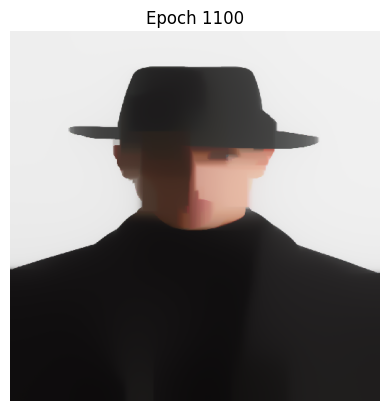

 73%|███████▎  | 1101/1500 [11:39<04:55,  1.35it/s]

Inside compute_loss:
Content Loss: 1.6751222347011208e-06, Style Loss: 4.3465615817694925e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1102/1500 [11:39<04:17,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6758117453719024e-06, Style Loss: 4.3465954036037147e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1103/1500 [11:40<04:11,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6764548718128935e-06, Style Loss: 4.346694879586721e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1104/1500 [11:40<04:11,  1.58it/s]

Inside compute_loss:
Content Loss: 1.677078671491472e-06, Style Loss: 4.3468057242534996e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1105/1500 [11:41<04:09,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6777003111201338e-06, Style Loss: 4.346929358689522e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1106/1500 [11:42<04:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6782483953647898e-06, Style Loss: 4.3472488187035196e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1107/1500 [11:42<04:08,  1.58it/s]

Inside compute_loss:
Content Loss: 1.678877197264228e-06, Style Loss: 4.347231197243673e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1108/1500 [11:43<04:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6795107740108506e-06, Style Loss: 4.347311914898455e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1109/1500 [11:44<04:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6800881894596387e-06, Style Loss: 4.3474270228216483e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1110/1500 [11:44<04:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6807235851956648e-06, Style Loss: 4.34750177191745e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1111/1500 [11:45<04:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.681332832959015e-06, Style Loss: 4.3476197220115864e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1112/1500 [11:45<04:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6819180927996058e-06, Style Loss: 4.347846527252841e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1113/1500 [11:46<04:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.68257304267172e-06, Style Loss: 4.34789598102725e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1114/1500 [11:47<04:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.683247319306247e-06, Style Loss: 4.348003699305991e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1115/1500 [11:47<04:07,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6838689589349087e-06, Style Loss: 4.348069921888964e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1116/1500 [11:48<04:04,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6845395975906285e-06, Style Loss: 4.3482356204549433e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1117/1500 [11:49<04:04,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6852119415489142e-06, Style Loss: 4.3481799139044597e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1118/1500 [11:49<04:05,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6858720073287259e-06, Style Loss: 4.348410982402129e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1119/1500 [11:50<04:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.686526161392976e-06, Style Loss: 4.3484629941303865e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1120/1500 [11:51<04:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6872485275598592e-06, Style Loss: 4.3485528067321866e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1122/1500 [11:52<03:56,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6879389477253426e-06, Style Loss: 4.348689799371641e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.688610154815251e-06, Style Loss: 4.348656830188702e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1123/1500 [11:52<03:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.689296254880901e-06, Style Loss: 4.3487378320605785e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1124/1500 [11:53<03:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6899213051146944e-06, Style Loss: 4.348875677351316e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1125/1500 [11:54<03:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6905368056541192e-06, Style Loss: 4.348895572547917e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1126/1500 [11:54<03:54,  1.60it/s]

Inside compute_loss:
Content Loss: 1.691153556748759e-06, Style Loss: 4.3488529399837716e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1127/1500 [11:55<03:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6917988432396669e-06, Style Loss: 4.348932804987271e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1128/1500 [11:56<03:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6924292367548333e-06, Style Loss: 4.3491061774147965e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1129/1500 [11:56<03:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6930983974816627e-06, Style Loss: 4.349165294570412e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1130/1500 [11:57<03:51,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6937584632614744e-06, Style Loss: 4.349371351963782e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1131/1500 [11:57<03:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6943953369263909e-06, Style Loss: 4.349523408109235e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1132/1500 [11:58<03:50,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6950303916019038e-06, Style Loss: 4.3495316504049697e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1133/1500 [11:59<03:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6957628758973442e-06, Style Loss: 4.349550408733194e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1134/1500 [11:59<03:49,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6964745555014815e-06, Style Loss: 4.3495603563314944e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1135/1500 [12:00<03:56,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6971594050119165e-06, Style Loss: 4.3497297497196996e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1136/1500 [12:01<03:53,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6977979839793989e-06, Style Loss: 4.349701328010269e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1137/1500 [12:01<03:52,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6984930653052288e-06, Style Loss: 4.3498351942616864e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1138/1500 [12:02<03:55,  1.54it/s]

Inside compute_loss:
Content Loss: 1.6991871234495193e-06, Style Loss: 4.3497118440427585e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1139/1500 [12:02<03:46,  1.60it/s]

Inside compute_loss:
Content Loss: 1.69984025433223e-06, Style Loss: 4.349867595010437e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1141/1500 [12:04<03:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7005295376293361e-06, Style Loss: 4.350055462509772e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7012235957736266e-06, Style Loss: 4.3501071900209354e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1142/1500 [12:04<03:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7019837059706333e-06, Style Loss: 4.350093547600409e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1143/1500 [12:05<03:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7026951582010952e-06, Style Loss: 4.350130211605574e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1144/1500 [12:06<03:42,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7034676602634136e-06, Style Loss: 4.350089852778183e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1145/1500 [12:06<03:42,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7041843420884106e-06, Style Loss: 4.350125664132065e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1146/1500 [12:07<03:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7048182598955464e-06, Style Loss: 4.3502691937646887e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1147/1500 [12:07<03:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7055346006600303e-06, Style Loss: 4.3503501956365653e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1148/1500 [12:08<03:44,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7062549204638344e-06, Style Loss: 4.3504758195922477e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1149/1500 [12:09<03:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.706925218059041e-06, Style Loss: 4.350561368937633e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1150/1500 [12:09<03:38,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7076039284802391e-06, Style Loss: 4.350597748725704e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1151/1500 [12:10<03:38,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7083053762689815e-06, Style Loss: 4.35066482395996e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1152/1500 [12:11<03:37,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7089677157855476e-06, Style Loss: 4.350794142737868e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1154/1500 [12:12<03:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7095504745157086e-06, Style Loss: 4.350842743860994e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7101950788855902e-06, Style Loss: 4.3510655700629286e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1155/1500 [12:13<03:43,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7107616940847947e-06, Style Loss: 4.3511624880920863e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1156/1500 [12:13<03:41,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7114283537011943e-06, Style Loss: 4.351269637936639e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1157/1500 [12:14<03:41,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7121519704232924e-06, Style Loss: 4.3513421132956864e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1158/1500 [12:15<03:41,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7128122635767795e-06, Style Loss: 4.35137735621538e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1160/1500 [12:16<03:33,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7134549352704198e-06, Style Loss: 4.351564939497621e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.714033146527072e-06, Style Loss: 4.3517275116755627e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1162/1500 [12:17<03:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7146434174719616e-06, Style Loss: 4.351799702817516e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1163/1500 [12:18<03:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7152724467450753e-06, Style Loss: 4.351797144863667e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7159372873720713e-06, Style Loss: 4.3518508618944907e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1164/1500 [12:18<03:32,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7166212273878045e-06, Style Loss: 4.3520972781152523e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1165/1500 [12:19<03:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7173239257317618e-06, Style Loss: 4.352154974185396e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1166/1500 [12:20<03:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7180658460347331e-06, Style Loss: 4.35217572203328e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1167/1500 [12:20<03:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7187957155329059e-06, Style Loss: 4.352269229457306e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1168/1500 [12:21<03:27,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7195266082126182e-06, Style Loss: 4.3522882720026246e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1170/1500 [12:22<03:26,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7202050912601408e-06, Style Loss: 4.3524394754967943e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1171/1500 [12:23<03:26,  1.60it/s]

Inside compute_loss:
Content Loss: 1.720940531413362e-06, Style Loss: 4.3524238435566076e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7215817251781118e-06, Style Loss: 4.3524136117412127e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1172/1500 [12:23<03:25,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7222073438460939e-06, Style Loss: 4.3524201487343817e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1173/1500 [12:24<03:24,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7229098148163757e-06, Style Loss: 4.352502003257541e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1174/1500 [12:25<03:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.723648892948404e-06, Style Loss: 4.3526884496714047e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1175/1500 [12:25<03:28,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7242555259144865e-06, Style Loss: 4.3528632431844017e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1176/1500 [12:26<03:26,  1.57it/s]

Inside compute_loss:
Content Loss: 1.724822595861042e-06, Style Loss: 4.353095164333354e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1177/1500 [12:26<03:26,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7254291151402867e-06, Style Loss: 4.353130691470142e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1179/1500 [12:28<03:21,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7261155562664499e-06, Style Loss: 4.3531287019504816e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7267589100811165e-06, Style Loss: 4.353174745119759e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1180/1500 [12:28<03:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7273533785555628e-06, Style Loss: 4.3532352833608456e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1181/1500 [12:29<03:19,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7279859321206459e-06, Style Loss: 4.3533725602173945e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1182/1500 [12:30<03:20,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7286193951804307e-06, Style Loss: 4.3533697180464515e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1183/1500 [12:30<03:18,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7292663869739044e-06, Style Loss: 4.3534933524824737e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1184/1500 [12:31<03:18,  1.60it/s]

Inside compute_loss:
Content Loss: 1.729934297145519e-06, Style Loss: 4.353690030711732e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1185/1500 [12:31<03:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7305686697000056e-06, Style Loss: 4.3535706595321244e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1187/1500 [12:33<03:16,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7312864883933798e-06, Style Loss: 4.3537568217288936e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7320830920652952e-06, Style Loss: 4.3536530824894726e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1189/1500 [12:34<03:14,  1.60it/s]

Inside compute_loss:
Content Loss: 1.732849682412052e-06, Style Loss: 4.353758242814365e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1190/1500 [12:35<03:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7335237316729035e-06, Style Loss: 4.3537707483665145e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1191/1500 [12:35<03:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7341332068099291e-06, Style Loss: 4.353955205260718e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1192/1500 [12:36<03:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.734722559376678e-06, Style Loss: 4.3539193939068355e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.735346927489445e-06, Style Loss: 4.354006932771881e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1193/1500 [12:37<03:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7359303683406324e-06, Style Loss: 4.3541689365156344e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1194/1500 [12:37<03:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7365450730721932e-06, Style Loss: 4.3542297589738155e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1195/1500 [12:38<03:16,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7372523188896594e-06, Style Loss: 4.354427574071451e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1196/1500 [12:38<03:13,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7379921928295516e-06, Style Loss: 4.3544301320253e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1197/1500 [12:39<03:16,  1.54it/s]

Inside compute_loss:
Content Loss: 1.7387766320098308e-06, Style Loss: 4.354521081495477e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1198/1500 [12:40<03:18,  1.52it/s]

Inside compute_loss:
Content Loss: 1.7395050235791132e-06, Style Loss: 4.354716338639264e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1199/1500 [12:40<03:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7402612684236374e-06, Style Loss: 4.354751013124769e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1200/1500 [12:41<03:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7409798829248757e-06, Style Loss: 4.35462823134003e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1200, Loss: 792.422302, Alpha: 10.0000, Beta: 10.0000


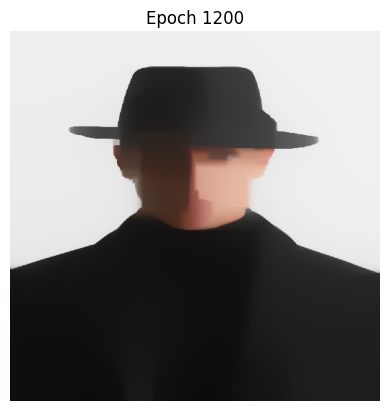

 80%|████████  | 1202/1500 [12:42<03:11,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7416665514247143e-06, Style Loss: 4.354702127784549e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7423875533495448e-06, Style Loss: 4.3546924644033425e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1203/1500 [12:43<03:09,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7430044181310222e-06, Style Loss: 4.3548496364564926e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1205/1500 [12:44<03:06,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7436295820516534e-06, Style Loss: 4.354953091478819e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.744309315654391e-06, Style Loss: 4.3550355144361674e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1206/1500 [12:45<03:05,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7449983715778217e-06, Style Loss: 4.3551486328397004e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1207/1500 [12:46<03:04,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7456380874136812e-06, Style Loss: 4.355374585429672e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1208/1500 [12:46<03:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7463080439483747e-06, Style Loss: 4.355457861038303e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1209/1500 [12:47<03:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7470398461227887e-06, Style Loss: 4.355503335773392e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1210/1500 [12:47<03:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7477487972428207e-06, Style Loss: 4.355596843197418e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1211/1500 [12:48<03:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7484303498349618e-06, Style Loss: 4.3556525497479015e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1213/1500 [12:49<03:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7490957588961464e-06, Style Loss: 4.355721330284723e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7498405213700607e-06, Style Loss: 4.35578186852581e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1214/1500 [12:50<03:03,  1.56it/s]

Inside compute_loss:
Content Loss: 1.750572209857637e-06, Style Loss: 4.3557852791309415e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1215/1500 [12:51<03:01,  1.57it/s]

Inside compute_loss:
Content Loss: 1.751296281327086e-06, Style Loss: 4.3558480911087827e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1216/1500 [12:51<03:02,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7519699895274243e-06, Style Loss: 4.355873386430176e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1217/1500 [12:52<03:02,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7526384681332274e-06, Style Loss: 4.355972862413182e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1218/1500 [12:53<02:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.75337333985226e-06, Style Loss: 4.3560262952269113e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1219/1500 [12:53<02:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7541491388328723e-06, Style Loss: 4.35606978044234e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1221/1500 [12:54<02:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7548535424793954e-06, Style Loss: 4.3561189499996544e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7554734768054914e-06, Style Loss: 4.356243721304054e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1222/1500 [12:55<02:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7561205822858028e-06, Style Loss: 4.35638412454864e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1223/1500 [12:56<02:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7568185057825758e-06, Style Loss: 4.356387535153772e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1224/1500 [12:56<02:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7575288211446605e-06, Style Loss: 4.356552381068468e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1225/1500 [12:57<02:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7582287910045125e-06, Style Loss: 4.3564529050854617e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1226/1500 [12:58<02:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.758846451593854e-06, Style Loss: 4.356612919309555e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1227/1500 [12:58<02:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7594388737052213e-06, Style Loss: 4.3568473984123557e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1228/1500 [12:59<02:50,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7600900719116908e-06, Style Loss: 4.3570324237407476e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1229/1500 [12:59<02:51,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7607630979910027e-06, Style Loss: 4.3570332763920305e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1230/1500 [13:00<02:48,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7614020180189982e-06, Style Loss: 4.357121383691265e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1231/1500 [13:01<02:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.762082888490113e-06, Style Loss: 4.357240470653778e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1232/1500 [13:01<02:47,  1.60it/s]

Inside compute_loss:
Content Loss: 1.762731358212477e-06, Style Loss: 4.357349610017991e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1233/1500 [13:02<02:47,  1.60it/s]

Inside compute_loss:
Content Loss: 1.763476234373229e-06, Style Loss: 4.35727230296834e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1234/1500 [13:03<02:49,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7641809790802654e-06, Style Loss: 4.3573521679718397e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1235/1500 [13:03<02:48,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7648948187343194e-06, Style Loss: 4.3575568042797386e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1236/1500 [13:04<02:49,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7656581121627823e-06, Style Loss: 4.3576866914918355e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1237/1500 [13:05<02:49,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7663400058154366e-06, Style Loss: 4.3578313579928363e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1238/1500 [13:05<02:46,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7669689214017126e-06, Style Loss: 4.3579549924288585e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1239/1500 [13:06<02:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7676479728834238e-06, Style Loss: 4.35806867926658e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1240/1500 [13:06<02:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7682958741715993e-06, Style Loss: 4.3582258513197303e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1241/1500 [13:07<02:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.768977199390065e-06, Style Loss: 4.3582576836342923e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1243/1500 [13:08<02:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7697088878776412e-06, Style Loss: 4.3583193587437563e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7703781622913084e-06, Style Loss: 4.3585785647337616e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1244/1500 [13:09<02:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7710743804855156e-06, Style Loss: 4.3585839648585534e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1245/1500 [13:10<02:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.771704319253331e-06, Style Loss: 4.358821001915203e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1246/1500 [13:10<02:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7723591554386076e-06, Style Loss: 4.358746252819401e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1247/1500 [13:11<02:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7730558283801656e-06, Style Loss: 4.358809917448525e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1248/1500 [13:11<02:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7737237385517801e-06, Style Loss: 4.3588897824520245e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1249/1500 [13:12<02:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7743938087733113e-06, Style Loss: 4.3589858478298993e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1250/1500 [13:13<02:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7750095366864116e-06, Style Loss: 4.3590111431512923e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1251/1500 [13:13<02:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7756495935827843e-06, Style Loss: 4.359209242466022e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1252/1500 [13:14<02:36,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7763921960067819e-06, Style Loss: 4.359320371349895e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1253/1500 [13:15<02:34,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7771341163097532e-06, Style Loss: 4.3593757936832844e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1254/1500 [13:15<02:36,  1.57it/s]

Inside compute_loss:
Content Loss: 1.77782885657507e-06, Style Loss: 4.3594178578132414e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1255/1500 [13:16<02:36,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7784656165531487e-06, Style Loss: 4.359623062555329e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1256/1500 [13:17<02:36,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7791362552088685e-06, Style Loss: 4.359721401669958e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1257/1500 [13:17<02:36,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7798006410885137e-06, Style Loss: 4.3598441834546975e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1258/1500 [13:18<02:34,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7804878780225408e-06, Style Loss: 4.359900742656464e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1259/1500 [13:18<02:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.781172272785625e-06, Style Loss: 4.35999226056083e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1260/1500 [13:19<02:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7818352944232174e-06, Style Loss: 4.359910974471859e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1261/1500 [13:20<02:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7825500435719732e-06, Style Loss: 4.3599845866992837e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1262/1500 [13:20<02:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7833134506872739e-06, Style Loss: 4.360204570730275e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1263/1500 [13:21<02:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.784028881957056e-06, Style Loss: 4.360142895620811e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1264/1500 [13:22<02:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7847195294962148e-06, Style Loss: 4.360109926437872e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1265/1500 [13:22<02:28,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7854158613772597e-06, Style Loss: 4.360131811154133e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1266/1500 [13:23<02:26,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7860561456473079e-06, Style Loss: 4.3602256027952535e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1267/1500 [13:23<02:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7866899497676059e-06, Style Loss: 4.3602332766567997e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1268/1500 [13:24<02:25,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7873749129648786e-06, Style Loss: 4.3603228050415055e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1269/1500 [13:25<02:24,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7880952327686828e-06, Style Loss: 4.3603824906313093e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1270/1500 [13:25<02:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.788759959708841e-06, Style Loss: 4.360565242222947e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1271/1500 [13:26<02:23,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7894022903419682e-06, Style Loss: 4.3606340227597684e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1272/1500 [13:27<02:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7901667206388083e-06, Style Loss: 4.3606834765341773e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1273/1500 [13:27<02:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7909092093759682e-06, Style Loss: 4.360711329809419e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1274/1500 [13:28<02:24,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7916173646881361e-06, Style Loss: 4.3608781652437756e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1275/1500 [13:28<02:23,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7923113091455889e-06, Style Loss: 4.360978493878065e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1276/1500 [13:29<02:22,  1.58it/s]

Inside compute_loss:
Content Loss: 1.793045157683082e-06, Style Loss: 4.361070011782431e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1277/1500 [13:30<02:23,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7937180700755562e-06, Style Loss: 4.3611979094748676e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1279/1500 [13:31<02:18,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7944167893801932e-06, Style Loss: 4.3613192701741355e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7951870177057572e-06, Style Loss: 4.361338312719454e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1280/1500 [13:32<02:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7959067690753727e-06, Style Loss: 4.361373271422053e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1281/1500 [13:32<02:17,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7965977576750447e-06, Style Loss: 4.3615136746666394e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1282/1500 [13:33<02:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.797281697690778e-06, Style Loss: 4.361581318335084e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1283/1500 [13:34<02:17,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7980765960601275e-06, Style Loss: 4.3615696654342173e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1284/1500 [13:34<02:15,  1.60it/s]

Inside compute_loss:
Content Loss: 1.798860466806218e-06, Style Loss: 4.361490937299095e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1285/1500 [13:35<02:14,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7995785128732678e-06, Style Loss: 4.36167681527877e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1286/1500 [13:35<02:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.800201971491333e-06, Style Loss: 4.361925505236286e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1287/1500 [13:36<02:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8008437336902716e-06, Style Loss: 4.3621008671834716e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1288/1500 [13:37<02:12,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8015693967754487e-06, Style Loss: 4.3621446366159944e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1289/1500 [13:37<02:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8022983567789197e-06, Style Loss: 4.3621164991236583e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1290/1500 [13:38<02:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.802992869670561e-06, Style Loss: 4.3621355416689767e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1291/1500 [13:39<02:12,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8036236042462406e-06, Style Loss: 4.3622625867101306e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1292/1500 [13:39<02:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8042328520095907e-06, Style Loss: 4.362332219898235e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1293/1500 [13:40<02:09,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8048835954687092e-06, Style Loss: 4.362317156392237e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1294/1500 [13:40<02:08,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8056324506687815e-06, Style Loss: 4.3623037981888046e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1295/1500 [13:41<02:11,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8063261677525588e-06, Style Loss: 4.3624888235171966e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1296/1500 [13:42<02:10,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8069978295898181e-06, Style Loss: 4.362492802556517e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1297/1500 [13:42<02:10,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8077013237416395e-06, Style Loss: 4.362600520835258e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1298/1500 [13:43<02:11,  1.53it/s]

Inside compute_loss:
Content Loss: 1.8084747352986597e-06, Style Loss: 4.3624822865240276e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1299/1500 [13:44<02:08,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8091105857820367e-06, Style Loss: 4.3626448587019695e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1300/1500 [13:44<02:07,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8098211285177968e-06, Style Loss: 4.362812831004703e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1300, Loss: 784.266541, Alpha: 10.0000, Beta: 10.0000


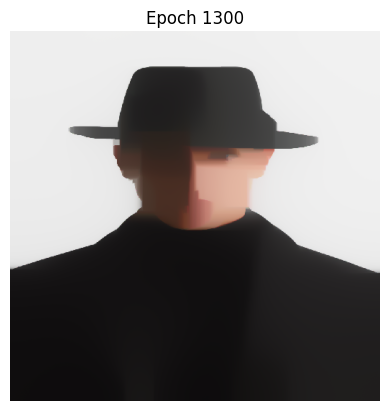

 87%|████████▋ | 1301/1500 [13:45<02:31,  1.31it/s]

Inside compute_loss:
Content Loss: 1.8105101844412275e-06, Style Loss: 4.362771335308935e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1302/1500 [13:46<02:13,  1.48it/s]

Inside compute_loss:
Content Loss: 1.8111890085492632e-06, Style Loss: 4.362911738553521e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1303/1500 [13:46<02:07,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8118558955393382e-06, Style Loss: 4.363062942047691e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1305/1500 [13:48<02:03,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8125209635400097e-06, Style Loss: 4.363211871805106e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1306/1500 [13:48<02:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8132135437554098e-06, Style Loss: 4.363346306490712e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8139868416255922e-06, Style Loss: 4.3634383928292664e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1307/1500 [13:49<02:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8147902665077709e-06, Style Loss: 4.3635321844703867e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1308/1500 [13:50<02:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8154879626308684e-06, Style Loss: 4.363558616660157e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1310/1500 [13:51<01:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8161132402383373e-06, Style Loss: 4.363641892268788e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1311/1500 [13:51<01:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.816791268538509e-06, Style Loss: 4.3636470081764855e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8174708884544089e-06, Style Loss: 4.3637425051201717e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1312/1500 [13:52<01:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8181939367423183e-06, Style Loss: 4.36382492807752e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1313/1500 [13:53<01:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8189748516306281e-06, Style Loss: 4.3639471414280706e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1314/1500 [13:53<01:59,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8196361679656547e-06, Style Loss: 4.364077312857262e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1315/1500 [13:54<01:57,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8203559193352703e-06, Style Loss: 4.3640724811666587e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1316/1500 [13:55<01:57,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8211071619589347e-06, Style Loss: 4.364088681541034e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1317/1500 [13:55<01:58,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8218069044451113e-06, Style Loss: 4.364349308616511e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1319/1500 [13:57<01:52,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8224691302748397e-06, Style Loss: 4.364448784599517e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8230813338959706e-06, Style Loss: 4.3645124492286413e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1321/1500 [13:58<01:51,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8237210497318301e-06, Style Loss: 4.364721633010049e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.824382252380019e-06, Style Loss: 4.364802066447737e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1322/1500 [13:58<01:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8250078710480011e-06, Style Loss: 4.364885342056368e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1323/1500 [13:59<01:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.825689082579629e-06, Style Loss: 4.364905521470064e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1324/1500 [14:00<01:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8264280470248195e-06, Style Loss: 4.364934795830777e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1325/1500 [14:00<01:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8271815633852384e-06, Style Loss: 4.364945027646172e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1326/1500 [14:01<01:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8279091591466567e-06, Style Loss: 4.365053598576196e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1327/1500 [14:02<01:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8286500562680885e-06, Style Loss: 4.365126358152338e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1328/1500 [14:02<01:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8293147832082468e-06, Style Loss: 4.3652050862874603e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1329/1500 [14:03<01:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8300435158380424e-06, Style Loss: 4.3653952275235497e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1330/1500 [14:03<01:47,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8307860045752022e-06, Style Loss: 4.3653471948346123e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1331/1500 [14:04<01:45,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8315855641048984e-06, Style Loss: 4.3653687953337794e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1332/1500 [14:05<01:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8324117263546214e-06, Style Loss: 4.3654324599629035e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1333/1500 [14:05<01:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.833101237025403e-06, Style Loss: 4.3656044113049575e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1334/1500 [14:06<01:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8337847222937853e-06, Style Loss: 4.3657416881615063e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1335/1500 [14:07<01:45,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8344716181672993e-06, Style Loss: 4.3658155846060254e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1336/1500 [14:07<01:45,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8351656763115898e-06, Style Loss: 4.365879817669338e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1337/1500 [14:08<01:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.835861439758446e-06, Style Loss: 4.3660156734404154e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1338/1500 [14:09<01:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8365677760812105e-06, Style Loss: 4.366043526715657e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1339/1500 [14:09<01:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8372546719547245e-06, Style Loss: 4.366110601949913e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1340/1500 [14:10<01:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8379396351519972e-06, Style Loss: 4.366237078556878e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1341/1500 [14:10<01:39,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8386573401585338e-06, Style Loss: 4.3663203541655093e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1342/1500 [14:11<01:38,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8393706113783992e-06, Style Loss: 4.3664411464305886e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1343/1500 [14:12<01:38,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8401218540020636e-06, Style Loss: 4.366580981240986e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1344/1500 [14:12<01:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8408057940177969e-06, Style Loss: 4.366548296275141e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1345/1500 [14:13<01:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8415975091556902e-06, Style Loss: 4.3665971816153615e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1346/1500 [14:14<01:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8423443179926835e-06, Style Loss: 4.3667017735060654e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1347/1500 [14:14<01:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.842975848376227e-06, Style Loss: 4.3668580929079326e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1348/1500 [14:15<01:36,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8436870732330135e-06, Style Loss: 4.366761459095869e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1349/1500 [14:15<01:34,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8443715816829354e-06, Style Loss: 4.366682730960747e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1350/1500 [14:16<01:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.844985149546119e-06, Style Loss: 4.36684075566518e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1351/1500 [14:17<01:33,  1.60it/s]

Inside compute_loss:
Content Loss: 1.845698534452822e-06, Style Loss: 4.367014696526894e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1353/1500 [14:18<01:31,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8464071445123409e-06, Style Loss: 4.367104509128694e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8471470184522332e-06, Style Loss: 4.367179826658685e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1354/1500 [14:19<01:31,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8478118590792292e-06, Style Loss: 4.3672525862348266e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1355/1500 [14:19<01:33,  1.56it/s]

Inside compute_loss:
Content Loss: 1.848447823249444e-06, Style Loss: 4.3673310301528545e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1356/1500 [14:20<01:31,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8491595028535812e-06, Style Loss: 4.367323924725497e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1357/1500 [14:21<01:33,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8498152485335595e-06, Style Loss: 4.367404642380279e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1359/1500 [14:22<01:28,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8504775880501256e-06, Style Loss: 4.367489623291476e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1360/1500 [14:22<01:27,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8511123016651254e-06, Style Loss: 4.3675356664607534e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8517743001211784e-06, Style Loss: 4.3678198835550575e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1361/1500 [14:23<01:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8524423239796306e-06, Style Loss: 4.367913106761989e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1362/1500 [14:24<01:26,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8531039813751704e-06, Style Loss: 4.367922201709007e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1363/1500 [14:24<01:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.853732669587771e-06, Style Loss: 4.3681023953467957e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1364/1500 [14:25<01:25,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8544259319241974e-06, Style Loss: 4.3682041450665565e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1365/1500 [14:26<01:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8551528455645894e-06, Style Loss: 4.368308168523072e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1366/1500 [14:26<01:23,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8559284171715262e-06, Style Loss: 4.3682405248546274e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1367/1500 [14:27<01:23,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8566591961644008e-06, Style Loss: 4.368299073576054e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1368/1500 [14:27<01:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8574020259620738e-06, Style Loss: 4.3683687067641586e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1370/1500 [14:29<01:21,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8581739595902036e-06, Style Loss: 4.3683107264769205e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8589630599308293e-06, Style Loss: 4.3684136130650586e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1371/1500 [14:29<01:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.859660301306576e-06, Style Loss: 4.36852531038312e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1372/1500 [14:30<01:20,  1.60it/s]

Inside compute_loss:
Content Loss: 1.860414158727508e-06, Style Loss: 4.368638144569559e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1373/1500 [14:31<01:19,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8611573295856942e-06, Style Loss: 4.368671966403781e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1374/1500 [14:31<01:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8619188040247536e-06, Style Loss: 4.3686901562978164e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1375/1500 [14:32<01:20,  1.56it/s]

Inside compute_loss:
Content Loss: 1.862574549704732e-06, Style Loss: 4.3688174855560646e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1376/1500 [14:32<01:19,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8632495084602851e-06, Style Loss: 4.368858981251833e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1377/1500 [14:33<01:19,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8639528889252688e-06, Style Loss: 4.3689013295988843e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1378/1500 [14:34<01:18,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8646924218046479e-06, Style Loss: 4.368957320366462e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1379/1500 [14:34<01:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8654835685083526e-06, Style Loss: 4.36888257127066e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1380/1500 [14:35<01:15,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8661838794287178e-06, Style Loss: 4.369090902400785e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1381/1500 [14:36<01:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8668407619770733e-06, Style Loss: 4.3691110818144807e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1382/1500 [14:36<01:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8675173123483546e-06, Style Loss: 4.369353518995922e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1383/1500 [14:37<01:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8681776055018418e-06, Style Loss: 4.3694905116353766e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1384/1500 [14:38<01:12,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8688187992665917e-06, Style Loss: 4.3697980345314136e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1385/1500 [14:38<01:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8695556036618655e-06, Style Loss: 4.36980570839296e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1386/1500 [14:39<01:12,  1.57it/s]

Inside compute_loss:
Content Loss: 1.870324354058539e-06, Style Loss: 4.369938721993094e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1387/1500 [14:39<01:10,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8710998119786382e-06, Style Loss: 4.370047292923118e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1388/1500 [14:40<01:09,  1.60it/s]

Inside compute_loss:
Content Loss: 1.87182922672946e-06, Style Loss: 4.370020008082065e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1389/1500 [14:41<01:09,  1.60it/s]

Inside compute_loss:
Content Loss: 1.872490429377649e-06, Style Loss: 4.370205033410457e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1390/1500 [14:41<01:08,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8732094986262382e-06, Style Loss: 4.3702206653506437e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1391/1500 [14:42<01:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.874023496384325e-06, Style Loss: 4.3700725882445113e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1392/1500 [14:43<01:07,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8748238517218851e-06, Style Loss: 4.370125452624052e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1394/1500 [14:44<01:06,  1.60it/s]

Inside compute_loss:
Content Loss: 1.875546331575606e-06, Style Loss: 4.370238855244679e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8762697209240287e-06, Style Loss: 4.3702240759557753e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1395/1500 [14:44<01:07,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8770261931422283e-06, Style Loss: 4.370154442767671e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1396/1500 [14:45<01:06,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8777562900140765e-06, Style Loss: 4.3703343521883653e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1397/1500 [14:46<01:06,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8784795656756614e-06, Style Loss: 4.370483850379969e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1398/1500 [14:46<01:06,  1.53it/s]

Inside compute_loss:
Content Loss: 1.8791228058034903e-06, Style Loss: 4.370592989744182e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1400/1500 [14:48<01:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8798713199430495e-06, Style Loss: 4.3706506858143257e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8806581465469208e-06, Style Loss: 4.370652106899797e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1400, Loss: 776.609497, Alpha: 10.0000, Beta: 10.0000


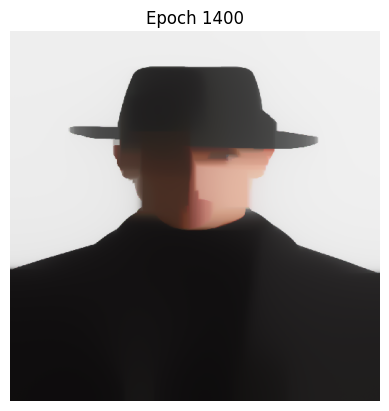

 93%|█████████▎| 1401/1500 [14:49<01:13,  1.35it/s]

Inside compute_loss:
Content Loss: 1.881455204966187e-06, Style Loss: 4.37080814208457e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1402/1500 [14:49<01:03,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8822432821252733e-06, Style Loss: 4.370811836906796e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1404/1500 [14:50<01:00,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8829565533451387e-06, Style Loss: 4.3709712826967007e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8836730077964603e-06, Style Loss: 4.3710440422728425e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1405/1500 [14:51<01:00,  1.58it/s]

Inside compute_loss:
Content Loss: 1.884453581624257e-06, Style Loss: 4.371174497919128e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1406/1500 [14:52<00:59,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8852300627258956e-06, Style Loss: 4.3710991803891375e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1408/1500 [14:53<00:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8859250303648878e-06, Style Loss: 4.37120434071403e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8866049913413008e-06, Style Loss: 4.3713589548133314e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1409/1500 [14:53<00:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.887254256871529e-06, Style Loss: 4.3713751551877067e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1411/1500 [14:55<00:55,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8879201206800644e-06, Style Loss: 4.371381123746687e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8886530597228557e-06, Style Loss: 4.371479178644222e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1412/1500 [14:55<00:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.889313693936856e-06, Style Loss: 4.3716161712836765e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1413/1500 [14:56<00:54,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8899601172961411e-06, Style Loss: 4.371787838408636e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1414/1500 [14:57<00:55,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8906179093391984e-06, Style Loss: 4.372041075839661e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1415/1500 [14:57<00:54,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8914037127615302e-06, Style Loss: 4.371958652882313e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1416/1500 [14:58<00:53,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8921699620477739e-06, Style Loss: 4.3719489895011066e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1417/1500 [14:59<00:53,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8928312783828005e-06, Style Loss: 4.372130035790178e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1419/1500 [15:00<00:50,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8935271555164945e-06, Style Loss: 4.372174942091078e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8942854467240977e-06, Style Loss: 4.372303692434798e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1420/1500 [15:00<00:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8950878484247369e-06, Style Loss: 4.372371051886148e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1421/1500 [15:01<00:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8959021872433368e-06, Style Loss: 4.372465411961457e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1422/1500 [15:02<00:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8966035213452415e-06, Style Loss: 4.3726367948693223e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1423/1500 [15:02<00:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8973238411490456e-06, Style Loss: 4.372693354071089e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1424/1500 [15:03<00:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.898084519780241e-06, Style Loss: 4.372727175905311e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1425/1500 [15:04<00:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8988351939697168e-06, Style Loss: 4.372762703042099e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1426/1500 [15:04<00:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.899543690342398e-06, Style Loss: 4.3727621346079104e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1427/1500 [15:05<00:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9003447278009844e-06, Style Loss: 4.3726848275582597e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1429/1500 [15:06<00:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9011152971870615e-06, Style Loss: 4.3726979015445977e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.901826067296497e-06, Style Loss: 4.3728081777771877e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1430/1500 [15:07<00:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9025311530640465e-06, Style Loss: 4.372842852262693e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1432/1500 [15:08<00:42,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9032677300856449e-06, Style Loss: 4.372867294932803e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9040254528590594e-06, Style Loss: 4.373064825813344e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1433/1500 [15:09<00:42,  1.58it/s]

Inside compute_loss:
Content Loss: 1.904717464640271e-06, Style Loss: 4.373210344965628e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1434/1500 [15:09<00:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9053976529903593e-06, Style Loss: 4.3732435983656615e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1435/1500 [15:10<00:41,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9060779550272855e-06, Style Loss: 4.373261788259697e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1436/1500 [15:11<00:40,  1.56it/s]

Inside compute_loss:
Content Loss: 1.906803845486138e-06, Style Loss: 4.3734462451539e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1437/1500 [15:11<00:40,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9075243926636176e-06, Style Loss: 4.373637807475461e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1438/1500 [15:12<00:40,  1.54it/s]

Inside compute_loss:
Content Loss: 1.9082913240708876e-06, Style Loss: 4.3737074406635656e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1439/1500 [15:12<00:38,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9089777651970508e-06, Style Loss: 4.3738953081629006e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1440/1500 [15:13<00:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9096680716756964e-06, Style Loss: 4.374058164557937e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1441/1500 [15:14<00:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.910313130792929e-06, Style Loss: 4.3740081423493393e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1442/1500 [15:14<00:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9110366338281892e-06, Style Loss: 4.374139450646908e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1443/1500 [15:15<00:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.911761273731827e-06, Style Loss: 4.374297759568435e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1444/1500 [15:16<00:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9124645405099727e-06, Style Loss: 4.3743477817770327e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1445/1500 [15:16<00:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.913206915560295e-06, Style Loss: 4.3743000333051896e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1446/1500 [15:17<00:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9139663436362753e-06, Style Loss: 4.374488185021619e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1447/1500 [15:17<00:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9146693830407457e-06, Style Loss: 4.374482500679733e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1448/1500 [15:18<00:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9154156234435504e-06, Style Loss: 4.3746058508986607e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1449/1500 [15:19<00:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.91619506040297e-06, Style Loss: 4.3747402855842665e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1450/1500 [15:19<00:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9169372080796165e-06, Style Loss: 4.3748488565142907e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1451/1500 [15:20<00:30,  1.58it/s]

Inside compute_loss:
Content Loss: 1.917677764140535e-06, Style Loss: 4.3751768430411175e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1452/1500 [15:21<00:30,  1.60it/s]

Inside compute_loss:
Content Loss: 1.918447196658235e-06, Style Loss: 4.3751853695539467e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1453/1500 [15:21<00:29,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9191754745406797e-06, Style Loss: 4.3753087197728746e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1454/1500 [15:22<00:28,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9199021608073963e-06, Style Loss: 4.375397111289203e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1455/1500 [15:22<00:28,  1.56it/s]

Inside compute_loss:
Content Loss: 1.920658178278245e-06, Style Loss: 4.375471860385005e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1456/1500 [15:23<00:28,  1.57it/s]

Inside compute_loss:
Content Loss: 1.9213503037462942e-06, Style Loss: 4.3754965872722096e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1457/1500 [15:24<00:27,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9220456124457996e-06, Style Loss: 4.3755758838415204e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1459/1500 [15:25<00:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9227802567911567e-06, Style Loss: 4.3757711409853073e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9235023955843644e-06, Style Loss: 4.375740729756217e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1460/1500 [15:26<00:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9242529560870025e-06, Style Loss: 4.375840205739223e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1461/1500 [15:26<00:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.925053993545589e-06, Style Loss: 4.3758123524639814e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1463/1500 [15:28<00:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9257902295066742e-06, Style Loss: 4.375843900561449e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9263788999523968e-06, Style Loss: 4.3760422840932733e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1464/1500 [15:28<00:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.927075118146604e-06, Style Loss: 4.3760434209616506e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1465/1500 [15:29<00:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9277847513876623e-06, Style Loss: 4.3761949086729146e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1466/1500 [15:29<00:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9285025700810365e-06, Style Loss: 4.3762545942627185e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1467/1500 [15:30<00:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.929196287164814e-06, Style Loss: 4.3762798895841115e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1468/1500 [15:31<00:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9299384348414605e-06, Style Loss: 4.3764146084868116e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1469/1500 [15:31<00:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.930678990902379e-06, Style Loss: 4.3765885493485257e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1470/1500 [15:32<00:18,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9314536530146142e-06, Style Loss: 4.376567233066453e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1471/1500 [15:33<00:18,  1.60it/s]

Inside compute_loss:
Content Loss: 1.932209215738112e-06, Style Loss: 4.376675519779383e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1472/1500 [15:33<00:17,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9329706901771715e-06, Style Loss: 4.3768991986326e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1473/1500 [15:34<00:16,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9337387584528187e-06, Style Loss: 4.376982190024137e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1474/1500 [15:34<00:16,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9344640804774826e-06, Style Loss: 4.3770342017523944e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1475/1500 [15:35<00:16,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9351673472556286e-06, Style Loss: 4.3771080981969135e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1476/1500 [15:36<00:15,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9359297311893897e-06, Style Loss: 4.376989863885683e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1477/1500 [15:36<00:14,  1.55it/s]

Inside compute_loss:
Content Loss: 1.936690068760072e-06, Style Loss: 4.377049833692581e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1478/1500 [15:37<00:14,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9374456314835697e-06, Style Loss: 4.377032780666923e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1479/1500 [15:38<00:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.938209607033059e-06, Style Loss: 4.37712174061744e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1480/1500 [15:38<00:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9389194676477928e-06, Style Loss: 4.377133109301212e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1481/1500 [15:39<00:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9396309198782546e-06, Style Loss: 4.377307618597115e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1482/1500 [15:40<00:11,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9403603346290765e-06, Style Loss: 4.377352524898015e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1483/1500 [15:40<00:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.941081791301258e-06, Style Loss: 4.377580467007647e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1484/1500 [15:41<00:10,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9418055217101937e-06, Style Loss: 4.3776987013188773e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1485/1500 [15:41<00:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9425083337409887e-06, Style Loss: 4.377793061394186e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1486/1500 [15:42<00:08,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9433130091783823e-06, Style Loss: 4.3778467784250097e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1487/1500 [15:43<00:08,  1.60it/s]

Inside compute_loss:
Content Loss: 1.944067889780854e-06, Style Loss: 4.377857294457499e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1488/1500 [15:43<00:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.94476365322771e-06, Style Loss: 4.378032087970496e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1489/1500 [15:44<00:06,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9454703306109877e-06, Style Loss: 4.378063067633775e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1490/1500 [15:45<00:06,  1.60it/s]

Inside compute_loss:
Content Loss: 1.946242946360144e-06, Style Loss: 4.3781366798612e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1491/1500 [15:45<00:05,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9469200651656138e-06, Style Loss: 4.378270546112617e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1492/1500 [15:46<00:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.94769268091477e-06, Style Loss: 4.378191249543306e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1493/1500 [15:46<00:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9484266431391006e-06, Style Loss: 4.378330231702421e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1494/1500 [15:47<00:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9491749299049843e-06, Style Loss: 4.378393896331545e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1495/1500 [15:48<00:03,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9499511836329475e-06, Style Loss: 4.3783700220956234e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1496/1500 [15:48<00:02,  1.56it/s]

Inside compute_loss:
Content Loss: 1.95074494513392e-06, Style Loss: 4.3785018988273805e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1497/1500 [15:49<00:01,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9515255189617164e-06, Style Loss: 4.378644575808721e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1498/1500 [15:50<00:01,  1.54it/s]

Inside compute_loss:
Content Loss: 1.9522738057276e-06, Style Loss: 4.3786485548480414e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1499/1500 [15:50<00:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9530598365236074e-06, Style Loss: 4.378832443308056e-07
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1499, Loss: 769.508423, Alpha: 10.0000, Beta: 10.0000


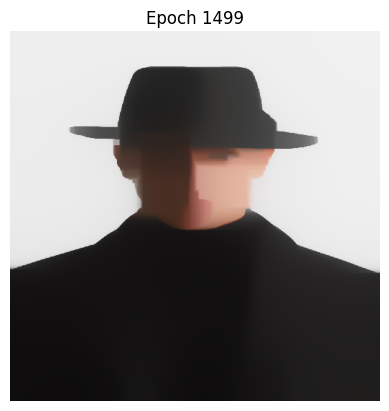

100%|██████████| 1500/1500 [15:51<00:00,  1.58it/s]

Total training time: 15 minutes 52 seconds


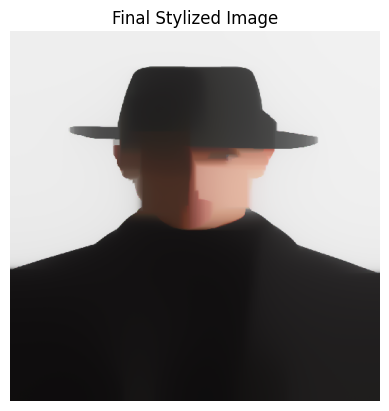

In [ ]:
# # Preprocess images
# content_image = preprocess_image("/content/09967300800-a1.jpg")
# style_image = preprocess_image("/content/Starry-Night.jpg")

# # Buat model baru
# nst_model2 = create_nst_model()
# nst_model2.summary()

# # Sebelum training
# start_time = time.time()

# # Train model dengan dynamic weighting
# output_image = train_nst(content_image, style_image, nst_model2, epochs=1500, lr=0.001)

# # Setelah training
# end_time = time.time()
# # Total waktu training
# elapsed_time = end_time - start_time
# print(f"Total training time: {elapsed_time // 60:.0f} minutes {elapsed_time % 60:.0f} seconds")

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# tf.keras.preprocessing.image.save_img("/content/final_stylized_image.jpg", final_image)


  0%|          | 0/1500 [00:00<?, ?it/s]

Inside compute_loss:
Content Loss: 0.0, Style Loss: 1.5994638715710607e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 0, Loss: 6837.087402, Alpha: 10.0000, Beta: 10.0000


<ipython-input-13-a941beb22b1f>:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  loss_value = float(loss.numpy()) if isinstance(loss.numpy(), (np.ndarray, tf.Tensor)) else loss.numpy()


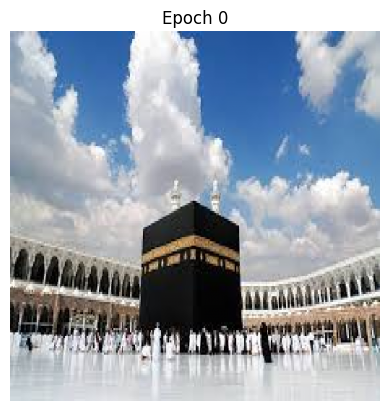

  0%|          | 1/1500 [00:00<21:33,  1.16it/s]

Inside compute_loss:
Content Loss: 2.2305093327901204e-09, Style Loss: 1.6273623941742699e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 2/1500 [00:01<15:08,  1.65it/s]

Inside compute_loss:
Content Loss: 7.133783785917558e-09, Style Loss: 1.650709918976645e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 3/1500 [00:01<15:04,  1.66it/s]

Inside compute_loss:
Content Loss: 1.3013686128715563e-08, Style Loss: 1.668037498347985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 4/1500 [00:02<15:20,  1.63it/s]

Inside compute_loss:
Content Loss: 2.0156290858608372e-08, Style Loss: 1.6841408978507388e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 6/1500 [00:03<15:29,  1.61it/s]

Inside compute_loss:
Content Loss: 2.79964726956905e-08, Style Loss: 1.6983691466521122e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.7137027675271383e-08, Style Loss: 1.7127060800703475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 7/1500 [00:04<15:35,  1.60it/s]

Inside compute_loss:
Content Loss: 4.7512319412135184e-08, Style Loss: 1.7271498791160411e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 8/1500 [00:05<15:33,  1.60it/s]

Inside compute_loss:
Content Loss: 5.904043476334664e-08, Style Loss: 1.7415407000953564e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 9/1500 [00:05<15:32,  1.60it/s]

Inside compute_loss:
Content Loss: 7.14869301532417e-08, Style Loss: 1.755562266225752e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 10/1500 [00:06<15:35,  1.59it/s]

Inside compute_loss:
Content Loss: 8.47384455937572e-08, Style Loss: 1.769134769347147e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 11/1500 [00:06<15:42,  1.58it/s]

Inside compute_loss:
Content Loss: 9.851724058762557e-08, Style Loss: 1.7820724451667047e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 12/1500 [00:07<15:46,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1341612804471879e-07, Style Loss: 1.7951941799765336e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 13/1500 [00:08<15:52,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2922923531277775e-07, Style Loss: 1.8082705537381116e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 14/1500 [00:08<15:58,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4587253360787145e-07, Style Loss: 1.8212267605122179e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 16/1500 [00:10<15:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6286651316477219e-07, Style Loss: 1.8335472304897849e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 17/1500 [00:10<15:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8023091286067938e-07, Style Loss: 1.8454471728546196e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9867826495101326e-07, Style Loss: 1.8575026388134575e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 18/1500 [00:11<15:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1740913780377014e-07, Style Loss: 1.8691132481762907e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 19/1500 [00:12<15:33,  1.59it/s]

Inside compute_loss:
Content Loss: 2.36775861139904e-07, Style Loss: 1.8806271100402228e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 20/1500 [00:12<15:34,  1.58it/s]

Inside compute_loss:
Content Loss: 2.564149781392189e-07, Style Loss: 1.891760689431976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 22/1500 [00:13<15:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.77023900707718e-07, Style Loss: 1.9030942439712817e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.981591080697399e-07, Style Loss: 1.9143039935443085e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 23/1500 [00:14<15:29,  1.59it/s]

Inside compute_loss:
Content Loss: 3.1974877856555395e-07, Style Loss: 1.9253457139711827e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 25/1500 [00:15<15:27,  1.59it/s]

Inside compute_loss:
Content Loss: 3.4170690810242377e-07, Style Loss: 1.9361152681085514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.640108445779333e-07, Style Loss: 1.946682687048451e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 27/1500 [00:17<15:30,  1.58it/s]

Inside compute_loss:
Content Loss: 3.8648931877105497e-07, Style Loss: 1.956977939698845e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 28/1500 [00:17<15:31,  1.58it/s]

Inside compute_loss:
Content Loss: 4.092751169082476e-07, Style Loss: 1.967121761481394e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.3252180148556363e-07, Style Loss: 1.9771796360146254e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 29/1500 [00:18<15:32,  1.58it/s]

Inside compute_loss:
Content Loss: 4.5624258859788824e-07, Style Loss: 1.987165205719066e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 30/1500 [00:18<15:30,  1.58it/s]

Inside compute_loss:
Content Loss: 4.804975333172479e-07, Style Loss: 1.997135768760927e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 31/1500 [00:19<15:49,  1.55it/s]

Inside compute_loss:
Content Loss: 5.050855520494224e-07, Style Loss: 2.00699946617533e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 32/1500 [00:20<15:40,  1.56it/s]

Inside compute_loss:
Content Loss: 5.300345264913631e-07, Style Loss: 2.0167562979622744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 33/1500 [00:20<15:41,  1.56it/s]

Inside compute_loss:
Content Loss: 5.552811899178778e-07, Style Loss: 2.0263842088752426e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 34/1500 [00:21<15:48,  1.54it/s]

Inside compute_loss:
Content Loss: 5.808244623040082e-07, Style Loss: 2.0358945675980067e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 35/1500 [00:22<15:40,  1.56it/s]

Inside compute_loss:
Content Loss: 6.06456580953818e-07, Style Loss: 2.0452150693017757e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 36/1500 [00:22<15:28,  1.58it/s]

Inside compute_loss:
Content Loss: 6.323464845081617e-07, Style Loss: 2.054470087387017e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 38/1500 [00:24<15:23,  1.58it/s]

Inside compute_loss:
Content Loss: 6.583392746506433e-07, Style Loss: 2.0635620785469655e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.844682616247155e-07, Style Loss: 2.072485358439735e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 39/1500 [00:24<15:24,  1.58it/s]

Inside compute_loss:
Content Loss: 7.111193554010242e-07, Style Loss: 2.0814177332795225e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 41/1500 [00:25<15:22,  1.58it/s]

Inside compute_loss:
Content Loss: 7.383129627669405e-07, Style Loss: 2.090389671138837e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.658704817004036e-07, Style Loss: 2.099335688399151e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 42/1500 [00:26<15:21,  1.58it/s]

Inside compute_loss:
Content Loss: 7.935830126371002e-07, Style Loss: 2.1081341401441023e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 43/1500 [00:27<15:22,  1.58it/s]

Inside compute_loss:
Content Loss: 8.215333764383104e-07, Style Loss: 2.116832774845534e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 44/1500 [00:27<15:26,  1.57it/s]

Inside compute_loss:
Content Loss: 8.498763577335922e-07, Style Loss: 2.125557784893317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 45/1500 [00:28<15:18,  1.58it/s]

Inside compute_loss:
Content Loss: 8.783072757978516e-07, Style Loss: 2.134119085894781e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 47/1500 [00:29<15:16,  1.59it/s]

Inside compute_loss:
Content Loss: 9.069163411368208e-07, Style Loss: 2.1426308194349986e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.355724728266068e-07, Style Loss: 2.1510152237169677e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 48/1500 [00:30<15:19,  1.58it/s]

Inside compute_loss:
Content Loss: 9.643192697694758e-07, Style Loss: 2.159279574698303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 49/1500 [00:31<15:17,  1.58it/s]

Inside compute_loss:
Content Loss: 9.931486601999495e-07, Style Loss: 2.1674065919796703e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 50/1500 [00:31<15:15,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0223106983175967e-06, Style Loss: 2.1755611214757664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 51/1500 [00:32<15:33,  1.55it/s]

Inside compute_loss:
Content Loss: 1.0517160262679681e-06, Style Loss: 2.18363493331708e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 52/1500 [00:32<15:31,  1.56it/s]

Inside compute_loss:
Content Loss: 1.081543814507313e-06, Style Loss: 2.1917480808042455e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 53/1500 [00:33<15:30,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1114685776192346e-06, Style Loss: 2.1997470867063385e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 54/1500 [00:34<15:39,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1413218317102292e-06, Style Loss: 2.2075889773987e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 56/1500 [00:35<15:13,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1711405250025564e-06, Style Loss: 2.2153394638735335e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2008887324554962e-06, Style Loss: 2.222942157459329e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 57/1500 [00:36<15:15,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2310662214076729e-06, Style Loss: 2.2305778202280635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 58/1500 [00:36<15:10,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2616015965249971e-06, Style Loss: 2.2381905182555784e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 59/1500 [00:37<15:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2923184158353251e-06, Style Loss: 2.245795940325479e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 61/1500 [00:38<15:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.323129595220962e-06, Style Loss: 2.2533431547344662e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3539798828787752e-06, Style Loss: 2.260795326947118e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 62/1500 [00:39<15:14,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3849188462700113e-06, Style Loss: 2.268181788167567e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 63/1500 [00:39<15:07,  1.58it/s]

Inside compute_loss:
Content Loss: 1.415801193616062e-06, Style Loss: 2.27548571274383e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 64/1500 [00:40<15:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4465904314420186e-06, Style Loss: 2.282630703120958e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 65/1500 [00:41<15:07,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4775856698179268e-06, Style Loss: 2.289794110765797e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 67/1500 [00:42<15:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5089352700670133e-06, Style Loss: 2.296968204973382e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5404181112899096e-06, Style Loss: 2.3040945507091237e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 68/1500 [00:43<15:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.571693815094477e-06, Style Loss: 2.3110619622457307e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 69/1500 [00:43<15:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6029617881940794e-06, Style Loss: 2.318037331860978e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 70/1500 [00:44<15:05,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6341964510502294e-06, Style Loss: 2.3248403522302397e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 71/1500 [00:45<15:18,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6654533965265728e-06, Style Loss: 2.331608811800834e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 72/1500 [00:45<15:13,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6967572946668952e-06, Style Loss: 2.3382990548270755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 73/1500 [00:46<15:33,  1.53it/s]

Inside compute_loss:
Content Loss: 1.728235815789958e-06, Style Loss: 2.3449695163435536e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 74/1500 [00:46<15:26,  1.54it/s]

Inside compute_loss:
Content Loss: 1.760053237376269e-06, Style Loss: 2.3516824967373395e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 75/1500 [00:47<15:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7919109041031334e-06, Style Loss: 2.358278834435623e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 76/1500 [00:48<14:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8237814174426603e-06, Style Loss: 2.3648610749660293e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 77/1500 [00:48<14:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8556200984676252e-06, Style Loss: 2.371356458752416e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 78/1500 [00:49<14:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.887366124719847e-06, Style Loss: 2.3777931801305385e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 80/1500 [00:50<14:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.919266878758208e-06, Style Loss: 2.384187837378704e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9512833659973694e-06, Style Loss: 2.39058545048465e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 81/1500 [00:51<14:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9834981230815174e-06, Style Loss: 2.396971467533149e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 82/1500 [00:51<14:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.016039388763602e-06, Style Loss: 2.4033174668147694e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 83/1500 [00:52<14:56,  1.58it/s]

Inside compute_loss:
Content Loss: 2.048688656941522e-06, Style Loss: 2.4096236757031875e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 85/1500 [00:53<14:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0812992715946166e-06, Style Loss: 2.4159032818715787e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 86/1500 [00:54<14:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1137946077942615e-06, Style Loss: 2.422093302811845e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 87/1500 [00:55<14:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.146147153325728e-06, Style Loss: 2.4282098820549436e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 88/1500 [00:55<14:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.178357135562692e-06, Style Loss: 2.434220732538961e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2106144115241477e-06, Style Loss: 2.4402229428233113e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 89/1500 [00:56<14:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2430212993640453e-06, Style Loss: 2.4462187866447493e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 90/1500 [00:57<14:59,  1.57it/s]

Inside compute_loss:
Content Loss: 2.275622819070122e-06, Style Loss: 2.4522346393496264e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 91/1500 [00:57<15:03,  1.56it/s]

Inside compute_loss:
Content Loss: 2.308669536432717e-06, Style Loss: 2.4582486730651e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 92/1500 [00:58<14:58,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3417098873323994e-06, Style Loss: 2.464220415276941e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 93/1500 [00:58<15:05,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3746003989799647e-06, Style Loss: 2.4700707399460953e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 94/1500 [00:59<14:59,  1.56it/s]

Inside compute_loss:
Content Loss: 2.407400188531028e-06, Style Loss: 2.4758733161434066e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 95/1500 [01:00<14:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4400460461038165e-06, Style Loss: 2.481609271853813e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 96/1500 [01:00<14:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.472725327606895e-06, Style Loss: 2.4873256734281313e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 97/1500 [01:01<14:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5055380774574587e-06, Style Loss: 2.4930138806666946e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 99/1500 [01:02<14:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5384995296917623e-06, Style Loss: 2.4986989046738017e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 100/1500 [01:03<14:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5717126845847815e-06, Style Loss: 2.5043800633284263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.605037707326119e-06, Style Loss: 2.5100748644035775e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 100, Loss: 4069.728271, Alpha: 10.0000, Beta: 10.0000


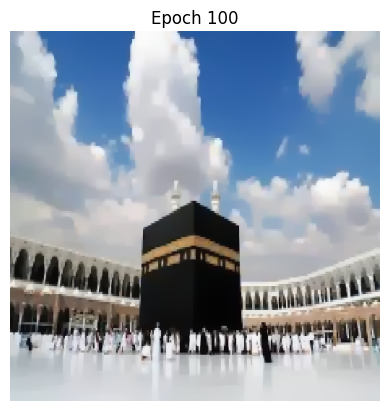

  7%|▋         | 102/1500 [01:04<15:08,  1.54it/s]

Inside compute_loss:
Content Loss: 2.6382947453384986e-06, Style Loss: 2.5157171421597013e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.6716036245488795e-06, Style Loss: 2.521324404369807e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 103/1500 [01:05<15:00,  1.55it/s]

Inside compute_loss:
Content Loss: 2.7047444746131077e-06, Style Loss: 2.526854586903937e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 105/1500 [01:06<14:45,  1.58it/s]

Inside compute_loss:
Content Loss: 2.738038119787234e-06, Style Loss: 2.5323456611658912e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.7714402222045464e-06, Style Loss: 2.53786743087403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 106/1500 [01:07<14:45,  1.58it/s]

Inside compute_loss:
Content Loss: 2.8048764306731755e-06, Style Loss: 2.543324626458343e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 107/1500 [01:08<15:05,  1.54it/s]

Inside compute_loss:
Content Loss: 2.8381489300954854e-06, Style Loss: 2.548680640757084e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 108/1500 [01:08<14:56,  1.55it/s]

Inside compute_loss:
Content Loss: 2.8713536721625132e-06, Style Loss: 2.554083948780317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 109/1500 [01:09<14:55,  1.55it/s]

Inside compute_loss:
Content Loss: 2.90452953777276e-06, Style Loss: 2.559400172685855e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 110/1500 [01:09<15:14,  1.52it/s]

Inside compute_loss:
Content Loss: 2.9379871193668805e-06, Style Loss: 2.564755277489894e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 111/1500 [01:10<15:14,  1.52it/s]

Inside compute_loss:
Content Loss: 2.971383082694956e-06, Style Loss: 2.5700473997858353e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 112/1500 [01:11<15:06,  1.53it/s]

Inside compute_loss:
Content Loss: 3.0050262012082385e-06, Style Loss: 2.575374082880444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 113/1500 [01:11<15:01,  1.54it/s]

Inside compute_loss:
Content Loss: 3.0387163860723376e-06, Style Loss: 2.580711907285149e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 115/1500 [01:13<14:32,  1.59it/s]

Inside compute_loss:
Content Loss: 3.0722139854333363e-06, Style Loss: 2.5859696961560985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.105671567027457e-06, Style Loss: 2.591138809293625e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 116/1500 [01:13<14:33,  1.58it/s]

Inside compute_loss:
Content Loss: 3.139051841571927e-06, Style Loss: 2.596206741145579e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 118/1500 [01:15<14:29,  1.59it/s]

Inside compute_loss:
Content Loss: 3.172664946760051e-06, Style Loss: 2.6013763090304565e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 119/1500 [01:15<14:28,  1.59it/s]

Inside compute_loss:
Content Loss: 3.206223709639744e-06, Style Loss: 2.6064928988489555e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.2397510949522257e-06, Style Loss: 2.6115894797840156e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 120/1500 [01:16<14:42,  1.56it/s]

Inside compute_loss:
Content Loss: 3.273550646554213e-06, Style Loss: 2.6167176656599622e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 121/1500 [01:16<14:25,  1.59it/s]

Inside compute_loss:
Content Loss: 3.307321321699419e-06, Style Loss: 2.6218231141683646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 122/1500 [01:17<14:25,  1.59it/s]

Inside compute_loss:
Content Loss: 3.341180672578048e-06, Style Loss: 2.626879904710222e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 123/1500 [01:18<14:25,  1.59it/s]

Inside compute_loss:
Content Loss: 3.3749613521649735e-06, Style Loss: 2.6318884920328856e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 124/1500 [01:18<14:24,  1.59it/s]

Inside compute_loss:
Content Loss: 3.408691327422275e-06, Style Loss: 2.636863200677908e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 125/1500 [01:19<14:25,  1.59it/s]

Inside compute_loss:
Content Loss: 3.4425181638653157e-06, Style Loss: 2.6418404104333604e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 126/1500 [01:20<14:20,  1.60it/s]

Inside compute_loss:
Content Loss: 3.4765155305649387e-06, Style Loss: 2.646828988872585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 127/1500 [01:20<14:24,  1.59it/s]

Inside compute_loss:
Content Loss: 3.5104185371892527e-06, Style Loss: 2.651781869644765e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 128/1500 [01:21<14:23,  1.59it/s]

Inside compute_loss:
Content Loss: 3.5443599699647166e-06, Style Loss: 2.6567311124381376e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 129/1500 [01:21<14:20,  1.59it/s]

Inside compute_loss:
Content Loss: 3.5781838505499763e-06, Style Loss: 2.661618964339141e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 130/1500 [01:22<14:21,  1.59it/s]

Inside compute_loss:
Content Loss: 3.6117805848334683e-06, Style Loss: 2.6664461074688006e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 131/1500 [01:23<14:34,  1.57it/s]

Inside compute_loss:
Content Loss: 3.6455278404901037e-06, Style Loss: 2.671310994628584e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 132/1500 [01:23<14:36,  1.56it/s]

Inside compute_loss:
Content Loss: 3.6793198887608014e-06, Style Loss: 2.6761424578580773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 133/1500 [01:24<14:44,  1.55it/s]

Inside compute_loss:
Content Loss: 3.713123078341596e-06, Style Loss: 2.680917305042385e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 135/1500 [01:25<14:19,  1.59it/s]

Inside compute_loss:
Content Loss: 3.7470801999006653e-06, Style Loss: 2.6857098873733776e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 3.780982524403953e-06, Style Loss: 2.690469727895106e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 136/1500 [01:26<14:20,  1.59it/s]

Inside compute_loss:
Content Loss: 3.814872343355091e-06, Style Loss: 2.6952170628646854e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 137/1500 [01:27<14:16,  1.59it/s]

Inside compute_loss:
Content Loss: 3.848851065413328e-06, Style Loss: 2.699932338146027e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 138/1500 [01:27<14:19,  1.58it/s]

Inside compute_loss:
Content Loss: 3.882682449329877e-06, Style Loss: 2.7046739887737203e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 139/1500 [01:28<14:14,  1.59it/s]

Inside compute_loss:
Content Loss: 3.916485638910672e-06, Style Loss: 2.709368118303246e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 140/1500 [01:28<14:15,  1.59it/s]

Inside compute_loss:
Content Loss: 3.95032657252159e-06, Style Loss: 2.714023139560595e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 141/1500 [01:29<14:13,  1.59it/s]

Inside compute_loss:
Content Loss: 3.984094746556366e-06, Style Loss: 2.718663608902716e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 142/1500 [01:30<14:12,  1.59it/s]

Inside compute_loss:
Content Loss: 4.017967057734495e-06, Style Loss: 2.7233365926804254e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 143/1500 [01:30<14:11,  1.59it/s]

Inside compute_loss:
Content Loss: 4.0518539208278526e-06, Style Loss: 2.7279832011117833e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 144/1500 [01:31<14:12,  1.59it/s]

Inside compute_loss:
Content Loss: 4.085818545718212e-06, Style Loss: 2.732568646024447e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 145/1500 [01:32<14:11,  1.59it/s]

Inside compute_loss:
Content Loss: 4.119701770832762e-06, Style Loss: 2.7370929274184164e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 146/1500 [01:32<14:11,  1.59it/s]

Inside compute_loss:
Content Loss: 4.153634108661208e-06, Style Loss: 2.7416390366852283e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 147/1500 [01:33<14:10,  1.59it/s]

Inside compute_loss:
Content Loss: 4.18756917497376e-06, Style Loss: 2.7461912850412773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 148/1500 [01:33<14:08,  1.59it/s]

Inside compute_loss:
Content Loss: 4.221430117468117e-06, Style Loss: 2.750669636952807e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 149/1500 [01:34<14:09,  1.59it/s]

Inside compute_loss:
Content Loss: 4.255441581335617e-06, Style Loss: 2.7551964194572065e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 150/1500 [01:35<14:13,  1.58it/s]

Inside compute_loss:
Content Loss: 4.289520347811049e-06, Style Loss: 2.759677045105491e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 151/1500 [01:35<14:28,  1.55it/s]

Inside compute_loss:
Content Loss: 4.323497250879882e-06, Style Loss: 2.7641876840789337e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 152/1500 [01:36<14:20,  1.57it/s]

Inside compute_loss:
Content Loss: 4.357425041234819e-06, Style Loss: 2.768656031548744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 153/1500 [01:37<14:31,  1.55it/s]

Inside compute_loss:
Content Loss: 4.391326456243405e-06, Style Loss: 2.773117557808291e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 154/1500 [01:37<14:27,  1.55it/s]

Inside compute_loss:
Content Loss: 4.425028237164952e-06, Style Loss: 2.777524059638381e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 155/1500 [01:38<14:10,  1.58it/s]

Inside compute_loss:
Content Loss: 4.458728199097095e-06, Style Loss: 2.781887133096461e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 157/1500 [01:39<14:02,  1.59it/s]

Inside compute_loss:
Content Loss: 4.492425887292484e-06, Style Loss: 2.786278173516621e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.526107204583241e-06, Style Loss: 2.7906230570806656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 159/1500 [01:40<14:01,  1.59it/s]

Inside compute_loss:
Content Loss: 4.5599367695103865e-06, Style Loss: 2.795028876789729e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.59372904515476e-06, Style Loss: 2.799375806716853e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 160/1500 [01:41<14:01,  1.59it/s]

Inside compute_loss:
Content Loss: 4.627499038178939e-06, Style Loss: 2.8036934054398444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 162/1500 [01:42<14:00,  1.59it/s]

Inside compute_loss:
Content Loss: 4.661145339923678e-06, Style Loss: 2.807988039421616e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.6945397116360255e-06, Style Loss: 2.812154434650438e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 163/1500 [01:43<14:02,  1.59it/s]

Inside compute_loss:
Content Loss: 4.727844952867599e-06, Style Loss: 2.8163249226054177e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 165/1500 [01:44<13:55,  1.60it/s]

Inside compute_loss:
Content Loss: 4.761397576658055e-06, Style Loss: 2.820561348926276e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.795003860635916e-06, Style Loss: 2.824776174747967e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 166/1500 [01:45<13:59,  1.59it/s]

Inside compute_loss:
Content Loss: 4.8287220124620944e-06, Style Loss: 2.8289914553170092e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 167/1500 [01:45<13:57,  1.59it/s]

Inside compute_loss:
Content Loss: 4.862476998823695e-06, Style Loss: 2.8332094643701566e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 168/1500 [01:46<14:05,  1.58it/s]

Inside compute_loss:
Content Loss: 4.8960914682538714e-06, Style Loss: 2.8373990517138736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 169/1500 [01:47<14:01,  1.58it/s]

Inside compute_loss:
Content Loss: 4.929702754452592e-06, Style Loss: 2.841593868652126e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 170/1500 [01:47<14:07,  1.57it/s]

Inside compute_loss:
Content Loss: 4.963374067301629e-06, Style Loss: 2.8457595817599213e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 171/1500 [01:48<14:08,  1.57it/s]

Inside compute_loss:
Content Loss: 4.996983534510946e-06, Style Loss: 2.8498632218543207e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 172/1500 [01:49<14:05,  1.57it/s]

Inside compute_loss:
Content Loss: 5.030701231589774e-06, Style Loss: 2.854017111530993e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 173/1500 [01:49<14:11,  1.56it/s]

Inside compute_loss:
Content Loss: 5.06440801473218e-06, Style Loss: 2.858141897377209e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 175/1500 [01:51<13:51,  1.59it/s]

Inside compute_loss:
Content Loss: 5.098374003864592e-06, Style Loss: 2.862281917259679e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 5.132259047968546e-06, Style Loss: 2.866422164515825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 176/1500 [01:51<13:55,  1.59it/s]

Inside compute_loss:
Content Loss: 5.166013124835445e-06, Style Loss: 2.870514890673803e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 177/1500 [01:52<13:59,  1.58it/s]

Inside compute_loss:
Content Loss: 5.199435236136196e-06, Style Loss: 2.8744682367687346e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 179/1500 [01:53<13:50,  1.59it/s]

Inside compute_loss:
Content Loss: 5.232901003182633e-06, Style Loss: 2.878502527892124e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 5.266365405987017e-06, Style Loss: 2.8824533728766255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 180/1500 [01:54<13:51,  1.59it/s]

Inside compute_loss:
Content Loss: 5.2999112085672095e-06, Style Loss: 2.8864383239124436e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 181/1500 [01:54<13:48,  1.59it/s]

Inside compute_loss:
Content Loss: 5.333560693543404e-06, Style Loss: 2.89047125079378e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 183/1500 [01:56<13:46,  1.59it/s]

Inside compute_loss:
Content Loss: 5.367206995288143e-06, Style Loss: 2.894450517487712e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 184/1500 [01:56<13:46,  1.59it/s]

Inside compute_loss:
Content Loss: 5.400668214861071e-06, Style Loss: 2.898387720051687e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 185/1500 [01:57<13:44,  1.60it/s]

Inside compute_loss:
Content Loss: 5.434083050204208e-06, Style Loss: 2.9023228762525832e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 186/1500 [01:58<13:44,  1.59it/s]

Inside compute_loss:
Content Loss: 5.467560640681768e-06, Style Loss: 2.906267127400497e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 5.50113190911361e-06, Style Loss: 2.9102031930960948e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 187/1500 [01:58<13:46,  1.59it/s]

Inside compute_loss:
Content Loss: 5.534724550670944e-06, Style Loss: 2.9141613140382105e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 189/1500 [01:59<13:43,  1.59it/s]

Inside compute_loss:
Content Loss: 5.5682357924524695e-06, Style Loss: 2.918084874181659e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 5.601870725513436e-06, Style Loss: 2.9220188935141778e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 190/1500 [02:00<14:06,  1.55it/s]

Inside compute_loss:
Content Loss: 5.635471097775735e-06, Style Loss: 2.9258799258968793e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 191/1500 [02:01<13:54,  1.57it/s]

Inside compute_loss:
Content Loss: 5.668984158546664e-06, Style Loss: 2.9296843422343954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 192/1500 [02:01<13:53,  1.57it/s]

Inside compute_loss:
Content Loss: 5.702620910597034e-06, Style Loss: 2.93353923552786e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 193/1500 [02:02<14:00,  1.56it/s]

Inside compute_loss:
Content Loss: 5.736184903071262e-06, Style Loss: 2.9373929919529473e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 194/1500 [02:03<13:49,  1.57it/s]

Inside compute_loss:
Content Loss: 5.769695690105436e-06, Style Loss: 2.9412276489892974e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 195/1500 [02:03<13:49,  1.57it/s]

Inside compute_loss:
Content Loss: 5.803025032946607e-06, Style Loss: 2.9450659440044546e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 196/1500 [02:04<13:44,  1.58it/s]

Inside compute_loss:
Content Loss: 5.836353466293076e-06, Style Loss: 2.9488744530681288e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 197/1500 [02:05<13:44,  1.58it/s]

Inside compute_loss:
Content Loss: 5.86956639381242e-06, Style Loss: 2.952660906885285e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 198/1500 [02:05<13:44,  1.58it/s]

Inside compute_loss:
Content Loss: 5.902832981519168e-06, Style Loss: 2.9564107535406947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 199/1500 [02:06<13:42,  1.58it/s]

Inside compute_loss:
Content Loss: 5.9361759667808656e-06, Style Loss: 2.9601724236272275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 200/1500 [02:06<13:39,  1.59it/s]

Inside compute_loss:
Content Loss: 5.969634003122337e-06, Style Loss: 2.963933411592734e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 200, Loss: 3134.495850, Alpha: 10.0000, Beta: 10.0000


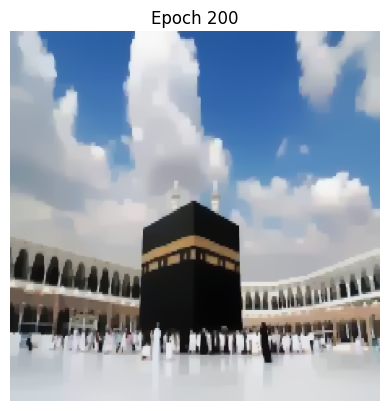

 13%|█▎        | 201/1500 [02:07<16:21,  1.32it/s]

Inside compute_loss:
Content Loss: 6.002917871228419e-06, Style Loss: 2.967618229376967e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 202/1500 [02:08<14:06,  1.53it/s]

Inside compute_loss:
Content Loss: 6.036145350662991e-06, Style Loss: 2.971345566038508e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 203/1500 [02:08<13:54,  1.55it/s]

Inside compute_loss:
Content Loss: 6.069277787901228e-06, Style Loss: 2.975030383822741e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 204/1500 [02:09<13:49,  1.56it/s]

Inside compute_loss:
Content Loss: 6.102416136855027e-06, Style Loss: 2.9786851882818155e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 205/1500 [02:10<13:43,  1.57it/s]

Inside compute_loss:
Content Loss: 6.13559814155451e-06, Style Loss: 2.9823258955730125e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 206/1500 [02:10<13:43,  1.57it/s]

Inside compute_loss:
Content Loss: 6.168757408886449e-06, Style Loss: 2.986006393257412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 207/1500 [02:11<13:39,  1.58it/s]

Inside compute_loss:
Content Loss: 6.201988526299829e-06, Style Loss: 2.9896245905547403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 208/1500 [02:12<13:37,  1.58it/s]

Inside compute_loss:
Content Loss: 6.23529786025756e-06, Style Loss: 2.993308726217947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 209/1500 [02:12<13:36,  1.58it/s]

Inside compute_loss:
Content Loss: 6.2684412114322186e-06, Style Loss: 2.9969341994728893e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 210/1500 [02:13<13:50,  1.55it/s]

Inside compute_loss:
Content Loss: 6.301567282207543e-06, Style Loss: 3.0005544431332964e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 211/1500 [02:14<13:45,  1.56it/s]

Inside compute_loss:
Content Loss: 6.334777935990132e-06, Style Loss: 3.0041976515349234e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 212/1500 [02:14<14:00,  1.53it/s]

Inside compute_loss:
Content Loss: 6.367853984556859e-06, Style Loss: 3.0078049348958302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 213/1500 [02:15<13:58,  1.53it/s]

Inside compute_loss:
Content Loss: 6.40089592707227e-06, Style Loss: 3.011356284332578e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 214/1500 [02:15<13:31,  1.59it/s]

Inside compute_loss:
Content Loss: 6.433765520341694e-06, Style Loss: 3.0148980840749573e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 215/1500 [02:16<13:32,  1.58it/s]

Inside compute_loss:
Content Loss: 6.466651484515751e-06, Style Loss: 3.0184189654391957e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 216/1500 [02:17<13:31,  1.58it/s]

Inside compute_loss:
Content Loss: 6.49946696285042e-06, Style Loss: 3.021878228537389e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 217/1500 [02:17<13:29,  1.58it/s]

Inside compute_loss:
Content Loss: 6.532458428409882e-06, Style Loss: 3.0254550438257866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 218/1500 [02:18<13:31,  1.58it/s]

Inside compute_loss:
Content Loss: 6.565384410350816e-06, Style Loss: 3.028977971553104e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 219/1500 [02:19<13:33,  1.57it/s]

Inside compute_loss:
Content Loss: 6.5981435000139754e-06, Style Loss: 3.0325270472530974e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 220/1500 [02:19<13:26,  1.59it/s]

Inside compute_loss:
Content Loss: 6.630952611885732e-06, Style Loss: 3.03607816931617e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 221/1500 [02:20<13:27,  1.58it/s]

Inside compute_loss:
Content Loss: 6.663776730420068e-06, Style Loss: 3.0395478916034335e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 222/1500 [02:21<13:30,  1.58it/s]

Inside compute_loss:
Content Loss: 6.696532636851771e-06, Style Loss: 3.043068318220321e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 223/1500 [02:21<13:28,  1.58it/s]

Inside compute_loss:
Content Loss: 6.7293294705450535e-06, Style Loss: 3.0465450890915236e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 225/1500 [02:22<13:21,  1.59it/s]

Inside compute_loss:
Content Loss: 6.761963504686719e-06, Style Loss: 3.0499681997753214e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 226/1500 [02:23<13:21,  1.59it/s]

Inside compute_loss:
Content Loss: 6.794602086301893e-06, Style Loss: 3.05340972772683e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.827415290899808e-06, Style Loss: 3.056905143239419e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 227/1500 [02:24<13:29,  1.57it/s]

Inside compute_loss:
Content Loss: 6.8600588747358415e-06, Style Loss: 3.0603214327129535e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 228/1500 [02:24<13:21,  1.59it/s]

Inside compute_loss:
Content Loss: 6.892628789501032e-06, Style Loss: 3.0637024792667944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 229/1500 [02:25<13:31,  1.57it/s]

Inside compute_loss:
Content Loss: 6.925318757566856e-06, Style Loss: 3.0671337754029082e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 230/1500 [02:26<13:36,  1.56it/s]

Inside compute_loss:
Content Loss: 6.957794084883062e-06, Style Loss: 3.0704300115758087e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 231/1500 [02:26<13:32,  1.56it/s]

Inside compute_loss:
Content Loss: 6.990307156229392e-06, Style Loss: 3.0738135592400795e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 232/1500 [02:27<13:43,  1.54it/s]

Inside compute_loss:
Content Loss: 7.022723821137333e-06, Style Loss: 3.0771732326684287e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 233/1500 [02:28<13:38,  1.55it/s]

Inside compute_loss:
Content Loss: 7.055156402202556e-06, Style Loss: 3.080487203988014e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 234/1500 [02:28<13:22,  1.58it/s]

Inside compute_loss:
Content Loss: 7.087619451340288e-06, Style Loss: 3.0838646125630476e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 235/1500 [02:29<13:20,  1.58it/s]

Inside compute_loss:
Content Loss: 7.1201234277396e-06, Style Loss: 3.087253162448178e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 236/1500 [02:29<13:18,  1.58it/s]

Inside compute_loss:
Content Loss: 7.15256510375184e-06, Style Loss: 3.0905796393199125e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 238/1500 [02:31<13:13,  1.59it/s]

Inside compute_loss:
Content Loss: 7.184928563219728e-06, Style Loss: 3.0939272619434632e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.217362508527003e-06, Style Loss: 3.0972742024459876e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 239/1500 [02:31<13:14,  1.59it/s]

Inside compute_loss:
Content Loss: 7.249714599311119e-06, Style Loss: 3.1005756682134233e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 241/1500 [02:33<13:09,  1.60it/s]

Inside compute_loss:
Content Loss: 7.281886155396933e-06, Style Loss: 3.1038957786222454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 242/1500 [02:33<13:09,  1.59it/s]

Inside compute_loss:
Content Loss: 7.314116373891011e-06, Style Loss: 3.107156544501777e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 243/1500 [02:34<13:08,  1.59it/s]

Inside compute_loss:
Content Loss: 7.346318398049334e-06, Style Loss: 3.1104138997761765e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 244/1500 [02:34<13:08,  1.59it/s]

Inside compute_loss:
Content Loss: 7.3786954999377485e-06, Style Loss: 3.1137230962485773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.411075785057619e-06, Style Loss: 3.1169990961643634e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 245/1500 [02:35<13:12,  1.58it/s]

Inside compute_loss:
Content Loss: 7.443375125149032e-06, Style Loss: 3.1202678201225353e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 246/1500 [02:36<13:11,  1.58it/s]

Inside compute_loss:
Content Loss: 7.475406164303422e-06, Style Loss: 3.1234992547979346e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 247/1500 [02:36<13:10,  1.58it/s]

Inside compute_loss:
Content Loss: 7.507519967475673e-06, Style Loss: 3.1266829410014907e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 248/1500 [02:37<13:08,  1.59it/s]

Inside compute_loss:
Content Loss: 7.539712896686979e-06, Style Loss: 3.129919150524074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 249/1500 [02:38<13:23,  1.56it/s]

Inside compute_loss:
Content Loss: 7.571861260657897e-06, Style Loss: 3.1331244372267975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 250/1500 [02:38<13:19,  1.56it/s]

Inside compute_loss:
Content Loss: 7.604194706800627e-06, Style Loss: 3.136343138976372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 251/1500 [02:39<13:22,  1.56it/s]

Inside compute_loss:
Content Loss: 7.636393092980143e-06, Style Loss: 3.1395820769830607e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 252/1500 [02:40<13:26,  1.55it/s]

Inside compute_loss:
Content Loss: 7.668390935577918e-06, Style Loss: 3.1427450721821515e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 253/1500 [02:40<13:17,  1.56it/s]

Inside compute_loss:
Content Loss: 7.700462447246537e-06, Style Loss: 3.1459373985853745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 255/1500 [02:41<13:05,  1.58it/s]

Inside compute_loss:
Content Loss: 7.732476660748944e-06, Style Loss: 3.1491554182139225e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 256/1500 [02:42<13:05,  1.58it/s]

Inside compute_loss:
Content Loss: 7.764534529997036e-06, Style Loss: 3.152367071379558e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 257/1500 [02:43<13:02,  1.59it/s]

Inside compute_loss:
Content Loss: 7.796604222676251e-06, Style Loss: 3.1554930046695517e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 258/1500 [02:43<13:02,  1.59it/s]

Inside compute_loss:
Content Loss: 7.828645721019711e-06, Style Loss: 3.158630534016993e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.860791811253875e-06, Style Loss: 3.1617405511497054e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 259/1500 [02:44<13:03,  1.58it/s]

Inside compute_loss:
Content Loss: 7.892773282947019e-06, Style Loss: 3.1648949061491294e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 260/1500 [02:45<13:02,  1.58it/s]

Inside compute_loss:
Content Loss: 7.924595593067352e-06, Style Loss: 3.1679953735874733e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 261/1500 [02:45<13:00,  1.59it/s]

Inside compute_loss:
Content Loss: 7.956136869324837e-06, Style Loss: 3.171060825479799e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 263/1500 [02:47<13:00,  1.58it/s]

Inside compute_loss:
Content Loss: 7.987514436536003e-06, Style Loss: 3.1740339636598947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.01909754954977e-06, Style Loss: 3.1771041903994046e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 264/1500 [02:47<13:02,  1.58it/s]

Inside compute_loss:
Content Loss: 8.050823453231715e-06, Style Loss: 3.1801801014808007e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 265/1500 [02:48<13:02,  1.58it/s]

Inside compute_loss:
Content Loss: 8.082668500719592e-06, Style Loss: 3.18322690873174e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 267/1500 [02:49<12:54,  1.59it/s]

Inside compute_loss:
Content Loss: 8.114636329992209e-06, Style Loss: 3.186299181834329e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.146424079313874e-06, Style Loss: 3.1893009690975305e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 268/1500 [02:50<12:55,  1.59it/s]

Inside compute_loss:
Content Loss: 8.177995368896518e-06, Style Loss: 3.19232231049682e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 269/1500 [02:50<13:13,  1.55it/s]

Inside compute_loss:
Content Loss: 8.209405677916948e-06, Style Loss: 3.1953077268553898e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 270/1500 [02:51<13:15,  1.55it/s]

Inside compute_loss:
Content Loss: 8.24100152385654e-06, Style Loss: 3.1982935979613103e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 271/1500 [02:52<13:06,  1.56it/s]

Inside compute_loss:
Content Loss: 8.272748345916625e-06, Style Loss: 3.201306753908284e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 272/1500 [02:52<13:07,  1.56it/s]

Inside compute_loss:
Content Loss: 8.30454609968001e-06, Style Loss: 3.204299446224468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 273/1500 [02:53<13:08,  1.56it/s]

Inside compute_loss:
Content Loss: 8.336194696312305e-06, Style Loss: 3.207283043593634e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 275/1500 [02:54<12:51,  1.59it/s]

Inside compute_loss:
Content Loss: 8.367808732145932e-06, Style Loss: 3.210264594599721e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.399260877922643e-06, Style Loss: 3.2132525120687205e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 276/1500 [02:55<12:51,  1.59it/s]

Inside compute_loss:
Content Loss: 8.430682100879494e-06, Style Loss: 3.216257255189703e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 277/1500 [02:55<12:50,  1.59it/s]

Inside compute_loss:
Content Loss: 8.462070582027081e-06, Style Loss: 3.2191883292398416e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 278/1500 [02:56<12:48,  1.59it/s]

Inside compute_loss:
Content Loss: 8.493472705595195e-06, Style Loss: 3.2222096706391312e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 280/1500 [02:57<12:47,  1.59it/s]

Inside compute_loss:
Content Loss: 8.524910299456678e-06, Style Loss: 3.2251955417450517e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.556336069887038e-06, Style Loss: 3.2281752737617353e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 281/1500 [02:58<12:48,  1.59it/s]

Inside compute_loss:
Content Loss: 8.587842785345856e-06, Style Loss: 3.2311374980054097e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 282/1500 [02:59<12:46,  1.59it/s]

Inside compute_loss:
Content Loss: 8.61919397721067e-06, Style Loss: 3.2340517464035656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 283/1500 [02:59<12:45,  1.59it/s]

Inside compute_loss:
Content Loss: 8.650483323435765e-06, Style Loss: 3.2369737255066866e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 284/1500 [03:00<12:43,  1.59it/s]

Inside compute_loss:
Content Loss: 8.681548024469521e-06, Style Loss: 3.2398991152149392e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 285/1500 [03:00<12:43,  1.59it/s]

Inside compute_loss:
Content Loss: 8.712656381248962e-06, Style Loss: 3.242781986045884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 286/1500 [03:01<12:42,  1.59it/s]

Inside compute_loss:
Content Loss: 8.743710168346297e-06, Style Loss: 3.2456307508255122e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 287/1500 [03:02<12:40,  1.60it/s]

Inside compute_loss:
Content Loss: 8.7746448116377e-06, Style Loss: 3.2484845178260002e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 288/1500 [03:02<12:40,  1.59it/s]

Inside compute_loss:
Content Loss: 8.805617653706577e-06, Style Loss: 3.251332600484602e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 289/1500 [03:03<12:54,  1.56it/s]

Inside compute_loss:
Content Loss: 8.836836968839634e-06, Style Loss: 3.2542197914153803e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 290/1500 [03:04<12:49,  1.57it/s]

Inside compute_loss:
Content Loss: 8.868098120728973e-06, Style Loss: 3.257068783568684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 291/1500 [03:04<12:51,  1.57it/s]

Inside compute_loss:
Content Loss: 8.89925559022231e-06, Style Loss: 3.2599398309685057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 292/1500 [03:05<12:56,  1.56it/s]

Inside compute_loss:
Content Loss: 8.930413059715647e-06, Style Loss: 3.2628022381686606e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 293/1500 [03:06<12:42,  1.58it/s]

Inside compute_loss:
Content Loss: 8.961524144979194e-06, Style Loss: 3.2657148949510884e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 295/1500 [03:07<12:39,  1.59it/s]

Inside compute_loss:
Content Loss: 8.992592483991757e-06, Style Loss: 3.268515229137847e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.023616257763933e-06, Style Loss: 3.2713933251216076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 296/1500 [03:07<12:38,  1.59it/s]

Inside compute_loss:
Content Loss: 9.05444539966993e-06, Style Loss: 3.274196387792472e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 298/1500 [03:09<12:35,  1.59it/s]

Inside compute_loss:
Content Loss: 9.085416422749404e-06, Style Loss: 3.277040605098591e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.11639381229179e-06, Style Loss: 3.2798652682686225e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 299/1500 [03:09<12:37,  1.59it/s]

Inside compute_loss:
Content Loss: 9.147426681010984e-06, Style Loss: 3.282702436990803e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 300/1500 [03:10<12:36,  1.59it/s]

Inside compute_loss:
Content Loss: 9.178344953397755e-06, Style Loss: 3.2855487006600015e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 300, Loss: 2591.100586, Alpha: 10.0000, Beta: 10.0000


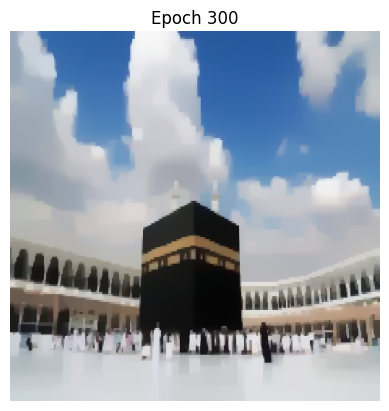

 20%|██        | 301/1500 [03:11<14:57,  1.34it/s]

Inside compute_loss:
Content Loss: 9.20912225410575e-06, Style Loss: 3.2883358471735846e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 302/1500 [03:11<12:55,  1.54it/s]

Inside compute_loss:
Content Loss: 9.239652172254864e-06, Style Loss: 3.291178472863976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 303/1500 [03:12<12:48,  1.56it/s]

Inside compute_loss:
Content Loss: 9.270314876630437e-06, Style Loss: 3.293981990282191e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 304/1500 [03:13<12:40,  1.57it/s]

Inside compute_loss:
Content Loss: 9.301093996327836e-06, Style Loss: 3.2967734568956075e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 305/1500 [03:13<12:37,  1.58it/s]

Inside compute_loss:
Content Loss: 9.33188039198285e-06, Style Loss: 3.299579702797928e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 306/1500 [03:14<12:34,  1.58it/s]

Inside compute_loss:
Content Loss: 9.362455784867052e-06, Style Loss: 3.30235093315423e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 307/1500 [03:15<12:33,  1.58it/s]

Inside compute_loss:
Content Loss: 9.39282926992746e-06, Style Loss: 3.3050700949388556e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 308/1500 [03:15<12:31,  1.59it/s]

Inside compute_loss:
Content Loss: 9.423324627277907e-06, Style Loss: 3.3078156320698326e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 309/1500 [03:16<12:50,  1.55it/s]

Inside compute_loss:
Content Loss: 9.453990969632287e-06, Style Loss: 3.310563897684915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 310/1500 [03:16<12:46,  1.55it/s]

Inside compute_loss:
Content Loss: 9.484453585173469e-06, Style Loss: 3.3132785119960317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 311/1500 [03:17<12:50,  1.54it/s]

Inside compute_loss:
Content Loss: 9.514785233477596e-06, Style Loss: 3.3159612939925864e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 312/1500 [03:18<12:49,  1.54it/s]

Inside compute_loss:
Content Loss: 9.545183274894953e-06, Style Loss: 3.318697963550221e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 313/1500 [03:18<12:27,  1.59it/s]

Inside compute_loss:
Content Loss: 9.575528565619607e-06, Style Loss: 3.3213775623153197e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 314/1500 [03:19<12:26,  1.59it/s]

Inside compute_loss:
Content Loss: 9.605672858015168e-06, Style Loss: 3.3239803087781183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 315/1500 [03:20<12:29,  1.58it/s]

Inside compute_loss:
Content Loss: 9.635891728976276e-06, Style Loss: 3.326641035528155e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 317/1500 [03:21<12:20,  1.60it/s]

Inside compute_loss:
Content Loss: 9.666172445577104e-06, Style Loss: 3.3292969874310074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.69666780292755e-06, Style Loss: 3.3319963677058695e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 318/1500 [03:21<12:20,  1.60it/s]

Inside compute_loss:
Content Loss: 9.727039468998555e-06, Style Loss: 3.334655957587529e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 319/1500 [03:22<12:22,  1.59it/s]

Inside compute_loss:
Content Loss: 9.757409316080157e-06, Style Loss: 3.3373323731211713e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 321/1500 [03:23<12:19,  1.59it/s]

Inside compute_loss:
Content Loss: 9.787706403585616e-06, Style Loss: 3.3399899166397518e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.81788707576925e-06, Style Loss: 3.3426933896407718e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 323/1500 [03:25<12:18,  1.59it/s]

Inside compute_loss:
Content Loss: 9.847944966168143e-06, Style Loss: 3.345326149428729e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.87792282103328e-06, Style Loss: 3.34797368850559e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 324/1500 [03:25<12:18,  1.59it/s]

Inside compute_loss:
Content Loss: 9.908057108987123e-06, Style Loss: 3.3505916690046433e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 325/1500 [03:26<12:17,  1.59it/s]

Inside compute_loss:
Content Loss: 9.937793038261589e-06, Style Loss: 3.353145075379871e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 326/1500 [03:27<12:20,  1.59it/s]

Inside compute_loss:
Content Loss: 9.967776350094937e-06, Style Loss: 3.3557666938577313e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 327/1500 [03:27<12:15,  1.60it/s]

Inside compute_loss:
Content Loss: 9.99767507892102e-06, Style Loss: 3.358333060532459e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 328/1500 [03:28<12:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0027547432400752e-05, Style Loss: 3.3609137517487397e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 329/1500 [03:28<12:28,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0057262443297077e-05, Style Loss: 3.3634630653978093e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 330/1500 [03:29<12:27,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0087023838423193e-05, Style Loss: 3.366004875715589e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 331/1500 [03:30<12:37,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0116768862644676e-05, Style Loss: 3.3685619200696237e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 333/1500 [03:31<12:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0146520253329072e-05, Style Loss: 3.371188540768344e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0176271644013468e-05, Style Loss: 3.3737603644112824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 335/1500 [03:32<12:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0206048500549514e-05, Style Loss: 3.376323547854554e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0235819900117349e-05, Style Loss: 3.3789283406804316e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 336/1500 [03:33<12:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0265910532325506e-05, Style Loss: 3.38151812684373e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 337/1500 [03:33<12:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0295843821950257e-05, Style Loss: 3.384133833606029e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 338/1500 [03:34<12:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0325391485821456e-05, Style Loss: 3.3866713238239754e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 339/1500 [03:35<12:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0354881851526443e-05, Style Loss: 3.3892204100993695e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 340/1500 [03:35<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0384265806351323e-05, Style Loss: 3.3917156088136835e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 341/1500 [03:36<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.041362793330336e-05, Style Loss: 3.3942060326808132e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 342/1500 [03:37<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0443008250149433e-05, Style Loss: 3.3967080526053905e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 343/1500 [03:37<12:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0472402209416032e-05, Style Loss: 3.399194838493713e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 344/1500 [03:38<12:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0501971701160073e-05, Style Loss: 3.401753019716125e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 345/1500 [03:39<12:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0531496627663728e-05, Style Loss: 3.404300969123142e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 346/1500 [03:39<12:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.056093333318131e-05, Style Loss: 3.4067893466271926e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 347/1500 [03:40<12:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.059021451510489e-05, Style Loss: 3.4092720397893572e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 348/1500 [03:40<12:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.061921921063913e-05, Style Loss: 3.411690158827696e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 349/1500 [03:41<12:19,  1.56it/s]

Inside compute_loss:
Content Loss: 1.0648050192685332e-05, Style Loss: 3.414131924728281e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 350/1500 [03:42<12:14,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0676921192498412e-05, Style Loss: 3.4165791475970764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 351/1500 [03:42<12:23,  1.55it/s]

Inside compute_loss:
Content Loss: 1.0706000466598198e-05, Style Loss: 3.4190670703537762e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 352/1500 [03:43<12:10,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0735123396443669e-05, Style Loss: 3.4214961033285363e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 354/1500 [03:44<12:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0764361832116265e-05, Style Loss: 3.4240167678945e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.07933637991664e-05, Style Loss: 3.4264844543940853e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 356/1500 [03:46<11:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0822441254276782e-05, Style Loss: 3.4289894301764434e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 357/1500 [03:46<11:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0851287697732914e-05, Style Loss: 3.431386858210317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.088015687855659e-05, Style Loss: 3.4338186196691822e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 359/1500 [03:47<11:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0908865988312755e-05, Style Loss: 3.4361739835730987e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0937713341263589e-05, Style Loss: 3.4385884646326303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 360/1500 [03:48<12:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0966571608150844e-05, Style Loss: 3.4410243188176537e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 361/1500 [03:49<11:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0995380762324203e-05, Style Loss: 3.443418563620071e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 362/1500 [03:49<11:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1024225386790931e-05, Style Loss: 3.445825996095664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 363/1500 [03:50<11:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1053303751396015e-05, Style Loss: 3.448224333624239e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 364/1500 [03:51<11:52,  1.60it/s]

Inside compute_loss:
Content Loss: 1.1082279343099799e-05, Style Loss: 3.4506458632677095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 365/1500 [03:51<11:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1111122148577124e-05, Style Loss: 3.4530251014075475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 366/1500 [03:52<11:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1139935850223992e-05, Style Loss: 3.4554198009573156e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 367/1500 [03:52<11:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1168678611284122e-05, Style Loss: 3.457862931099953e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 368/1500 [03:53<12:05,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1197408639418427e-05, Style Loss: 3.4602510368131334e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 369/1500 [03:54<12:02,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1225919479329605e-05, Style Loss: 3.4625820717337774e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 370/1500 [03:54<12:08,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1254440323682502e-05, Style Loss: 3.464910378170316e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 372/1500 [03:56<11:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1283061212452594e-05, Style Loss: 3.46724391420139e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1311801245028619e-05, Style Loss: 3.4696074635576224e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 373/1500 [03:56<11:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1340522178215906e-05, Style Loss: 3.4719550967565738e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 374/1500 [03:57<11:54,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1369030289642978e-05, Style Loss: 3.4742665775411297e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 375/1500 [03:58<11:51,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1397311027394608e-05, Style Loss: 3.4765887448884314e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 376/1500 [03:58<11:50,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1425384400354233e-05, Style Loss: 3.478917506072321e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 377/1500 [03:59<11:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1453408660599962e-05, Style Loss: 3.481174644548446e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 378/1500 [03:59<11:49,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1481603905849624e-05, Style Loss: 3.4834504276659572e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 379/1500 [04:00<11:42,  1.60it/s]

Inside compute_loss:
Content Loss: 1.1509662726894021e-05, Style Loss: 3.4856793718063273e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 381/1500 [04:01<11:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1537781574588735e-05, Style Loss: 3.4878939914051443e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1565937711566221e-05, Style Loss: 3.4902134302683407e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 382/1500 [04:02<11:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1594097486522514e-05, Style Loss: 3.4925151339848526e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 383/1500 [04:03<11:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1622065358096734e-05, Style Loss: 3.4947927360917674e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 384/1500 [04:03<11:46,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1650121450657025e-05, Style Loss: 3.4970964861713583e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 386/1500 [04:04<11:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1678224836941808e-05, Style Loss: 3.4993495319213253e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1706298209901433e-05, Style Loss: 3.5016585115954513e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 387/1500 [04:05<11:43,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1734390682249796e-05, Style Loss: 3.5038715395785403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 388/1500 [04:06<11:58,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1762614121835213e-05, Style Loss: 3.5061611924902536e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 389/1500 [04:06<11:50,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1790817552537192e-05, Style Loss: 3.5084444789390545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 390/1500 [04:07<11:54,  1.55it/s]

Inside compute_loss:
Content Loss: 1.181892821477959e-05, Style Loss: 3.510731630740338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 391/1500 [04:08<12:09,  1.52it/s]

Inside compute_loss:
Content Loss: 1.1847005225718021e-05, Style Loss: 3.5130146898154635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 392/1500 [04:08<11:40,  1.58it/s]

Inside compute_loss:
Content Loss: 1.1874883966811467e-05, Style Loss: 3.51528024111758e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 393/1500 [04:09<11:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1902945516339969e-05, Style Loss: 3.5175955872546183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 394/1500 [04:10<11:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1931041626667138e-05, Style Loss: 3.5198686418880243e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 395/1500 [04:10<11:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1958948562096339e-05, Style Loss: 3.5221398775320267e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 397/1500 [04:11<11:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.198659902001964e-05, Style Loss: 3.52437564288266e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2014007552352268e-05, Style Loss: 3.5265079532109667e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 399/1500 [04:13<11:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2041428817610722e-05, Style Loss: 3.5287141599837923e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 400/1500 [04:13<11:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2069219337718096e-05, Style Loss: 3.5309494705870748e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2097148101020139e-05, Style Loss: 3.5331952403794276e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 400, Loss: 2210.088867, Alpha: 10.0000, Beta: 10.0000


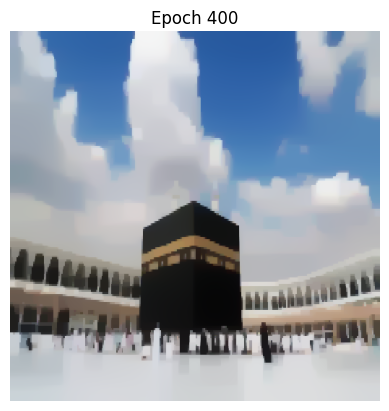

 27%|██▋       | 401/1500 [04:14<13:43,  1.34it/s]

Inside compute_loss:
Content Loss: 1.212480401591165e-05, Style Loss: 3.5354512419871753e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 402/1500 [04:15<12:47,  1.43it/s]

Inside compute_loss:
Content Loss: 1.2152297131251544e-05, Style Loss: 3.5376142477616668e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 403/1500 [04:16<12:21,  1.48it/s]

Inside compute_loss:
Content Loss: 1.217991939483909e-05, Style Loss: 3.5398163618083345e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 404/1500 [04:16<12:11,  1.50it/s]

Inside compute_loss:
Content Loss: 1.2207220606796909e-05, Style Loss: 3.5420130188867915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 405/1500 [04:17<11:57,  1.53it/s]

Inside compute_loss:
Content Loss: 1.2234212590556126e-05, Style Loss: 3.544120090737124e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 406/1500 [04:17<11:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2261090887477621e-05, Style Loss: 3.5462128380459035e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 407/1500 [04:18<11:56,  1.53it/s]

Inside compute_loss:
Content Loss: 1.2288139259908348e-05, Style Loss: 3.5483005831338232e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 408/1500 [04:19<11:48,  1.54it/s]

Inside compute_loss:
Content Loss: 1.2315362255321816e-05, Style Loss: 3.5504542665876215e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 409/1500 [04:19<11:49,  1.54it/s]

Inside compute_loss:
Content Loss: 1.234266619576374e-05, Style Loss: 3.552609086909797e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 410/1500 [04:20<11:56,  1.52it/s]

Inside compute_loss:
Content Loss: 1.2369850992399734e-05, Style Loss: 3.5547668630897533e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 412/1500 [04:21<11:26,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2397061254887376e-05, Style Loss: 3.5569185001804726e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2424432497937232e-05, Style Loss: 3.5590289826359367e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 414/1500 [04:23<11:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2451739166863263e-05, Style Loss: 3.561225867088069e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 415/1500 [04:23<11:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.247906493517803e-05, Style Loss: 3.5633847801364027e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2506454368121922e-05, Style Loss: 3.5655741612572456e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 416/1500 [04:24<11:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2533727385743987e-05, Style Loss: 3.567702833606745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 417/1500 [04:24<11:25,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2560700270114467e-05, Style Loss: 3.569824912119657e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 418/1500 [04:25<11:38,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2587482160597574e-05, Style Loss: 3.5719397146749543e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 419/1500 [04:26<11:34,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2614218576345593e-05, Style Loss: 3.5740611110668397e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 420/1500 [04:26<11:32,  1.56it/s]

Inside compute_loss:
Content Loss: 1.264123147848295e-05, Style Loss: 3.5762068364419974e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 421/1500 [04:27<11:37,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2668126146309078e-05, Style Loss: 3.578338692022953e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 422/1500 [04:28<11:25,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2695037185039837e-05, Style Loss: 3.5804421258944785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 423/1500 [04:28<11:26,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2721705388685223e-05, Style Loss: 3.582469616958406e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 424/1500 [04:29<11:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2748267181450501e-05, Style Loss: 3.584593514460721e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 425/1500 [04:30<11:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2775012692145538e-05, Style Loss: 3.5866723919752985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 426/1500 [04:30<11:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2801810044038575e-05, Style Loss: 3.5886996556655504e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 427/1500 [04:31<11:26,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2828490980609786e-05, Style Loss: 3.590747837733943e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 428/1500 [04:32<11:26,  1.56it/s]

Inside compute_loss:
Content Loss: 1.2855099157604855e-05, Style Loss: 3.592828988985275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 429/1500 [04:32<11:39,  1.53it/s]

Inside compute_loss:
Content Loss: 1.2881638213002589e-05, Style Loss: 3.5948808090324746e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 431/1500 [04:33<11:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2908177268400323e-05, Style Loss: 3.5969092095911037e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.29344307424617e-05, Style Loss: 3.5989385196444346e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 432/1500 [04:34<11:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2960877029399853e-05, Style Loss: 3.6009996620123275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 434/1500 [04:35<11:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2987490663363133e-05, Style Loss: 3.603074901548098e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3014084288442973e-05, Style Loss: 3.6051299048267538e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 435/1500 [04:36<11:12,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3040912563155871e-05, Style Loss: 3.60719786840491e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 437/1500 [04:37<11:06,  1.60it/s]

Inside compute_loss:
Content Loss: 1.306771082454361e-05, Style Loss: 3.609266741477768e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 438/1500 [04:38<11:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3094265341351274e-05, Style Loss: 3.6114061003900133e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 439/1500 [04:38<11:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3120748008077499e-05, Style Loss: 3.613468606999959e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 440/1500 [04:39<11:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3147125173418317e-05, Style Loss: 3.6155256566416938e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3173339539207518e-05, Style Loss: 3.6175219975120854e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 441/1500 [04:40<11:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3199530258134473e-05, Style Loss: 3.619507651819731e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 442/1500 [04:40<11:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3225857401266694e-05, Style Loss: 3.6215299132891232e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 443/1500 [04:41<11:08,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3252119060780387e-05, Style Loss: 3.6234896469977684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 444/1500 [04:42<11:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3278148799145129e-05, Style Loss: 3.6254714359529316e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 445/1500 [04:42<11:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3304367712407839e-05, Style Loss: 3.6274900594435167e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 446/1500 [04:43<11:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3330655747267883e-05, Style Loss: 3.6295532481744885e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 447/1500 [04:44<11:20,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3356914678297471e-05, Style Loss: 3.6315852867119247e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 448/1500 [04:44<11:12,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3382760698732454e-05, Style Loss: 3.6336325592856156e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 449/1500 [04:45<11:25,  1.53it/s]

Inside compute_loss:
Content Loss: 1.3408523045654874e-05, Style Loss: 3.635631856013788e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 450/1500 [04:45<11:24,  1.53it/s]

Inside compute_loss:
Content Loss: 1.3434208995022345e-05, Style Loss: 3.6375738545757486e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 452/1500 [04:47<10:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3459811270877253e-05, Style Loss: 3.6395374536368763e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3485424460668582e-05, Style Loss: 3.641505145424162e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 453/1500 [04:47<11:00,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3511235010810196e-05, Style Loss: 3.6434430512599647e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 454/1500 [04:48<11:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3537122868001461e-05, Style Loss: 3.645364813564811e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 456/1500 [04:49<10:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3563007087213919e-05, Style Loss: 3.6473061300057452e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 457/1500 [04:50<10:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3588588444690686e-05, Style Loss: 3.6492940580501454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3614223462354857e-05, Style Loss: 3.6512133192445617e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 458/1500 [04:50<10:57,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3639967619383242e-05, Style Loss: 3.6531516798277153e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 459/1500 [04:51<10:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3665347069036216e-05, Style Loss: 3.655088676168816e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 460/1500 [04:52<10:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3690529158338904e-05, Style Loss: 3.656988155853469e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 461/1500 [04:52<10:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3715743989450857e-05, Style Loss: 3.658920604721061e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 462/1500 [04:53<10:59,  1.57it/s]

Inside compute_loss:
Content Loss: 1.37410052047926e-05, Style Loss: 3.660878746813978e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 463/1500 [04:54<10:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3766503798251506e-05, Style Loss: 3.6629066926252563e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 464/1500 [04:54<10:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3792076970275957e-05, Style Loss: 3.664872792796814e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 465/1500 [04:55<10:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3817782019032165e-05, Style Loss: 3.6668336633738363e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 466/1500 [04:56<11:00,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3843473425367847e-05, Style Loss: 3.6687515603262e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 467/1500 [04:56<10:57,  1.57it/s]

Inside compute_loss:
Content Loss: 1.3868874702893663e-05, Style Loss: 3.6706801438413095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 468/1500 [04:57<10:58,  1.57it/s]

Inside compute_loss:
Content Loss: 1.389398403262021e-05, Style Loss: 3.672566208479111e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 469/1500 [04:58<11:09,  1.54it/s]

Inside compute_loss:
Content Loss: 1.3919187949795742e-05, Style Loss: 3.674477056847536e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 470/1500 [04:58<11:08,  1.54it/s]

Inside compute_loss:
Content Loss: 1.394453374814475e-05, Style Loss: 3.6763585740118288e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 472/1500 [04:59<10:47,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3969937754154671e-05, Style Loss: 3.6783135328732897e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 473/1500 [05:00<10:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3995287190482486e-05, Style Loss: 3.6802136946789687e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4020449270901736e-05, Style Loss: 3.6821520552621223e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 474/1500 [05:01<10:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4045425814401824e-05, Style Loss: 3.6840008306171512e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 475/1500 [05:01<10:47,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4070035831537098e-05, Style Loss: 3.6858461953670485e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 476/1500 [05:02<10:50,  1.57it/s]

Inside compute_loss:
Content Loss: 1.409489141224185e-05, Style Loss: 3.6877345337416045e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 478/1500 [05:03<10:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4119908883003518e-05, Style Loss: 3.6896090023219585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4144818123895675e-05, Style Loss: 3.6914045722369337e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 479/1500 [05:04<10:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4169786481943447e-05, Style Loss: 3.6932906368747354e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 480/1500 [05:04<10:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4194886716722976e-05, Style Loss: 3.695134182635229e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 481/1500 [05:05<10:43,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4219876902643591e-05, Style Loss: 3.696974317790591e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 482/1500 [05:06<10:42,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4244661542761605e-05, Style Loss: 3.698827640619129e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 483/1500 [05:06<10:45,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4269487110141199e-05, Style Loss: 3.7006680031481665e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 484/1500 [05:07<10:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4294512766355183e-05, Style Loss: 3.7025918118160916e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 485/1500 [05:08<10:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.431923737982288e-05, Style Loss: 3.704447408381384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 486/1500 [05:08<10:50,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4343627299240325e-05, Style Loss: 3.7061920465930598e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 487/1500 [05:09<10:51,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4367998119269032e-05, Style Loss: 3.707938276420464e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 488/1500 [05:10<10:54,  1.55it/s]

Inside compute_loss:
Content Loss: 1.439225616195472e-05, Style Loss: 3.7097186122991843e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 489/1500 [05:10<10:51,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4416818885365501e-05, Style Loss: 3.7115669329068623e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 490/1500 [05:11<10:40,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4441250641539227e-05, Style Loss: 3.7133722798898816e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 491/1500 [05:11<10:38,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4465610547631513e-05, Style Loss: 3.7151560263737338e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 492/1500 [05:12<10:38,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4489870409306604e-05, Style Loss: 3.716953642651788e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 493/1500 [05:13<10:39,  1.58it/s]

Inside compute_loss:
Content Loss: 1.451405569241615e-05, Style Loss: 3.718761035997886e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 494/1500 [05:13<10:37,  1.58it/s]

Inside compute_loss:
Content Loss: 1.453809909435222e-05, Style Loss: 3.720527047335054e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 495/1500 [05:14<10:37,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4562079741153866e-05, Style Loss: 3.7222869195829844e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 497/1500 [05:15<10:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.45860540214926e-05, Style Loss: 3.7240295114315813e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 498/1500 [05:16<10:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4610111065849196e-05, Style Loss: 3.7258141674101353e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4634360013587866e-05, Style Loss: 3.7275794966262765e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 499/1500 [05:16<10:32,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4658602594863623e-05, Style Loss: 3.7293955301720416e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 500/1500 [05:17<10:34,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4682759683637414e-05, Style Loss: 3.7311756386770867e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 500, Loss: 1921.209595, Alpha: 10.0000, Beta: 10.0000


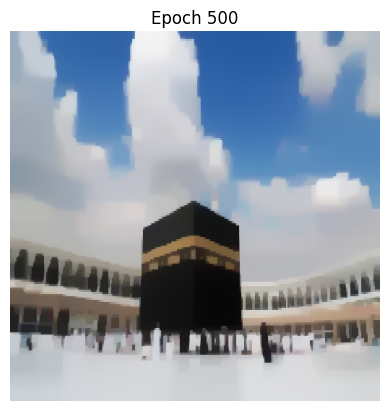

 33%|███▎      | 501/1500 [05:18<12:28,  1.33it/s]

Inside compute_loss:
Content Loss: 1.4706914953421801e-05, Style Loss: 3.7329436963773333e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 502/1500 [05:19<10:47,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4730857401445974e-05, Style Loss: 3.734691745194141e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 503/1500 [05:19<10:40,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4754492440260947e-05, Style Loss: 3.736389771802351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 504/1500 [05:20<10:36,  1.57it/s]

Inside compute_loss:
Content Loss: 1.4778110198676586e-05, Style Loss: 3.738093482752447e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 505/1500 [05:20<10:30,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4802081750531215e-05, Style Loss: 3.7398774566099746e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 506/1500 [05:21<10:44,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4825952348473947e-05, Style Loss: 3.7416123177536065e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 507/1500 [05:22<10:40,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4849584658804815e-05, Style Loss: 3.743373781617265e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 508/1500 [05:22<10:39,  1.55it/s]

Inside compute_loss:
Content Loss: 1.4873534382786602e-05, Style Loss: 3.7451088701345725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 510/1500 [05:24<10:20,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4897227629262488e-05, Style Loss: 3.7468244045157917e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4920890862413216e-05, Style Loss: 3.748532890313072e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 511/1500 [05:24<10:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4944395843485836e-05, Style Loss: 3.7502202303585364e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 513/1500 [05:26<10:17,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4967729839554522e-05, Style Loss: 3.7519389479712117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 514/1500 [05:26<10:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4991098396421876e-05, Style Loss: 3.753613555090851e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 515/1500 [05:27<10:17,  1.60it/s]

Inside compute_loss:
Content Loss: 1.501462611486204e-05, Style Loss: 3.7553513720922638e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 516/1500 [05:27<10:16,  1.60it/s]

Inside compute_loss:
Content Loss: 1.5038432138680946e-05, Style Loss: 3.757148078875616e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5062294551171362e-05, Style Loss: 3.758907951123547e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 517/1500 [05:28<10:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5085860468389e-05, Style Loss: 3.7605923353112303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 518/1500 [05:29<10:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5109358173504006e-05, Style Loss: 3.7622894524247386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 519/1500 [05:29<10:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5132734006328974e-05, Style Loss: 3.764035909625818e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 521/1500 [05:31<10:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5156223525991663e-05, Style Loss: 3.7657655411749147e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5179707588686142e-05, Style Loss: 3.7674403756682295e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 522/1500 [05:31<10:19,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5203528164420277e-05, Style Loss: 3.769111344809062e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 523/1500 [05:32<10:16,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5226898540277034e-05, Style Loss: 3.7707682167820167e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 524/1500 [05:32<10:16,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5250113392539788e-05, Style Loss: 3.7724230423918925e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 525/1500 [05:33<10:19,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5273215467459522e-05, Style Loss: 3.7741108371847076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 526/1500 [05:34<10:23,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5296203855541535e-05, Style Loss: 3.7757688460260397e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 527/1500 [05:34<10:20,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5319374142563902e-05, Style Loss: 3.77740798285231e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 528/1500 [05:35<10:34,  1.53it/s]

Inside compute_loss:
Content Loss: 1.5342558981501497e-05, Style Loss: 3.7790887290611863e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 529/1500 [05:36<10:30,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5365867511718534e-05, Style Loss: 3.7808013075846247e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 530/1500 [05:36<10:13,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5388912288472056e-05, Style Loss: 3.782418389164377e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 531/1500 [05:37<10:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5411766071338207e-05, Style Loss: 3.7840561617485946e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 533/1500 [05:38<10:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5434412489412352e-05, Style Loss: 3.785708258874365e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5457077097380534e-05, Style Loss: 3.787330342674977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 534/1500 [05:39<10:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5479881767532788e-05, Style Loss: 3.788983121921774e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 535/1500 [05:39<10:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.55029720190214e-05, Style Loss: 3.790701157413423e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 536/1500 [05:40<10:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5525865819654427e-05, Style Loss: 3.792367806454422e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 537/1500 [05:41<10:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.554863956698682e-05, Style Loss: 3.7939967114652973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 538/1500 [05:41<10:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5571180483675562e-05, Style Loss: 3.7955733205308206e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 539/1500 [05:42<10:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5593408534186892e-05, Style Loss: 3.7971553865645546e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 540/1500 [05:43<10:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5615720258210786e-05, Style Loss: 3.798738589466666e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 542/1500 [05:44<10:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5638317563571036e-05, Style Loss: 3.8003620375093305e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5661093129892834e-05, Style Loss: 3.801998673225171e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 543/1500 [05:45<10:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5683732272009365e-05, Style Loss: 3.8035755096643697e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 544/1500 [05:45<10:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.570608037582133e-05, Style Loss: 3.8051834962971043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 545/1500 [05:46<10:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.572804649185855e-05, Style Loss: 3.8067596506152768e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 546/1500 [05:46<10:19,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5749870726722293e-05, Style Loss: 3.808353540080134e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 547/1500 [05:47<10:10,  1.56it/s]

Inside compute_loss:
Content Loss: 1.577196962898597e-05, Style Loss: 3.8099560697446577e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 548/1500 [05:48<10:17,  1.54it/s]

Inside compute_loss:
Content Loss: 1.579421768838074e-05, Style Loss: 3.8115415463835234e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 549/1500 [05:48<10:18,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5816518498468213e-05, Style Loss: 3.8130954180815024e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 550/1500 [05:49<10:00,  1.58it/s]

Inside compute_loss:
Content Loss: 1.583913035574369e-05, Style Loss: 3.814750016317703e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 552/1500 [05:50<09:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5861785868764855e-05, Style Loss: 3.816378921328578e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 553/1500 [05:51<09:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5883973901509307e-05, Style Loss: 3.8179196053533815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 554/1500 [05:52<09:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5906201952020638e-05, Style Loss: 3.819478024524869e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.59284973051399e-05, Style Loss: 3.821166956186062e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 555/1500 [05:52<09:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5950665329000913e-05, Style Loss: 3.82268945031683e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 556/1500 [05:53<09:57,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5972531400620937e-05, Style Loss: 3.824205123237334e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 557/1500 [05:53<09:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5994515706552193e-05, Style Loss: 3.825767180387629e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 558/1500 [05:54<09:54,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6016827430576086e-05, Style Loss: 3.827309683401836e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 559/1500 [05:55<09:56,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6039091860875487e-05, Style Loss: 3.828920853266027e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 560/1500 [05:55<09:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6061238056863658e-05, Style Loss: 3.830460627796128e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 562/1500 [05:57<09:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6083295122371055e-05, Style Loss: 3.832028596661985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 563/1500 [05:57<09:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.610508479643613e-05, Style Loss: 3.83358064937056e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.612660889804829e-05, Style Loss: 3.83505766876624e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 564/1500 [05:58<09:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.614841130503919e-05, Style Loss: 3.836567429971183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 565/1500 [05:58<09:56,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6170111848623492e-05, Style Loss: 3.838054908555932e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 566/1500 [05:59<09:59,  1.56it/s]

Inside compute_loss:
Content Loss: 1.61919178935932e-05, Style Loss: 3.839692908513825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 567/1500 [06:00<09:53,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6213532944675535e-05, Style Loss: 3.841215857391944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 568/1500 [06:00<10:08,  1.53it/s]

Inside compute_loss:
Content Loss: 1.623476782697253e-05, Style Loss: 3.842722890112782e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 569/1500 [06:01<10:00,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6255986338364892e-05, Style Loss: 3.8442199183919e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 571/1500 [06:02<09:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6277286704280414e-05, Style Loss: 3.8457324080809485e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 572/1500 [06:03<09:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.629877988307271e-05, Style Loss: 3.847231710096821e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 573/1500 [06:04<09:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6320349459419958e-05, Style Loss: 3.848777396342484e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6341749869752675e-05, Style Loss: 3.850291250273585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 574/1500 [06:04<09:46,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6363030226784758e-05, Style Loss: 3.851793735520914e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 575/1500 [06:05<09:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6384139598812908e-05, Style Loss: 3.853263478958979e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 576/1500 [06:05<09:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.640508526179474e-05, Style Loss: 3.85467455998878e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 577/1500 [06:06<09:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.642598545004148e-05, Style Loss: 3.8561342989851255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 579/1500 [06:07<09:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.644674011913594e-05, Style Loss: 3.857566298393067e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6467669411213137e-05, Style Loss: 3.859036041831132e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 581/1500 [06:09<09:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6488540495629422e-05, Style Loss: 3.8604403016506694e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.650953527132515e-05, Style Loss: 3.8619436963927e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 582/1500 [06:09<09:39,  1.58it/s]

Inside compute_loss:
Content Loss: 1.653030631132424e-05, Style Loss: 3.863353413180448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 584/1500 [06:10<09:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6550968211959116e-05, Style Loss: 3.86482679459732e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6571333617321216e-05, Style Loss: 3.866265615215525e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 585/1500 [06:11<09:51,  1.55it/s]

Inside compute_loss:
Content Loss: 1.659200461290311e-05, Style Loss: 3.867739906127099e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 586/1500 [06:12<09:46,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6612890249234624e-05, Style Loss: 3.8692114685545675e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 587/1500 [06:12<09:50,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6633775885566138e-05, Style Loss: 3.870651653414825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 589/1500 [06:14<09:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.66546869877493e-05, Style Loss: 3.8721032069588546e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6675419828970917e-05, Style Loss: 3.873509740515146e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 590/1500 [06:14<09:37,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6695785234333016e-05, Style Loss: 3.874965841532685e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 591/1500 [06:15<09:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6716207028366625e-05, Style Loss: 3.8763532757002395e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 592/1500 [06:16<09:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.673664155532606e-05, Style Loss: 3.877772996929707e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 594/1500 [06:17<09:28,  1.59it/s]

Inside compute_loss:
Content Loss: 1.675702333159279e-05, Style Loss: 3.879192263411824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6777254131739028e-05, Style Loss: 3.8805947042419575e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 595/1500 [06:17<09:31,  1.58it/s]

Inside compute_loss:
Content Loss: 1.679766683082562e-05, Style Loss: 3.882003511535004e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 596/1500 [06:18<09:31,  1.58it/s]

Inside compute_loss:
Content Loss: 1.681854519119952e-05, Style Loss: 3.883426870743278e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 597/1500 [06:19<09:31,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6839261661516502e-05, Style Loss: 3.884896159433993e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 598/1500 [06:19<09:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6859457900864072e-05, Style Loss: 3.886235390382353e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 599/1500 [06:20<09:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6879552276805043e-05, Style Loss: 3.887598722940311e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 600/1500 [06:21<09:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6899908587220125e-05, Style Loss: 3.889017534675077e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 600, Loss: 1696.274292, Alpha: 10.0000, Beta: 10.0000


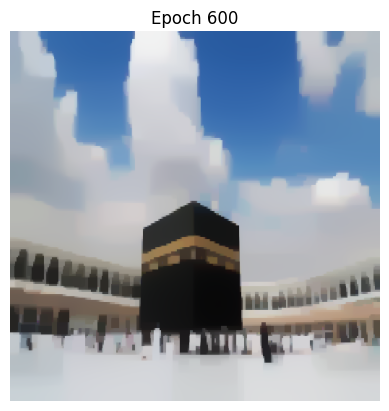

 40%|████      | 601/1500 [06:22<11:10,  1.34it/s]

Inside compute_loss:
Content Loss: 1.692013756837696e-05, Style Loss: 3.890436801157193e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 602/1500 [06:22<09:40,  1.55it/s]

Inside compute_loss:
Content Loss: 1.694018101261463e-05, Style Loss: 3.8917996789678e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 604/1500 [06:23<09:29,  1.57it/s]

Inside compute_loss:
Content Loss: 1.696041908871848e-05, Style Loss: 3.893197117577074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6980729924398474e-05, Style Loss: 3.894604560628068e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 605/1500 [06:24<09:38,  1.55it/s]

Inside compute_loss:
Content Loss: 1.700120083114598e-05, Style Loss: 3.8960511119512375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 606/1500 [06:25<09:40,  1.54it/s]

Inside compute_loss:
Content Loss: 1.702138251857832e-05, Style Loss: 3.897527676599566e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 607/1500 [06:25<09:46,  1.52it/s]

Inside compute_loss:
Content Loss: 1.7041324099409394e-05, Style Loss: 3.898908289556857e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 608/1500 [06:26<09:28,  1.57it/s]

Inside compute_loss:
Content Loss: 1.706120565359015e-05, Style Loss: 3.900264346157201e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 609/1500 [06:27<09:24,  1.58it/s]

Inside compute_loss:
Content Loss: 1.708085255813785e-05, Style Loss: 3.901593572663842e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 610/1500 [06:27<09:28,  1.57it/s]

Inside compute_loss:
Content Loss: 1.710076685412787e-05, Style Loss: 3.903004198946292e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 611/1500 [06:28<09:22,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7120268239523284e-05, Style Loss: 3.904262939613545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 612/1500 [06:28<09:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.713965139060747e-05, Style Loss: 3.905609901266871e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 613/1500 [06:29<09:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.715947473712731e-05, Style Loss: 3.906996425939724e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 614/1500 [06:30<09:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7179247151943855e-05, Style Loss: 3.9083715819288045e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 615/1500 [06:30<09:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7198921341332607e-05, Style Loss: 3.909715360350674e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 616/1500 [06:31<09:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7218322682310827e-05, Style Loss: 3.911038220394403e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 618/1500 [06:32<09:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.723768400552217e-05, Style Loss: 3.912355623469921e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7257099898415618e-05, Style Loss: 3.913703494617948e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 619/1500 [06:33<09:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7276686776313e-05, Style Loss: 3.915061370207695e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 620/1500 [06:33<09:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.729650830384344e-05, Style Loss: 3.916361038136529e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 621/1500 [06:34<09:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7316137018497102e-05, Style Loss: 3.917663434549468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 622/1500 [06:35<09:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7335167285637e-05, Style Loss: 3.918924448953476e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 623/1500 [06:35<09:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.735415389703121e-05, Style Loss: 3.920200015272712e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 624/1500 [06:36<09:24,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7372776710544713e-05, Style Loss: 3.921518327842932e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 625/1500 [06:37<09:18,  1.57it/s]

Inside compute_loss:
Content Loss: 1.739143226586748e-05, Style Loss: 3.922849373338977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 626/1500 [06:37<09:21,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7410175132681616e-05, Style Loss: 3.924144039046951e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 628/1500 [06:39<09:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7429063518648036e-05, Style Loss: 3.925435066776117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7448090147809125e-05, Style Loss: 3.92668289350695e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 629/1500 [06:39<09:13,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7466894860262983e-05, Style Loss: 3.9279934753722046e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 631/1500 [06:40<09:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7485754142398946e-05, Style Loss: 3.929291779058985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 632/1500 [06:41<09:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.750441333570052e-05, Style Loss: 3.9305809877987485e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 633/1500 [06:42<09:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.752279968059156e-05, Style Loss: 3.931835180992493e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 634/1500 [06:42<09:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.754149707267061e-05, Style Loss: 3.9332085179921705e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.75603199750185e-05, Style Loss: 3.93445998270181e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 635/1500 [06:43<09:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7579066479811445e-05, Style Loss: 3.935662334697554e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 637/1500 [06:44<09:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.759760380082298e-05, Style Loss: 3.936936536774738e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.761614294082392e-05, Style Loss: 3.938094778277446e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 638/1500 [06:45<09:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7634747564443387e-05, Style Loss: 3.9393726183334365e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 639/1500 [06:45<09:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7653435861575417e-05, Style Loss: 3.940628630516585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 640/1500 [06:46<09:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7671984096523374e-05, Style Loss: 3.941919203498401e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 641/1500 [06:47<09:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.769055779732298e-05, Style Loss: 3.943182491639163e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 642/1500 [06:47<09:09,  1.56it/s]

Inside compute_loss:
Content Loss: 1.770929702615831e-05, Style Loss: 3.944496256735874e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 643/1500 [06:48<08:55,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7727814338286407e-05, Style Loss: 3.945788193959743e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 644/1500 [06:49<09:14,  1.54it/s]

Inside compute_loss:
Content Loss: 1.7746097000781447e-05, Style Loss: 3.94700236938661e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 645/1500 [06:49<09:06,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7764496078598313e-05, Style Loss: 3.948235644202214e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 646/1500 [06:50<09:08,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7782822396839038e-05, Style Loss: 3.9494343582191505e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 647/1500 [06:51<09:14,  1.54it/s]

Inside compute_loss:
Content Loss: 1.7801037756726146e-05, Style Loss: 3.9506635403085966e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 649/1500 [06:52<08:56,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7819336790125817e-05, Style Loss: 3.951890448661288e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7837368432083167e-05, Style Loss: 3.953131454181857e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 650/1500 [06:52<08:56,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7855229089036584e-05, Style Loss: 3.954298790631583e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 651/1500 [06:53<08:57,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7873257093015127e-05, Style Loss: 3.955513420805801e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 652/1500 [06:54<08:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7891286915983073e-05, Style Loss: 3.95667257180321e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 653/1500 [06:54<08:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7908960217027925e-05, Style Loss: 3.9578053474542685e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 654/1500 [06:55<08:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.792657894839067e-05, Style Loss: 3.959017703891732e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 655/1500 [06:56<08:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.794450326997321e-05, Style Loss: 3.9602487049705815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 656/1500 [06:56<08:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.796234028006438e-05, Style Loss: 3.961476068070624e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 658/1500 [06:58<08:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7980271877604537e-05, Style Loss: 3.9627120713703334e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.799839265004266e-05, Style Loss: 3.9638975977140944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 659/1500 [06:58<08:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.801622420316562e-05, Style Loss: 3.96509585698368e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 661/1500 [06:59<08:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8033975720754825e-05, Style Loss: 3.966282747569494e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 662/1500 [07:00<08:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8051499864668585e-05, Style Loss: 3.967474640376167e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8068987628794275e-05, Style Loss: 3.968694727518596e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 663/1500 [07:01<08:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8086762793245725e-05, Style Loss: 3.969908448198112e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 664/1500 [07:01<08:56,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8104388800566085e-05, Style Loss: 3.9710630517220125e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 665/1500 [07:02<08:57,  1.55it/s]

Inside compute_loss:
Content Loss: 1.812204936868511e-05, Style Loss: 3.972237209382001e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 666/1500 [07:03<09:04,  1.53it/s]

Inside compute_loss:
Content Loss: 1.8139899111702107e-05, Style Loss: 3.973407729063183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 667/1500 [07:03<08:58,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8157703379984014e-05, Style Loss: 3.974598712375155e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 669/1500 [07:05<08:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8175596778746694e-05, Style Loss: 3.97578651245567e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8193350115325302e-05, Style Loss: 3.976997959398432e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 670/1500 [07:05<08:45,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8210726921097375e-05, Style Loss: 3.9781325540388934e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 671/1500 [07:06<08:43,  1.58it/s]

Inside compute_loss:
Content Loss: 1.822809463192243e-05, Style Loss: 3.9792739698896185e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 672/1500 [07:06<08:42,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8245193132315762e-05, Style Loss: 3.980414021498291e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 673/1500 [07:07<08:45,  1.57it/s]

Inside compute_loss:
Content Loss: 1.826241896196734e-05, Style Loss: 3.9815408854337875e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 674/1500 [07:08<08:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8279768482898362e-05, Style Loss: 3.9826941247156356e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 675/1500 [07:08<08:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8297063434147276e-05, Style Loss: 3.983767328463728e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 677/1500 [07:10<08:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8314356566406786e-05, Style Loss: 3.984911927545909e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 678/1500 [07:10<08:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8331520550418645e-05, Style Loss: 3.9860346987552475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 679/1500 [07:11<08:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.834849354054313e-05, Style Loss: 3.9872043089417275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 680/1500 [07:11<08:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8365746655035764e-05, Style Loss: 3.98831889469875e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 681/1500 [07:12<08:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8382766938884743e-05, Style Loss: 3.989438482676633e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.83996744453907e-05, Style Loss: 3.990553523181006e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 682/1500 [07:13<08:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8416687453282066e-05, Style Loss: 3.991664925706573e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 683/1500 [07:13<08:36,  1.58it/s]

Inside compute_loss:
Content Loss: 1.843365498643834e-05, Style Loss: 3.992751317127841e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 684/1500 [07:14<08:48,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8450615243637003e-05, Style Loss: 3.993889549747109e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 685/1500 [07:15<08:43,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8467575500835665e-05, Style Loss: 3.995020506408764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 686/1500 [07:15<08:51,  1.53it/s]

Inside compute_loss:
Content Loss: 1.8484839529264718e-05, Style Loss: 3.996235136582982e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 687/1500 [07:16<08:48,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8502238162909634e-05, Style Loss: 3.997418389189988e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 689/1500 [07:17<08:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.851956949394662e-05, Style Loss: 3.998542069894029e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 690/1500 [07:18<08:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8536809875513427e-05, Style Loss: 3.999763066531159e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8553690097178333e-05, Style Loss: 4.000828994321637e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 691/1500 [07:18<08:30,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8570404790807515e-05, Style Loss: 4.0018999243329745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 692/1500 [07:19<08:29,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8587445083539933e-05, Style Loss: 4.003084541182034e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 694/1500 [07:20<08:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8604338038130663e-05, Style Loss: 4.004124548373511e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8621329218149185e-05, Style Loss: 4.005231403425569e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 695/1500 [07:21<08:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.863827492343262e-05, Style Loss: 4.006372819276294e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 697/1500 [07:22<08:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.865497870312538e-05, Style Loss: 4.007505594927352e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 698/1500 [07:23<08:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8671616999199614e-05, Style Loss: 4.0086329136101995e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8688318959902972e-05, Style Loss: 4.009755230072187e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 699/1500 [07:24<08:26,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8704960893956013e-05, Style Loss: 4.010833436041139e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 700/1500 [07:24<08:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8721855667536147e-05, Style Loss: 4.0119612094713375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 700, Loss: 1520.980103, Alpha: 10.0000, Beta: 10.0000


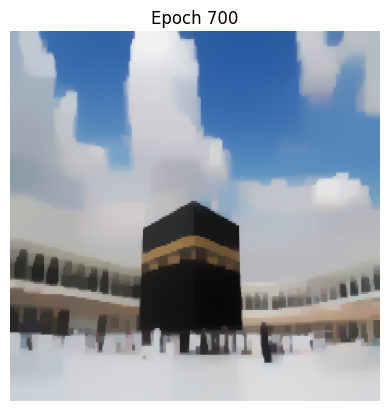

 47%|████▋     | 701/1500 [07:25<09:56,  1.34it/s]

Inside compute_loss:
Content Loss: 1.8738306607701816e-05, Style Loss: 4.013161742477678e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 702/1500 [07:26<08:39,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8754615666694008e-05, Style Loss: 4.0142081161320675e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 703/1500 [07:26<08:38,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8770933820633218e-05, Style Loss: 4.015331342088757e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 704/1500 [07:27<08:33,  1.55it/s]

Inside compute_loss:
Content Loss: 1.878697548818309e-05, Style Loss: 4.016372713522287e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 705/1500 [07:28<08:34,  1.54it/s]

Inside compute_loss:
Content Loss: 1.880327363323886e-05, Style Loss: 4.017402261524694e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 706/1500 [07:28<08:36,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8819626347976737e-05, Style Loss: 4.018512754555559e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 707/1500 [07:29<08:24,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8835917217074893e-05, Style Loss: 4.019556399725843e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 708/1500 [07:29<08:21,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8852144421543926e-05, Style Loss: 4.020630058221286e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 709/1500 [07:30<08:20,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8868338884203695e-05, Style Loss: 4.0216418710770085e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 711/1500 [07:31<08:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8884256860474125e-05, Style Loss: 4.022697339678416e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8900196664617397e-05, Style Loss: 4.023776000394719e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 713/1500 [07:33<08:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8916038243332878e-05, Style Loss: 4.0248505683848634e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8932165403384715e-05, Style Loss: 4.025945145258447e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 714/1500 [07:33<08:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.894838351290673e-05, Style Loss: 4.027024715469452e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 716/1500 [07:34<08:10,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8964548871736042e-05, Style Loss: 4.028135663247667e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8980555978487246e-05, Style Loss: 4.0291679397341795e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 717/1500 [07:35<08:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8996550352312624e-05, Style Loss: 4.0302056731889024e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 718/1500 [07:36<08:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9012501070392318e-05, Style Loss: 4.031220669276081e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 719/1500 [07:36<08:12,  1.59it/s]

Inside compute_loss:
Content Loss: 1.902842450363096e-05, Style Loss: 4.032280685350997e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 720/1500 [07:37<08:12,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9044280634261668e-05, Style Loss: 4.033301138406387e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 722/1500 [07:38<08:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9059949408983812e-05, Style Loss: 4.0342911233892664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.907556361402385e-05, Style Loss: 4.035309757455252e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 723/1500 [07:39<08:22,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9091039575869218e-05, Style Loss: 4.036358404846396e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 724/1500 [07:40<08:18,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9106504623778164e-05, Style Loss: 4.0373788579017855e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 725/1500 [07:40<08:17,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9121875084238127e-05, Style Loss: 4.038410224893596e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 726/1500 [07:41<08:24,  1.53it/s]

Inside compute_loss:
Content Loss: 1.913738378789276e-05, Style Loss: 4.0393492781731766e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 727/1500 [07:41<08:14,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9152916138409637e-05, Style Loss: 4.040364274260355e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 728/1500 [07:42<08:17,  1.55it/s]

Inside compute_loss:
Content Loss: 1.916850305860862e-05, Style Loss: 4.041437478008447e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 729/1500 [07:43<08:20,  1.54it/s]

Inside compute_loss:
Content Loss: 1.9184213670087047e-05, Style Loss: 4.042448836116819e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 730/1500 [07:43<08:24,  1.53it/s]

Inside compute_loss:
Content Loss: 1.9199629605282098e-05, Style Loss: 4.0434829315927345e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 731/1500 [07:44<08:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9215165593777783e-05, Style Loss: 4.044499291921966e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 732/1500 [07:45<08:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.923086711030919e-05, Style Loss: 4.045563855470391e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 734/1500 [07:46<08:00,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9246386727900244e-05, Style Loss: 4.046564754389692e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 735/1500 [07:47<08:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9261788111180067e-05, Style Loss: 4.047530183015624e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.927697849168908e-05, Style Loss: 4.048519713251153e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 736/1500 [07:47<08:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9292041542939842e-05, Style Loss: 4.0495151552022435e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 738/1500 [07:48<08:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.93072046386078e-05, Style Loss: 4.0504764911020175e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.932253326231148e-05, Style Loss: 4.05152422899846e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 739/1500 [07:49<08:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.933791281771846e-05, Style Loss: 4.0524987525714096e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 741/1500 [07:50<07:59,  1.58it/s]

Inside compute_loss:
Content Loss: 1.935318323376123e-05, Style Loss: 4.053571501572151e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9368446373846382e-05, Style Loss: 4.054580585943768e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 742/1500 [07:51<07:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.938366585818585e-05, Style Loss: 4.055629688082263e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 743/1500 [07:52<08:08,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9399010852794163e-05, Style Loss: 4.056703801325057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 744/1500 [07:52<08:05,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9413919289945625e-05, Style Loss: 4.057661499246024e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 745/1500 [07:53<08:10,  1.54it/s]

Inside compute_loss:
Content Loss: 1.9428945961408317e-05, Style Loss: 4.05870105169015e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 746/1500 [07:54<08:11,  1.53it/s]

Inside compute_loss:
Content Loss: 1.944413270393852e-05, Style Loss: 4.059722868987592e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 747/1500 [07:54<07:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.945921394508332e-05, Style Loss: 4.0606937545817345e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 748/1500 [07:55<07:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9474226064630784e-05, Style Loss: 4.061732397531159e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 749/1500 [07:55<07:53,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9488750695018098e-05, Style Loss: 4.0625845940667205e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 750/1500 [07:56<07:53,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9503009752952494e-05, Style Loss: 4.063459073222475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 752/1500 [07:57<07:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9517445252859034e-05, Style Loss: 4.064372660650406e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.953198625415098e-05, Style Loss: 4.065253961016424e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 754/1500 [07:59<07:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9546465409803204e-05, Style Loss: 4.0662130231794436e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 755/1500 [07:59<07:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9560840883059427e-05, Style Loss: 4.067173904331867e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9575110854930244e-05, Style Loss: 4.068053385708481e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 756/1500 [08:00<07:51,  1.58it/s]

Inside compute_loss:
Content Loss: 1.958973371074535e-05, Style Loss: 4.069046553922817e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 757/1500 [08:00<07:49,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9604238332249224e-05, Style Loss: 4.069941041962011e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 758/1500 [08:01<07:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.961884117918089e-05, Style Loss: 4.070871000294574e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 759/1500 [08:02<07:51,  1.57it/s]

Inside compute_loss:
Content Loss: 1.9633218471426517e-05, Style Loss: 4.071835519425804e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 760/1500 [08:02<07:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9647795852506533e-05, Style Loss: 4.072816864209017e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 761/1500 [08:03<07:46,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9662351405713707e-05, Style Loss: 4.073754553246545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 762/1500 [08:04<07:51,  1.57it/s]

Inside compute_loss:
Content Loss: 1.9676919691846706e-05, Style Loss: 4.074751814187039e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 763/1500 [08:04<07:48,  1.57it/s]

Inside compute_loss:
Content Loss: 1.969146069313865e-05, Style Loss: 4.075692231708672e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 764/1500 [08:05<07:51,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9705748854903504e-05, Style Loss: 4.0766312849882524e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 765/1500 [08:06<07:55,  1.55it/s]

Inside compute_loss:
Content Loss: 1.971948404388968e-05, Style Loss: 4.0774521039566025e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 766/1500 [08:06<07:56,  1.54it/s]

Inside compute_loss:
Content Loss: 1.973356120288372e-05, Style Loss: 4.078398887941148e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 767/1500 [08:07<07:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.974786755454261e-05, Style Loss: 4.079291556990938e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 768/1500 [08:07<07:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9762321244343184e-05, Style Loss: 4.080246981175151e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 769/1500 [08:08<07:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.977676038222853e-05, Style Loss: 4.081210136064328e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 771/1500 [08:09<07:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9790813894360326e-05, Style Loss: 4.082136001670733e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9804660041700117e-05, Style Loss: 4.083000476384768e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 772/1500 [08:10<07:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9818469809251837e-05, Style Loss: 4.0838767745299265e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 773/1500 [08:11<07:35,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9832796169794165e-05, Style Loss: 4.084804913873086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 774/1500 [08:11<07:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9846896975650452e-05, Style Loss: 4.085701675649034e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 776/1500 [08:12<07:33,  1.60it/s]

Inside compute_loss:
Content Loss: 1.986093593586702e-05, Style Loss: 4.086542503500823e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.987530959013384e-05, Style Loss: 4.087471552338684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 777/1500 [08:13<07:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9889574105036445e-05, Style Loss: 4.0883824112825096e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 778/1500 [08:14<07:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.990376586036291e-05, Style Loss: 4.089305548404809e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 779/1500 [08:14<07:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9917830286431126e-05, Style Loss: 4.090190941496985e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 781/1500 [08:16<07:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9931803763029166e-05, Style Loss: 4.0910963434726e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.994578451558482e-05, Style Loss: 4.091977189091267e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 782/1500 [08:16<07:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.995948150579352e-05, Style Loss: 4.092878953088075e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 783/1500 [08:17<07:43,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9973025700892322e-05, Style Loss: 4.093730694876285e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 784/1500 [08:18<07:38,  1.56it/s]

Inside compute_loss:
Content Loss: 1.998687002924271e-05, Style Loss: 4.094603355042636e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 785/1500 [08:18<07:45,  1.54it/s]

Inside compute_loss:
Content Loss: 2.0000681615783833e-05, Style Loss: 4.0954719224828295e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 786/1500 [08:19<07:41,  1.55it/s]

Inside compute_loss:
Content Loss: 2.001443317567464e-05, Style Loss: 4.096350949112093e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 787/1500 [08:19<07:28,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0028383005410433e-05, Style Loss: 4.097279088455252e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 788/1500 [08:20<07:28,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0042474716319703e-05, Style Loss: 4.098196768609341e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 789/1500 [08:21<07:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0056615539942868e-05, Style Loss: 4.0991490095620975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 790/1500 [08:21<07:31,  1.57it/s]

Inside compute_loss:
Content Loss: 2.007050898100715e-05, Style Loss: 4.100038495380431e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 791/1500 [08:22<07:26,  1.59it/s]

Inside compute_loss:
Content Loss: 2.00842823687708e-05, Style Loss: 4.100880687474273e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 793/1500 [08:23<07:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0098108507227153e-05, Style Loss: 4.101783360965783e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0111945559619926e-05, Style Loss: 4.102688762941398e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 795/1500 [08:25<07:23,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0125718947383575e-05, Style Loss: 4.103543233213713e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0139550542808138e-05, Style Loss: 4.104424988327082e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 796/1500 [08:25<07:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0152938304818235e-05, Style Loss: 4.105246716790134e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 798/1500 [08:26<07:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0166300600976683e-05, Style Loss: 4.106102551304502e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.017988299485296e-05, Style Loss: 4.107048425794346e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 799/1500 [08:27<07:23,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0193756427033804e-05, Style Loss: 4.108054781681858e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 800/1500 [08:28<07:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.020733882091008e-05, Style Loss: 4.108972461835947e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 800, Loss: 1382.318604, Alpha: 10.0000, Beta: 10.0000


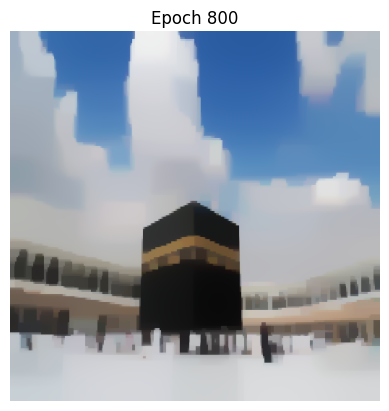

 53%|█████▎    | 801/1500 [08:29<08:43,  1.34it/s]

Inside compute_loss:
Content Loss: 2.0220797523506917e-05, Style Loss: 4.109826477360912e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 802/1500 [08:29<07:40,  1.52it/s]

Inside compute_loss:
Content Loss: 2.0233974282746203e-05, Style Loss: 4.110649115318665e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 803/1500 [08:30<07:36,  1.53it/s]

Inside compute_loss:
Content Loss: 2.02472583623603e-05, Style Loss: 4.111464022571454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 804/1500 [08:30<07:32,  1.54it/s]

Inside compute_loss:
Content Loss: 2.0260662495275028e-05, Style Loss: 4.112297574465629e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 805/1500 [08:31<07:33,  1.53it/s]

Inside compute_loss:
Content Loss: 2.027425762207713e-05, Style Loss: 4.113177965336945e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 806/1500 [08:32<07:30,  1.54it/s]

Inside compute_loss:
Content Loss: 2.0287716324673966e-05, Style Loss: 4.114025159651646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 807/1500 [08:32<07:17,  1.59it/s]

Inside compute_loss:
Content Loss: 2.030095856753178e-05, Style Loss: 4.114804596611066e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 809/1500 [08:34<07:14,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0314180801506154e-05, Style Loss: 4.115654519409873e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 810/1500 [08:34<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0327666788944043e-05, Style Loss: 4.116542186238803e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 811/1500 [08:35<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.034074168477673e-05, Style Loss: 4.1173734643962234e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.035345278272871e-05, Style Loss: 4.118182914680801e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 812/1500 [08:35<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0365783711895347e-05, Style Loss: 4.1189005060005e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 813/1500 [08:36<07:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0378291083034128e-05, Style Loss: 4.11969040214899e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 814/1500 [08:37<07:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.039106038864702e-05, Style Loss: 4.1204893932444975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 815/1500 [08:37<07:11,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0404389942996204e-05, Style Loss: 4.121347956242971e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 816/1500 [08:38<07:10,  1.59it/s]

Inside compute_loss:
Content Loss: 2.041749939962756e-05, Style Loss: 4.1222033360099886e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 818/1500 [08:39<07:08,  1.59it/s]

Inside compute_loss:
Content Loss: 2.043066888290923e-05, Style Loss: 4.123077815165743e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0443525500013493e-05, Style Loss: 4.12385588788311e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 819/1500 [08:40<07:11,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0456447600736283e-05, Style Loss: 4.124696260987548e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 820/1500 [08:41<07:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.04696407308802e-05, Style Loss: 4.125517079955898e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 821/1500 [08:41<07:08,  1.59it/s]

Inside compute_loss:
Content Loss: 2.04828247660771e-05, Style Loss: 4.126413841731846e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 822/1500 [08:42<07:14,  1.56it/s]

Inside compute_loss:
Content Loss: 2.049599243036937e-05, Style Loss: 4.127211923332652e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 823/1500 [08:42<07:12,  1.57it/s]

Inside compute_loss:
Content Loss: 2.0509092792053707e-05, Style Loss: 4.128076398046687e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 824/1500 [08:43<07:11,  1.57it/s]

Inside compute_loss:
Content Loss: 2.052228410320822e-05, Style Loss: 4.128974069317337e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 825/1500 [08:44<07:17,  1.54it/s]

Inside compute_loss:
Content Loss: 2.0535168005153537e-05, Style Loss: 4.1298098949482664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 826/1500 [08:44<07:15,  1.55it/s]

Inside compute_loss:
Content Loss: 2.0548026441247202e-05, Style Loss: 4.130651177547406e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 827/1500 [08:45<07:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.056063385680318e-05, Style Loss: 4.1314797272207215e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 828/1500 [08:46<07:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0573337678797543e-05, Style Loss: 4.1322527977172285e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 829/1500 [08:46<07:02,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0586208847817034e-05, Style Loss: 4.133039965381613e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 830/1500 [08:47<07:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.059943653875962e-05, Style Loss: 4.133909897063859e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 831/1500 [08:48<07:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0612429580069147e-05, Style Loss: 4.134765276830876e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 832/1500 [08:48<07:03,  1.58it/s]

Inside compute_loss:
Content Loss: 2.062512248812709e-05, Style Loss: 4.135550625505857e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 834/1500 [08:49<06:57,  1.60it/s]

Inside compute_loss:
Content Loss: 2.0637764464481734e-05, Style Loss: 4.136328698223224e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.065050466626417e-05, Style Loss: 4.137189080211101e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 835/1500 [08:50<06:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.066299202851951e-05, Style Loss: 4.13797351939138e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 836/1500 [08:51<06:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0675439373007976e-05, Style Loss: 4.138756139582256e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 837/1500 [08:51<06:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.068778849206865e-05, Style Loss: 4.139544216741342e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 838/1500 [08:52<06:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0700559616670944e-05, Style Loss: 4.140381406614324e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 839/1500 [08:53<06:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0713107005576603e-05, Style Loss: 4.14117448599427e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 841/1500 [08:54<06:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0725599824800156e-05, Style Loss: 4.142040324950358e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.073811810987536e-05, Style Loss: 4.14285204897169e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 842/1500 [08:54<06:58,  1.57it/s]

Inside compute_loss:
Content Loss: 2.075076918117702e-05, Style Loss: 4.143649221077794e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 843/1500 [08:55<07:01,  1.56it/s]

Inside compute_loss:
Content Loss: 2.076367672998458e-05, Style Loss: 4.1444768612564076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 844/1500 [08:56<07:01,  1.56it/s]

Inside compute_loss:
Content Loss: 2.0776322344318032e-05, Style Loss: 4.145326784055214e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 845/1500 [08:56<07:07,  1.53it/s]

Inside compute_loss:
Content Loss: 2.0788605979760177e-05, Style Loss: 4.14612486565602e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 846/1500 [08:57<07:04,  1.54it/s]

Inside compute_loss:
Content Loss: 2.0800967831746675e-05, Style Loss: 4.1468319977866486e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 848/1500 [08:58<06:51,  1.59it/s]

Inside compute_loss:
Content Loss: 2.08133951673517e-05, Style Loss: 4.147608706261963e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.082559331029188e-05, Style Loss: 4.148387688474031e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 849/1500 [08:59<06:51,  1.58it/s]

Inside compute_loss:
Content Loss: 2.083787512674462e-05, Style Loss: 4.149113465246046e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 850/1500 [09:00<06:51,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0850193322985433e-05, Style Loss: 4.14986971009057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 852/1500 [09:01<06:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0862566088908352e-05, Style Loss: 4.150615950493375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 853/1500 [09:01<06:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.087444590870291e-05, Style Loss: 4.151349003223004e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0886256606900133e-05, Style Loss: 4.1521034290781245e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 854/1500 [09:02<06:48,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0897934518870898e-05, Style Loss: 4.152799647272332e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 855/1500 [09:03<06:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0909830709570087e-05, Style Loss: 4.153533609496662e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 856/1500 [09:03<06:47,  1.58it/s]

Inside compute_loss:
Content Loss: 2.09219433600083e-05, Style Loss: 4.154238922637887e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 857/1500 [09:04<06:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.093407056236174e-05, Style Loss: 4.1550151763658505e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 858/1500 [09:05<06:47,  1.57it/s]

Inside compute_loss:
Content Loss: 2.094612136716023e-05, Style Loss: 4.155786427872954e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 860/1500 [09:06<06:41,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0958321329089813e-05, Style Loss: 4.156567229074426e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 861/1500 [09:07<06:41,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0970526747987606e-05, Style Loss: 4.157401690463303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 862/1500 [09:07<06:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.098227560054511e-05, Style Loss: 4.1581515688449144e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0994020815123804e-05, Style Loss: 4.158839146839455e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 863/1500 [09:08<06:51,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1005907910875976e-05, Style Loss: 4.159550371696241e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 864/1500 [09:08<06:44,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1017787730670534e-05, Style Loss: 4.160254775342764e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 865/1500 [09:09<06:51,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1029520212323405e-05, Style Loss: 4.161050128459465e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 866/1500 [09:10<06:57,  1.52it/s]

Inside compute_loss:
Content Loss: 2.104124905599747e-05, Style Loss: 4.1617558963480406e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 867/1500 [09:10<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1052836018498056e-05, Style Loss: 4.162552613706794e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 868/1500 [09:11<06:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.106455031025689e-05, Style Loss: 4.163288849667879e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 869/1500 [09:12<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1076366465422325e-05, Style Loss: 4.164004621998174e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 870/1500 [09:12<06:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1088082576170564e-05, Style Loss: 4.164731308264891e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 871/1500 [09:13<06:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.109962770191487e-05, Style Loss: 4.165417522017378e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 872/1500 [09:14<06:36,  1.58it/s]

Inside compute_loss:
Content Loss: 2.11109800147824e-05, Style Loss: 4.166156486462569e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 873/1500 [09:14<06:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.112251240760088e-05, Style Loss: 4.166868166066706e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 874/1500 [09:15<06:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1134037524461746e-05, Style Loss: 4.16766033595195e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 875/1500 [09:15<06:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1145349819562398e-05, Style Loss: 4.168268333160086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 876/1500 [09:16<06:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.115654388035182e-05, Style Loss: 4.168887244304642e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 877/1500 [09:17<06:34,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1168360035517253e-05, Style Loss: 4.169637577433605e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 878/1500 [09:17<06:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1180030671530403e-05, Style Loss: 4.170371084910585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 879/1500 [09:18<06:34,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1191546693444252e-05, Style Loss: 4.1710763980518095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 880/1500 [09:19<06:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1203073629294522e-05, Style Loss: 4.171752152615227e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 881/1500 [09:19<06:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1214524167589843e-05, Style Loss: 4.172515218670014e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 882/1500 [09:20<06:34,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1226098397164606e-05, Style Loss: 4.173240085947327e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 883/1500 [09:20<06:33,  1.57it/s]

Inside compute_loss:
Content Loss: 2.12376380659407e-05, Style Loss: 4.1739881453395355e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 884/1500 [09:21<06:36,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1249150449875742e-05, Style Loss: 4.174732112005586e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 885/1500 [09:22<06:38,  1.54it/s]

Inside compute_loss:
Content Loss: 2.126041908923071e-05, Style Loss: 4.175456069788197e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 886/1500 [09:22<06:31,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1271544028422795e-05, Style Loss: 4.1761031752685085e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 887/1500 [09:23<06:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1283174646669067e-05, Style Loss: 4.176853963144822e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 888/1500 [09:24<06:27,  1.58it/s]

Inside compute_loss:
Content Loss: 2.129459062416572e-05, Style Loss: 4.177598384558223e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 889/1500 [09:24<06:25,  1.58it/s]

Inside compute_loss:
Content Loss: 2.130601387761999e-05, Style Loss: 4.178298695478588e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 891/1500 [09:26<06:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1317173377610743e-05, Style Loss: 4.178977178526111e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 892/1500 [09:26<06:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1328198272385634e-05, Style Loss: 4.179672941972967e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 893/1500 [09:27<06:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.133944508386776e-05, Style Loss: 4.18046965933172e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1350473616621457e-05, Style Loss: 4.181080385023961e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 894/1500 [09:27<06:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1361696781241335e-05, Style Loss: 4.181767053523799e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 895/1500 [09:28<06:22,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1372814444475807e-05, Style Loss: 4.1824914660537615e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 896/1500 [09:29<06:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.138393756467849e-05, Style Loss: 4.183179044048302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 897/1500 [09:29<06:23,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1395142539404333e-05, Style Loss: 4.183864348306088e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 898/1500 [09:30<06:18,  1.59it/s]

Inside compute_loss:
Content Loss: 2.140601100109052e-05, Style Loss: 4.184580120636383e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 900/1500 [09:31<06:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1417135940282606e-05, Style Loss: 4.1852836147882044e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1428457330330275e-05, Style Loss: 4.185913439869182e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 900, Loss: 1271.657104, Alpha: 10.0000, Beta: 10.0000


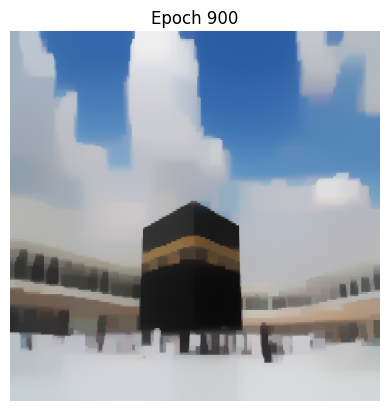

 60%|██████    | 901/1500 [09:32<07:27,  1.34it/s]

Inside compute_loss:
Content Loss: 2.1439298507175408e-05, Style Loss: 4.186602382105775e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 902/1500 [09:33<06:37,  1.50it/s]

Inside compute_loss:
Content Loss: 2.1449870473588817e-05, Style Loss: 4.187252670817543e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 903/1500 [09:33<06:28,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1460662537720054e-05, Style Loss: 4.187930244370364e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 904/1500 [09:34<06:26,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1471772924996912e-05, Style Loss: 4.188563252682798e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 905/1500 [09:35<06:25,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1482766896951944e-05, Style Loss: 4.18926219936111e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 907/1500 [09:36<06:14,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1493802705663256e-05, Style Loss: 4.189972969470546e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.150482941942755e-05, Style Loss: 4.190652816760121e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 909/1500 [09:37<06:12,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1516076230909675e-05, Style Loss: 4.191304469713941e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1526962882489897e-05, Style Loss: 4.1920529838535e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 911/1500 [09:38<06:09,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1537831344176084e-05, Style Loss: 4.19269917983911e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1548754375544377e-05, Style Loss: 4.1933417378459126e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 912/1500 [09:39<06:09,  1.59it/s]

Inside compute_loss:
Content Loss: 2.155958100047428e-05, Style Loss: 4.194107532384805e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 914/1500 [09:40<06:06,  1.60it/s]

Inside compute_loss:
Content Loss: 2.1570018361671828e-05, Style Loss: 4.1947400859498885e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 915/1500 [09:41<06:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1580626707873307e-05, Style Loss: 4.195355813862989e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 916/1500 [09:42<06:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.159123687306419e-05, Style Loss: 4.195984274701914e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.160195253964048e-05, Style Loss: 4.196687768853735e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 917/1500 [09:42<06:07,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1612375348922797e-05, Style Loss: 4.197351699986029e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 918/1500 [09:43<06:10,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1622981876134872e-05, Style Loss: 4.198049282422289e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 919/1500 [09:43<06:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1633715732605197e-05, Style Loss: 4.198681835987372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 920/1500 [09:44<06:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1644400476361625e-05, Style Loss: 4.199322575004771e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 921/1500 [09:45<06:07,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1655056116287597e-05, Style Loss: 4.199989234621171e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 922/1500 [09:45<06:14,  1.54it/s]

Inside compute_loss:
Content Loss: 2.166580998164136e-05, Style Loss: 4.200708644930273e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 923/1500 [09:46<06:11,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1676554752048105e-05, Style Loss: 4.201410774840042e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 924/1500 [09:47<06:12,  1.55it/s]

Inside compute_loss:
Content Loss: 2.168733590224292e-05, Style Loss: 4.202054697088897e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 925/1500 [09:47<06:14,  1.53it/s]

Inside compute_loss:
Content Loss: 2.1698111595469527e-05, Style Loss: 4.202744548820192e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 926/1500 [09:48<06:04,  1.58it/s]

Inside compute_loss:
Content Loss: 2.170882908103522e-05, Style Loss: 4.203463959129294e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 927/1500 [09:49<05:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1719088181271218e-05, Style Loss: 4.204097422189079e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 928/1500 [09:49<05:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1729223590227775e-05, Style Loss: 4.204699052934302e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 929/1500 [09:50<05:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.173949178541079e-05, Style Loss: 4.205355253361631e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 930/1500 [09:50<05:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1749896404799074e-05, Style Loss: 4.206012363283662e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 931/1500 [09:51<05:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.176046655222308e-05, Style Loss: 4.206630364933517e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 933/1500 [09:52<05:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1770907551399432e-05, Style Loss: 4.207214260532055e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 934/1500 [09:53<05:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.178093563998118e-05, Style Loss: 4.207822712487541e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 935/1500 [09:54<05:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1790889149997383e-05, Style Loss: 4.20838659920264e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 936/1500 [09:54<05:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1800877220812254e-05, Style Loss: 4.208976861264091e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 937/1500 [09:55<05:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1811158148921095e-05, Style Loss: 4.209590315440437e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1821135305799544e-05, Style Loss: 4.210169208818115e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 938/1500 [09:55<05:54,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1830974219483323e-05, Style Loss: 4.210811766824918e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 939/1500 [09:56<05:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1841189663973637e-05, Style Loss: 4.2114579628105275e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 940/1500 [09:57<05:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.185127232223749e-05, Style Loss: 4.212130079395138e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 941/1500 [09:57<05:53,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1861333152628504e-05, Style Loss: 4.212710337014869e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 942/1500 [09:58<06:00,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1871348508284427e-05, Style Loss: 4.213261490804143e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 943/1500 [09:59<05:54,  1.57it/s]

Inside compute_loss:
Content Loss: 2.188140933867544e-05, Style Loss: 4.2139254219364375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 944/1500 [09:59<06:00,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1891230062465183e-05, Style Loss: 4.214528871671064e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 945/1500 [10:00<05:56,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1901081709074788e-05, Style Loss: 4.215149147057673e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 947/1500 [10:01<05:49,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1911473595537245e-05, Style Loss: 4.215770786686335e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.192162355640903e-05, Style Loss: 4.216398792777909e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 948/1500 [10:02<05:50,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1931167793809436e-05, Style Loss: 4.216949946567183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 949/1500 [10:02<05:49,  1.58it/s]

Inside compute_loss:
Content Loss: 2.194073204009328e-05, Style Loss: 4.217575224174652e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 951/1500 [10:04<05:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1950467271381058e-05, Style Loss: 4.218106369080488e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1960237063467503e-05, Style Loss: 4.218694812152535e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 952/1500 [10:04<05:47,  1.58it/s]

Inside compute_loss:
Content Loss: 2.197007415816188e-05, Style Loss: 4.219347374601057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 954/1500 [10:06<05:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1979787561576813e-05, Style Loss: 4.2199376366625074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 955/1500 [10:06<05:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1989313609083183e-05, Style Loss: 4.220578830427257e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.199897608079482e-05, Style Loss: 4.22112907472183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 956/1500 [10:07<05:43,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2008613086654805e-05, Style Loss: 4.2217479858663864e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 957/1500 [10:07<05:43,  1.58it/s]

Inside compute_loss:
Content Loss: 2.201817369495984e-05, Style Loss: 4.222302322887117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 958/1500 [10:08<05:42,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2027836166671477e-05, Style Loss: 4.222868938086322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 959/1500 [10:09<05:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2037498638383113e-05, Style Loss: 4.223490577714983e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 960/1500 [10:09<05:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2046893718652427e-05, Style Loss: 4.224048552714521e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 961/1500 [10:10<05:47,  1.55it/s]

Inside compute_loss:
Content Loss: 2.205668897659052e-05, Style Loss: 4.224604708724655e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 962/1500 [10:11<05:44,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2066626115702093e-05, Style Loss: 4.225214979669545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 963/1500 [10:11<05:44,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2076483219279908e-05, Style Loss: 4.22581251768861e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 964/1500 [10:12<05:44,  1.56it/s]

Inside compute_loss:
Content Loss: 2.208613841503393e-05, Style Loss: 4.226490545988781e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 966/1500 [10:13<05:34,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2095953681855462e-05, Style Loss: 4.227056706440635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.210575621575117e-05, Style Loss: 4.22763878304977e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 967/1500 [10:14<05:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2115535102784634e-05, Style Loss: 4.228221314406255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 968/1500 [10:14<05:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.212495201092679e-05, Style Loss: 4.228845682519022e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 970/1500 [10:16<05:33,  1.59it/s]

Inside compute_loss:
Content Loss: 2.213459629274439e-05, Style Loss: 4.229462319926824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2144269678392448e-05, Style Loss: 4.230076683597872e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 971/1500 [10:16<05:33,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2153850295580924e-05, Style Loss: 4.230674221616937e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 973/1500 [10:18<05:29,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2163296307553537e-05, Style Loss: 4.231257207720773e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.21729733311804e-05, Style Loss: 4.231880666338839e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 974/1500 [10:18<05:35,  1.57it/s]

Inside compute_loss:
Content Loss: 2.218247391283512e-05, Style Loss: 4.232396804582095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 975/1500 [10:19<05:27,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2192145479493774e-05, Style Loss: 4.2330229916842654e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 976/1500 [10:19<05:27,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2201676983968355e-05, Style Loss: 4.233613708493067e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 977/1500 [10:20<05:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2211243049241602e-05, Style Loss: 4.234225343680009e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 978/1500 [10:21<05:30,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2220599930733442e-05, Style Loss: 4.234778771206038e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 980/1500 [10:22<05:25,  1.60it/s]

Inside compute_loss:
Content Loss: 2.22298640437657e-05, Style Loss: 4.235379492456559e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.223937372036744e-05, Style Loss: 4.235937012708746e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 981/1500 [10:23<05:32,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2248919776757248e-05, Style Loss: 4.2365595618321095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 982/1500 [10:23<05:30,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2258494936977513e-05, Style Loss: 4.237114353600191e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 983/1500 [10:24<05:28,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2267930035013705e-05, Style Loss: 4.237691427988466e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 984/1500 [10:25<05:37,  1.53it/s]

Inside compute_loss:
Content Loss: 2.2277634343481623e-05, Style Loss: 4.238258952682372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 985/1500 [10:25<05:32,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2287284082267433e-05, Style Loss: 4.238865585648455e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 986/1500 [10:26<05:23,  1.59it/s]

Inside compute_loss:
Content Loss: 2.229651545349043e-05, Style Loss: 4.239385816617869e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 987/1500 [10:26<05:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2305603124550544e-05, Style Loss: 4.239987447363092e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 988/1500 [10:27<05:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2314741727313958e-05, Style Loss: 4.240506314090453e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 989/1500 [10:28<05:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.23240476771025e-05, Style Loss: 4.2410215428390075e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 990/1500 [10:28<05:19,  1.60it/s]

Inside compute_loss:
Content Loss: 2.233326085843146e-05, Style Loss: 4.241555870976299e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 991/1500 [10:29<05:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.234230487374589e-05, Style Loss: 4.24207973992452e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 992/1500 [10:30<05:18,  1.59it/s]

Inside compute_loss:
Content Loss: 2.235173451481387e-05, Style Loss: 4.2426636355230585e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 994/1500 [10:31<05:17,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2361231458489783e-05, Style Loss: 4.243273906467948e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 995/1500 [10:32<05:17,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2370431906892918e-05, Style Loss: 4.243811417836696e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2379388610715978e-05, Style Loss: 4.244342562742531e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 997/1500 [10:33<05:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2388127035810612e-05, Style Loss: 4.244855517754331e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.239704190287739e-05, Style Loss: 4.2453748392290436e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 998/1500 [10:33<05:18,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2405996787711047e-05, Style Loss: 4.245933723723283e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 999/1500 [10:34<05:16,  1.58it/s]

Inside compute_loss:
Content Loss: 2.241533547930885e-05, Style Loss: 4.246508979122154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1000/1500 [10:35<05:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2424772396334447e-05, Style Loss: 4.247068773111096e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1000, Loss: 1183.338379, Alpha: 10.0000, Beta: 10.0000


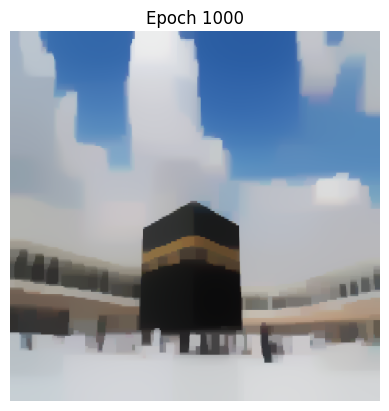

 67%|██████▋   | 1001/1500 [10:36<06:25,  1.29it/s]

Inside compute_loss:
Content Loss: 2.24341874854872e-05, Style Loss: 4.247638571541756e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1002/1500 [10:36<05:41,  1.46it/s]

Inside compute_loss:
Content Loss: 2.244283678010106e-05, Style Loss: 4.248137429385679e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1003/1500 [10:37<05:31,  1.50it/s]

Inside compute_loss:
Content Loss: 2.24515770241851e-05, Style Loss: 4.248605364409741e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1004/1500 [10:38<05:30,  1.50it/s]

Inside compute_loss:
Content Loss: 2.2460446416516788e-05, Style Loss: 4.249113771948032e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1005/1500 [10:38<05:22,  1.53it/s]

Inside compute_loss:
Content Loss: 2.2469035684480332e-05, Style Loss: 4.249647645337973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1006/1500 [10:39<05:15,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2477805032394826e-05, Style Loss: 4.2501255848037545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1007/1500 [10:39<05:13,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2487083697342314e-05, Style Loss: 4.250740857969504e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1008/1500 [10:40<05:12,  1.57it/s]

Inside compute_loss:
Content Loss: 2.249661338282749e-05, Style Loss: 4.251409336575307e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1010/1500 [10:41<05:09,  1.58it/s]

Inside compute_loss:
Content Loss: 2.250606303277891e-05, Style Loss: 4.251993686921196e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2515312593895942e-05, Style Loss: 4.252591679687612e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1011/1500 [10:42<05:09,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2524671294377185e-05, Style Loss: 4.253166935086483e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1012/1500 [10:43<05:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.25338608288439e-05, Style Loss: 4.253763108863495e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1013/1500 [10:43<05:06,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2542693841387518e-05, Style Loss: 4.254365194356069e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1014/1500 [10:44<05:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2551606889464892e-05, Style Loss: 4.254904979461571e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1015/1500 [10:44<05:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2560370780411176e-05, Style Loss: 4.25539701609523e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1016/1500 [10:45<05:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2568890926777385e-05, Style Loss: 4.255892690707697e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1017/1500 [10:46<05:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2577425625058822e-05, Style Loss: 4.25633561462746e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1018/1500 [10:46<05:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.258606400573626e-05, Style Loss: 4.256868123775348e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1019/1500 [10:47<05:03,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2595047994400375e-05, Style Loss: 4.257361069903709e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1020/1500 [10:48<05:03,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2603990146308206e-05, Style Loss: 4.257908130966825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1021/1500 [10:48<05:07,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2612724933424033e-05, Style Loss: 4.258439275872661e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1022/1500 [10:49<05:08,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2621350581175648e-05, Style Loss: 4.258947228663601e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1023/1500 [10:50<05:06,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2630178136751056e-05, Style Loss: 4.259447905496927e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1024/1500 [10:50<05:10,  1.53it/s]

Inside compute_loss:
Content Loss: 2.2638991140411235e-05, Style Loss: 4.25995722252992e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1025/1500 [10:51<05:08,  1.54it/s]

Inside compute_loss:
Content Loss: 2.2648031517746858e-05, Style Loss: 4.2604351619957015e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1026/1500 [10:51<04:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2656844521407038e-05, Style Loss: 4.26098313255352e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1027/1500 [10:52<04:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2665810320177115e-05, Style Loss: 4.261566573404707e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1028/1500 [10:53<04:58,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2674654246657155e-05, Style Loss: 4.262042239133734e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1029/1500 [10:53<04:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.268364369228948e-05, Style Loss: 4.262661605025642e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1030/1500 [10:54<04:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2692474885843694e-05, Style Loss: 4.263165465090424e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1031/1500 [10:55<04:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2701002308167517e-05, Style Loss: 4.263677965354873e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1032/1500 [10:55<04:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2709486074745655e-05, Style Loss: 4.264172730472637e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1033/1500 [10:56<04:56,  1.57it/s]

Inside compute_loss:
Content Loss: 2.271793164254632e-05, Style Loss: 4.264684321242385e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1034/1500 [10:57<04:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2726695533492602e-05, Style Loss: 4.265231837052852e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1035/1500 [10:57<04:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2735301172360778e-05, Style Loss: 4.265740244591143e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1036/1500 [10:58<05:01,  1.54it/s]

Inside compute_loss:
Content Loss: 2.274399776069913e-05, Style Loss: 4.266268206265522e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1037/1500 [10:58<04:58,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2752496079192497e-05, Style Loss: 4.2667397792683914e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1038/1500 [10:59<04:58,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2761558284400962e-05, Style Loss: 4.267362783139106e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1039/1500 [11:00<05:03,  1.52it/s]

Inside compute_loss:
Content Loss: 2.2770655050408095e-05, Style Loss: 4.267958502168767e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1040/1500 [11:00<04:47,  1.60it/s]

Inside compute_loss:
Content Loss: 2.277920430060476e-05, Style Loss: 4.268525117367972e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1041/1500 [11:01<04:52,  1.57it/s]

Inside compute_loss:
Content Loss: 2.278760621265974e-05, Style Loss: 4.269008059054613e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1042/1500 [11:02<04:52,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2796099074184895e-05, Style Loss: 4.269487817509798e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1043/1500 [11:02<04:51,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2804604668635875e-05, Style Loss: 4.26998622060637e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1044/1500 [11:03<04:55,  1.54it/s]

Inside compute_loss:
Content Loss: 2.2813104806118645e-05, Style Loss: 4.2704605220933445e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1045/1500 [11:04<04:55,  1.54it/s]

Inside compute_loss:
Content Loss: 2.2821501261205412e-05, Style Loss: 4.270950284990249e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1046/1500 [11:04<04:47,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2829883164376952e-05, Style Loss: 4.271437319403049e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1047/1500 [11:05<04:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.283810499648098e-05, Style Loss: 4.271947545930743e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1048/1500 [11:05<04:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.284606125613209e-05, Style Loss: 4.272393653081963e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1049/1500 [11:06<04:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2854072085465305e-05, Style Loss: 4.2728433982119896e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1050/1500 [11:07<04:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.286261587869376e-05, Style Loss: 4.2732849578897e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1051/1500 [11:07<04:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2871325199957937e-05, Style Loss: 4.27387976742466e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1052/1500 [11:08<04:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2879896278027445e-05, Style Loss: 4.274347702448722e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1053/1500 [11:09<04:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.28879271162441e-05, Style Loss: 4.274820184946293e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1054/1500 [11:09<04:42,  1.58it/s]

Inside compute_loss:
Content Loss: 2.289604708494153e-05, Style Loss: 4.275283572496846e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1055/1500 [11:10<04:41,  1.58it/s]

Inside compute_loss:
Content Loss: 2.290450174768921e-05, Style Loss: 4.275805167708313e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1056/1500 [11:11<04:43,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2913087377673946e-05, Style Loss: 4.276309027773095e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1057/1500 [11:11<04:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2921129129827023e-05, Style Loss: 4.276810614101123e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1058/1500 [11:12<04:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2929265469429083e-05, Style Loss: 4.2773258428496774e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1059/1500 [11:12<04:40,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2937694666325115e-05, Style Loss: 4.277853804524057e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1060/1500 [11:13<04:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.294615660503041e-05, Style Loss: 4.278310370864347e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1061/1500 [11:14<04:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.295432932442054e-05, Style Loss: 4.278756932762917e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1062/1500 [11:14<04:43,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2962769435252994e-05, Style Loss: 4.279239419702208e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1063/1500 [11:15<04:42,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2971291400608607e-05, Style Loss: 4.279694621800445e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1064/1500 [11:16<04:43,  1.54it/s]

Inside compute_loss:
Content Loss: 2.297971695952583e-05, Style Loss: 4.280178472981788e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1065/1500 [11:16<04:43,  1.53it/s]

Inside compute_loss:
Content Loss: 2.2988295313552953e-05, Style Loss: 4.2807182580872905e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1066/1500 [11:17<04:35,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2996877305558883e-05, Style Loss: 4.281243491277564e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1067/1500 [11:18<04:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.300537562405225e-05, Style Loss: 4.281793280824786e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1068/1500 [11:18<04:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3013484678813256e-05, Style Loss: 4.282244844944216e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1069/1500 [11:19<04:35,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3021464585326612e-05, Style Loss: 4.282665031496435e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1070/1500 [11:19<04:32,  1.58it/s]

Inside compute_loss:
Content Loss: 2.30297682719538e-05, Style Loss: 4.283114776626462e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1071/1500 [11:20<04:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3037850041873753e-05, Style Loss: 4.28358544013463e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1072/1500 [11:21<04:33,  1.57it/s]

Inside compute_loss:
Content Loss: 2.304599001945462e-05, Style Loss: 4.2840906644414645e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1073/1500 [11:21<04:30,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3053980839904398e-05, Style Loss: 4.284523583919508e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1074/1500 [11:22<04:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.306175883859396e-05, Style Loss: 4.284990154701518e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1075/1500 [11:23<04:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3069338567438535e-05, Style Loss: 4.285503109713318e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1076/1500 [11:23<04:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3076710931491107e-05, Style Loss: 4.285964223527117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1077/1500 [11:24<04:26,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3084416170604527e-05, Style Loss: 4.286398052499862e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1078/1500 [11:25<04:26,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3092223273124546e-05, Style Loss: 4.286847797629889e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1079/1500 [11:25<04:26,  1.58it/s]

Inside compute_loss:
Content Loss: 2.310029958607629e-05, Style Loss: 4.2873107304330915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1080/1500 [11:26<04:25,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3108592358767055e-05, Style Loss: 4.2878314161498565e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1081/1500 [11:26<04:28,  1.56it/s]

Inside compute_loss:
Content Loss: 2.311632124474272e-05, Style Loss: 4.288193849788513e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1082/1500 [11:27<04:32,  1.54it/s]

Inside compute_loss:
Content Loss: 2.312403557880316e-05, Style Loss: 4.288554009690415e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1083/1500 [11:28<04:28,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3131702619139105e-05, Style Loss: 4.288971013011178e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1084/1500 [11:28<04:32,  1.53it/s]

Inside compute_loss:
Content Loss: 2.3139300537877716e-05, Style Loss: 4.289406206225976e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1085/1500 [11:29<04:28,  1.54it/s]

Inside compute_loss:
Content Loss: 2.314710582140833e-05, Style Loss: 4.289918706490425e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1086/1500 [11:30<04:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3154860173235647e-05, Style Loss: 4.29038254878833e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1087/1500 [11:30<04:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3162827346823178e-05, Style Loss: 4.290842298360076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1088/1500 [11:31<04:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3170558051788248e-05, Style Loss: 4.2912479329970665e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1089/1500 [11:32<04:20,  1.58it/s]

Inside compute_loss:
Content Loss: 2.317840699106455e-05, Style Loss: 4.291667210054584e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1090/1500 [11:32<04:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.318633778486401e-05, Style Loss: 4.292079665901838e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1091/1500 [11:33<04:19,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3194263121695258e-05, Style Loss: 4.292586709198076e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1092/1500 [11:33<04:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3202288502943702e-05, Style Loss: 4.293059191695647e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1093/1500 [11:34<04:19,  1.57it/s]

Inside compute_loss:
Content Loss: 2.321023384865839e-05, Style Loss: 4.2934830162266735e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1094/1500 [11:35<04:16,  1.58it/s]

Inside compute_loss:
Content Loss: 2.321825195394922e-05, Style Loss: 4.293949587008683e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1095/1500 [11:35<04:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3226180928759277e-05, Style Loss: 4.294483005651273e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1096/1500 [11:36<04:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.323406260984484e-05, Style Loss: 4.294977770769037e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1097/1500 [11:37<04:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.324169508938212e-05, Style Loss: 4.295359758543782e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1098/1500 [11:37<04:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3249178411788307e-05, Style Loss: 4.295808594179107e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1099/1500 [11:38<04:15,  1.57it/s]

Inside compute_loss:
Content Loss: 2.325690002180636e-05, Style Loss: 4.296226052247221e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1100/1500 [11:39<04:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3264617993845604e-05, Style Loss: 4.296677616366651e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1100, Loss: 1110.684692, Alpha: 10.0000, Beta: 10.0000


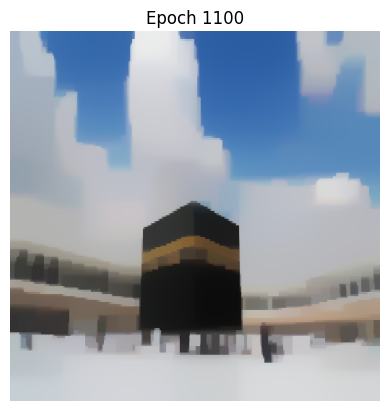

 73%|███████▎  | 1101/1500 [11:40<05:10,  1.29it/s]

Inside compute_loss:
Content Loss: 2.3272317775990814e-05, Style Loss: 4.297118721297011e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 73%|███████▎  | 1102/1500 [11:40<04:31,  1.47it/s]

Inside compute_loss:
Content Loss: 2.3280188543139957e-05, Style Loss: 4.297569375921739e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1103/1500 [11:41<04:29,  1.47it/s]

Inside compute_loss:
Content Loss: 2.328790105821099e-05, Style Loss: 4.298011845094152e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1104/1500 [11:41<04:23,  1.50it/s]

Inside compute_loss:
Content Loss: 2.3295828214031644e-05, Style Loss: 4.29850342698046e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1105/1500 [11:42<04:15,  1.55it/s]

Inside compute_loss:
Content Loss: 2.33037571888417e-05, Style Loss: 4.298970907257171e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▎  | 1106/1500 [11:43<04:12,  1.56it/s]

Inside compute_loss:
Content Loss: 2.331121504539624e-05, Style Loss: 4.29942656410276e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1107/1500 [11:43<04:11,  1.56it/s]

Inside compute_loss:
Content Loss: 2.331876748939976e-05, Style Loss: 4.299928605178138e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1108/1500 [11:44<04:10,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3326652808464132e-05, Style Loss: 4.300371074350551e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1109/1500 [11:45<04:09,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3334368961513974e-05, Style Loss: 4.300820364733227e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1110/1500 [11:45<04:08,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3342116037383676e-05, Style Loss: 4.3012651076423936e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1111/1500 [11:46<04:07,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3349877665168606e-05, Style Loss: 4.301697117625736e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1112/1500 [11:46<04:06,  1.57it/s]

Inside compute_loss:
Content Loss: 2.335776480322238e-05, Style Loss: 4.302156412450131e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1113/1500 [11:47<04:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3365579181700014e-05, Style Loss: 4.3025993363698944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1114/1500 [11:48<04:06,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3372822397504933e-05, Style Loss: 4.30295631304034e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1115/1500 [11:48<04:04,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3380220227409154e-05, Style Loss: 4.303326022636611e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1116/1500 [11:49<04:05,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3387709006783552e-05, Style Loss: 4.30376667281962e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 74%|███████▍  | 1117/1500 [11:50<04:05,  1.56it/s]

Inside compute_loss:
Content Loss: 2.339500679227058e-05, Style Loss: 4.304192771087401e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1118/1500 [11:50<04:02,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3402217266266234e-05, Style Loss: 4.3045779420936015e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1119/1500 [11:51<04:02,  1.57it/s]

Inside compute_loss:
Content Loss: 2.340941318834666e-05, Style Loss: 4.3049544729001354e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1120/1500 [11:52<04:02,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3416903786710463e-05, Style Loss: 4.3053428271377925e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1121/1500 [11:52<04:05,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3424610844813287e-05, Style Loss: 4.305826223571785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1122/1500 [11:53<04:04,  1.55it/s]

Inside compute_loss:
Content Loss: 2.343225605727639e-05, Style Loss: 4.306206392357126e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1123/1500 [11:54<04:07,  1.52it/s]

Inside compute_loss:
Content Loss: 2.343987398489844e-05, Style Loss: 4.306647042540135e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▍  | 1124/1500 [11:54<04:03,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3447320927516557e-05, Style Loss: 4.307023118599318e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1125/1500 [11:55<03:58,  1.57it/s]

Inside compute_loss:
Content Loss: 2.345479697396513e-05, Style Loss: 4.3075178837170824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1126/1500 [11:55<03:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3462043827748857e-05, Style Loss: 4.307936251279898e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1127/1500 [11:56<03:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.346894507354591e-05, Style Loss: 4.308324150770204e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1128/1500 [11:57<03:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3475897251046263e-05, Style Loss: 4.308740244596265e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1129/1500 [11:57<03:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.348340058233589e-05, Style Loss: 4.309213636588538e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1130/1500 [11:58<03:53,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3491025785915554e-05, Style Loss: 4.309671567170881e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1131/1500 [11:59<03:53,  1.58it/s]

Inside compute_loss:
Content Loss: 2.349862188566476e-05, Style Loss: 4.310059921408538e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 75%|███████▌  | 1132/1500 [11:59<03:52,  1.58it/s]

Inside compute_loss:
Content Loss: 2.350603426748421e-05, Style Loss: 4.310436452215072e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1133/1500 [12:00<03:52,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3513464839197695e-05, Style Loss: 4.3108743739139754e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1134/1500 [12:00<03:51,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3520908143837005e-05, Style Loss: 4.3113232095493e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1135/1500 [12:01<03:52,  1.57it/s]

Inside compute_loss:
Content Loss: 2.352831324969884e-05, Style Loss: 4.311685643187957e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1136/1500 [12:02<03:52,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3535547370556742e-05, Style Loss: 4.312066721468e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1137/1500 [12:02<03:50,  1.58it/s]

Inside compute_loss:
Content Loss: 2.354273783566896e-05, Style Loss: 4.312385954108322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1138/1500 [12:03<03:50,  1.57it/s]

Inside compute_loss:
Content Loss: 2.354990465391893e-05, Style Loss: 4.312782948545646e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1139/1500 [12:04<03:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.355742071813438e-05, Style Loss: 4.313216322771041e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1140/1500 [12:04<03:47,  1.58it/s]

Inside compute_loss:
Content Loss: 2.356483855692204e-05, Style Loss: 4.313667886890471e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1141/1500 [12:05<03:52,  1.54it/s]

Inside compute_loss:
Content Loss: 2.357204539293889e-05, Style Loss: 4.314105353842024e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1142/1500 [12:06<03:49,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3579239496029913e-05, Style Loss: 4.314515535952523e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▌  | 1143/1500 [12:06<03:51,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3586524548591115e-05, Style Loss: 4.314936631999444e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1144/1500 [12:07<03:53,  1.52it/s]

Inside compute_loss:
Content Loss: 2.359371865168214e-05, Style Loss: 4.315310889069224e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1145/1500 [12:08<03:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3600956410518847e-05, Style Loss: 4.315671503718477e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1146/1500 [12:08<03:44,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3608203264302574e-05, Style Loss: 4.316115791880293e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 76%|███████▋  | 1147/1500 [12:09<03:43,  1.58it/s]

Inside compute_loss:
Content Loss: 2.36157065955922e-05, Style Loss: 4.316566901252372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1148/1500 [12:09<03:42,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3622991648153402e-05, Style Loss: 4.316951162763871e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1149/1500 [12:10<03:41,  1.58it/s]

Inside compute_loss:
Content Loss: 2.363013663853053e-05, Style Loss: 4.317376806284301e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1150/1500 [12:11<03:41,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3637578124180436e-05, Style Loss: 4.317708317103097e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1151/1500 [12:11<03:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.364484862482641e-05, Style Loss: 4.318117589718895e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1152/1500 [12:12<03:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3652146410313435e-05, Style Loss: 4.318553692428395e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1153/1500 [12:13<03:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.365959335293155e-05, Style Loss: 4.318967057770351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1154/1500 [12:13<03:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.366677472309675e-05, Style Loss: 4.319430900068255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1155/1500 [12:14<03:40,  1.57it/s]

Inside compute_loss:
Content Loss: 2.367391971347388e-05, Style Loss: 4.319812887843e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1156/1500 [12:14<03:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3681341190240346e-05, Style Loss: 4.320185780670727e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1157/1500 [12:15<03:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3688926376053132e-05, Style Loss: 4.320617335906718e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1158/1500 [12:16<03:37,  1.57it/s]

Inside compute_loss:
Content Loss: 2.369652247580234e-05, Style Loss: 4.321026153775165e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1159/1500 [12:16<03:37,  1.57it/s]

Inside compute_loss:
Content Loss: 2.370382753724698e-05, Style Loss: 4.321434516896261e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1160/1500 [12:17<03:34,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3711001631454565e-05, Style Loss: 4.321849246480269e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1161/1500 [12:18<03:40,  1.54it/s]

Inside compute_loss:
Content Loss: 2.371774462517351e-05, Style Loss: 4.322188488004031e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 77%|███████▋  | 1162/1500 [12:18<03:37,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3724836864857934e-05, Style Loss: 4.32262413596618e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1163/1500 [12:19<03:40,  1.53it/s]

Inside compute_loss:
Content Loss: 2.3731887267786078e-05, Style Loss: 4.323033863329329e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1164/1500 [12:20<03:38,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3738708478049375e-05, Style Loss: 4.323400389694143e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1165/1500 [12:20<03:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3745866201352328e-05, Style Loss: 4.323802841099678e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1166/1500 [12:21<03:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3753234927426092e-05, Style Loss: 4.324205747252563e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1167/1500 [12:21<03:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.376066731812898e-05, Style Loss: 4.3245922825008165e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1168/1500 [12:22<03:29,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3767875973135233e-05, Style Loss: 4.324999736127211e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1169/1500 [12:23<03:30,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3775084628141485e-05, Style Loss: 4.325420832174132e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1170/1500 [12:23<03:29,  1.58it/s]

Inside compute_loss:
Content Loss: 2.378239696554374e-05, Style Loss: 4.325932422943879e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1171/1500 [12:24<03:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.378978388151154e-05, Style Loss: 4.326327143644448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1172/1500 [12:25<03:29,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3796985260560177e-05, Style Loss: 4.3267350520181935e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1173/1500 [12:25<03:26,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3804139345884323e-05, Style Loss: 4.327152055338956e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1174/1500 [12:26<03:25,  1.58it/s]

Inside compute_loss:
Content Loss: 2.381093509029597e-05, Style Loss: 4.327576789364684e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1175/1500 [12:27<03:25,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3817468900233507e-05, Style Loss: 4.327921487856656e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1176/1500 [12:27<03:25,  1.58it/s]

Inside compute_loss:
Content Loss: 2.382389357080683e-05, Style Loss: 4.328234808781417e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 78%|███████▊  | 1177/1500 [12:28<03:24,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3830487407394685e-05, Style Loss: 4.3286177060508635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1178/1500 [12:28<03:23,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3837144908611663e-05, Style Loss: 4.328979684942169e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1179/1500 [12:29<03:24,  1.57it/s]

Inside compute_loss:
Content Loss: 2.384379149589222e-05, Style Loss: 4.329345301812282e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1180/1500 [12:30<03:24,  1.56it/s]

Inside compute_loss:
Content Loss: 2.385039442742709e-05, Style Loss: 4.329725015850272e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▊  | 1181/1500 [12:30<03:27,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3857348423916847e-05, Style Loss: 4.330119281803491e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1182/1500 [12:31<03:27,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3864646209403872e-05, Style Loss: 4.330560841481201e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1183/1500 [12:32<03:26,  1.53it/s]

Inside compute_loss:
Content Loss: 2.3871833036537282e-05, Style Loss: 4.330996489443351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1184/1500 [12:32<03:28,  1.52it/s]

Inside compute_loss:
Content Loss: 2.3878683350631036e-05, Style Loss: 4.331322543293936e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1185/1500 [12:33<03:19,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3885591872385703e-05, Style Loss: 4.331746367824962e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1186/1500 [12:34<03:19,  1.58it/s]

Inside compute_loss:
Content Loss: 2.389238215982914e-05, Style Loss: 4.332137450546725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1187/1500 [12:34<03:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.38992361119017e-05, Style Loss: 4.332498065195978e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1188/1500 [12:35<03:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3906139176688157e-05, Style Loss: 4.332852768129669e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1189/1500 [12:36<03:16,  1.58it/s]

Inside compute_loss:
Content Loss: 2.391285488556605e-05, Style Loss: 4.33320701631601e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1190/1500 [12:36<03:16,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3919521481730044e-05, Style Loss: 4.333630840847036e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 79%|███████▉  | 1192/1500 [12:37<03:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3926288122311234e-05, Style Loss: 4.333998731453903e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3933020202093758e-05, Style Loss: 4.334383902460104e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1193/1500 [12:38<03:14,  1.58it/s]

Inside compute_loss:
Content Loss: 2.393988506810274e-05, Style Loss: 4.334728146204725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1194/1500 [12:39<03:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.394690818618983e-05, Style Loss: 4.335050562076503e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1195/1500 [12:39<03:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.395406954747159e-05, Style Loss: 4.3354466470191255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1197/1500 [12:41<03:10,  1.59it/s]

Inside compute_loss:
Content Loss: 2.396052332187537e-05, Style Loss: 4.335791800258448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3966871594893746e-05, Style Loss: 4.336203346611001e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1198/1500 [12:41<03:10,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3973292627488263e-05, Style Loss: 4.336570327723166e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|███████▉  | 1199/1500 [12:42<03:10,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3979717298061587e-05, Style Loss: 4.336949132266454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1200/1500 [12:43<03:14,  1.55it/s]

Inside compute_loss:
Content Loss: 2.398638207523618e-05, Style Loss: 4.337335212767357e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1200, Loss: 1048.634277, Alpha: 10.0000, Beta: 10.0000


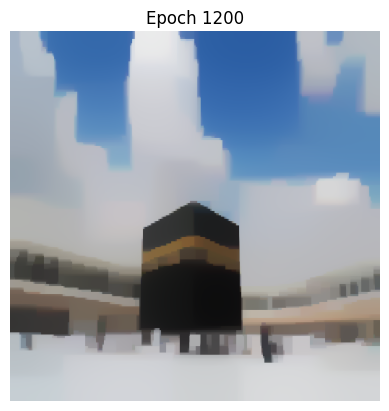

 80%|████████  | 1201/1500 [12:44<03:47,  1.32it/s]

Inside compute_loss:
Content Loss: 2.399292861809954e-05, Style Loss: 4.337612153904047e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1202/1500 [12:44<03:21,  1.48it/s]

Inside compute_loss:
Content Loss: 2.3999724362511188e-05, Style Loss: 4.337964128353633e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1203/1500 [12:45<03:18,  1.49it/s]

Inside compute_loss:
Content Loss: 2.40062454395229e-05, Style Loss: 4.338329290476395e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1204/1500 [12:45<03:14,  1.52it/s]

Inside compute_loss:
Content Loss: 2.401272467977833e-05, Style Loss: 4.338667622505454e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1205/1500 [12:46<03:10,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4019269403652288e-05, Style Loss: 4.338953203841811e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1206/1500 [12:47<03:09,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4025712264119647e-05, Style Loss: 4.339284714660607e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 80%|████████  | 1207/1500 [12:47<03:07,  1.56it/s]

Inside compute_loss:
Content Loss: 2.4032144210650586e-05, Style Loss: 4.3396526052674744e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1208/1500 [12:48<03:06,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4038739866227843e-05, Style Loss: 4.340010036685271e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1209/1500 [12:48<03:05,  1.57it/s]

Inside compute_loss:
Content Loss: 2.404546285106335e-05, Style Loss: 4.340376563050086e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1210/1500 [12:49<03:04,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4052098524407484e-05, Style Loss: 4.340718987805303e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1211/1500 [12:50<03:03,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4058732378762215e-05, Style Loss: 4.341187377576716e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1212/1500 [12:50<03:03,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4065780962700956e-05, Style Loss: 4.341588009992847e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1213/1500 [12:51<03:02,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4072767700999975e-05, Style Loss: 4.3420077417977154e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1215/1500 [12:52<02:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4079266950138845e-05, Style Loss: 4.342336978879757e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.4086131816147827e-05, Style Loss: 4.342640750110149e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1216/1500 [12:53<02:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4092711100820452e-05, Style Loss: 4.342961801739875e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1217/1500 [12:54<02:59,  1.57it/s]

Inside compute_loss:
Content Loss: 2.409923035884276e-05, Style Loss: 4.34335925092455e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████  | 1218/1500 [12:54<02:58,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4105584088829346e-05, Style Loss: 4.3436893975012936e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1219/1500 [12:55<02:57,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4111863240250386e-05, Style Loss: 4.344063654571073e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1220/1500 [12:55<03:00,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4118553483276628e-05, Style Loss: 4.34440562457894e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1221/1500 [12:56<03:00,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4125045456457883e-05, Style Loss: 4.3447548705444206e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 81%|████████▏ | 1222/1500 [12:57<02:59,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4131419195327908e-05, Style Loss: 4.345080014900304e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1223/1500 [12:57<02:59,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4137962100212462e-05, Style Loss: 4.34544699601247e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1224/1500 [12:58<02:58,  1.55it/s]

Inside compute_loss:
Content Loss: 2.414463051536586e-05, Style Loss: 4.345827164797811e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1225/1500 [12:59<02:54,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4150844183168374e-05, Style Loss: 4.346171863289783e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1226/1500 [12:59<02:54,  1.57it/s]

Inside compute_loss:
Content Loss: 2.415710514469538e-05, Style Loss: 4.346476998762228e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1227/1500 [13:00<02:53,  1.57it/s]

Inside compute_loss:
Content Loss: 2.416351890133228e-05, Style Loss: 4.346834884927375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1228/1500 [13:01<02:52,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4170039978343993e-05, Style Loss: 4.347238700574962e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1229/1500 [13:01<02:51,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4176382794394158e-05, Style Loss: 4.347603862697724e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1230/1500 [13:02<02:51,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4182612833101302e-05, Style Loss: 4.347866706666537e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1231/1500 [13:02<02:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.41890757024521e-05, Style Loss: 4.3482159526320174e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1232/1500 [13:03<02:49,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4195649530156516e-05, Style Loss: 4.34862749898457e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1233/1500 [13:04<02:48,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4202066924772225e-05, Style Loss: 4.348969014245085e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1234/1500 [13:04<02:48,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4208704417105764e-05, Style Loss: 4.349378286860883e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1235/1500 [13:05<02:48,  1.58it/s]

Inside compute_loss:
Content Loss: 2.421515091555193e-05, Style Loss: 4.349805294623366e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1236/1500 [13:06<02:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4221479179686867e-05, Style Loss: 4.350195922597777e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 82%|████████▏ | 1237/1500 [13:06<02:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.422772377030924e-05, Style Loss: 4.35050515079638e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1238/1500 [13:07<02:45,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4234419470303692e-05, Style Loss: 4.35080801253207e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1239/1500 [13:08<02:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4240935090347193e-05, Style Loss: 4.351145435066428e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1240/1500 [13:08<02:48,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4247221517725848e-05, Style Loss: 4.351516508904751e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1241/1500 [13:09<02:47,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4253145966213197e-05, Style Loss: 4.351833467808319e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1242/1500 [13:09<02:46,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4259095880552195e-05, Style Loss: 4.352154974185396e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1243/1500 [13:10<02:47,  1.53it/s]

Inside compute_loss:
Content Loss: 2.4265338652185164e-05, Style Loss: 4.352451469458174e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1244/1500 [13:11<02:46,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4271992515423335e-05, Style Loss: 4.3528457354113925e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1245/1500 [13:11<02:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.427861181786284e-05, Style Loss: 4.353217263997067e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1246/1500 [13:12<02:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4285058316309005e-05, Style Loss: 4.353548320068512e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1247/1500 [13:13<02:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4291946829180233e-05, Style Loss: 4.353910298959818e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1248/1500 [13:13<02:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4298664357047528e-05, Style Loss: 4.354296834208071e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1249/1500 [13:14<02:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.430492895655334e-05, Style Loss: 4.354636530479183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1250/1500 [13:15<02:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4310904336743988e-05, Style Loss: 4.354943484941032e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1251/1500 [13:15<02:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.431687607895583e-05, Style Loss: 4.355280452728039e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 83%|████████▎ | 1252/1500 [13:16<02:36,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4322920580743812e-05, Style Loss: 4.355624241725309e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1253/1500 [13:16<02:36,  1.58it/s]

Inside compute_loss:
Content Loss: 2.432878864055965e-05, Style Loss: 4.3559421101235785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1254/1500 [13:17<02:35,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4335080524906516e-05, Style Loss: 4.356284989626147e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1255/1500 [13:18<02:34,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4341352400369942e-05, Style Loss: 4.356634235591628e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▎ | 1256/1500 [13:18<02:35,  1.57it/s]

Inside compute_loss:
Content Loss: 2.434742054902017e-05, Style Loss: 4.35685069533065e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1257/1500 [13:19<02:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4353890694328584e-05, Style Loss: 4.357209490990499e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1258/1500 [13:20<02:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.436015165585559e-05, Style Loss: 4.3575760173553135e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1259/1500 [13:20<02:32,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4366314391954802e-05, Style Loss: 4.357961188361514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1260/1500 [13:21<02:33,  1.56it/s]

Inside compute_loss:
Content Loss: 2.4372706320718862e-05, Style Loss: 4.358319529274013e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1261/1500 [13:22<02:34,  1.55it/s]

Inside compute_loss:
Content Loss: 2.43788308580406e-05, Style Loss: 4.358660589787178e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1262/1500 [13:22<02:33,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4385002689086832e-05, Style Loss: 4.358960268291412e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1263/1500 [13:23<02:33,  1.54it/s]

Inside compute_loss:
Content Loss: 2.439121453789994e-05, Style Loss: 4.359329068392981e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1264/1500 [13:24<02:34,  1.53it/s]

Inside compute_loss:
Content Loss: 2.439769741613418e-05, Style Loss: 4.359709237178322e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1265/1500 [13:24<02:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4404296709690243e-05, Style Loss: 4.360133061709348e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1266/1500 [13:25<02:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4410483092651702e-05, Style Loss: 4.360505045042373e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 84%|████████▍ | 1267/1500 [13:25<02:27,  1.58it/s]

Inside compute_loss:
Content Loss: 2.441628930682782e-05, Style Loss: 4.360777893452905e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1268/1500 [13:26<02:26,  1.58it/s]

Inside compute_loss:
Content Loss: 2.442203003738541e-05, Style Loss: 4.361076207715087e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1270/1500 [13:27<02:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4428389224340208e-05, Style Loss: 4.361403625807725e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1271/1500 [13:28<02:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4434744773316197e-05, Style Loss: 4.3617574192467146e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.4440663764835335e-05, Style Loss: 4.362130766821792e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1272/1500 [13:29<02:24,  1.58it/s]

Inside compute_loss:
Content Loss: 2.444668825773988e-05, Style Loss: 4.362397703516763e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▍ | 1274/1500 [13:30<02:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4452796424156986e-05, Style Loss: 4.362736945040524e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.445851896482054e-05, Style Loss: 4.3630552681861445e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1275/1500 [13:30<02:22,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4464650778099895e-05, Style Loss: 4.363358584669186e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1276/1500 [13:31<02:22,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4470433345413767e-05, Style Loss: 4.363699645182351e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1277/1500 [13:32<02:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4475899408571422e-05, Style Loss: 4.363935659057461e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1278/1500 [13:32<02:20,  1.58it/s]

Inside compute_loss:
Content Loss: 2.448147461109329e-05, Style Loss: 4.364228516351432e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1279/1500 [13:33<02:20,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4487679183948785e-05, Style Loss: 4.364612777862931e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1280/1500 [13:34<02:21,  1.56it/s]

Inside compute_loss:
Content Loss: 2.4493556338711642e-05, Style Loss: 4.364968845038675e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1281/1500 [13:34<02:20,  1.56it/s]

Inside compute_loss:
Content Loss: 2.4499409846612252e-05, Style Loss: 4.365307177067734e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 85%|████████▌ | 1282/1500 [13:35<02:20,  1.55it/s]

Inside compute_loss:
Content Loss: 2.450503052386921e-05, Style Loss: 4.365624590718653e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1283/1500 [13:36<02:21,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4510789444320835e-05, Style Loss: 4.365892436908325e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1284/1500 [13:36<02:21,  1.53it/s]

Inside compute_loss:
Content Loss: 2.451670115988236e-05, Style Loss: 4.36619257015991e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1285/1500 [13:37<02:15,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4522558305761777e-05, Style Loss: 4.3665440898621455e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1286/1500 [13:37<02:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.452812077535782e-05, Style Loss: 4.366835582914064e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1287/1500 [13:38<02:14,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4534114345442504e-05, Style Loss: 4.367081146483542e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1288/1500 [13:39<02:14,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4540218873880804e-05, Style Loss: 4.367388100945391e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1289/1500 [13:39<02:14,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4546592612750828e-05, Style Loss: 4.367756446299609e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1290/1500 [13:40<02:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4552597096771933e-05, Style Loss: 4.3680579437932465e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1291/1500 [13:41<02:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4558399672969244e-05, Style Loss: 4.3683626245183405e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1292/1500 [13:41<02:11,  1.58it/s]

Inside compute_loss:
Content Loss: 2.456448601151351e-05, Style Loss: 4.368666395748733e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▌ | 1293/1500 [13:42<02:10,  1.58it/s]

Inside compute_loss:
Content Loss: 2.457059599692002e-05, Style Loss: 4.3690233724191785e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1294/1500 [13:43<02:10,  1.58it/s]

Inside compute_loss:
Content Loss: 2.457658229104709e-05, Style Loss: 4.369268935988657e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1295/1500 [13:43<02:10,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4582464902778156e-05, Style Loss: 4.369516318547539e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1296/1500 [13:44<02:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4588362066424452e-05, Style Loss: 4.3698446461348794e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 86%|████████▋ | 1297/1500 [13:44<02:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4594264687038958e-05, Style Loss: 4.37013750342885e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1298/1500 [13:45<02:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.460032374074217e-05, Style Loss: 4.370427177491365e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1299/1500 [13:46<02:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4606342776678503e-05, Style Loss: 4.3707736949727405e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1300/1500 [13:46<02:08,  1.56it/s]

Inside compute_loss:
Content Loss: 2.4612041670479812e-05, Style Loss: 4.371105205791537e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1300, Loss: 995.099365, Alpha: 10.0000, Beta: 10.0000


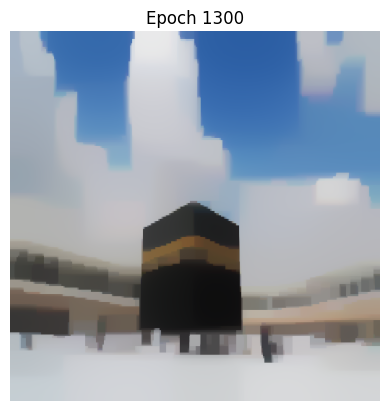

 87%|████████▋ | 1301/1500 [13:47<02:31,  1.32it/s]

Inside compute_loss:
Content Loss: 2.461767326167319e-05, Style Loss: 4.3714226194424555e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1302/1500 [13:48<02:13,  1.48it/s]

Inside compute_loss:
Content Loss: 2.462350676069036e-05, Style Loss: 4.3717391235986724e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1303/1500 [13:49<02:12,  1.49it/s]

Inside compute_loss:
Content Loss: 2.4629116524010897e-05, Style Loss: 4.371995601104572e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1304/1500 [13:49<02:10,  1.51it/s]

Inside compute_loss:
Content Loss: 2.4634369765408337e-05, Style Loss: 4.372304374555824e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1305/1500 [13:50<02:05,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4639883122290485e-05, Style Loss: 4.3725840441766195e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1306/1500 [13:50<02:04,  1.56it/s]

Inside compute_loss:
Content Loss: 2.4645640223752707e-05, Style Loss: 4.3728723539970815e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1307/1500 [13:51<02:02,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4651313651702367e-05, Style Loss: 4.373146111902315e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1308/1500 [13:52<02:02,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4657148969708942e-05, Style Loss: 4.373411229607882e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1309/1500 [13:52<02:01,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4663249860168435e-05, Style Loss: 4.3737654777942225e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1310/1500 [13:53<02:00,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4669227059348486e-05, Style Loss: 4.374096988613019e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1311/1500 [13:54<01:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.467511330905836e-05, Style Loss: 4.37447715739836e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 87%|████████▋ | 1312/1500 [13:54<01:58,  1.58it/s]

Inside compute_loss:
Content Loss: 2.468071033945307e-05, Style Loss: 4.3747909330704715e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1313/1500 [13:55<01:58,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4686012693564408e-05, Style Loss: 4.3750351323978975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1314/1500 [13:55<01:58,  1.57it/s]

Inside compute_loss:
Content Loss: 2.469157516316045e-05, Style Loss: 4.375281150714727e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1315/1500 [13:56<01:56,  1.58it/s]

Inside compute_loss:
Content Loss: 2.46971922024386e-05, Style Loss: 4.375542175694136e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1316/1500 [13:57<01:56,  1.58it/s]

Inside compute_loss:
Content Loss: 2.470270737831015e-05, Style Loss: 4.375830940261949e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1317/1500 [13:57<01:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.470820618327707e-05, Style Loss: 4.376125161797972e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1318/1500 [13:58<01:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.471363404765725e-05, Style Loss: 4.376430297270417e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1320/1500 [13:59<01:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.471974767104257e-05, Style Loss: 4.376799097371986e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.4726103220018558e-05, Style Loss: 4.377148343337467e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1321/1500 [14:00<01:55,  1.54it/s]

Inside compute_loss:
Content Loss: 2.473205495334696e-05, Style Loss: 4.377473942440702e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1322/1500 [14:01<01:54,  1.55it/s]

Inside compute_loss:
Content Loss: 2.4738006686675362e-05, Style Loss: 4.377777713671094e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1323/1500 [14:01<01:55,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4743842004681937e-05, Style Loss: 4.378056473797187e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1324/1500 [14:02<01:55,  1.53it/s]

Inside compute_loss:
Content Loss: 2.4749499061726965e-05, Style Loss: 4.378393441584194e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1325/1500 [14:02<01:50,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4755003323662095e-05, Style Loss: 4.378695393825183e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1326/1500 [14:03<01:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.476052031852305e-05, Style Loss: 4.3789486880996265e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 88%|████████▊ | 1327/1500 [14:04<01:50,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4766237402218394e-05, Style Loss: 4.379269284982001e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1328/1500 [14:04<01:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.477204725437332e-05, Style Loss: 4.379659003461711e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1329/1500 [14:05<01:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4777740691206418e-05, Style Loss: 4.379934580356348e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1330/1500 [14:06<01:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4783206754364073e-05, Style Loss: 4.380262907943688e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▊ | 1331/1500 [14:06<01:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4788625523797236e-05, Style Loss: 4.380537120596273e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1332/1500 [14:07<01:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4794077035039663e-05, Style Loss: 4.380892733024666e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1333/1500 [14:08<01:45,  1.58it/s]

Inside compute_loss:
Content Loss: 2.479955401213374e-05, Style Loss: 4.3811396608361974e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1334/1500 [14:08<01:44,  1.58it/s]

Inside compute_loss:
Content Loss: 2.480560215190053e-05, Style Loss: 4.3814397940877825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1336/1500 [14:09<01:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.481121919117868e-05, Style Loss: 4.381693543109577e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1337/1500 [14:10<01:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4816798031679355e-05, Style Loss: 4.381923190521775e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.4822184059303254e-05, Style Loss: 4.382242877909448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1338/1500 [14:11<01:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.482786112523172e-05, Style Loss: 4.382591214380227e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1339/1500 [14:11<01:41,  1.58it/s]

Inside compute_loss:
Content Loss: 2.483337993908208e-05, Style Loss: 4.382846327644074e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1340/1500 [14:12<01:41,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4839086108841002e-05, Style Loss: 4.38311599282315e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1341/1500 [14:13<01:42,  1.55it/s]

Inside compute_loss:
Content Loss: 2.484461583662778e-05, Style Loss: 4.383347913972102e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 89%|████████▉ | 1342/1500 [14:13<01:40,  1.57it/s]

Inside compute_loss:
Content Loss: 2.485012919350993e-05, Style Loss: 4.383599844004493e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1343/1500 [14:14<01:44,  1.50it/s]

Inside compute_loss:
Content Loss: 2.4855913579813205e-05, Style Loss: 4.383939540275605e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1344/1500 [14:15<01:43,  1.51it/s]

Inside compute_loss:
Content Loss: 2.4861519705154933e-05, Style Loss: 4.384231033327524e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1345/1500 [14:15<01:42,  1.52it/s]

Inside compute_loss:
Content Loss: 2.486744779162109e-05, Style Loss: 4.384558906167513e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1346/1500 [14:16<01:40,  1.53it/s]

Inside compute_loss:
Content Loss: 2.487318306521047e-05, Style Loss: 4.384919975564117e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1347/1500 [14:17<01:40,  1.53it/s]

Inside compute_loss:
Content Loss: 2.4878589101717807e-05, Style Loss: 4.385197371448157e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1348/1500 [14:17<01:39,  1.53it/s]

Inside compute_loss:
Content Loss: 2.4883998776203953e-05, Style Loss: 4.385534339235164e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|████████▉ | 1349/1500 [14:18<01:35,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4889428459573537e-05, Style Loss: 4.3858094613824505e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1350/1500 [14:18<01:35,  1.58it/s]

Inside compute_loss:
Content Loss: 2.489468351996038e-05, Style Loss: 4.386077307572123e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1351/1500 [14:19<01:34,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4899911295506172e-05, Style Loss: 4.38638380728662e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1352/1500 [14:20<01:33,  1.57it/s]

Inside compute_loss:
Content Loss: 2.490504994057119e-05, Style Loss: 4.386580258142203e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1353/1500 [14:20<01:32,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4910732463467866e-05, Style Loss: 4.386902674013982e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1354/1500 [14:21<01:32,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4916329493862577e-05, Style Loss: 4.387145054352004e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1355/1500 [14:22<01:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4921495423768647e-05, Style Loss: 4.387437911645975e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1356/1500 [14:22<01:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4926777768996544e-05, Style Loss: 4.387698936625384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 90%|█████████ | 1357/1500 [14:23<01:30,  1.58it/s]

Inside compute_loss:
Content Loss: 2.49320382863516e-05, Style Loss: 4.387979970488232e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1358/1500 [14:24<01:30,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4937437046901323e-05, Style Loss: 4.38818415204878e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1359/1500 [14:24<01:29,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4943054086179473e-05, Style Loss: 4.388491561257979e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1360/1500 [14:25<01:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.49487620749278e-05, Style Loss: 4.388807155919494e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1361/1500 [14:25<01:27,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4954324544523843e-05, Style Loss: 4.3891382119909395e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1362/1500 [14:26<01:29,  1.55it/s]

Inside compute_loss:
Content Loss: 2.495952503522858e-05, Style Loss: 4.389388323033927e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1363/1500 [14:27<01:29,  1.54it/s]

Inside compute_loss:
Content Loss: 2.496488014003262e-05, Style Loss: 4.389689820527565e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1364/1500 [14:27<01:28,  1.53it/s]

Inside compute_loss:
Content Loss: 2.4970306185423397e-05, Style Loss: 4.38995948570664e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1365/1500 [14:28<01:28,  1.53it/s]

Inside compute_loss:
Content Loss: 2.497578680049628e-05, Style Loss: 4.390222329675453e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1366/1500 [14:29<01:25,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4980981834232807e-05, Style Loss: 4.390434696688317e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1367/1500 [14:29<01:23,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4986386051750742e-05, Style Loss: 4.390741196402814e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████ | 1368/1500 [14:30<01:23,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4991821192088537e-05, Style Loss: 4.3910608837904874e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1369/1500 [14:31<01:22,  1.58it/s]

Inside compute_loss:
Content Loss: 2.499705442460254e-05, Style Loss: 4.3913933041039854e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1370/1500 [14:31<01:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5002520487760194e-05, Style Loss: 4.39166251453571e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1371/1500 [14:32<01:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5007821022882126e-05, Style Loss: 4.391963557281997e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 91%|█████████▏| 1372/1500 [14:32<01:20,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5012914193212055e-05, Style Loss: 4.392223672766704e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1373/1500 [14:33<01:20,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5018251108122058e-05, Style Loss: 4.392504706629552e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1374/1500 [14:34<01:19,  1.58it/s]

Inside compute_loss:
Content Loss: 2.502355164324399e-05, Style Loss: 4.392777100292733e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1375/1500 [14:34<01:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5028688469319604e-05, Style Loss: 4.393030394567177e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1376/1500 [14:35<01:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5033563360921107e-05, Style Loss: 4.393242761580041e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1377/1500 [14:36<01:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.50385874096537e-05, Style Loss: 4.393504696054151e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1378/1500 [14:36<01:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5043831556104124e-05, Style Loss: 4.393762083054753e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1379/1500 [14:37<01:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.504934491298627e-05, Style Loss: 4.394023562781513e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1380/1500 [14:38<01:15,  1.59it/s]

Inside compute_loss:
Content Loss: 2.50547454925254e-05, Style Loss: 4.394275947561255e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1381/1500 [14:38<01:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5060282496269792e-05, Style Loss: 4.394627922010841e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1382/1500 [14:39<01:16,  1.55it/s]

Inside compute_loss:
Content Loss: 2.5065624868148006e-05, Style Loss: 4.394836196297547e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1383/1500 [14:39<01:15,  1.56it/s]

Inside compute_loss:
Content Loss: 2.5070718038477935e-05, Style Loss: 4.395080395624973e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1384/1500 [14:40<01:15,  1.53it/s]

Inside compute_loss:
Content Loss: 2.5075489247683436e-05, Style Loss: 4.3953064050583635e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1386/1500 [14:41<01:11,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5080576961045153e-05, Style Loss: 4.395551968627842e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 92%|█████████▏| 1387/1500 [14:42<01:11,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5086037567234598e-05, Style Loss: 4.395902578835376e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.5091643692576326e-05, Style Loss: 4.396220901980996e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1388/1500 [14:43<01:10,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5097326215473004e-05, Style Loss: 4.3965360418951605e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1389/1500 [14:43<01:10,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5102532163145952e-05, Style Loss: 4.396813437779201e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1390/1500 [14:44<01:09,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5107097826548852e-05, Style Loss: 4.3970244405500125e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1391/1500 [14:45<01:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.511169259378221e-05, Style Loss: 4.3972167986794375e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1392/1500 [14:45<01:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5116753022302873e-05, Style Loss: 4.397466909722425e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1393/1500 [14:46<01:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.512155333533883e-05, Style Loss: 4.39772065874422e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1394/1500 [14:46<01:06,  1.59it/s]

Inside compute_loss:
Content Loss: 2.512648825359065e-05, Style Loss: 4.398002147354418e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1395/1500 [14:47<01:06,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5132154405582696e-05, Style Loss: 4.3983541218040045e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1396/1500 [14:48<01:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5137314878520556e-05, Style Loss: 4.398621513246326e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1397/1500 [14:48<01:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.51423134614015e-05, Style Loss: 4.398862529342296e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1398/1500 [14:49<01:04,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5147508495138027e-05, Style Loss: 4.399158115120372e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1399/1500 [14:50<01:04,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5152648959192447e-05, Style Loss: 4.399449153424939e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1400/1500 [14:50<01:03,  1.58it/s]

Inside compute_loss:
Content Loss: 2.515761116228532e-05, Style Loss: 4.399660610943101e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1400, Loss: 948.061768, Alpha: 10.0000, Beta: 10.0000


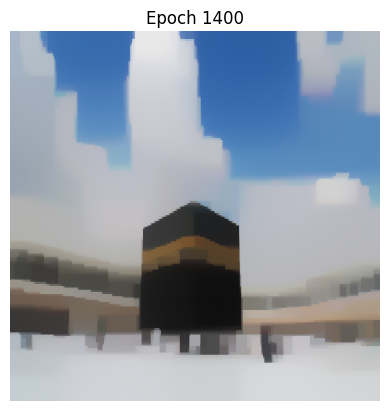

 93%|█████████▎| 1401/1500 [14:51<01:16,  1.29it/s]

Inside compute_loss:
Content Loss: 2.5162446036119945e-05, Style Loss: 4.399861609272193e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 93%|█████████▎| 1402/1500 [14:52<01:07,  1.46it/s]

Inside compute_loss:
Content Loss: 2.5167391868308187e-05, Style Loss: 4.400164016260533e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1403/1500 [14:52<01:05,  1.48it/s]

Inside compute_loss:
Content Loss: 2.5172657842631452e-05, Style Loss: 4.400470970722381e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1404/1500 [14:53<01:03,  1.51it/s]

Inside compute_loss:
Content Loss: 2.5177774659823626e-05, Style Loss: 4.400683337735245e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1405/1500 [14:54<01:03,  1.50it/s]

Inside compute_loss:
Content Loss: 2.5182976969517767e-05, Style Loss: 4.4009257180732675e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▎| 1406/1500 [14:54<01:00,  1.56it/s]

Inside compute_loss:
Content Loss: 2.5187977371388115e-05, Style Loss: 4.401196292747045e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1407/1500 [14:55<00:59,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5192703105858527e-05, Style Loss: 4.401495061756577e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1408/1500 [14:56<00:58,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5197596187354065e-05, Style Loss: 4.401773821882671e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1409/1500 [14:56<00:57,  1.57it/s]

Inside compute_loss:
Content Loss: 2.520255839044694e-05, Style Loss: 4.4020230234309565e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1410/1500 [14:57<00:57,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5207629732904024e-05, Style Loss: 4.402273589221295e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1411/1500 [14:58<00:56,  1.58it/s]

Inside compute_loss:
Content Loss: 2.521271198929753e-05, Style Loss: 4.402552349347388e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1412/1500 [14:58<00:55,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5217746951966546e-05, Style Loss: 4.402738341013901e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1413/1500 [14:59<00:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5222640033462085e-05, Style Loss: 4.4029761738784146e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1414/1500 [14:59<00:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5227462174370885e-05, Style Loss: 4.403262664709473e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1415/1500 [15:00<00:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5232448024326004e-05, Style Loss: 4.403528691909742e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1416/1500 [15:01<00:53,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5237328372895718e-05, Style Loss: 4.40385110778152e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 94%|█████████▍| 1417/1500 [15:01<00:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5242232368327677e-05, Style Loss: 4.40411258750828e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1418/1500 [15:02<00:51,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5247303710784763e-05, Style Loss: 4.404401352076093e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1419/1500 [15:03<00:50,  1.59it/s]

Inside compute_loss:
Content Loss: 2.525235504435841e-05, Style Loss: 4.404660103318747e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1420/1500 [15:03<00:50,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5257440938730724e-05, Style Loss: 4.404876108310418e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1421/1500 [15:04<00:50,  1.55it/s]

Inside compute_loss:
Content Loss: 2.526255411794409e-05, Style Loss: 4.4051912482245825e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1422/1500 [15:04<00:50,  1.55it/s]

Inside compute_loss:
Content Loss: 2.526745265640784e-05, Style Loss: 4.405388153827516e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1423/1500 [15:05<00:48,  1.57it/s]

Inside compute_loss:
Content Loss: 2.527228389226366e-05, Style Loss: 4.405610980029451e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▍| 1424/1500 [15:06<00:49,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5276987798861228e-05, Style Loss: 4.405877007229719e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1425/1500 [15:06<00:48,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5281648049713112e-05, Style Loss: 4.406081643537618e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1426/1500 [15:07<00:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5286026357207447e-05, Style Loss: 4.4062685446988326e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1427/1500 [15:08<00:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5290404664701782e-05, Style Loss: 4.4064768189855386e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1428/1500 [15:08<00:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.529522134864237e-05, Style Loss: 4.4067414819437545e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1429/1500 [15:09<00:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5300081688328646e-05, Style Loss: 4.407071173773147e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1430/1500 [15:10<00:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.530442907300312e-05, Style Loss: 4.407300366437994e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1431/1500 [15:10<00:43,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5308436306659132e-05, Style Loss: 4.407500455272384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 95%|█████████▌| 1432/1500 [15:11<00:42,  1.58it/s]

Inside compute_loss:
Content Loss: 2.531307291064877e-05, Style Loss: 4.4077428356104065e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1433/1500 [15:11<00:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.531754580559209e-05, Style Loss: 4.407986125443131e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1434/1500 [15:12<00:41,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5321887733298354e-05, Style Loss: 4.408153472468257e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1435/1500 [15:13<00:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5326511604362167e-05, Style Loss: 4.408425411384087e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1436/1500 [15:13<00:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5331517463200726e-05, Style Loss: 4.408655058796285e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1437/1500 [15:14<00:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5336325052194297e-05, Style Loss: 4.408944732858799e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1438/1500 [15:15<00:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5340783395222388e-05, Style Loss: 4.409238954394823e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1439/1500 [15:15<00:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5345245376229286e-05, Style Loss: 4.409456323628547e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1440/1500 [15:16<00:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5349780116812326e-05, Style Loss: 4.4096655074099544e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1441/1500 [15:16<00:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5354345780215226e-05, Style Loss: 4.409900611790363e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1442/1500 [15:17<00:37,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5358987841173075e-05, Style Loss: 4.410103429108858e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▌| 1443/1500 [15:18<00:36,  1.55it/s]

Inside compute_loss:
Content Loss: 2.5363528038724326e-05, Style Loss: 4.4103380787419155e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1444/1500 [15:18<00:36,  1.54it/s]

Inside compute_loss:
Content Loss: 2.536830106691923e-05, Style Loss: 4.410554083733587e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1445/1500 [15:19<00:35,  1.54it/s]

Inside compute_loss:
Content Loss: 2.537317959649954e-05, Style Loss: 4.410800102050416e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1446/1500 [15:20<00:34,  1.57it/s]

Inside compute_loss:
Content Loss: 2.537798718549311e-05, Style Loss: 4.41108431914472e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 96%|█████████▋| 1447/1500 [15:20<00:33,  1.57it/s]

Inside compute_loss:
Content Loss: 2.538271110097412e-05, Style Loss: 4.411313966556918e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1448/1500 [15:21<00:32,  1.58it/s]

Inside compute_loss:
Content Loss: 2.538737862778362e-05, Style Loss: 4.411485406308202e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1449/1500 [15:22<00:32,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5392044335603714e-05, Style Loss: 4.411697773321066e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1450/1500 [15:22<00:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5396564524271525e-05, Style Loss: 4.411953341332264e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1451/1500 [15:23<00:31,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5401232051081024e-05, Style Loss: 4.412122052599443e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1452/1500 [15:24<00:30,  1.58it/s]

Inside compute_loss:
Content Loss: 2.540561581554357e-05, Style Loss: 4.4123571569798514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1453/1500 [15:24<00:29,  1.58it/s]

Inside compute_loss:
Content Loss: 2.540991408750415e-05, Style Loss: 4.4126049942860845e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1454/1500 [15:25<00:29,  1.58it/s]

Inside compute_loss:
Content Loss: 2.541441972425673e-05, Style Loss: 4.412795078678755e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1455/1500 [15:25<00:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.541903086239472e-05, Style Loss: 4.412999714986654e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1456/1500 [15:26<00:27,  1.58it/s]

Inside compute_loss:
Content Loss: 2.542416586948093e-05, Style Loss: 4.413270744407782e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1457/1500 [15:27<00:27,  1.58it/s]

Inside compute_loss:
Content Loss: 2.542896254453808e-05, Style Loss: 4.413528586155735e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1458/1500 [15:27<00:26,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5433422706555575e-05, Style Loss: 4.413739134179195e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1459/1500 [15:28<00:25,  1.58it/s]

Inside compute_loss:
Content Loss: 2.543815935496241e-05, Style Loss: 4.414020168042043e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1460/1500 [15:29<00:25,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5442883270443417e-05, Style Loss: 4.4142793740320485e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1461/1500 [15:29<00:24,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5447305233683437e-05, Style Loss: 4.414518116391264e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 97%|█████████▋| 1462/1500 [15:30<00:24,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5451705369050615e-05, Style Loss: 4.414748673298163e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1463/1500 [15:31<00:23,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5455912691541016e-05, Style Loss: 4.414963314047782e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1464/1500 [15:31<00:23,  1.53it/s]

Inside compute_loss:
Content Loss: 2.5460312826908194e-05, Style Loss: 4.41515749116661e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1465/1500 [15:32<00:22,  1.55it/s]

Inside compute_loss:
Content Loss: 2.546523137425538e-05, Style Loss: 4.41545989815495e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1466/1500 [15:32<00:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.54700626101112e-05, Style Loss: 4.415679995872779e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1467/1500 [15:33<00:20,  1.59it/s]

Inside compute_loss:
Content Loss: 2.547476651670877e-05, Style Loss: 4.41593192590517e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1468/1500 [15:34<00:20,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5479535906924866e-05, Style Loss: 4.4161579353385605e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1470/1500 [15:35<00:18,  1.59it/s]

Inside compute_loss:
Content Loss: 2.548397606005892e-05, Style Loss: 4.416388037498109e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.5488208848400973e-05, Style Loss: 4.416583124111639e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1471/1500 [15:36<00:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5492825443507172e-05, Style Loss: 4.41682459495496e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1472/1500 [15:36<00:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5497756723780185e-05, Style Loss: 4.4170633373141754e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1473/1500 [15:37<00:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.550232420617249e-05, Style Loss: 4.417302989168093e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1474/1500 [15:37<00:16,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5506755264359526e-05, Style Loss: 4.417462150740903e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1475/1500 [15:38<00:15,  1.59it/s]

Inside compute_loss:
Content Loss: 2.55115646723425e-05, Style Loss: 4.417725904204417e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1476/1500 [15:39<00:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5516075766063295e-05, Style Loss: 4.417897798703052e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 98%|█████████▊| 1477/1500 [15:39<00:14,  1.59it/s]

Inside compute_loss:
Content Loss: 2.552062323957216e-05, Style Loss: 4.4181006160215475e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1478/1500 [15:40<00:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5525028831907548e-05, Style Loss: 4.4182816054672e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1479/1500 [15:41<00:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5529419872327708e-05, Style Loss: 4.418436219566502e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1480/1500 [15:41<00:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.553393460402731e-05, Style Loss: 4.418716343934648e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▊| 1481/1500 [15:42<00:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.553819831518922e-05, Style Loss: 4.4189296204422135e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1482/1500 [15:43<00:11,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5542767616570927e-05, Style Loss: 4.419160177349113e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1483/1500 [15:43<00:10,  1.55it/s]

Inside compute_loss:
Content Loss: 2.5547082259436138e-05, Style Loss: 4.4193620851729065e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1484/1500 [15:44<00:10,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5551549697411247e-05, Style Loss: 4.419569449964911e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1485/1500 [15:45<00:09,  1.54it/s]

Inside compute_loss:
Content Loss: 2.5556351829436608e-05, Style Loss: 4.419858214532724e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1486/1500 [15:45<00:08,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5561092115822248e-05, Style Loss: 4.420125605975045e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1487/1500 [15:46<00:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5565983378328383e-05, Style Loss: 4.420428012963384e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1488/1500 [15:46<00:07,  1.57it/s]

Inside compute_loss:
Content Loss: 2.5570525394869037e-05, Style Loss: 4.420593540999107e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1489/1500 [15:47<00:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5575274776201695e-05, Style Loss: 4.420870936883148e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1490/1500 [15:48<00:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.557997686380986e-05, Style Loss: 4.421136054588715e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1491/1500 [15:48<00:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5584056857042015e-05, Style Loss: 4.421342509886017e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 99%|█████████▉| 1492/1500 [15:49<00:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.5588828066247515e-05, Style Loss: 4.421623089001514e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1493/1500 [15:50<00:04,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5593415557523258e-05, Style Loss: 4.421845915203448e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1495/1500 [15:51<00:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5598266802262515e-05, Style Loss: 4.422119673108682e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.5602674213587306e-05, Style Loss: 4.422352958499687e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1496/1500 [15:51<00:02,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5607065254007466e-05, Style Loss: 4.4225262172403745e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1497/1500 [15:52<00:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5611429009586573e-05, Style Loss: 4.4227026592125185e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1498/1500 [15:53<00:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5615789127186872e-05, Style Loss: 4.422920937940944e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


100%|█████████▉| 1499/1500 [15:53<00:00,  1.58it/s]

Inside compute_loss:
Content Loss: 2.562051849963609e-05, Style Loss: 4.423239715833915e-06
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1499, Loss: 907.484619, Alpha: 10.0000, Beta: 10.0000


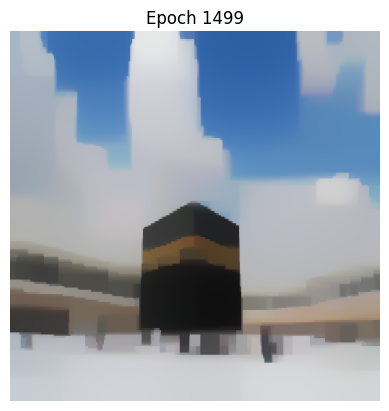

100%|██████████| 1500/1500 [15:54<00:00,  1.57it/s]


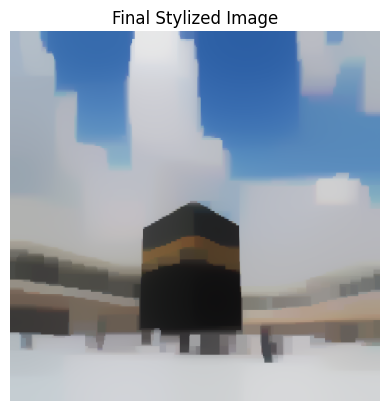

In [ ]:
# # Preprocess images
# content_image = preprocess_image("/content/images (1).jpg")
# style_image = preprocess_image("/content/images.jpg")

# # Train model dengan dynamic weighting
# output_image = train_nst(content_image, style_image, nst_model2, epochs=1500, lr=0.001)

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# tf.keras.preprocessing.image.save_img("/content/final_stylized_image.jpg", final_image)


  0%|          | 0/1500 [00:00<?, ?it/s]

Inside compute_loss:
Content Loss: 0.0, Style Loss: 1.9624267224571668e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


<ipython-input-13-a941beb22b1f>:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  loss_value = float(loss.numpy()) if isinstance(loss.numpy(), (np.ndarray, tf.Tensor)) else loss.numpy()


Epoch 0, Loss: 3626.616699, Alpha: 10.0000, Beta: 10.0000


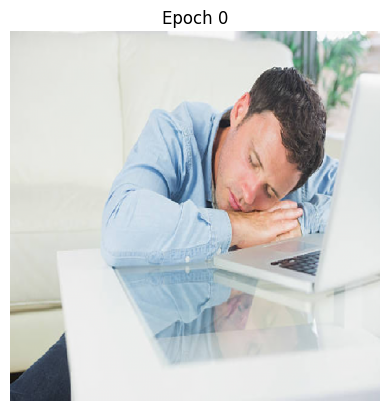

  0%|          | 1/1500 [00:00<21:40,  1.15it/s]

Inside compute_loss:
Content Loss: 9.658805977252882e-10, Style Loss: 1.9570841686800122e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 2/1500 [00:01<15:48,  1.58it/s]

Inside compute_loss:
Content Loss: 2.327765535881099e-09, Style Loss: 1.9573648387449794e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 3/1500 [00:02<16:13,  1.54it/s]

Inside compute_loss:
Content Loss: 4.6206918291602506e-09, Style Loss: 1.9540386347216554e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 4/1500 [00:02<16:13,  1.54it/s]

Inside compute_loss:
Content Loss: 7.895271991742447e-09, Style Loss: 1.949476427398622e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 5/1500 [00:03<15:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1902460350654565e-08, Style Loss: 1.9452834749245085e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 6/1500 [00:03<15:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6216132436852604e-08, Style Loss: 1.941966183949262e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  0%|          | 7/1500 [00:04<15:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0817632062630764e-08, Style Loss: 1.9390710804145783e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 8/1500 [00:05<15:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.5737177722362503e-08, Style Loss: 1.936348417075351e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 9/1500 [00:05<15:35,  1.59it/s]

Inside compute_loss:
Content Loss: 3.102490708783989e-08, Style Loss: 1.9336621335241944e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 10/1500 [00:06<15:35,  1.59it/s]

Inside compute_loss:
Content Loss: 3.6673583281299216e-08, Style Loss: 1.931022052303888e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 11/1500 [00:07<15:41,  1.58it/s]

Inside compute_loss:
Content Loss: 4.256589747342332e-08, Style Loss: 1.928521851368714e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 12/1500 [00:07<15:36,  1.59it/s]

Inside compute_loss:
Content Loss: 4.859782265498325e-08, Style Loss: 1.9262273781350814e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 13/1500 [00:08<15:38,  1.58it/s]

Inside compute_loss:
Content Loss: 5.475487796502421e-08, Style Loss: 1.9240635083406232e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 14/1500 [00:08<15:39,  1.58it/s]

Inside compute_loss:
Content Loss: 6.107402583666044e-08, Style Loss: 1.9219725800212473e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 15/1500 [00:09<15:39,  1.58it/s]

Inside compute_loss:
Content Loss: 6.761403881228034e-08, Style Loss: 1.9199022062821314e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 17/1500 [00:10<15:30,  1.59it/s]

Inside compute_loss:
Content Loss: 7.430266890651183e-08, Style Loss: 1.9178865841240622e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.113357097272456e-08, Style Loss: 1.9159147996106185e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|          | 18/1500 [00:11<15:32,  1.59it/s]

Inside compute_loss:
Content Loss: 8.807827356349662e-08, Style Loss: 1.9140259610139765e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 19/1500 [00:12<15:36,  1.58it/s]

Inside compute_loss:
Content Loss: 9.514493370943455e-08, Style Loss: 1.912172774609644e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 20/1500 [00:12<15:37,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0233907943302256e-07, Style Loss: 1.910342507471796e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 21/1500 [00:13<15:44,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0961656471408787e-07, Style Loss: 1.9085609892499633e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  1%|▏         | 22/1500 [00:13<15:41,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1692421963971356e-07, Style Loss: 1.90686132555129e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 23/1500 [00:14<15:57,  1.54it/s]

Inside compute_loss:
Content Loss: 1.243243872295352e-07, Style Loss: 1.9051927665714175e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 24/1500 [00:15<15:48,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3181528402128606e-07, Style Loss: 1.9035445802728646e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 25/1500 [00:15<15:33,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3936367793121462e-07, Style Loss: 1.9019409592146985e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 27/1500 [00:17<15:29,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4694792582758964e-07, Style Loss: 1.9003777197212912e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5458785185273882e-07, Style Loss: 1.898852497106418e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 29/1500 [00:18<15:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6227214416630886e-07, Style Loss: 1.8973445548908785e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 30/1500 [00:19<15:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.699596197113351e-07, Style Loss: 1.895884815894533e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7765084692200617e-07, Style Loss: 1.8944665498565882e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 31/1500 [00:19<15:27,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8539087420776923e-07, Style Loss: 1.8930642909253947e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 32/1500 [00:20<15:30,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9315712052048184e-07, Style Loss: 1.8916964108939283e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 33/1500 [00:20<15:27,  1.58it/s]

Inside compute_loss:
Content Loss: 2.009682731340945e-07, Style Loss: 1.8903643649537116e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 35/1500 [00:22<15:20,  1.59it/s]

Inside compute_loss:
Content Loss: 2.087915476067792e-07, Style Loss: 1.8890606952481903e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1661033144937392e-07, Style Loss: 1.887778489617631e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 36/1500 [00:22<15:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2442462466187862e-07, Style Loss: 1.8865188394556753e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  2%|▏         | 37/1500 [00:23<15:23,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3227119072544156e-07, Style Loss: 1.8852753782994114e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 38/1500 [00:24<15:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4011248456190515e-07, Style Loss: 1.884052653622348e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 39/1500 [00:24<15:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.479451381987019e-07, Style Loss: 1.8828648535418324e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 40/1500 [00:25<15:44,  1.55it/s]

Inside compute_loss:
Content Loss: 2.5577725182301947e-07, Style Loss: 1.8816999727278017e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 41/1500 [00:26<15:33,  1.56it/s]

Inside compute_loss:
Content Loss: 2.636017768509191e-07, Style Loss: 1.8805563740897924e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 42/1500 [00:26<15:44,  1.54it/s]

Inside compute_loss:
Content Loss: 2.7141805958308396e-07, Style Loss: 1.8794329662341624e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 43/1500 [00:27<15:42,  1.55it/s]

Inside compute_loss:
Content Loss: 2.7923496759285626e-07, Style Loss: 1.8783211999107152e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 44/1500 [00:27<15:27,  1.57it/s]

Inside compute_loss:
Content Loss: 2.870243349661905e-07, Style Loss: 1.877240174508188e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 45/1500 [00:28<15:24,  1.57it/s]

Inside compute_loss:
Content Loss: 2.9478425744855485e-07, Style Loss: 1.876181340776384e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 46/1500 [00:29<15:20,  1.58it/s]

Inside compute_loss:
Content Loss: 3.0253451654971286e-07, Style Loss: 1.8751381503534503e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 47/1500 [00:29<15:19,  1.58it/s]

Inside compute_loss:
Content Loss: 3.102489074535697e-07, Style Loss: 1.874103327281773e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 48/1500 [00:30<15:18,  1.58it/s]

Inside compute_loss:
Content Loss: 3.1793425137038867e-07, Style Loss: 1.8730956071522087e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 49/1500 [00:31<15:17,  1.58it/s]

Inside compute_loss:
Content Loss: 3.255595686368906e-07, Style Loss: 1.872117536549922e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 50/1500 [00:31<15:12,  1.59it/s]

Inside compute_loss:
Content Loss: 3.331443565457448e-07, Style Loss: 1.8711645680014044e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 51/1500 [00:32<15:13,  1.59it/s]

Inside compute_loss:
Content Loss: 3.407081123896205e-07, Style Loss: 1.8702103261603042e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  3%|▎         | 52/1500 [00:33<15:16,  1.58it/s]

Inside compute_loss:
Content Loss: 3.482779504793143e-07, Style Loss: 1.8692771845962852e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 53/1500 [00:33<15:17,  1.58it/s]

Inside compute_loss:
Content Loss: 3.558562866601278e-07, Style Loss: 1.8683473172131926e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 54/1500 [00:34<15:11,  1.59it/s]

Inside compute_loss:
Content Loss: 3.634064853486052e-07, Style Loss: 1.8674276361707598e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 55/1500 [00:34<15:11,  1.59it/s]

Inside compute_loss:
Content Loss: 3.709131135565258e-07, Style Loss: 1.866535603767261e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▎         | 56/1500 [00:35<15:08,  1.59it/s]

Inside compute_loss:
Content Loss: 3.7838242405996425e-07, Style Loss: 1.8656575775821693e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 57/1500 [00:36<15:08,  1.59it/s]

Inside compute_loss:
Content Loss: 3.8584016692766454e-07, Style Loss: 1.864781734184362e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 58/1500 [00:36<15:07,  1.59it/s]

Inside compute_loss:
Content Loss: 3.9329390233433514e-07, Style Loss: 1.8639335394254886e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 59/1500 [00:37<15:06,  1.59it/s]

Inside compute_loss:
Content Loss: 4.0072811202662706e-07, Style Loss: 1.863076613517478e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 60/1500 [00:38<15:28,  1.55it/s]

Inside compute_loss:
Content Loss: 4.080752376012242e-07, Style Loss: 1.8622482457431033e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 61/1500 [00:38<15:19,  1.57it/s]

Inside compute_loss:
Content Loss: 4.15352673144298e-07, Style Loss: 1.8614389773574658e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 62/1500 [00:39<15:26,  1.55it/s]

Inside compute_loss:
Content Loss: 4.2263320665369974e-07, Style Loss: 1.860635165940039e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 64/1500 [00:40<15:01,  1.59it/s]

Inside compute_loss:
Content Loss: 4.2993409010705363e-07, Style Loss: 1.8598348106024787e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.3724583065340994e-07, Style Loss: 1.859055191744119e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 66/1500 [00:41<15:00,  1.59it/s]

Inside compute_loss:
Content Loss: 4.4452681891016255e-07, Style Loss: 1.8582686607260257e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.517610250331927e-07, Style Loss: 1.8575128706288524e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  4%|▍         | 67/1500 [00:42<15:02,  1.59it/s]

Inside compute_loss:
Content Loss: 4.5893389710727206e-07, Style Loss: 1.856769267760683e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 68/1500 [00:43<15:02,  1.59it/s]

Inside compute_loss:
Content Loss: 4.661363846025779e-07, Style Loss: 1.8560313037596643e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 70/1500 [00:44<14:57,  1.59it/s]

Inside compute_loss:
Content Loss: 4.7334674491139594e-07, Style Loss: 1.8553029804024845e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 4.805112325811933e-07, Style Loss: 1.8545724742580205e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 71/1500 [00:45<15:03,  1.58it/s]

Inside compute_loss:
Content Loss: 4.876557113675517e-07, Style Loss: 1.8538470612838864e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 72/1500 [00:45<14:56,  1.59it/s]

Inside compute_loss:
Content Loss: 4.948028049511777e-07, Style Loss: 1.8531362002249807e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 73/1500 [00:46<15:00,  1.58it/s]

Inside compute_loss:
Content Loss: 5.018915203436336e-07, Style Loss: 1.8524280676501803e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▍         | 74/1500 [00:46<14:57,  1.59it/s]

Inside compute_loss:
Content Loss: 5.089339651931368e-07, Style Loss: 1.8517375792725943e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 75/1500 [00:47<14:56,  1.59it/s]

Inside compute_loss:
Content Loss: 5.15953558988258e-07, Style Loss: 1.8510640074964613e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 76/1500 [00:48<14:52,  1.59it/s]

Inside compute_loss:
Content Loss: 5.229897510616865e-07, Style Loss: 1.8503875253372826e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 77/1500 [00:48<14:54,  1.59it/s]

Inside compute_loss:
Content Loss: 5.299659164847981e-07, Style Loss: 1.8497205019230023e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 79/1500 [00:50<14:51,  1.59it/s]

Inside compute_loss:
Content Loss: 5.368521556192718e-07, Style Loss: 1.8490676666260697e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 5.436929200186569e-07, Style Loss: 1.8484370229998603e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 80/1500 [00:50<15:08,  1.56it/s]

Inside compute_loss:
Content Loss: 5.505004878614272e-07, Style Loss: 1.847796193032991e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 81/1500 [00:51<15:08,  1.56it/s]

Inside compute_loss:
Content Loss: 5.572855457103287e-07, Style Loss: 1.8471788280294277e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  5%|▌         | 82/1500 [00:52<15:22,  1.54it/s]

Inside compute_loss:
Content Loss: 5.640670792672609e-07, Style Loss: 1.846560371632222e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 83/1500 [00:52<15:02,  1.57it/s]

Inside compute_loss:
Content Loss: 5.708525918635132e-07, Style Loss: 1.8459402781445533e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 84/1500 [00:53<15:03,  1.57it/s]

Inside compute_loss:
Content Loss: 5.776039984084491e-07, Style Loss: 1.8453349184710532e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 85/1500 [00:53<14:53,  1.58it/s]

Inside compute_loss:
Content Loss: 5.842868517902389e-07, Style Loss: 1.8447506590746343e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 86/1500 [00:54<14:50,  1.59it/s]

Inside compute_loss:
Content Loss: 5.909424771743943e-07, Style Loss: 1.8441678548697382e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 87/1500 [00:55<14:50,  1.59it/s]

Inside compute_loss:
Content Loss: 5.975995804874401e-07, Style Loss: 1.843583413574379e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 88/1500 [00:55<14:47,  1.59it/s]

Inside compute_loss:
Content Loss: 6.041823894520348e-07, Style Loss: 1.8430117052048445e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 89/1500 [00:56<14:47,  1.59it/s]

Inside compute_loss:
Content Loss: 6.107417220846401e-07, Style Loss: 1.8424390873406082e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 91/1500 [00:57<14:42,  1.60it/s]

Inside compute_loss:
Content Loss: 6.17312196027342e-07, Style Loss: 1.841877747210674e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.23852827175142e-07, Style Loss: 1.8413107682135887e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▌         | 92/1500 [00:58<14:44,  1.59it/s]

Inside compute_loss:
Content Loss: 6.303467330326384e-07, Style Loss: 1.8407525203656405e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 94/1500 [00:59<14:40,  1.60it/s]

Inside compute_loss:
Content Loss: 6.36781351204263e-07, Style Loss: 1.840202276071068e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.431338874790526e-07, Style Loss: 1.8396705854684114e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 95/1500 [01:00<14:43,  1.59it/s]

Inside compute_loss:
Content Loss: 6.494768172160548e-07, Style Loss: 1.8391416233498603e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  6%|▋         | 96/1500 [01:00<14:40,  1.59it/s]

Inside compute_loss:
Content Loss: 6.55737210308871e-07, Style Loss: 1.8386288502370007e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 98/1500 [01:02<14:36,  1.60it/s]

Inside compute_loss:
Content Loss: 6.619993655476719e-07, Style Loss: 1.838116077124141e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 6.682506068500516e-07, Style Loss: 1.837613854149822e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 99/1500 [01:02<14:55,  1.56it/s]

Inside compute_loss:
Content Loss: 6.744563165739237e-07, Style Loss: 1.8371139958617277e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 100/1500 [01:03<14:55,  1.56it/s]

Inside compute_loss:
Content Loss: 6.806803867220879e-07, Style Loss: 1.8366095901001245e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 100, Loss: 1557.763184, Alpha: 10.0000, Beta: 10.0000


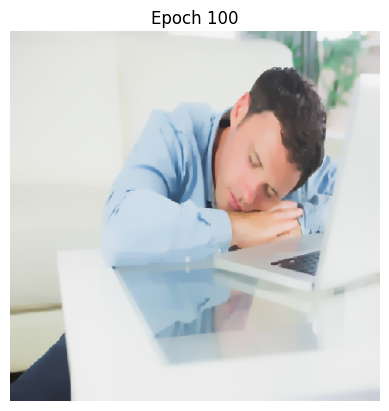

  7%|▋         | 101/1500 [01:04<17:43,  1.32it/s]

Inside compute_loss:
Content Loss: 6.868739887977426e-07, Style Loss: 1.8361028196522966e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 102/1500 [01:04<15:45,  1.48it/s]

Inside compute_loss:
Content Loss: 6.930932272553036e-07, Style Loss: 1.8356016880716197e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 103/1500 [01:05<15:08,  1.54it/s]

Inside compute_loss:
Content Loss: 6.992465273469861e-07, Style Loss: 1.8351156541029923e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 104/1500 [01:06<14:59,  1.55it/s]

Inside compute_loss:
Content Loss: 7.052587989164749e-07, Style Loss: 1.8346478100284003e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 105/1500 [01:06<14:50,  1.57it/s]

Inside compute_loss:
Content Loss: 7.112441835488426e-07, Style Loss: 1.834183967730496e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 106/1500 [01:07<14:46,  1.57it/s]

Inside compute_loss:
Content Loss: 7.172356504270283e-07, Style Loss: 1.8337159417569637e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 107/1500 [01:07<14:42,  1.58it/s]

Inside compute_loss:
Content Loss: 7.232090410980163e-07, Style Loss: 1.8332499166717753e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 108/1500 [01:08<14:38,  1.58it/s]

Inside compute_loss:
Content Loss: 7.291521910701704e-07, Style Loss: 1.83278552867705e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 109/1500 [01:09<14:36,  1.59it/s]

Inside compute_loss:
Content Loss: 7.35121659545257e-07, Style Loss: 1.8323256881558336e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 110/1500 [01:09<14:38,  1.58it/s]

Inside compute_loss:
Content Loss: 7.410935154439358e-07, Style Loss: 1.8318711227038875e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 111/1500 [01:10<14:35,  1.59it/s]

Inside compute_loss:
Content Loss: 7.470093237316178e-07, Style Loss: 1.8314167391508818e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  7%|▋         | 112/1500 [01:11<14:34,  1.59it/s]

Inside compute_loss:
Content Loss: 7.529329764111026e-07, Style Loss: 1.830957262427546e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 113/1500 [01:11<14:37,  1.58it/s]

Inside compute_loss:
Content Loss: 7.587759682792239e-07, Style Loss: 1.830519067880232e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 114/1500 [01:12<14:29,  1.59it/s]

Inside compute_loss:
Content Loss: 7.645554092050588e-07, Style Loss: 1.830081600928679e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 116/1500 [01:13<14:27,  1.60it/s]

Inside compute_loss:
Content Loss: 7.703353617216635e-07, Style Loss: 1.8296575944987126e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 7.760892799524299e-07, Style Loss: 1.8292195818503387e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 117/1500 [01:14<14:27,  1.59it/s]

Inside compute_loss:
Content Loss: 7.817905611773313e-07, Style Loss: 1.8288132196175866e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 118/1500 [01:14<14:29,  1.59it/s]

Inside compute_loss:
Content Loss: 7.875134997448185e-07, Style Loss: 1.8283921235706657e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 119/1500 [01:15<14:42,  1.57it/s]

Inside compute_loss:
Content Loss: 7.93159188106074e-07, Style Loss: 1.8279799405718222e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 120/1500 [01:16<14:42,  1.56it/s]

Inside compute_loss:
Content Loss: 7.988203378772596e-07, Style Loss: 1.8275717593496665e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 121/1500 [01:16<14:52,  1.54it/s]

Inside compute_loss:
Content Loss: 8.045189474614745e-07, Style Loss: 1.827150299504865e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 122/1500 [01:17<14:48,  1.55it/s]

Inside compute_loss:
Content Loss: 8.101569619611837e-07, Style Loss: 1.8267386622028425e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 124/1500 [01:18<14:22,  1.59it/s]

Inside compute_loss:
Content Loss: 8.156935109582264e-07, Style Loss: 1.8263390302308835e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 125/1500 [01:19<14:24,  1.59it/s]

Inside compute_loss:
Content Loss: 8.212431907850259e-07, Style Loss: 1.8259424905409105e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 8.267157340924314e-07, Style Loss: 1.825544131861534e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 126/1500 [01:19<14:25,  1.59it/s]

Inside compute_loss:
Content Loss: 8.321863447235955e-07, Style Loss: 1.8251550500281155e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  8%|▊         | 127/1500 [01:20<14:21,  1.59it/s]

Inside compute_loss:
Content Loss: 8.37662128105876e-07, Style Loss: 1.8247681509819813e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 128/1500 [01:21<14:23,  1.59it/s]

Inside compute_loss:
Content Loss: 8.43136888306617e-07, Style Loss: 1.8243819795316085e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 129/1500 [01:21<14:22,  1.59it/s]

Inside compute_loss:
Content Loss: 8.485655484946619e-07, Style Loss: 1.8239994460600428e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 130/1500 [01:22<14:20,  1.59it/s]

Inside compute_loss:
Content Loss: 8.539500981896708e-07, Style Loss: 1.8236292817164212e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▊         | 131/1500 [01:23<14:27,  1.58it/s]

Inside compute_loss:
Content Loss: 8.59338626924e-07, Style Loss: 1.8232569345855154e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 132/1500 [01:23<14:14,  1.60it/s]

Inside compute_loss:
Content Loss: 8.647752451906854e-07, Style Loss: 1.822866397560574e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 133/1500 [01:24<14:15,  1.60it/s]

Inside compute_loss:
Content Loss: 8.70152973675431e-07, Style Loss: 1.8224911400466226e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 134/1500 [01:25<14:15,  1.60it/s]

Inside compute_loss:
Content Loss: 8.754803388910659e-07, Style Loss: 1.8221227946924046e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 135/1500 [01:25<14:16,  1.59it/s]

Inside compute_loss:
Content Loss: 8.807689368950378e-07, Style Loss: 1.8217653632746078e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 136/1500 [01:26<14:19,  1.59it/s]

Inside compute_loss:
Content Loss: 8.860438356350642e-07, Style Loss: 1.8214153897133656e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 137/1500 [01:26<14:16,  1.59it/s]

Inside compute_loss:
Content Loss: 8.912786029213748e-07, Style Loss: 1.8210617781733163e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 138/1500 [01:27<14:29,  1.57it/s]

Inside compute_loss:
Content Loss: 8.964541393652325e-07, Style Loss: 1.8207227185484953e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 139/1500 [01:28<14:28,  1.57it/s]

Inside compute_loss:
Content Loss: 9.016575290843321e-07, Style Loss: 1.8203785657533444e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 140/1500 [01:28<14:30,  1.56it/s]

Inside compute_loss:
Content Loss: 9.068016879609786e-07, Style Loss: 1.8200271370005794e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 141/1500 [01:29<14:36,  1.55it/s]

Inside compute_loss:
Content Loss: 9.118803063756786e-07, Style Loss: 1.819689896365162e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


  9%|▉         | 142/1500 [01:30<14:27,  1.57it/s]

Inside compute_loss:
Content Loss: 9.169848453893792e-07, Style Loss: 1.819345743570011e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 143/1500 [01:30<14:15,  1.59it/s]

Inside compute_loss:
Content Loss: 9.220652259500639e-07, Style Loss: 1.8190135961049236e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 144/1500 [01:31<14:19,  1.58it/s]

Inside compute_loss:
Content Loss: 9.270924579141138e-07, Style Loss: 1.818687451304868e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 146/1500 [01:32<14:08,  1.60it/s]

Inside compute_loss:
Content Loss: 9.320939966528385e-07, Style Loss: 1.8183727661380544e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 147/1500 [01:33<14:07,  1.60it/s]

Inside compute_loss:
Content Loss: 9.371290730086912e-07, Style Loss: 1.8180429833591916e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 148/1500 [01:33<14:06,  1.60it/s]

Inside compute_loss:
Content Loss: 9.421892741556803e-07, Style Loss: 1.8177142919739708e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 9.472536817156652e-07, Style Loss: 1.8173795979237184e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|▉         | 149/1500 [01:34<14:09,  1.59it/s]

Inside compute_loss:
Content Loss: 9.522300388198346e-07, Style Loss: 1.817071097320877e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 150/1500 [01:35<14:29,  1.55it/s]

Inside compute_loss:
Content Loss: 9.571394912200049e-07, Style Loss: 1.8167731468565762e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 151/1500 [01:35<14:22,  1.56it/s]

Inside compute_loss:
Content Loss: 9.6205269528582e-07, Style Loss: 1.816453004721552e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 152/1500 [01:36<14:21,  1.57it/s]

Inside compute_loss:
Content Loss: 9.669697647041176e-07, Style Loss: 1.8161332263844088e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 153/1500 [01:37<14:28,  1.55it/s]

Inside compute_loss:
Content Loss: 9.71853410192125e-07, Style Loss: 1.8158279999624938e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 154/1500 [01:37<14:23,  1.56it/s]

Inside compute_loss:
Content Loss: 9.76717274170369e-07, Style Loss: 1.8155242287321016e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 155/1500 [01:38<14:08,  1.58it/s]

Inside compute_loss:
Content Loss: 9.815694284043275e-07, Style Loss: 1.8152195480070077e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 156/1500 [01:38<14:05,  1.59it/s]

Inside compute_loss:
Content Loss: 9.864332923825714e-07, Style Loss: 1.8149239622289315e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 10%|█         | 157/1500 [01:39<14:09,  1.58it/s]

Inside compute_loss:
Content Loss: 9.913143230733112e-07, Style Loss: 1.8146201909985393e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 158/1500 [01:40<14:17,  1.57it/s]

Inside compute_loss:
Content Loss: 9.961903515431914e-07, Style Loss: 1.8143105990020558e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 159/1500 [01:40<14:15,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0010395499193692e-06, Style Loss: 1.8140153770218603e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 160/1500 [01:41<14:21,  1.56it/s]

Inside compute_loss:
Content Loss: 1.005784156404843e-06, Style Loss: 1.8137194274459034e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 161/1500 [01:42<14:21,  1.55it/s]

Inside compute_loss:
Content Loss: 1.0105160299644922e-06, Style Loss: 1.8134291167370975e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 162/1500 [01:42<14:05,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0151884453080129e-06, Style Loss: 1.8131428078049794e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 163/1500 [01:43<14:04,  1.58it/s]

Inside compute_loss:
Content Loss: 1.019888031805749e-06, Style Loss: 1.8128550436813384e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 164/1500 [01:44<14:08,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0245800012853579e-06, Style Loss: 1.8125796486856416e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 165/1500 [01:44<14:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0292144452250795e-06, Style Loss: 1.8122969777323306e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 166/1500 [01:45<14:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0338562788092531e-06, Style Loss: 1.8120290405931883e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 167/1500 [01:45<14:05,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0384766255810973e-06, Style Loss: 1.8117551007890143e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█         | 168/1500 [01:46<14:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0430807151351473e-06, Style Loss: 1.8114767954102717e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 169/1500 [01:47<14:01,  1.58it/s]

Inside compute_loss:
Content Loss: 1.047612272486731e-06, Style Loss: 1.8112172256223857e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 170/1500 [01:47<14:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0521597459955956e-06, Style Loss: 1.8109494703821838e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 11%|█▏        | 171/1500 [01:48<13:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.056691417034017e-06, Style Loss: 1.8106795323546976e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 173/1500 [01:49<13:51,  1.60it/s]

Inside compute_loss:
Content Loss: 1.0612502592266537e-06, Style Loss: 1.8104081391356885e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 174/1500 [01:50<13:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.065768060470873e-06, Style Loss: 1.810129833756946e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.0702117378968978e-06, Style Loss: 1.8098719010595232e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 175/1500 [01:50<13:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.0746755378931994e-06, Style Loss: 1.8096172425430268e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 176/1500 [01:51<13:59,  1.58it/s]

Inside compute_loss:
Content Loss: 1.079089429367741e-06, Style Loss: 1.80935730895726e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 177/1500 [01:52<13:54,  1.58it/s]

Inside compute_loss:
Content Loss: 1.0834633030754048e-06, Style Loss: 1.8091035599354655e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 178/1500 [01:52<14:15,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0878559351112926e-06, Style Loss: 1.8088436263496988e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 179/1500 [01:53<14:01,  1.57it/s]

Inside compute_loss:
Content Loss: 1.0922790352196898e-06, Style Loss: 1.8085891497321427e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 180/1500 [01:54<14:18,  1.54it/s]

Inside compute_loss:
Content Loss: 1.0966565469061607e-06, Style Loss: 1.8083335817209445e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 181/1500 [01:54<14:14,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1009936997652403e-06, Style Loss: 1.8080823792843148e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 182/1500 [01:55<14:02,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1052876516259857e-06, Style Loss: 1.8078400898957625e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 183/1500 [01:56<13:53,  1.58it/s]

Inside compute_loss:
Content Loss: 1.109533513954375e-06, Style Loss: 1.807605440262705e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 184/1500 [01:56<13:44,  1.60it/s]

Inside compute_loss:
Content Loss: 1.113779035222251e-06, Style Loss: 1.8073624232783914e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 185/1500 [01:57<13:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1180185310877278e-06, Style Loss: 1.8071234080707654e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 186/1500 [01:57<13:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1222438160984893e-06, Style Loss: 1.806880572985392e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 12%|█▏        | 187/1500 [01:58<13:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1264259001109167e-06, Style Loss: 1.806644104362931e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 188/1500 [01:59<13:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1306209444228443e-06, Style Loss: 1.8064114556182176e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 190/1500 [02:00<13:41,  1.60it/s]

Inside compute_loss:
Content Loss: 1.134816784542636e-06, Style Loss: 1.80617153091589e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1389416840756894e-06, Style Loss: 1.8059503418044187e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 191/1500 [02:01<13:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1430482800278696e-06, Style Loss: 1.8057182387565263e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 192/1500 [02:01<13:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1471579455246683e-06, Style Loss: 1.8055005057249218e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 194/1500 [02:03<13:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1512667015267652e-06, Style Loss: 1.8052678569802083e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.1554022876225645e-06, Style Loss: 1.8050457583740354e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 195/1500 [02:03<13:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.159516500592872e-06, Style Loss: 1.8048216588795185e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 196/1500 [02:04<13:48,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1635432883849717e-06, Style Loss: 1.804609019018244e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 197/1500 [02:04<13:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.1676489748424501e-06, Style Loss: 1.8043825548375025e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 198/1500 [02:05<13:55,  1.56it/s]

Inside compute_loss:
Content Loss: 1.1717171446434804e-06, Style Loss: 1.8041677321889438e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 199/1500 [02:06<13:48,  1.57it/s]

Inside compute_loss:
Content Loss: 1.1758671689676703e-06, Style Loss: 1.8039383576251566e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 200/1500 [02:06<14:02,  1.54it/s]

Inside compute_loss:
Content Loss: 1.1799728554251487e-06, Style Loss: 1.8037104382528923e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 200, Loss: 1155.664673, Alpha: 10.0000, Beta: 10.0000


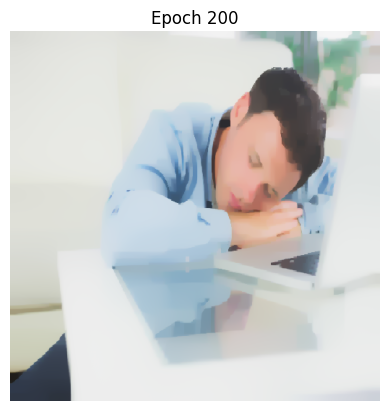

 13%|█▎        | 201/1500 [02:07<16:17,  1.33it/s]

Inside compute_loss:
Content Loss: 1.1840105571536697e-06, Style Loss: 1.8034887034446e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 13%|█▎        | 202/1500 [02:08<14:06,  1.53it/s]

Inside compute_loss:
Content Loss: 1.188091005133174e-06, Style Loss: 1.803271152311936e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 203/1500 [02:08<13:56,  1.55it/s]

Inside compute_loss:
Content Loss: 1.1921107443413348e-06, Style Loss: 1.8030646970146336e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 204/1500 [02:09<13:49,  1.56it/s]

Inside compute_loss:
Content Loss: 1.196064999930968e-06, Style Loss: 1.8028511476586573e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 205/1500 [02:10<13:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2000499509667861e-06, Style Loss: 1.8026436009677127e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▎        | 206/1500 [02:10<13:38,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2040810588587192e-06, Style Loss: 1.802425140340347e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 207/1500 [02:11<13:36,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2081101203875733e-06, Style Loss: 1.8022054064203985e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 208/1500 [02:12<13:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2121023473810055e-06, Style Loss: 1.8019949493464082e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 209/1500 [02:12<13:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2161269751231885e-06, Style Loss: 1.8017841284745373e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 210/1500 [02:13<13:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.220097033183265e-06, Style Loss: 1.801568578230217e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 211/1500 [02:13<13:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.22407914204814e-06, Style Loss: 1.8013519365922548e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 213/1500 [02:15<13:26,  1.60it/s]

Inside compute_loss:
Content Loss: 1.228075575454568e-06, Style Loss: 1.8011467545875348e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 214/1500 [02:15<13:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.232017325492052e-06, Style Loss: 1.8009430277743377e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2358624417174724e-06, Style Loss: 1.800748759706039e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 215/1500 [02:16<13:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2398062381180353e-06, Style Loss: 1.8005372112384066e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 216/1500 [02:17<13:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.243749238710734e-06, Style Loss: 1.80031838681316e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 14%|█▍        | 217/1500 [02:17<13:43,  1.56it/s]

Inside compute_loss:
Content Loss: 1.24758560104965e-06, Style Loss: 1.8001128410105594e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 218/1500 [02:18<13:38,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2513670526459464e-06, Style Loss: 1.7999291230808012e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 219/1500 [02:19<13:49,  1.54it/s]

Inside compute_loss:
Content Loss: 1.255151687473699e-06, Style Loss: 1.7997328541241586e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 220/1500 [02:19<13:46,  1.55it/s]

Inside compute_loss:
Content Loss: 1.2589189282152802e-06, Style Loss: 1.7995414964389056e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 221/1500 [02:20<13:32,  1.57it/s]

Inside compute_loss:
Content Loss: 1.2627009482457652e-06, Style Loss: 1.799341043806635e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 222/1500 [02:20<13:28,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2664304449572228e-06, Style Loss: 1.7991515051107854e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▍        | 224/1500 [02:22<13:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2701553941951715e-06, Style Loss: 1.798973244149238e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.2738613577312208e-06, Style Loss: 1.7987951650866307e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 225/1500 [02:22<13:23,  1.59it/s]

Inside compute_loss:
Content Loss: 1.277575506719586e-06, Style Loss: 1.7986056263907813e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 226/1500 [02:23<13:25,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2812932936867583e-06, Style Loss: 1.798423363652546e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 227/1500 [02:24<13:26,  1.58it/s]

Inside compute_loss:
Content Loss: 1.2850265420638607e-06, Style Loss: 1.7982260033022612e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 228/1500 [02:24<13:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2887477396361646e-06, Style Loss: 1.7980302800424397e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 229/1500 [02:25<13:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.292358888349554e-06, Style Loss: 1.7978578398469836e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 230/1500 [02:25<13:25,  1.58it/s]

Inside compute_loss:
Content Loss: 1.295899551223556e-06, Style Loss: 1.7976786693907343e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 231/1500 [02:26<13:18,  1.59it/s]

Inside compute_loss:
Content Loss: 1.2995129736736999e-06, Style Loss: 1.797511868062429e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 15%|█▌        | 232/1500 [02:27<13:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3031457228862564e-06, Style Loss: 1.7973316062125377e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 233/1500 [02:27<13:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.306709805248829e-06, Style Loss: 1.797160985006485e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 234/1500 [02:28<13:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.310375864704838e-06, Style Loss: 1.7969821783481166e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 236/1500 [02:29<13:12,  1.60it/s]

Inside compute_loss:
Content Loss: 1.3139580232746084e-06, Style Loss: 1.796809010556899e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3174517334846314e-06, Style Loss: 1.7966451196116395e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 237/1500 [02:30<13:27,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3209136113800923e-06, Style Loss: 1.796489959815517e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 238/1500 [02:31<13:29,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3244126648714882e-06, Style Loss: 1.796309879864566e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 239/1500 [02:31<13:27,  1.56it/s]

Inside compute_loss:
Content Loss: 1.3279353652251302e-06, Style Loss: 1.7961363482754678e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 240/1500 [02:32<13:33,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3315076330400188e-06, Style Loss: 1.795947173377499e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 242/1500 [02:33<13:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3349953178476426e-06, Style Loss: 1.795778916857671e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.3384192243393045e-06, Style Loss: 1.795625576050952e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▌        | 243/1500 [02:34<13:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.341849383607041e-06, Style Loss: 1.7954596842173487e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 244/1500 [02:34<13:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3452767007038346e-06, Style Loss: 1.7952990674530156e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 245/1500 [02:35<13:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3487273236023611e-06, Style Loss: 1.795132993720472e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 246/1500 [02:36<13:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3522499102691654e-06, Style Loss: 1.7949561879504472e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 16%|█▋        | 247/1500 [02:36<13:04,  1.60it/s]

Inside compute_loss:
Content Loss: 1.355656422674656e-06, Style Loss: 1.7948019376490265e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 249/1500 [02:37<13:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3590428125098697e-06, Style Loss: 1.7946433217730373e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.362453872388869e-06, Style Loss: 1.7944865248864517e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 250/1500 [02:38<13:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3657318049808964e-06, Style Loss: 1.79433172888821e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 251/1500 [02:39<13:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3690065543414676e-06, Style Loss: 1.7941822079592384e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 252/1500 [02:39<13:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3723806659982074e-06, Style Loss: 1.7940166799235158e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 253/1500 [02:40<13:07,  1.58it/s]

Inside compute_loss:
Content Loss: 1.3757894521404523e-06, Style Loss: 1.7938658857019618e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 254/1500 [02:41<13:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3792096069664694e-06, Style Loss: 1.7936979929800145e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 255/1500 [02:41<13:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.3824906091031153e-06, Style Loss: 1.793557748897001e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 256/1500 [02:42<13:08,  1.58it/s]

Inside compute_loss:
Content Loss: 1.385771270179248e-06, Style Loss: 1.7933987692231312e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 257/1500 [02:43<13:19,  1.55it/s]

Inside compute_loss:
Content Loss: 1.3890957006879034e-06, Style Loss: 1.7932297851075418e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 258/1500 [02:43<13:20,  1.55it/s]

Inside compute_loss:
Content Loss: 1.392377612319251e-06, Style Loss: 1.7930828107637353e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 259/1500 [02:44<13:24,  1.54it/s]

Inside compute_loss:
Content Loss: 1.3956801012682263e-06, Style Loss: 1.792927287169732e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 260/1500 [02:45<13:28,  1.53it/s]

Inside compute_loss:
Content Loss: 1.3989900935484911e-06, Style Loss: 1.7927704902831465e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 261/1500 [02:45<13:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.402206180500798e-06, Style Loss: 1.7926135114976205e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 17%|█▋        | 262/1500 [02:46<13:02,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4054293160370435e-06, Style Loss: 1.7924792700796388e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 263/1500 [02:46<12:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4085277371123084e-06, Style Loss: 1.7923415725817904e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 264/1500 [02:47<12:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4115979638518183e-06, Style Loss: 1.792208422557451e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 265/1500 [02:48<12:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4147411775411456e-06, Style Loss: 1.7920647223945707e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 266/1500 [02:48<12:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4179164509187103e-06, Style Loss: 1.7919144738698378e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 267/1500 [02:49<12:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4211069583325298e-06, Style Loss: 1.7917682271217927e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 268/1500 [02:50<12:53,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4243174746297882e-06, Style Loss: 1.791626709746197e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 269/1500 [02:50<12:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4274623936216813e-06, Style Loss: 1.791470822354313e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 271/1500 [02:51<12:49,  1.60it/s]

Inside compute_loss:
Content Loss: 1.430559223081218e-06, Style Loss: 1.7913398551172577e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 272/1500 [02:52<12:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4336942513182294e-06, Style Loss: 1.7912039766088128e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.43683280384721e-06, Style Loss: 1.7910679162014276e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 273/1500 [02:53<12:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.440007167730073e-06, Style Loss: 1.7909103917190805e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 274/1500 [02:53<12:55,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4431706176765147e-06, Style Loss: 1.790765963960439e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 275/1500 [02:54<12:53,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4462049193753046e-06, Style Loss: 1.790637725207489e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 276/1500 [02:55<12:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4491841966446373e-06, Style Loss: 1.7905062122736126e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 18%|█▊        | 277/1500 [02:55<13:17,  1.53it/s]

Inside compute_loss:
Content Loss: 1.4522196352118044e-06, Style Loss: 1.7903763364301994e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 278/1500 [02:56<13:01,  1.56it/s]

Inside compute_loss:
Content Loss: 1.4552780385201913e-06, Style Loss: 1.7902351828524843e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 279/1500 [02:57<13:10,  1.54it/s]

Inside compute_loss:
Content Loss: 1.458313704461034e-06, Style Loss: 1.7901085811899975e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 280/1500 [02:57<13:10,  1.54it/s]

Inside compute_loss:
Content Loss: 1.4613056009693537e-06, Style Loss: 1.7899737940751947e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▊        | 281/1500 [02:58<12:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4643278518633451e-06, Style Loss: 1.7898459191201255e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 282/1500 [02:58<12:50,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4673464647785295e-06, Style Loss: 1.7897105863085017e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 283/1500 [02:59<12:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.470329038966156e-06, Style Loss: 1.7895965356728993e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 284/1500 [03:00<12:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4733922171217273e-06, Style Loss: 1.7894581105792895e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 285/1500 [03:00<12:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.476388206356205e-06, Style Loss: 1.7893231415655464e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 286/1500 [03:01<12:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4793582749916823e-06, Style Loss: 1.789183443179354e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 288/1500 [03:02<12:39,  1.60it/s]

Inside compute_loss:
Content Loss: 1.4822875300524174e-06, Style Loss: 1.7890579329105094e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.4852397498543723e-06, Style Loss: 1.7889347873278894e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 289/1500 [03:03<12:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4881992456139415e-06, Style Loss: 1.7888092770590447e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 290/1500 [03:03<12:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.4911191783539834e-06, Style Loss: 1.7886823115986772e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 291/1500 [03:04<12:41,  1.59it/s]

Inside compute_loss:
Content Loss: 1.493962486165401e-06, Style Loss: 1.7885666238726117e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 19%|█▉        | 292/1500 [03:05<12:43,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4968468349252362e-06, Style Loss: 1.7884434782899916e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 293/1500 [03:05<12:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.4997355037849047e-06, Style Loss: 1.788313420547638e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 294/1500 [03:06<12:39,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5025931361378753e-06, Style Loss: 1.7881924577523023e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 295/1500 [03:07<12:41,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5053952893140377e-06, Style Loss: 1.7880745872389525e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 296/1500 [03:07<12:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5081924402693403e-06, Style Loss: 1.7879587176139466e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 297/1500 [03:08<12:53,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5109338846741593e-06, Style Loss: 1.7878503058454953e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 298/1500 [03:09<12:45,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5136079127842095e-06, Style Loss: 1.7877435311675072e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|█▉        | 299/1500 [03:09<13:02,  1.53it/s]

Inside compute_loss:
Content Loss: 1.5163240050242166e-06, Style Loss: 1.787629480531905e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 300/1500 [03:10<12:45,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5191162674454972e-06, Style Loss: 1.7875021512736566e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 300, Loss: 960.463074, Alpha: 10.0000, Beta: 10.0000


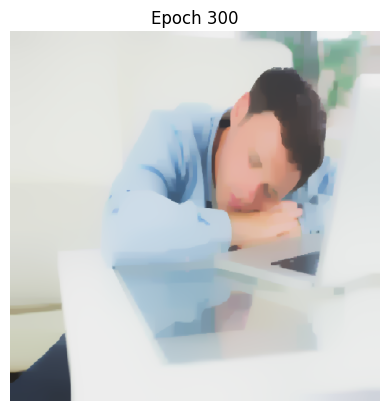

 20%|██        | 301/1500 [03:11<15:01,  1.33it/s]

Inside compute_loss:
Content Loss: 1.5219111446640454e-06, Style Loss: 1.787396649888251e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 302/1500 [03:11<13:00,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5247915143845603e-06, Style Loss: 1.7872675016405992e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 303/1500 [03:12<12:52,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5276732483471278e-06, Style Loss: 1.7871498130261898e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 305/1500 [03:13<12:38,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5304195812859689e-06, Style Loss: 1.787038672773633e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.5331373788285418e-06, Style Loss: 1.786926804925315e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 306/1500 [03:14<12:36,  1.58it/s]

Inside compute_loss:
Content Loss: 1.535876322122931e-06, Style Loss: 1.7868173017632216e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 20%|██        | 307/1500 [03:14<12:34,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5386325458166539e-06, Style Loss: 1.7867052520159632e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 308/1500 [03:15<12:32,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5414055951623595e-06, Style Loss: 1.7865952031570487e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 309/1500 [03:16<12:35,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5441601135535166e-06, Style Loss: 1.786484062904492e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 310/1500 [03:16<13:36,  1.46it/s]

Inside compute_loss:
Content Loss: 1.5468731362489052e-06, Style Loss: 1.7863734683487564e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 311/1500 [03:17<13:12,  1.50it/s]

Inside compute_loss:
Content Loss: 1.5496219702981762e-06, Style Loss: 1.78625723492587e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 312/1500 [03:18<13:02,  1.52it/s]

Inside compute_loss:
Content Loss: 1.5524332184213563e-06, Style Loss: 1.78614955075318e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 313/1500 [03:18<12:49,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5552786862826906e-06, Style Loss: 1.7860134903457947e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 314/1500 [03:19<12:48,  1.54it/s]

Inside compute_loss:
Content Loss: 1.5579895489281625e-06, Style Loss: 1.7859103536466137e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 315/1500 [03:20<12:36,  1.57it/s]

Inside compute_loss:
Content Loss: 1.5606841543558403e-06, Style Loss: 1.7858032151707448e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 316/1500 [03:20<12:45,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5633854673069436e-06, Style Loss: 1.785696622391697e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 317/1500 [03:21<12:43,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5661111092413194e-06, Style Loss: 1.785592939995695e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██        | 318/1500 [03:22<12:51,  1.53it/s]

Inside compute_loss:
Content Loss: 1.568817992847471e-06, Style Loss: 1.7854861653177068e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 319/1500 [03:22<12:37,  1.56it/s]

Inside compute_loss:
Content Loss: 1.5714964547441923e-06, Style Loss: 1.7853782992460765e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 320/1500 [03:23<12:40,  1.55it/s]

Inside compute_loss:
Content Loss: 1.5741787819933961e-06, Style Loss: 1.7852584278443828e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 321/1500 [03:23<12:24,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5768438288432662e-06, Style Loss: 1.7851627490017563e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 21%|██▏       | 322/1500 [03:24<12:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5794001910762745e-06, Style Loss: 1.785066706361249e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 323/1500 [03:25<12:21,  1.59it/s]

Inside compute_loss:
Content Loss: 1.58201157773874e-06, Style Loss: 1.784961932571605e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 324/1500 [03:25<12:22,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5846507039896096e-06, Style Loss: 1.7848475181381218e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 325/1500 [03:26<12:22,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5872986978138215e-06, Style Loss: 1.7847385606728494e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 326/1500 [03:27<12:25,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5899310028544278e-06, Style Loss: 1.7846374248620123e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 327/1500 [03:27<12:22,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5925133993732743e-06, Style Loss: 1.78453374246601e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 328/1500 [03:28<12:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.5949761973388377e-06, Style Loss: 1.7844457033788785e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 329/1500 [03:28<12:19,  1.58it/s]

Inside compute_loss:
Content Loss: 1.5975441556292935e-06, Style Loss: 1.784339838195592e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 330/1500 [03:29<12:16,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6001264384613023e-06, Style Loss: 1.7842326997197233e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 331/1500 [03:30<12:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.602655288479582e-06, Style Loss: 1.7841261069406755e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 332/1500 [03:30<12:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6052549653977621e-06, Style Loss: 1.7840126020018943e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 333/1500 [03:31<12:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.60783031333267e-06, Style Loss: 1.783909829100594e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 334/1500 [03:32<12:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6104191900012665e-06, Style Loss: 1.7838045096141286e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 335/1500 [03:32<12:27,  1.56it/s]

Inside compute_loss:
Content Loss: 1.612933033356967e-06, Style Loss: 1.783725747372955e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 336/1500 [03:33<12:24,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6154084505615174e-06, Style Loss: 1.7836295228335075e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 22%|██▏       | 337/1500 [03:34<12:29,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6179191106857616e-06, Style Loss: 1.7835367543739267e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 338/1500 [03:34<12:30,  1.55it/s]

Inside compute_loss:
Content Loss: 1.6204793382712523e-06, Style Loss: 1.783434890967328e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 339/1500 [03:35<12:16,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6229851098614745e-06, Style Loss: 1.7833324818639085e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 340/1500 [03:35<12:19,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6254416550509632e-06, Style Loss: 1.7832382582128048e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 341/1500 [03:36<12:09,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6279506098726415e-06, Style Loss: 1.783142943168059e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 343/1500 [03:37<12:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6304585415127804e-06, Style Loss: 1.7830396245699376e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6330013750120997e-06, Style Loss: 1.7829417629400268e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 344/1500 [03:38<12:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6354573517673998e-06, Style Loss: 1.7828528143581934e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 345/1500 [03:39<12:07,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6378635336877778e-06, Style Loss: 1.7827625924837776e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 346/1500 [03:39<12:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.640318259887863e-06, Style Loss: 1.7826721887104213e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 347/1500 [03:40<12:04,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6427690070486278e-06, Style Loss: 1.7825721442932263e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 349/1500 [03:41<12:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6452148656753707e-06, Style Loss: 1.7824797396315262e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6476700466228067e-06, Style Loss: 1.7823787857196294e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 350/1500 [03:42<12:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6501335267093964e-06, Style Loss: 1.782277104211971e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 351/1500 [03:42<12:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.652526407269761e-06, Style Loss: 1.782182698661927e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 23%|██▎       | 352/1500 [03:43<12:00,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6548832491025678e-06, Style Loss: 1.7820901121012866e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 353/1500 [03:44<12:04,  1.58it/s]

Inside compute_loss:
Content Loss: 1.657283178246871e-06, Style Loss: 1.782010258466471e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 354/1500 [03:44<12:03,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6596421801295946e-06, Style Loss: 1.7819198546931148e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 355/1500 [03:45<12:06,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6620570022496395e-06, Style Loss: 1.781826540536713e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▎       | 356/1500 [03:46<12:10,  1.57it/s]

Inside compute_loss:
Content Loss: 1.6644389688735828e-06, Style Loss: 1.781734863470774e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 357/1500 [03:46<12:12,  1.56it/s]

Inside compute_loss:
Content Loss: 1.6668542457409785e-06, Style Loss: 1.78165573743172e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 358/1500 [03:47<12:19,  1.54it/s]

Inside compute_loss:
Content Loss: 1.669211201260623e-06, Style Loss: 1.7815626051742584e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 359/1500 [03:47<11:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6715154060875648e-06, Style Loss: 1.7814876628108323e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 360/1500 [03:48<12:00,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6738921431169729e-06, Style Loss: 1.7813959857448936e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 361/1500 [03:49<11:58,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6762965060479473e-06, Style Loss: 1.7813148588174954e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 362/1500 [03:49<11:59,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6786624428277719e-06, Style Loss: 1.781219179974869e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 363/1500 [03:50<11:54,  1.59it/s]

Inside compute_loss:
Content Loss: 1.681026901678706e-06, Style Loss: 1.7811405996326357e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 364/1500 [03:51<11:55,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6833545259942184e-06, Style Loss: 1.7810380086302757e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 365/1500 [03:51<11:52,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6856033653311897e-06, Style Loss: 1.7809654309530742e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 24%|██▍       | 366/1500 [03:52<11:50,  1.60it/s]

Inside compute_loss:
Content Loss: 1.6878420865396038e-06, Style Loss: 1.7808932170737535e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 368/1500 [03:53<11:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.690070916993136e-06, Style Loss: 1.7808235497795977e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.6923848988881218e-06, Style Loss: 1.7807404219638556e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 369/1500 [03:54<11:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.694701154519862e-06, Style Loss: 1.7806463802116923e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 370/1500 [03:54<11:48,  1.59it/s]

Inside compute_loss:
Content Loss: 1.6970708429653314e-06, Style Loss: 1.780565617082175e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 371/1500 [03:55<11:52,  1.58it/s]

Inside compute_loss:
Content Loss: 1.6994464431263623e-06, Style Loss: 1.7804657545639202e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 372/1500 [03:56<11:46,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7017331401802949e-06, Style Loss: 1.7803888113121502e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 373/1500 [03:56<11:46,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7039874364854768e-06, Style Loss: 1.7803038645070046e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▍       | 374/1500 [03:57<11:45,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7062043298210483e-06, Style Loss: 1.7802314687287435e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 375/1500 [03:58<12:13,  1.53it/s]

Inside compute_loss:
Content Loss: 1.7084702221836778e-06, Style Loss: 1.7801443391363136e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 376/1500 [03:58<11:55,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7107049643527716e-06, Style Loss: 1.780071761459112e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 377/1500 [03:59<12:00,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7129822253991733e-06, Style Loss: 1.779996819095686e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 378/1500 [04:00<12:03,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7151938891402096e-06, Style Loss: 1.7799271518015303e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 379/1500 [04:00<11:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7174547792819794e-06, Style Loss: 1.779833655746188e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 380/1500 [04:01<11:44,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7196936141772312e-06, Style Loss: 1.7797625332605094e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 381/1500 [04:01<11:51,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7218876564584207e-06, Style Loss: 1.779687408998143e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 25%|██▌       | 382/1500 [04:02<11:43,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7240286069863942e-06, Style Loss: 1.7796128304325975e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 383/1500 [04:03<11:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7261772882193327e-06, Style Loss: 1.779545345925726e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 384/1500 [04:03<11:44,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7283904298892594e-06, Style Loss: 1.7794651284930296e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 386/1500 [04:04<11:36,  1.60it/s]

Inside compute_loss:
Content Loss: 1.7305018218394252e-06, Style Loss: 1.7793983715819195e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.7326887018498383e-06, Style Loss: 1.7793194274418056e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 387/1500 [04:05<11:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.734800548547355e-06, Style Loss: 1.779257581802085e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 388/1500 [04:06<11:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7369383158438723e-06, Style Loss: 1.7791891878005117e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 390/1500 [04:07<11:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7391217852491536e-06, Style Loss: 1.7791126083466224e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.741233404572995e-06, Style Loss: 1.779046215233393e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 391/1500 [04:08<11:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7433085304219276e-06, Style Loss: 1.7789772755349986e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▌       | 392/1500 [04:08<11:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7453741065764916e-06, Style Loss: 1.7789052435546182e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 394/1500 [04:10<11:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7474658307037316e-06, Style Loss: 1.778837940946687e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.749586431287753e-06, Style Loss: 1.778774822014384e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 395/1500 [04:10<11:50,  1.55it/s]

Inside compute_loss:
Content Loss: 1.751632794366742e-06, Style Loss: 1.7787124306778423e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 396/1500 [04:11<11:46,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7536978020871175e-06, Style Loss: 1.7786391254048795e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 26%|██▋       | 397/1500 [04:12<11:54,  1.54it/s]

Inside compute_loss:
Content Loss: 1.755850576046214e-06, Style Loss: 1.7785756426746957e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 398/1500 [04:12<11:54,  1.54it/s]

Inside compute_loss:
Content Loss: 1.7579950508661568e-06, Style Loss: 1.7785036106943153e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 399/1500 [04:13<11:34,  1.59it/s]

Inside compute_loss:
Content Loss: 1.760069949341414e-06, Style Loss: 1.7784423107514158e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 400/1500 [04:13<11:34,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7621592860450619e-06, Style Loss: 1.7783710063667968e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 400, Loss: 842.114258, Alpha: 10.0000, Beta: 10.0000


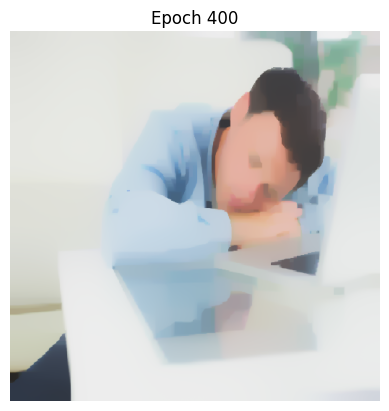

 27%|██▋       | 401/1500 [04:14<13:39,  1.34it/s]

Inside compute_loss:
Content Loss: 1.7642300917941611e-06, Style Loss: 1.7783117073122412e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 402/1500 [04:15<11:50,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7662645177551894e-06, Style Loss: 1.7782476788852364e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 403/1500 [04:15<11:42,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7682746147329453e-06, Style Loss: 1.7781771020963788e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 404/1500 [04:16<11:35,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7702863033264293e-06, Style Loss: 1.778110527084209e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 405/1500 [04:17<11:37,  1.57it/s]

Inside compute_loss:
Content Loss: 1.7723081100484706e-06, Style Loss: 1.778041769284755e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 406/1500 [04:17<11:29,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7743922171575832e-06, Style Loss: 1.7779779227566905e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 407/1500 [04:18<11:27,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7764776885087485e-06, Style Loss: 1.7779117115424015e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 408/1500 [04:19<11:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7785237105272245e-06, Style Loss: 1.7778445908334106e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 409/1500 [04:19<11:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7806628420657944e-06, Style Loss: 1.7777636458049528e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 410/1500 [04:20<11:25,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7827546798798721e-06, Style Loss: 1.7776905224309303e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 411/1500 [04:20<11:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7847469280241057e-06, Style Loss: 1.7776355889509432e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 27%|██▋       | 412/1500 [04:21<11:21,  1.60it/s]

Inside compute_loss:
Content Loss: 1.786719735719089e-06, Style Loss: 1.7775731976144016e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 413/1500 [04:22<11:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.7887374497149722e-06, Style Loss: 1.77750571310753e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 414/1500 [04:22<11:39,  1.55it/s]

Inside compute_loss:
Content Loss: 1.7908228073792998e-06, Style Loss: 1.7774371372070163e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 415/1500 [04:23<11:37,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7928790612131706e-06, Style Loss: 1.7773607396520674e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 416/1500 [04:24<11:33,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7949586208487744e-06, Style Loss: 1.777292345650494e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 417/1500 [04:24<11:34,  1.56it/s]

Inside compute_loss:
Content Loss: 1.7970323824556544e-06, Style Loss: 1.7772161299944855e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 418/1500 [04:25<11:26,  1.58it/s]

Inside compute_loss:
Content Loss: 1.7990029164138832e-06, Style Loss: 1.7771499187801965e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 420/1500 [04:26<11:19,  1.59it/s]

Inside compute_loss:
Content Loss: 1.800903646653751e-06, Style Loss: 1.7770844351616688e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8028960084848222e-06, Style Loss: 1.7770307749742642e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 421/1500 [04:27<11:20,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8048302763418178e-06, Style Loss: 1.776974750100635e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 422/1500 [04:27<11:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8067185010295361e-06, Style Loss: 1.7769072655937634e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 423/1500 [04:28<11:17,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8086135469275177e-06, Style Loss: 1.7768486941349693e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 424/1500 [04:29<11:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8105607750840136e-06, Style Loss: 1.7767852114047855e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 425/1500 [04:29<11:14,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8125556380255148e-06, Style Loss: 1.776710996637121e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 426/1500 [04:30<11:13,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8145118474421906e-06, Style Loss: 1.776648059603758e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 28%|██▊       | 427/1500 [04:31<11:17,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8165129631597665e-06, Style Loss: 1.7765769371180795e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 428/1500 [04:31<11:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8183799284088309e-06, Style Loss: 1.7765309166861698e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 430/1500 [04:32<11:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8201762941316701e-06, Style Loss: 1.7764794392860495e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8220466699858662e-06, Style Loss: 1.7764228687155992e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▊       | 431/1500 [04:33<11:17,  1.58it/s]

Inside compute_loss:
Content Loss: 1.8239279597764835e-06, Style Loss: 1.7763652067515068e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 432/1500 [04:34<11:07,  1.60it/s]

Inside compute_loss:
Content Loss: 1.825845515668334e-06, Style Loss: 1.7763033611117862e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 433/1500 [04:34<11:08,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8278205971000716e-06, Style Loss: 1.776236058503855e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 434/1500 [04:35<11:26,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8297081396667636e-06, Style Loss: 1.7761913113645278e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 435/1500 [04:36<11:20,  1.56it/s]

Inside compute_loss:
Content Loss: 1.831611484703899e-06, Style Loss: 1.776134922693018e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 436/1500 [04:36<11:27,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8335240383748896e-06, Style Loss: 1.776072895154357e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 437/1500 [04:37<11:29,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8354070334680728e-06, Style Loss: 1.776025783328805e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 438/1500 [04:38<11:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8372276144873467e-06, Style Loss: 1.7759803085937165e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 439/1500 [04:38<11:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8390602463114192e-06, Style Loss: 1.7759273760020733e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 440/1500 [04:39<11:08,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8409565427646157e-06, Style Loss: 1.7758664398570545e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 29%|██▉       | 441/1500 [04:39<11:05,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8428601151754265e-06, Style Loss: 1.775808777892962e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 443/1500 [04:41<11:02,  1.59it/s]

Inside compute_loss:
Content Loss: 1.844657617766643e-06, Style Loss: 1.77576148416847e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8464806998963468e-06, Style Loss: 1.7757141904439777e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 444/1500 [04:41<11:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.848339138632582e-06, Style Loss: 1.775659438862931e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 445/1500 [04:42<11:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8501958720662515e-06, Style Loss: 1.775605051079765e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 446/1500 [04:43<11:01,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8520232742957887e-06, Style Loss: 1.775560485839378e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 447/1500 [04:43<10:59,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8538512449595146e-06, Style Loss: 1.7755059161572717e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 448/1500 [04:44<10:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.855678988249565e-06, Style Loss: 1.7754484360921197e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|██▉       | 449/1500 [04:44<10:59,  1.59it/s]

Inside compute_loss:
Content Loss: 1.857433403529285e-06, Style Loss: 1.7753940483089536e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 450/1500 [04:45<10:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.859155986494443e-06, Style Loss: 1.7753422071109526e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 451/1500 [04:46<10:57,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8609372318678652e-06, Style Loss: 1.7752974599716254e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 452/1500 [04:46<10:57,  1.59it/s]

Inside compute_loss:
Content Loss: 1.862706426436489e-06, Style Loss: 1.775255259417463e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 453/1500 [04:47<10:58,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8644219608177082e-06, Style Loss: 1.775206510501448e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 454/1500 [04:48<11:08,  1.56it/s]

Inside compute_loss:
Content Loss: 1.866178081399994e-06, Style Loss: 1.7751553968992084e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 455/1500 [04:48<11:06,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8679734239412937e-06, Style Loss: 1.775105374690611e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 456/1500 [04:49<11:17,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8696646293392405e-06, Style Loss: 1.7750624465406872e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 30%|███       | 457/1500 [04:50<11:15,  1.54it/s]

Inside compute_loss:
Content Loss: 1.8713840290729422e-06, Style Loss: 1.7750082406564616e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 458/1500 [04:50<10:52,  1.60it/s]

Inside compute_loss:
Content Loss: 1.8731335558186402e-06, Style Loss: 1.774967859091703e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 459/1500 [04:51<11:06,  1.56it/s]

Inside compute_loss:
Content Loss: 1.874844315352675e-06, Style Loss: 1.7749229300534353e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 460/1500 [04:51<11:04,  1.56it/s]

Inside compute_loss:
Content Loss: 1.8765218783300952e-06, Style Loss: 1.774877091520466e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 461/1500 [04:52<11:02,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8782660617944202e-06, Style Loss: 1.774825250322465e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 462/1500 [04:53<11:08,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8799851204676088e-06, Style Loss: 1.774777047103271e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 463/1500 [04:53<11:07,  1.55it/s]

Inside compute_loss:
Content Loss: 1.8817103182300343e-06, Style Loss: 1.7747264791978523e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 464/1500 [04:54<10:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8834804222933599e-06, Style Loss: 1.7746660887496546e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 465/1500 [04:55<10:51,  1.59it/s]

Inside compute_loss:
Content Loss: 1.885200049400737e-06, Style Loss: 1.7746197045198642e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 466/1500 [04:55<10:49,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8868663573812228e-06, Style Loss: 1.7745824152370915e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███       | 467/1500 [04:56<10:57,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8886042880694731e-06, Style Loss: 1.7745238437782973e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 469/1500 [04:57<10:50,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8904364651461947e-06, Style Loss: 1.7744589058565907e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.8922004301202833e-06, Style Loss: 1.7744048818713054e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 470/1500 [04:58<10:54,  1.57it/s]

Inside compute_loss:
Content Loss: 1.8938970924864407e-06, Style Loss: 1.7743583157425746e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 471/1500 [04:58<10:46,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8955746554638608e-06, Style Loss: 1.7743142961990088e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 31%|███▏      | 472/1500 [04:59<10:45,  1.59it/s]

Inside compute_loss:
Content Loss: 1.8972781390402815e-06, Style Loss: 1.7742511772667058e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 473/1500 [05:00<10:54,  1.57it/s]

Inside compute_loss:
Content Loss: 1.899009930639295e-06, Style Loss: 1.7741966075845994e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 474/1500 [05:00<10:54,  1.57it/s]

Inside compute_loss:
Content Loss: 1.9007576383955893e-06, Style Loss: 1.7741433111950755e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 475/1500 [05:01<10:55,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9024338371309568e-06, Style Loss: 1.7741136616677977e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 476/1500 [05:02<11:02,  1.54it/s]

Inside compute_loss:
Content Loss: 1.904124474094715e-06, Style Loss: 1.7740683688316494e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 477/1500 [05:02<11:01,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9057589497606386e-06, Style Loss: 1.7740218027029186e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 479/1500 [05:04<10:38,  1.60it/s]

Inside compute_loss:
Content Loss: 1.907374780785176e-06, Style Loss: 1.773979420249816e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9090080058958847e-06, Style Loss: 1.7739359464030713e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 480/1500 [05:04<10:40,  1.59it/s]

Inside compute_loss:
Content Loss: 1.910610762934084e-06, Style Loss: 1.7738966562319547e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 481/1500 [05:05<10:43,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9122787762171356e-06, Style Loss: 1.7738440874381922e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 482/1500 [05:05<10:42,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9140300082653994e-06, Style Loss: 1.773788608261384e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 483/1500 [05:06<10:45,  1.58it/s]

Inside compute_loss:
Content Loss: 1.915726215884206e-06, Style Loss: 1.7737498637870885e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 484/1500 [05:07<10:38,  1.59it/s]

Inside compute_loss:
Content Loss: 1.917359213621239e-06, Style Loss: 1.7737031157594174e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 485/1500 [05:07<10:37,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9189449176337803e-06, Style Loss: 1.773661279003136e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 486/1500 [05:08<10:35,  1.59it/s]

Inside compute_loss:
Content Loss: 1.920564727697638e-06, Style Loss: 1.7736128938850015e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 32%|███▏      | 487/1500 [05:09<10:34,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9221040474803885e-06, Style Loss: 1.773579242581036e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 488/1500 [05:09<10:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9236890693719033e-06, Style Loss: 1.773532130755484e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 489/1500 [05:10<10:36,  1.59it/s]

Inside compute_loss:
Content Loss: 1.925290007420699e-06, Style Loss: 1.773484291334171e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 490/1500 [05:10<10:32,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9268536561867222e-06, Style Loss: 1.773451549524907e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 491/1500 [05:11<10:33,  1.59it/s]

Inside compute_loss:
Content Loss: 1.928358642544481e-06, Style Loss: 1.7734077118802816e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 492/1500 [05:12<10:31,  1.60it/s]

Inside compute_loss:
Content Loss: 1.929848394865985e-06, Style Loss: 1.773372605384793e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 493/1500 [05:12<10:32,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9313081338623306e-06, Style Loss: 1.7733384083840065e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 494/1500 [05:13<10:44,  1.56it/s]

Inside compute_loss:
Content Loss: 1.932864279297064e-06, Style Loss: 1.7732927517499775e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 495/1500 [05:14<10:44,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9344142856425606e-06, Style Loss: 1.7732445485307835e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 496/1500 [05:14<10:50,  1.54it/s]

Inside compute_loss:
Content Loss: 1.9360018086445052e-06, Style Loss: 1.7732016203808598e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 497/1500 [05:15<10:48,  1.55it/s]

Inside compute_loss:
Content Loss: 1.937628439918626e-06, Style Loss: 1.7731546904542483e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 498/1500 [05:16<10:33,  1.58it/s]

Inside compute_loss:
Content Loss: 1.939205731105176e-06, Style Loss: 1.7731250409269705e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 499/1500 [05:16<10:31,  1.59it/s]

Inside compute_loss:
Content Loss: 1.94069298231625e-06, Style Loss: 1.7730901163304225e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 33%|███▎      | 500/1500 [05:17<10:30,  1.59it/s]

Inside compute_loss:
Content Loss: 1.942234121088404e-06, Style Loss: 1.7730641047819518e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 500, Loss: 763.295654, Alpha: 10.0000, Beta: 10.0000


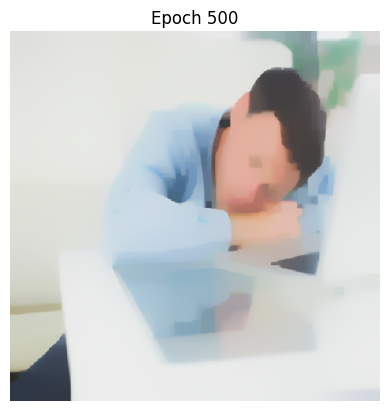

 33%|███▎      | 502/1500 [05:18<10:44,  1.55it/s]

Inside compute_loss:
Content Loss: 1.943803226822638e-06, Style Loss: 1.773023177520372e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.945310486917151e-06, Style Loss: 1.7729917090036906e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 503/1500 [05:19<10:40,  1.56it/s]

Inside compute_loss:
Content Loss: 1.946831844179542e-06, Style Loss: 1.7729558749124408e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 504/1500 [05:19<10:37,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9483384221530287e-06, Style Loss: 1.7729204046190716e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 505/1500 [05:20<10:32,  1.57it/s]

Inside compute_loss:
Content Loss: 1.949794977917918e-06, Style Loss: 1.772879477357492e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▎      | 506/1500 [05:21<10:26,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9513167899276596e-06, Style Loss: 1.7728429156704806e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 507/1500 [05:21<10:26,  1.58it/s]

Inside compute_loss:
Content Loss: 1.952810407601646e-06, Style Loss: 1.772802534105722e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 508/1500 [05:22<10:24,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9542997051757993e-06, Style Loss: 1.772770337993279e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 509/1500 [05:23<10:28,  1.58it/s]

Inside compute_loss:
Content Loss: 1.955889729288174e-06, Style Loss: 1.772725590853952e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 511/1500 [05:24<10:20,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9573899407987483e-06, Style Loss: 1.7726935766404495e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.9588453596952604e-06, Style Loss: 1.772666655597277e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 512/1500 [05:25<10:22,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9603273813117994e-06, Style Loss: 1.7726326404954307e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 513/1500 [05:25<10:32,  1.56it/s]

Inside compute_loss:
Content Loss: 1.961817361006979e-06, Style Loss: 1.7725951693137176e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 514/1500 [05:26<10:36,  1.55it/s]

Inside compute_loss:
Content Loss: 1.96329278878693e-06, Style Loss: 1.772553332557436e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 515/1500 [05:26<10:36,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9647945919132326e-06, Style Loss: 1.7725113139022142e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 516/1500 [05:27<10:33,  1.55it/s]

Inside compute_loss:
Content Loss: 1.966312765944167e-06, Style Loss: 1.7724667486618273e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 34%|███▍      | 517/1500 [05:28<10:25,  1.57it/s]

Inside compute_loss:
Content Loss: 1.9677938780660043e-06, Style Loss: 1.772431642166339e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 518/1500 [05:28<10:20,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9693125068442896e-06, Style Loss: 1.77238089236198e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 519/1500 [05:29<10:19,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9707836145244073e-06, Style Loss: 1.7723550627124496e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 520/1500 [05:30<10:19,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9722576780623058e-06, Style Loss: 1.7723166820360348e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 521/1500 [05:30<10:15,  1.59it/s]

Inside compute_loss:
Content Loss: 1.973791086129495e-06, Style Loss: 1.7722724805935286e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 523/1500 [05:31<10:12,  1.60it/s]

Inside compute_loss:
Content Loss: 1.9752123989746906e-06, Style Loss: 1.7722421034704894e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.976606881726184e-06, Style Loss: 1.772212635842152e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▍      | 524/1500 [05:32<10:16,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9780331967922393e-06, Style Loss: 1.7721722542773932e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 526/1500 [05:33<10:13,  1.59it/s]

Inside compute_loss:
Content Loss: 1.979461785595049e-06, Style Loss: 1.7721304175211117e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.980929937417386e-06, Style Loss: 1.772096766217146e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 527/1500 [05:34<10:14,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9823496586468536e-06, Style Loss: 1.7720698451739736e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 528/1500 [05:35<10:13,  1.58it/s]

Inside compute_loss:
Content Loss: 1.983743686650996e-06, Style Loss: 1.7720487448968925e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 529/1500 [05:35<10:12,  1.58it/s]

Inside compute_loss:
Content Loss: 1.9851629531331128e-06, Style Loss: 1.7720165487844497e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 530/1500 [05:36<10:16,  1.57it/s]

Inside compute_loss:
Content Loss: 1.9866026832460193e-06, Style Loss: 1.771971074049361e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 531/1500 [05:37<10:11,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9880228592228377e-06, Style Loss: 1.7719452443998307e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 35%|███▌      | 532/1500 [05:37<10:10,  1.59it/s]

Inside compute_loss:
Content Loss: 1.989455768125481e-06, Style Loss: 1.7719044990371913e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 533/1500 [05:38<10:25,  1.55it/s]

Inside compute_loss:
Content Loss: 1.9908841295546154e-06, Style Loss: 1.771875577105675e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 534/1500 [05:38<10:14,  1.57it/s]

Inside compute_loss:
Content Loss: 1.992268607864389e-06, Style Loss: 1.7718539311317727e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 535/1500 [05:39<10:19,  1.56it/s]

Inside compute_loss:
Content Loss: 1.9935814634663984e-06, Style Loss: 1.7718317394610494e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 536/1500 [05:40<10:29,  1.53it/s]

Inside compute_loss:
Content Loss: 1.9949604848079616e-06, Style Loss: 1.7718024537316523e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 538/1500 [05:41<10:06,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9963686099799816e-06, Style Loss: 1.77177553268848e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 1.997712388401851e-06, Style Loss: 1.7717469745548442e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 539/1500 [05:42<10:03,  1.59it/s]

Inside compute_loss:
Content Loss: 1.9990786768175894e-06, Style Loss: 1.7717167793307453e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 540/1500 [05:42<10:07,  1.58it/s]

Inside compute_loss:
Content Loss: 2.000404037971748e-06, Style Loss: 1.771685856510885e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 541/1500 [05:43<10:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0017087081214413e-06, Style Loss: 1.7716578440740705e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 542/1500 [05:44<10:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.003019289986696e-06, Style Loss: 1.7716265574563295e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▌      | 543/1500 [05:44<10:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0044326447532512e-06, Style Loss: 1.771597089827992e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 544/1500 [05:45<10:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.005838041441166e-06, Style Loss: 1.7715661670081317e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 545/1500 [05:45<10:02,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0072463939868612e-06, Style Loss: 1.77153451659251e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 546/1500 [05:46<10:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0086038148292573e-06, Style Loss: 1.771512870618608e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 36%|███▋      | 547/1500 [05:47<09:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0099125777051086e-06, Style Loss: 1.7714897694531828e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 548/1500 [05:47<09:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.011286596825812e-06, Style Loss: 1.7714579371386208e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 549/1500 [05:48<09:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0126278741372516e-06, Style Loss: 1.7714264686219394e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 550/1500 [05:49<09:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0138841136940755e-06, Style Loss: 1.7714053683448583e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 551/1500 [05:49<09:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0152128854533657e-06, Style Loss: 1.771370807546191e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 552/1500 [05:50<09:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0165746263955953e-06, Style Loss: 1.7713506167638116e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 553/1500 [05:51<10:09,  1.55it/s]

Inside compute_loss:
Content Loss: 2.017933866227395e-06, Style Loss: 1.7713127817842178e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 554/1500 [05:51<10:08,  1.56it/s]

Inside compute_loss:
Content Loss: 2.019327212110511e-06, Style Loss: 1.7712765838950872e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 555/1500 [05:52<10:10,  1.55it/s]

Inside compute_loss:
Content Loss: 2.0207351099088555e-06, Style Loss: 1.771240022208076e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 557/1500 [05:53<09:51,  1.59it/s]

Inside compute_loss:
Content Loss: 2.022092758124927e-06, Style Loss: 1.7712070984998718e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0233735540386988e-06, Style Loss: 1.7711776308715343e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 558/1500 [05:54<09:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0246518488420406e-06, Style Loss: 1.7711601685732603e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 559/1500 [05:54<09:54,  1.58it/s]

Inside compute_loss:
Content Loss: 2.025901267188601e-06, Style Loss: 1.7711310647428036e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 560/1500 [05:55<09:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0271365883672843e-06, Style Loss: 1.77112415258307e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 37%|███▋      | 561/1500 [05:56<09:52,  1.58it/s]

Inside compute_loss:
Content Loss: 2.028462631642469e-06, Style Loss: 1.7710899555822834e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 563/1500 [05:57<09:50,  1.59it/s]

Inside compute_loss:
Content Loss: 2.029765482802759e-06, Style Loss: 1.7710746760712937e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.0310399122536182e-06, Style Loss: 1.7710444808471948e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 564/1500 [05:57<09:55,  1.57it/s]

Inside compute_loss:
Content Loss: 2.032340262303478e-06, Style Loss: 1.7710042811813764e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 565/1500 [05:58<09:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0336065063020214e-06, Style Loss: 1.7709797248244286e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 566/1500 [05:59<09:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0348668385850033e-06, Style Loss: 1.7709544408717193e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 567/1500 [05:59<09:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0361283077363623e-06, Style Loss: 1.7709304302115925e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 568/1500 [06:00<09:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0373984170873882e-06, Style Loss: 1.7709051462588832e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 569/1500 [06:01<09:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0386298729135888e-06, Style Loss: 1.7708838640828617e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 570/1500 [06:01<09:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.039790388153051e-06, Style Loss: 1.7708802261040546e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 571/1500 [06:02<09:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0408990621945122e-06, Style Loss: 1.770878407114651e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 572/1500 [06:03<09:47,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0420513919816585e-06, Style Loss: 1.770866037986707e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 573/1500 [06:03<09:55,  1.56it/s]

Inside compute_loss:
Content Loss: 2.0433071767911315e-06, Style Loss: 1.7708323866827413e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 574/1500 [06:04<09:51,  1.57it/s]

Inside compute_loss:
Content Loss: 2.0444788333406905e-06, Style Loss: 1.7708196537569165e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 575/1500 [06:04<09:57,  1.55it/s]

Inside compute_loss:
Content Loss: 2.045562041530502e-06, Style Loss: 1.7708145605865866e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 576/1500 [06:05<09:58,  1.54it/s]

Inside compute_loss:
Content Loss: 2.046723011517315e-06, Style Loss: 1.7707925508148037e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 38%|███▊      | 577/1500 [06:06<09:47,  1.57it/s]

Inside compute_loss:
Content Loss: 2.0479021713981638e-06, Style Loss: 1.7707689039525576e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 578/1500 [06:06<09:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0490817860263633e-06, Style Loss: 1.7707492588669993e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 579/1500 [06:07<09:38,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0502513962128432e-06, Style Loss: 1.7707232473185286e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▊      | 581/1500 [06:08<09:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0514110019576037e-06, Style Loss: 1.770721428329125e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.052555146292434e-06, Style Loss: 1.770714152371511e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 582/1500 [06:09<09:40,  1.58it/s]

Inside compute_loss:
Content Loss: 2.053757043540827e-06, Style Loss: 1.7706755897961557e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 583/1500 [06:09<09:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.05497190108872e-06, Style Loss: 1.7706539438222535e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 584/1500 [06:10<09:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.05623632609786e-06, Style Loss: 1.770630660757888e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 585/1500 [06:11<09:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0573831989167957e-06, Style Loss: 1.7706122889649123e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 586/1500 [06:11<09:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0585523543559248e-06, Style Loss: 1.7705930076772347e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 587/1500 [06:12<09:36,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0596946797013516e-06, Style Loss: 1.77058027475141e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 588/1500 [06:13<09:36,  1.58it/s]

Inside compute_loss:
Content Loss: 2.060928636637982e-06, Style Loss: 1.770551534718834e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 589/1500 [06:13<09:33,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0622389911295613e-06, Style Loss: 1.770525886968244e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 590/1500 [06:14<09:36,  1.58it/s]

Inside compute_loss:
Content Loss: 2.063425426968024e-06, Style Loss: 1.7705073332763277e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 591/1500 [06:15<09:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.064626869469066e-06, Style Loss: 1.7704996935208328e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 39%|███▉      | 592/1500 [06:15<09:41,  1.56it/s]

Inside compute_loss:
Content Loss: 2.06582922146481e-06, Style Loss: 1.770469498296734e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 593/1500 [06:16<09:40,  1.56it/s]

Inside compute_loss:
Content Loss: 2.066958813884412e-06, Style Loss: 1.7704594938550144e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 594/1500 [06:16<09:37,  1.57it/s]

Inside compute_loss:
Content Loss: 2.0681102341768565e-06, Style Loss: 1.770451490301639e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 595/1500 [06:17<09:45,  1.55it/s]

Inside compute_loss:
Content Loss: 2.0692725684057223e-06, Style Loss: 1.770437665982172e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 596/1500 [06:18<09:43,  1.55it/s]

Inside compute_loss:
Content Loss: 2.0703730569948675e-06, Style Loss: 1.7704222045722418e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 597/1500 [06:18<09:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0715206119348295e-06, Style Loss: 1.7704096535453573e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 598/1500 [06:19<09:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0727045466628624e-06, Style Loss: 1.7703914636513218e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|███▉      | 599/1500 [06:20<09:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.073815949188429e-06, Style Loss: 1.7703683624858968e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 600/1500 [06:20<09:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0748718725371873e-06, Style Loss: 1.7703659977996722e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 600, Loss: 707.849731, Alpha: 10.0000, Beta: 10.0000


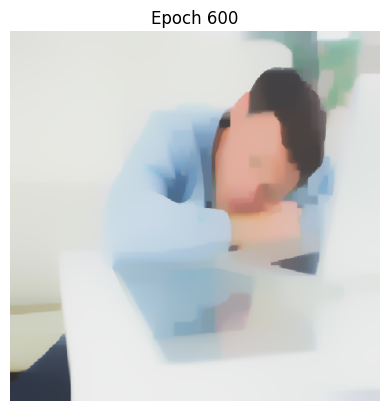

 40%|████      | 601/1500 [06:21<11:10,  1.34it/s]

Inside compute_loss:
Content Loss: 2.076001237583114e-06, Style Loss: 1.7703492630971596e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 602/1500 [06:22<09:39,  1.55it/s]

Inside compute_loss:
Content Loss: 2.077158114843769e-06, Style Loss: 1.770324342942331e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 603/1500 [06:22<09:33,  1.56it/s]

Inside compute_loss:
Content Loss: 2.07830771614681e-06, Style Loss: 1.770310518622864e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 604/1500 [06:23<09:30,  1.57it/s]

Inside compute_loss:
Content Loss: 2.079407067867578e-06, Style Loss: 1.7702979675959796e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 605/1500 [06:24<09:28,  1.57it/s]

Inside compute_loss:
Content Loss: 2.0805164240300655e-06, Style Loss: 1.770275048329495e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 606/1500 [06:24<09:23,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0817010408791248e-06, Style Loss: 1.7702497643767856e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 40%|████      | 607/1500 [06:25<09:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0828931610594736e-06, Style Loss: 1.770224298525136e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 608/1500 [06:25<09:24,  1.58it/s]

Inside compute_loss:
Content Loss: 2.084064590235357e-06, Style Loss: 1.7701999240671284e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 609/1500 [06:26<09:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0851450699410634e-06, Style Loss: 1.7701819160720333e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 610/1500 [06:27<09:20,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0862432847934542e-06, Style Loss: 1.770167909853626e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 611/1500 [06:27<09:17,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0872764707746683e-06, Style Loss: 1.7701604519970715e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 612/1500 [06:28<09:27,  1.56it/s]

Inside compute_loss:
Content Loss: 2.0882257558696438e-06, Style Loss: 1.770137168932706e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 613/1500 [06:29<09:28,  1.56it/s]

Inside compute_loss:
Content Loss: 2.089272356897709e-06, Style Loss: 1.7701204342301935e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 614/1500 [06:29<09:29,  1.56it/s]

Inside compute_loss:
Content Loss: 2.090330099235871e-06, Style Loss: 1.7701117030810565e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 615/1500 [06:30<09:30,  1.55it/s]

Inside compute_loss:
Content Loss: 2.0913209937134525e-06, Style Loss: 1.7700995158520527e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 616/1500 [06:31<09:27,  1.56it/s]

Inside compute_loss:
Content Loss: 2.0923582724208245e-06, Style Loss: 1.770082235452719e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 617/1500 [06:31<09:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0934082840540214e-06, Style Loss: 1.770073504303582e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████      | 618/1500 [06:32<09:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.094431465593516e-06, Style Loss: 1.770056042005308e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 619/1500 [06:32<09:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.0955294530722313e-06, Style Loss: 1.7700356693239883e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 620/1500 [06:33<09:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0965017029084265e-06, Style Loss: 1.7700263924780302e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 621/1500 [06:34<09:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.097402784784208e-06, Style Loss: 1.7700280295684934e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 41%|████▏     | 622/1500 [06:34<09:14,  1.58it/s]

Inside compute_loss:
Content Loss: 2.098386630677851e-06, Style Loss: 1.7700214812066406e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 623/1500 [06:35<09:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.0994232272641966e-06, Style Loss: 1.7700111129670404e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 624/1500 [06:36<09:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.100478241118253e-06, Style Loss: 1.7699894669931382e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 625/1500 [06:36<09:08,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1015428046666784e-06, Style Loss: 1.7699756426736712e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 626/1500 [06:37<09:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1025073237979086e-06, Style Loss: 1.769961090758443e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 627/1500 [06:37<09:06,  1.60it/s]

Inside compute_loss:
Content Loss: 2.1035182271589292e-06, Style Loss: 1.769948357832618e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 628/1500 [06:38<09:06,  1.60it/s]

Inside compute_loss:
Content Loss: 2.1045791527285473e-06, Style Loss: 1.7699321688269265e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 629/1500 [06:39<09:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1055907382105943e-06, Style Loss: 1.7699132513371296e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 630/1500 [06:39<09:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.106585270666983e-06, Style Loss: 1.7699039744911715e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 631/1500 [06:40<09:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.107650288962759e-06, Style Loss: 1.769885784597136e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 632/1500 [06:41<09:19,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1086882497911574e-06, Style Loss: 1.76986213773489e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 633/1500 [06:41<09:16,  1.56it/s]

Inside compute_loss:
Content Loss: 2.1097584976814687e-06, Style Loss: 1.7698512237984687e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 634/1500 [06:42<09:14,  1.56it/s]

Inside compute_loss:
Content Loss: 2.1108203327457886e-06, Style Loss: 1.7698343071970157e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 635/1500 [06:43<09:17,  1.55it/s]

Inside compute_loss:
Content Loss: 2.111833737217239e-06, Style Loss: 1.769820664776489e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 636/1500 [06:43<09:22,  1.54it/s]

Inside compute_loss:
Content Loss: 2.112745278282091e-06, Style Loss: 1.7698188457870856e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 42%|████▏     | 637/1500 [06:44<09:04,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1136836494406452e-06, Style Loss: 1.76980574906338e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 638/1500 [06:44<09:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1146354356460506e-06, Style Loss: 1.7698061128612608e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 639/1500 [06:45<09:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.115583129125298e-06, Style Loss: 1.769806294760201e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 640/1500 [06:46<09:00,  1.59it/s]

Inside compute_loss:
Content Loss: 2.116568566634669e-06, Style Loss: 1.7697786461212672e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 642/1500 [06:47<08:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1175430902076187e-06, Style Loss: 1.769762639014516e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1183525404921966e-06, Style Loss: 1.7697684597806074e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 643/1500 [06:48<08:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1192024632910034e-06, Style Loss: 1.769763184711337e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 644/1500 [06:48<08:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.120125145665952e-06, Style Loss: 1.7697622752166353e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 646/1500 [06:50<08:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.121095803886419e-06, Style Loss: 1.7697568182484247e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 647/1500 [06:50<08:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1220982944214484e-06, Style Loss: 1.7697357179713435e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1231007849564776e-06, Style Loss: 1.7697211660561152e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 648/1500 [06:51<08:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1239882244117325e-06, Style Loss: 1.769715890986845e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 649/1500 [06:51<08:58,  1.58it/s]

Inside compute_loss:
Content Loss: 2.124847242157557e-06, Style Loss: 1.769722621247638e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 650/1500 [06:52<08:58,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1257744720060145e-06, Style Loss: 1.7697171642794274e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 651/1500 [06:53<08:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1266957901389105e-06, Style Loss: 1.769710797816515e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 43%|████▎     | 652/1500 [06:53<08:56,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1275734525261214e-06, Style Loss: 1.7697013390716165e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 653/1500 [06:54<09:06,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1285579805407906e-06, Style Loss: 1.769676964613609e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 654/1500 [06:55<09:03,  1.56it/s]

Inside compute_loss:
Content Loss: 2.1294458747433964e-06, Style Loss: 1.7696760551189072e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 655/1500 [06:55<09:08,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1303389985405374e-06, Style Loss: 1.7696689610602334e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▎     | 656/1500 [06:56<09:08,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1313317120075226e-06, Style Loss: 1.7696536815492436e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 658/1500 [06:57<08:51,  1.58it/s]

Inside compute_loss:
Content Loss: 2.132283498212928e-06, Style Loss: 1.7696305803838186e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.133201860488043e-06, Style Loss: 1.7696193026495166e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 659/1500 [06:58<08:56,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1341638785088435e-06, Style Loss: 1.7696173017611727e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 660/1500 [06:58<08:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1351677332859254e-06, Style Loss: 1.7696131180855446e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 661/1500 [06:59<08:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1360951905080583e-06, Style Loss: 1.769605114532169e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 662/1500 [07:00<08:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1370285594457528e-06, Style Loss: 1.769598384271376e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 663/1500 [07:00<08:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1379642021202017e-06, Style Loss: 1.7695852875476703e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 664/1500 [07:01<08:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1388464119809214e-06, Style Loss: 1.7695920178084634e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 665/1500 [07:02<08:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1396745069068857e-06, Style Loss: 1.7695827409625053e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 666/1500 [07:02<08:42,  1.60it/s]

Inside compute_loss:
Content Loss: 2.1405869574664393e-06, Style Loss: 1.769573827914428e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 44%|████▍     | 667/1500 [07:03<08:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1414489310700446e-06, Style Loss: 1.7695649148663506e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 668/1500 [07:03<08:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.142301809726632e-06, Style Loss: 1.7695616406854242e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 669/1500 [07:04<08:40,  1.60it/s]

Inside compute_loss:
Content Loss: 2.143164010703913e-06, Style Loss: 1.7695536371320486e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 670/1500 [07:05<08:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1440459931909572e-06, Style Loss: 1.7695545466267504e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 671/1500 [07:05<08:43,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1449511677928967e-06, Style Loss: 1.7695612768875435e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 672/1500 [07:06<08:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.145787902918528e-06, Style Loss: 1.7695616406854242e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 673/1500 [07:07<08:56,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1466812540893443e-06, Style Loss: 1.7695572751108557e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▍     | 674/1500 [07:07<08:49,  1.56it/s]

Inside compute_loss:
Content Loss: 2.147633267668425e-06, Style Loss: 1.7695458154776134e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 675/1500 [07:08<09:17,  1.48it/s]

Inside compute_loss:
Content Loss: 2.1485398065124173e-06, Style Loss: 1.769531809259206e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 676/1500 [07:09<09:08,  1.50it/s]

Inside compute_loss:
Content Loss: 2.149412239305093e-06, Style Loss: 1.769524169503711e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 677/1500 [07:09<08:43,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1502962681552162e-06, Style Loss: 1.7695052520139143e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 678/1500 [07:10<08:46,  1.56it/s]

Inside compute_loss:
Content Loss: 2.1511627892323304e-06, Style Loss: 1.769504524418153e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 679/1500 [07:11<08:41,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1519097117561614e-06, Style Loss: 1.7695077985990793e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 680/1500 [07:11<08:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1526693672058173e-06, Style Loss: 1.7695121641736478e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 681/1500 [07:12<08:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.153504965463071e-06, Style Loss: 1.7695090718916617e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 45%|████▌     | 682/1500 [07:12<08:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.154373987650615e-06, Style Loss: 1.7695021597319283e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 683/1500 [07:13<08:35,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1552809812419582e-06, Style Loss: 1.769490154401865e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 684/1500 [07:14<08:32,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1562009351328015e-06, Style Loss: 1.7694790585665032e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 685/1500 [07:14<08:32,  1.59it/s]

Inside compute_loss:
Content Loss: 2.157040853489889e-06, Style Loss: 1.7694792404654436e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 686/1500 [07:15<08:34,  1.58it/s]

Inside compute_loss:
Content Loss: 2.157875996999792e-06, Style Loss: 1.7694721464067698e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 687/1500 [07:16<08:33,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1586613456747727e-06, Style Loss: 1.769473783497233e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 688/1500 [07:16<08:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1594521513179643e-06, Style Loss: 1.7694705093163066e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 689/1500 [07:17<08:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1602616016025422e-06, Style Loss: 1.7694617781671695e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 690/1500 [07:17<08:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.161080828955164e-06, Style Loss: 1.7694586858851835e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 692/1500 [07:19<08:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.161975316994358e-06, Style Loss: 1.769455411704257e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1629109596688068e-06, Style Loss: 1.7694468624540605e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▌     | 693/1500 [07:19<08:39,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1638622911268612e-06, Style Loss: 1.769428126863204e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 694/1500 [07:20<08:39,  1.55it/s]

Inside compute_loss:
Content Loss: 2.164686065952992e-06, Style Loss: 1.769427581166383e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 695/1500 [07:21<08:46,  1.53it/s]

Inside compute_loss:
Content Loss: 2.165478690585587e-06, Style Loss: 1.769432310538832e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 696/1500 [07:21<08:35,  1.56it/s]

Inside compute_loss:
Content Loss: 2.1662831386493053e-06, Style Loss: 1.7694246707833372e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 46%|████▋     | 697/1500 [07:22<08:30,  1.57it/s]

Inside compute_loss:
Content Loss: 2.167123739127419e-06, Style Loss: 1.769412847352214e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 698/1500 [07:23<08:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.167871798519627e-06, Style Loss: 1.7694172129267827e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 699/1500 [07:23<08:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.168578021155554e-06, Style Loss: 1.7694257621769793e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 700/1500 [07:24<08:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1694334009225713e-06, Style Loss: 1.769411755958572e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 700, Loss: 667.009949, Alpha: 10.0000, Beta: 10.0000


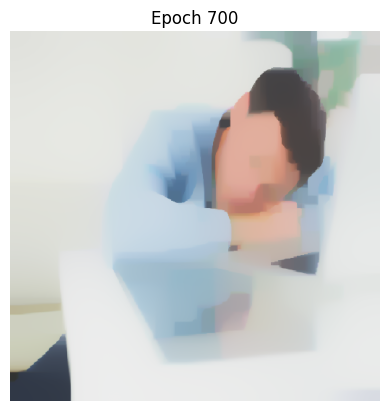

 47%|████▋     | 701/1500 [07:25<09:55,  1.34it/s]

Inside compute_loss:
Content Loss: 2.1702121557609644e-06, Style Loss: 1.7694152120384388e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 702/1500 [07:25<08:37,  1.54it/s]

Inside compute_loss:
Content Loss: 2.171041387555306e-06, Style Loss: 1.7694053894956596e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 703/1500 [07:26<08:31,  1.56it/s]

Inside compute_loss:
Content Loss: 2.1719208689319203e-06, Style Loss: 1.7693944755592383e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 704/1500 [07:27<08:28,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1727441890107e-06, Style Loss: 1.7693777408567257e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 705/1500 [07:27<08:23,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1735384052590234e-06, Style Loss: 1.769374284776859e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 706/1500 [07:28<08:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1743310298916185e-06, Style Loss: 1.769377377058845e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 708/1500 [07:29<08:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.175116151192924e-06, Style Loss: 1.7693719200906344e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 709/1500 [07:30<08:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.175944700866239e-06, Style Loss: 1.7693766494630836e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 710/1500 [07:30<08:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.176831685574143e-06, Style Loss: 1.7693770132609643e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1777145775558893e-06, Style Loss: 1.7693695554044098e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 711/1500 [07:31<08:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.178612248826539e-06, Style Loss: 1.769358459569048e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 47%|████▋     | 712/1500 [07:32<08:30,  1.54it/s]

Inside compute_loss:
Content Loss: 2.179440116378828e-06, Style Loss: 1.7693602785584517e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 713/1500 [07:32<08:24,  1.56it/s]

Inside compute_loss:
Content Loss: 2.180208184654475e-06, Style Loss: 1.7693544577923603e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 714/1500 [07:33<08:27,  1.55it/s]

Inside compute_loss:
Content Loss: 2.180962610509596e-06, Style Loss: 1.7693580957711674e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 716/1500 [07:34<08:12,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1817390916112345e-06, Style Loss: 1.769363007042557e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.182553998864023e-06, Style Loss: 1.7693555491860025e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 717/1500 [07:35<08:15,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1833509435964515e-06, Style Loss: 1.7693575500743464e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 718/1500 [07:35<08:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1841131001565373e-06, Style Loss: 1.7693582776701078e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 719/1500 [07:36<08:12,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1848848064109916e-06, Style Loss: 1.7693560948828235e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 720/1500 [07:37<08:11,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1855792056157952e-06, Style Loss: 1.7693551853881218e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 721/1500 [07:37<08:09,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1863181700609857e-06, Style Loss: 1.7693602785584517e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 722/1500 [07:38<08:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1871248918614583e-06, Style Loss: 1.769366099324543e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 723/1500 [07:39<08:11,  1.58it/s]

Inside compute_loss:
Content Loss: 2.187902509831474e-06, Style Loss: 1.769368645909708e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 724/1500 [07:39<08:09,  1.58it/s]

Inside compute_loss:
Content Loss: 2.188652388213086e-06, Style Loss: 1.7693751942715608e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 725/1500 [07:40<08:12,  1.57it/s]

Inside compute_loss:
Content Loss: 2.1895082227274543e-06, Style Loss: 1.7693628251436166e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 726/1500 [07:40<08:06,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1902937987761106e-06, Style Loss: 1.769351729308255e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 48%|████▊     | 727/1500 [07:41<08:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1910730083618546e-06, Style Loss: 1.769348637026269e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 728/1500 [07:42<08:04,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1918856418778887e-06, Style Loss: 1.7693473637336865e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 729/1500 [07:42<08:04,  1.59it/s]

Inside compute_loss:
Content Loss: 2.192697365899221e-06, Style Loss: 1.7693546396913007e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 730/1500 [07:43<08:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.193566842834116e-06, Style Loss: 1.7693371773930266e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▊     | 731/1500 [07:44<08:06,  1.58it/s]

Inside compute_loss:
Content Loss: 2.194351282014395e-06, Style Loss: 1.7693295376375318e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 732/1500 [07:44<08:15,  1.55it/s]

Inside compute_loss:
Content Loss: 2.1950952486804454e-06, Style Loss: 1.7693360859993845e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 733/1500 [07:45<08:12,  1.56it/s]

Inside compute_loss:
Content Loss: 2.19582352656289e-06, Style Loss: 1.769346090441104e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 734/1500 [07:46<08:16,  1.54it/s]

Inside compute_loss:
Content Loss: 2.1965747691865545e-06, Style Loss: 1.7693428162601776e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 735/1500 [07:46<08:18,  1.53it/s]

Inside compute_loss:
Content Loss: 2.197279854954104e-06, Style Loss: 1.7693482732283883e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 737/1500 [07:47<08:00,  1.59it/s]

Inside compute_loss:
Content Loss: 2.1978992208460113e-06, Style Loss: 1.7693600966595113e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.1987077616358874e-06, Style Loss: 1.7693580957711674e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 738/1500 [07:48<08:01,  1.58it/s]

Inside compute_loss:
Content Loss: 2.1995097085891757e-06, Style Loss: 1.769351729308255e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 739/1500 [07:49<07:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.200311200795113e-06, Style Loss: 1.7693519112071954e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 740/1500 [07:49<07:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2010387965565315e-06, Style Loss: 1.7693602785584517e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 741/1500 [07:50<07:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2017304672772298e-06, Style Loss: 1.769372283888515e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 49%|████▉     | 742/1500 [07:51<08:00,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2023843939678045e-06, Style Loss: 1.7693733752821572e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 743/1500 [07:51<07:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.203093572461512e-06, Style Loss: 1.7693802874418907e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 744/1500 [07:52<07:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2037490907678148e-06, Style Loss: 1.7693946574581787e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 745/1500 [07:52<07:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2044405341148376e-06, Style Loss: 1.769396294548642e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 746/1500 [07:53<07:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2051810901757563e-06, Style Loss: 1.769411755958572e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 747/1500 [07:54<07:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.205929831688991e-06, Style Loss: 1.7694082998787053e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 748/1500 [07:54<07:54,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2066417386668036e-06, Style Loss: 1.7694139387458563e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|████▉     | 749/1500 [07:55<07:54,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2073393211030634e-06, Style Loss: 1.7694283087621443e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 750/1500 [07:56<07:53,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2081467250245623e-06, Style Loss: 1.7694237612886354e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 751/1500 [07:56<07:58,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2089886897447286e-06, Style Loss: 1.7694273992674425e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 752/1500 [07:57<07:58,  1.56it/s]

Inside compute_loss:
Content Loss: 2.209736294389586e-06, Style Loss: 1.769426671671681e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 753/1500 [07:58<07:59,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2104061372374417e-06, Style Loss: 1.7694350390229374e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 754/1500 [07:58<08:00,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2111585167294834e-06, Style Loss: 1.7694401321932673e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 755/1500 [07:59<08:04,  1.54it/s]

Inside compute_loss:
Content Loss: 2.211829269072041e-06, Style Loss: 1.7694352209218778e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 756/1500 [08:00<07:52,  1.58it/s]

Inside compute_loss:
Content Loss: 2.212557774328161e-06, Style Loss: 1.7694426787784323e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 50%|█████     | 757/1500 [08:00<07:49,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2134261143946787e-06, Style Loss: 1.7694268535706215e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 758/1500 [08:01<07:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2142212401377037e-06, Style Loss: 1.7694330381345935e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 759/1500 [08:01<07:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.214966798419482e-06, Style Loss: 1.7694403140922077e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 760/1500 [08:02<07:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.215718268416822e-06, Style Loss: 1.7694381313049234e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 761/1500 [08:03<07:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2163560515764402e-06, Style Loss: 1.7694426787784323e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 762/1500 [08:03<07:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.217039764218498e-06, Style Loss: 1.7694432244752534e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 763/1500 [08:04<07:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2177407572598895e-06, Style Loss: 1.7694421330816112e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 764/1500 [08:05<07:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2184005956660258e-06, Style Loss: 1.7694608686724678e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 765/1500 [08:05<07:52,  1.56it/s]

Inside compute_loss:
Content Loss: 2.219180487372796e-06, Style Loss: 1.7694632333586924e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 766/1500 [08:06<07:51,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2199465092853643e-06, Style Loss: 1.7694765119813383e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 767/1500 [08:07<07:55,  1.54it/s]

Inside compute_loss:
Content Loss: 2.2206770609045634e-06, Style Loss: 1.7694888811092824e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████     | 768/1500 [08:07<07:53,  1.54it/s]

Inside compute_loss:
Content Loss: 2.221361228293972e-06, Style Loss: 1.769495793269016e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 769/1500 [08:08<07:52,  1.55it/s]

Inside compute_loss:
Content Loss: 2.22200401367445e-06, Style Loss: 1.769496884662658e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 770/1500 [08:08<07:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2226865894481307e-06, Style Loss: 1.7694925190880895e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 771/1500 [08:09<07:49,  1.55it/s]

Inside compute_loss:
Content Loss: 2.223390083599952e-06, Style Loss: 1.7694903363008052e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 51%|█████▏    | 772/1500 [08:10<07:45,  1.56it/s]

Inside compute_loss:
Content Loss: 2.224072886747308e-06, Style Loss: 1.7694976122584194e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 773/1500 [08:10<07:47,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2247502329264535e-06, Style Loss: 1.7695165297482163e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 774/1500 [08:11<07:47,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2255260319070658e-06, Style Loss: 1.769514892657753e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 775/1500 [08:12<07:39,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2262590846366948e-06, Style Loss: 1.7695121641736478e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 776/1500 [08:12<07:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2269771307037445e-06, Style Loss: 1.7695116184768267e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 777/1500 [08:13<07:35,  1.59it/s]

Inside compute_loss:
Content Loss: 2.227677668997785e-06, Style Loss: 1.769517984939739e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 778/1500 [08:13<07:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2283340967987897e-06, Style Loss: 1.769526716088876e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 779/1500 [08:14<07:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2290446395345498e-06, Style Loss: 1.7695398128125817e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 780/1500 [08:15<07:32,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2298161184153287e-06, Style Loss: 1.7695365386316553e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 781/1500 [08:15<07:32,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2304664071270963e-06, Style Loss: 1.769547088770196e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 782/1500 [08:16<07:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.23112488129118e-06, Style Loss: 1.7695616406854242e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 784/1500 [08:17<07:28,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2318624814943178e-06, Style Loss: 1.7695590941002592e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2325286863633664e-06, Style Loss: 1.7695703718345612e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 785/1500 [08:18<07:27,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2331212221615715e-06, Style Loss: 1.7695942005957477e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 786/1500 [08:19<07:26,  1.60it/s]

Inside compute_loss:
Content Loss: 2.233800159956445e-06, Style Loss: 1.7696018403512426e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 52%|█████▏    | 787/1500 [08:19<07:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.234463408967713e-06, Style Loss: 1.7696125723887235e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 788/1500 [08:20<07:26,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2351912321028067e-06, Style Loss: 1.76962112163892e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 789/1500 [08:20<07:25,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2359492959367344e-06, Style Loss: 1.7696043869364075e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 790/1500 [08:21<07:24,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2366168650478357e-06, Style Loss: 1.7696078430162743e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 791/1500 [08:22<07:34,  1.56it/s]

Inside compute_loss:
Content Loss: 2.237374701508088e-06, Style Loss: 1.7696072973194532e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 792/1500 [08:22<07:31,  1.57it/s]

Inside compute_loss:
Content Loss: 2.238166189272306e-06, Style Loss: 1.7696125723887235e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 793/1500 [08:23<07:31,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2389037894754438e-06, Style Loss: 1.769618393154815e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 794/1500 [08:24<07:38,  1.54it/s]

Inside compute_loss:
Content Loss: 2.239659124825266e-06, Style Loss: 1.76962112163892e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 795/1500 [08:24<07:29,  1.57it/s]

Inside compute_loss:
Content Loss: 2.240320327473455e-06, Style Loss: 1.7696345821605064e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 797/1500 [08:25<07:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2409915345633635e-06, Style Loss: 1.7696314898785204e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2416645606426755e-06, Style Loss: 1.7696365830488503e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 798/1500 [08:26<07:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.242288019260741e-06, Style Loss: 1.7696664144750684e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 799/1500 [08:27<07:22,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2429553609981667e-06, Style Loss: 1.7696653230814263e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 800/1500 [08:27<07:21,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2437020561483223e-06, Style Loss: 1.769670780049637e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 800, Loss: 634.878296, Alpha: 10.0000, Beta: 10.0000


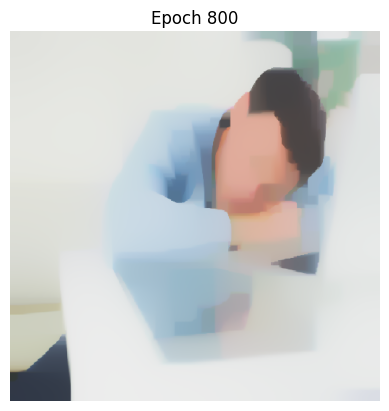

 53%|█████▎    | 801/1500 [08:28<08:41,  1.34it/s]

Inside compute_loss:
Content Loss: 2.244454435640364e-06, Style Loss: 1.769674418028444e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 53%|█████▎    | 802/1500 [08:29<07:32,  1.54it/s]

Inside compute_loss:
Content Loss: 2.2451179120253073e-06, Style Loss: 1.7696853319648653e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 803/1500 [08:29<07:29,  1.55it/s]

Inside compute_loss:
Content Loss: 2.245813902845839e-06, Style Loss: 1.769688242347911e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 804/1500 [08:30<07:23,  1.57it/s]

Inside compute_loss:
Content Loss: 2.2465876554633724e-06, Style Loss: 1.7696931536193006e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 805/1500 [08:31<07:20,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2473632270703092e-06, Style Loss: 1.7696807844913565e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▎    | 806/1500 [08:31<07:20,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2480737698060693e-06, Style Loss: 1.7696847862680443e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 807/1500 [08:32<07:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.248734745080583e-06, Style Loss: 1.7696900613373145e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 808/1500 [08:33<07:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2494193672173424e-06, Style Loss: 1.769691880326718e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 809/1500 [08:33<07:14,  1.59it/s]

Inside compute_loss:
Content Loss: 2.249985982416547e-06, Style Loss: 1.7696957002044655e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 810/1500 [08:34<07:13,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2506276309286477e-06, Style Loss: 1.7697073417366482e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 811/1500 [08:35<07:25,  1.55it/s]

Inside compute_loss:
Content Loss: 2.251297246402828e-06, Style Loss: 1.769713890098501e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 812/1500 [08:35<07:22,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2518765945278574e-06, Style Loss: 1.7697229850455187e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 813/1500 [08:36<07:19,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2524907308252295e-06, Style Loss: 1.769741538737435e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 814/1500 [08:36<07:22,  1.55it/s]

Inside compute_loss:
Content Loss: 2.253146476505208e-06, Style Loss: 1.76975954673253e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 815/1500 [08:37<07:10,  1.59it/s]

Inside compute_loss:
Content Loss: 2.253788352390984e-06, Style Loss: 1.7697706425678916e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 816/1500 [08:38<07:12,  1.58it/s]

Inside compute_loss:
Content Loss: 2.254532091683359e-06, Style Loss: 1.7697686416795477e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 54%|█████▍    | 817/1500 [08:38<07:07,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2552342215931276e-06, Style Loss: 1.7697724615572952e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 818/1500 [08:39<07:07,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2559661374543793e-06, Style Loss: 1.769775371940341e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 819/1500 [08:40<07:08,  1.59it/s]

Inside compute_loss:
Content Loss: 2.256733978356351e-06, Style Loss: 1.7697771909297444e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 820/1500 [08:40<07:06,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2574349713977426e-06, Style Loss: 1.769786285876762e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 821/1500 [08:41<07:06,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2581300527235726e-06, Style Loss: 1.7697899238555692e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 822/1500 [08:41<07:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2588039882975863e-06, Style Loss: 1.7697941075311974e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 823/1500 [08:42<07:04,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2594817892240826e-06, Style Loss: 1.7697973817121238e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▍    | 824/1500 [08:43<07:04,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2601348064199556e-06, Style Loss: 1.7698079318506643e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 825/1500 [08:43<07:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2607976006838726e-06, Style Loss: 1.7698162992019206e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 826/1500 [08:44<07:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.261516101498273e-06, Style Loss: 1.769811933627352e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 827/1500 [08:45<07:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.262265070385183e-06, Style Loss: 1.7698090232443064e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 828/1500 [08:45<07:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.262982661704882e-06, Style Loss: 1.769811933627352e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 829/1500 [08:46<07:04,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2636404537479393e-06, Style Loss: 1.7698268493404612e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 830/1500 [08:46<07:00,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2643439478997607e-06, Style Loss: 1.769824666553177e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 831/1500 [08:47<07:08,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2651088329439517e-06, Style Loss: 1.7698299416224472e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 55%|█████▌    | 832/1500 [08:48<07:06,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2657493445876753e-06, Style Loss: 1.769825212249998e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 833/1500 [08:48<07:11,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2664087282464607e-06, Style Loss: 1.7698412193567492e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 835/1500 [08:50<06:56,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2672027171211084e-06, Style Loss: 1.7698366718832403e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 836/1500 [08:50<06:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2678884761262452e-06, Style Loss: 1.7698455849313177e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2685396743327146e-06, Style Loss: 1.7698599549476057e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 837/1500 [08:51<06:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2691822323395172e-06, Style Loss: 1.769868322298862e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 838/1500 [08:52<06:57,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2698000066156965e-06, Style Loss: 1.7698808733257465e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 839/1500 [08:52<06:55,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2704259663441917e-06, Style Loss: 1.7698819647193886e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 840/1500 [08:53<06:57,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2711287783749867e-06, Style Loss: 1.769895970937796e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 841/1500 [08:53<06:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2717874799127458e-06, Style Loss: 1.769905793480575e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 842/1500 [08:54<06:55,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2724993868905585e-06, Style Loss: 1.7699147065286525e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▌    | 843/1500 [08:55<06:53,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2731071567250183e-06, Style Loss: 1.769932896422688e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 844/1500 [08:55<06:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.273765176141751e-06, Style Loss: 1.7699456293485127e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 845/1500 [08:56<06:50,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2745086880604504e-06, Style Loss: 1.769950358720962e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 846/1500 [08:57<06:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2751432879886124e-06, Style Loss: 1.7699587260722183e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 56%|█████▋    | 847/1500 [08:57<06:50,  1.59it/s]

Inside compute_loss:
Content Loss: 2.275731048939633e-06, Style Loss: 1.7699761883704923e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 848/1500 [08:58<06:47,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2762544631405035e-06, Style Loss: 1.769997106748633e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 849/1500 [08:58<06:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2768581402488053e-06, Style Loss: 1.7700162061373703e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 850/1500 [08:59<06:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2775102479499765e-06, Style Loss: 1.770024755387567e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 851/1500 [09:00<06:57,  1.55it/s]

Inside compute_loss:
Content Loss: 2.2781639472668758e-06, Style Loss: 1.7700353055261075e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 852/1500 [09:00<06:55,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2789201921114e-06, Style Loss: 1.770034032233525e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 853/1500 [09:01<06:57,  1.55it/s]

Inside compute_loss:
Content Loss: 2.27955888476572e-06, Style Loss: 1.77004167198902e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 854/1500 [09:02<07:00,  1.54it/s]

Inside compute_loss:
Content Loss: 2.2801807517680572e-06, Style Loss: 1.7700553144095466e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 855/1500 [09:02<06:48,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2807482764619635e-06, Style Loss: 1.770063317962922e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 856/1500 [09:03<06:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2813478608441073e-06, Style Loss: 1.770074595697224e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 857/1500 [09:04<06:45,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2819388050265843e-06, Style Loss: 1.7700851458357647e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 858/1500 [09:04<06:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2825599899078952e-06, Style Loss: 1.7701015167403966e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 859/1500 [09:05<06:44,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2832346076029353e-06, Style Loss: 1.7700982425594702e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 860/1500 [09:05<06:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2839210487290984e-06, Style Loss: 1.770105882314965e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 861/1500 [09:06<06:40,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2846345473226393e-06, Style Loss: 1.7701111573842354e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 57%|█████▋    | 862/1500 [09:07<06:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2852134407003177e-06, Style Loss: 1.770125891198404e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 863/1500 [09:07<06:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.285835762450006e-06, Style Loss: 1.77013407665072e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 864/1500 [09:08<06:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2864751372253522e-06, Style Loss: 1.7701557226246223e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 865/1500 [09:09<06:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.287095639985637e-06, Style Loss: 1.7701831893646158e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 866/1500 [09:09<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.287763209096738e-06, Style Loss: 1.770186827343423e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 867/1500 [09:10<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2884876216267003e-06, Style Loss: 1.7701964679872617e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 868/1500 [09:10<06:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.289177928105346e-06, Style Loss: 1.7701999240671284e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 869/1500 [09:11<06:35,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2897834242030513e-06, Style Loss: 1.7702106561046094e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 870/1500 [09:12<06:37,  1.58it/s]

Inside compute_loss:
Content Loss: 2.2904539491719333e-06, Style Loss: 1.7702121112961322e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 871/1500 [09:12<06:44,  1.55it/s]

Inside compute_loss:
Content Loss: 2.291075588800595e-06, Style Loss: 1.7702281184028834e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 872/1500 [09:13<06:42,  1.56it/s]

Inside compute_loss:
Content Loss: 2.2917504338693107e-06, Style Loss: 1.7702257537166588e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 873/1500 [09:14<06:53,  1.52it/s]

Inside compute_loss:
Content Loss: 2.292418002980412e-06, Style Loss: 1.7702272089081816e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 874/1500 [09:14<06:47,  1.53it/s]

Inside compute_loss:
Content Loss: 2.2930778413865482e-06, Style Loss: 1.770238668541424e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 875/1500 [09:15<06:30,  1.60it/s]

Inside compute_loss:
Content Loss: 2.293703573741368e-06, Style Loss: 1.77024176082341e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 876/1500 [09:16<06:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2942269879422383e-06, Style Loss: 1.770261769706849e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 58%|█████▊    | 877/1500 [09:16<06:30,  1.60it/s]

Inside compute_loss:
Content Loss: 2.294697651450406e-06, Style Loss: 1.7702852346701548e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 878/1500 [09:17<06:30,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2952642666496104e-06, Style Loss: 1.7703066987451166e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 879/1500 [09:17<06:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.295824742759578e-06, Style Loss: 1.7703234334476292e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▊    | 880/1500 [09:18<06:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.296415232194704e-06, Style Loss: 1.7703354387776926e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 882/1500 [09:19<06:26,  1.60it/s]

Inside compute_loss:
Content Loss: 2.2970468762650853e-06, Style Loss: 1.7703547200653702e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.2977876596996794e-06, Style Loss: 1.7703579942462966e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 883/1500 [09:20<06:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.2985420855548e-06, Style Loss: 1.7703543562674895e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 884/1500 [09:21<06:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.299159632457304e-06, Style Loss: 1.770361814124044e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 885/1500 [09:21<06:25,  1.60it/s]

Inside compute_loss:
Content Loss: 2.299700327057508e-06, Style Loss: 1.770384369592648e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 886/1500 [09:22<06:24,  1.60it/s]

Inside compute_loss:
Content Loss: 2.3002696707408177e-06, Style Loss: 1.770400194800459e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 887/1500 [09:23<06:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.300934056620463e-06, Style Loss: 1.770408562151715e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 888/1500 [09:23<06:23,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3015520582703175e-06, Style Loss: 1.770424387359526e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 889/1500 [09:24<06:23,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3020336357149063e-06, Style Loss: 1.7704354831948876e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 890/1500 [09:24<06:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.302573648194084e-06, Style Loss: 1.7704544006846845e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 891/1500 [09:25<06:33,  1.55it/s]

Inside compute_loss:
Content Loss: 2.303177552676061e-06, Style Loss: 1.7704744095681235e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 59%|█████▉    | 892/1500 [09:26<06:29,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3038983272272162e-06, Style Loss: 1.7704755009617656e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 893/1500 [09:26<06:30,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3045720354275545e-06, Style Loss: 1.7704882338875905e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 894/1500 [09:27<06:34,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3052014057611814e-06, Style Loss: 1.7704927813610993e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 895/1500 [09:28<06:21,  1.59it/s]

Inside compute_loss:
Content Loss: 2.305908083144459e-06, Style Loss: 1.7705015125102364e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 897/1500 [09:29<06:19,  1.59it/s]

Inside compute_loss:
Content Loss: 2.306577016497613e-06, Style Loss: 1.7705047866911627e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3072796011547325e-06, Style Loss: 1.7705009668134153e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|█████▉    | 899/1500 [09:30<06:17,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3079714992491063e-06, Style Loss: 1.770508060872089e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3086759028956294e-06, Style Loss: 1.7705078789731488e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 900/1500 [09:31<06:18,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3092561605153605e-06, Style Loss: 1.7705166101222858e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 900, Loss: 607.549255, Alpha: 10.0000, Beta: 10.0000


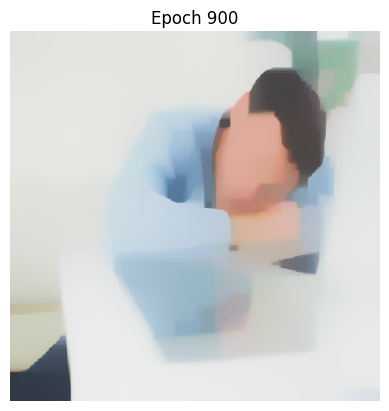

 60%|██████    | 901/1500 [09:32<07:27,  1.34it/s]

Inside compute_loss:
Content Loss: 2.309825731572346e-06, Style Loss: 1.7705398931866512e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 902/1500 [09:32<06:27,  1.54it/s]

Inside compute_loss:
Content Loss: 2.310396212124033e-06, Style Loss: 1.7705477148410864e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 903/1500 [09:33<06:21,  1.56it/s]

Inside compute_loss:
Content Loss: 2.310987838427536e-06, Style Loss: 1.7705544451018795e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 904/1500 [09:33<06:18,  1.57it/s]

Inside compute_loss:
Content Loss: 2.31166427511198e-06, Style Loss: 1.7705586287775077e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 905/1500 [09:34<06:16,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3123373011912918e-06, Style Loss: 1.7705679056234658e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 906/1500 [09:35<06:14,  1.59it/s]

Inside compute_loss:
Content Loss: 2.312993956365972e-06, Style Loss: 1.770571543602273e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 60%|██████    | 907/1500 [09:35<06:14,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3136210529628443e-06, Style Loss: 1.7705846403259784e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 908/1500 [09:36<06:12,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3142285954236286e-06, Style Loss: 1.7706099242786877e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 909/1500 [09:37<06:12,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3148913896875456e-06, Style Loss: 1.7706210201140493e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 910/1500 [09:37<06:20,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3156003408075776e-06, Style Loss: 1.770627022779081e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 911/1500 [09:38<06:17,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3161924218584318e-06, Style Loss: 1.7706373910186812e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 912/1500 [09:39<06:17,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3167442577687325e-06, Style Loss: 1.7706590369925834e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 913/1500 [09:39<06:18,  1.55it/s]

Inside compute_loss:
Content Loss: 2.317403186680167e-06, Style Loss: 1.7706646758597344e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 914/1500 [09:40<06:15,  1.56it/s]

Inside compute_loss:
Content Loss: 2.317991629752214e-06, Style Loss: 1.7706774087855592e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 915/1500 [09:40<06:08,  1.59it/s]

Inside compute_loss:
Content Loss: 2.318580072824261e-06, Style Loss: 1.7706981452647597e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 916/1500 [09:41<06:07,  1.59it/s]

Inside compute_loss:
Content Loss: 2.319139184692176e-06, Style Loss: 1.7707168808556162e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 917/1500 [09:42<06:06,  1.59it/s]

Inside compute_loss:
Content Loss: 2.319648501725169e-06, Style Loss: 1.7707416191115044e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████    | 918/1500 [09:42<06:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3201735075417673e-06, Style Loss: 1.7707636288832873e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 919/1500 [09:43<06:05,  1.59it/s]

Inside compute_loss:
Content Loss: 2.320819703527377e-06, Style Loss: 1.7707714505377226e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 920/1500 [09:44<06:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.321464990018285e-06, Style Loss: 1.7707832739688456e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 921/1500 [09:44<06:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3220989078254206e-06, Style Loss: 1.7708011000650004e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 61%|██████▏   | 922/1500 [09:45<06:02,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3227266865433194e-06, Style Loss: 1.770826020219829e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 923/1500 [09:45<06:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3234331365529215e-06, Style Loss: 1.770838935044594e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 924/1500 [09:46<06:00,  1.60it/s]

Inside compute_loss:
Content Loss: 2.3241796043294016e-06, Style Loss: 1.770842391124461e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 925/1500 [09:47<06:01,  1.59it/s]

Inside compute_loss:
Content Loss: 2.324828301425441e-06, Style Loss: 1.7708529412630014e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 926/1500 [09:47<06:00,  1.59it/s]

Inside compute_loss:
Content Loss: 2.325481773368665e-06, Style Loss: 1.770855305949226e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 927/1500 [09:48<06:01,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3260868147190195e-06, Style Loss: 1.770862945704721e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 929/1500 [09:49<05:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.32673096434155e-06, Style Loss: 1.7708698578644544e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3273989882000023e-06, Style Loss: 1.7708856830722652e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 930/1500 [09:50<06:09,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3280290406546555e-06, Style Loss: 1.7708951418171637e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 931/1500 [09:51<06:03,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3286481791728875e-06, Style Loss: 1.770919334376231e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 932/1500 [09:51<06:02,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3292463993129786e-06, Style Loss: 1.7709171515889466e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 933/1500 [09:52<06:06,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3298348423850257e-06, Style Loss: 1.7709238818497397e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 934/1500 [09:52<06:04,  1.55it/s]

Inside compute_loss:
Content Loss: 2.330456709387363e-06, Style Loss: 1.7709338862914592e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 935/1500 [09:53<05:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3311183667829027e-06, Style Loss: 1.770944072632119e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 936/1500 [09:54<05:53,  1.60it/s]

Inside compute_loss:
Content Loss: 2.331651558051817e-06, Style Loss: 1.7709631720208563e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 62%|██████▏   | 937/1500 [09:54<05:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3321777007367928e-06, Style Loss: 1.77098045242019e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 938/1500 [09:55<05:54,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3327625058300328e-06, Style Loss: 1.7709980966174044e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 939/1500 [09:56<05:54,  1.58it/s]

Inside compute_loss:
Content Loss: 2.333370957785519e-06, Style Loss: 1.771003007888794e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 940/1500 [09:56<05:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.334077862542472e-06, Style Loss: 1.7710088286548853e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 941/1500 [09:57<05:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.334727923880564e-06, Style Loss: 1.7710264728520997e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 942/1500 [09:57<05:51,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3352524749498116e-06, Style Loss: 1.7710406609694473e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 943/1500 [09:58<05:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3358404632745078e-06, Style Loss: 1.771049210219644e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 944/1500 [09:59<05:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3364552816929063e-06, Style Loss: 1.7710633983369917e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 945/1500 [09:59<05:48,  1.59it/s]

Inside compute_loss:
Content Loss: 2.337057821932831e-06, Style Loss: 1.7710741303744726e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 946/1500 [10:00<05:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3377276647806866e-06, Style Loss: 1.7710770407575183e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 947/1500 [10:01<05:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3383581719826907e-06, Style Loss: 1.7710941392579116e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 949/1500 [10:02<05:44,  1.60it/s]

Inside compute_loss:
Content Loss: 2.33893752010772e-06, Style Loss: 1.771110328263603e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.339528919037548e-06, Style Loss: 1.771119423210621e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 950/1500 [10:02<05:44,  1.60it/s]

Inside compute_loss:
Content Loss: 2.34016602007614e-06, Style Loss: 1.7711332475300878e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 951/1500 [10:03<05:52,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3408126708091004e-06, Style Loss: 1.771143070072867e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 63%|██████▎   | 952/1500 [10:04<05:50,  1.56it/s]

Inside compute_loss:
Content Loss: 2.341394747418235e-06, Style Loss: 1.7711556210997514e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 953/1500 [10:04<05:51,  1.56it/s]

Inside compute_loss:
Content Loss: 2.341984099984984e-06, Style Loss: 1.7711627151584253e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 954/1500 [10:05<05:53,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3426430288964184e-06, Style Loss: 1.771182542142924e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 955/1500 [10:06<05:41,  1.60it/s]

Inside compute_loss:
Content Loss: 2.3433042315446073e-06, Style Loss: 1.771196366462391e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▎   | 956/1500 [10:06<05:42,  1.59it/s]

Inside compute_loss:
Content Loss: 2.343906317037181e-06, Style Loss: 1.771204188116826e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 957/1500 [10:07<05:41,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3444279122486478e-06, Style Loss: 1.771227289282251e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 958/1500 [10:08<05:41,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3450254502677126e-06, Style Loss: 1.7712491171550937e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 959/1500 [10:08<05:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.345612074350356e-06, Style Loss: 1.7712558474158868e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 960/1500 [10:09<05:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.346212795600877e-06, Style Loss: 1.7712756744003855e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 961/1500 [10:09<05:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.346776454942301e-06, Style Loss: 1.7712931366986595e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 962/1500 [10:10<05:36,  1.60it/s]

Inside compute_loss:
Content Loss: 2.347423333048937e-06, Style Loss: 1.7713075067149475e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 963/1500 [10:11<05:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.347987219764036e-06, Style Loss: 1.77131896634819e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 964/1500 [10:11<05:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.34860476666654e-06, Style Loss: 1.771343704604078e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 965/1500 [10:12<05:36,  1.59it/s]

Inside compute_loss:
Content Loss: 2.349141368540586e-06, Style Loss: 1.7713608031044714e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 64%|██████▍   | 967/1500 [10:13<05:34,  1.60it/s]

Inside compute_loss:
Content Loss: 2.3496027097280603e-06, Style Loss: 1.7713762645144016e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3500992938352283e-06, Style Loss: 1.771391907823272e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 968/1500 [10:14<05:35,  1.58it/s]

Inside compute_loss:
Content Loss: 2.350747536183917e-06, Style Loss: 1.771398092387244e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 969/1500 [10:14<05:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.351536522837705e-06, Style Loss: 1.7713993656798266e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 970/1500 [10:15<05:33,  1.59it/s]

Inside compute_loss:
Content Loss: 2.352194769628113e-06, Style Loss: 1.7714235582388937e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 971/1500 [10:16<05:41,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3529034933744697e-06, Style Loss: 1.7714304703986272e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 972/1500 [10:16<05:37,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3535205855296226e-06, Style Loss: 1.771433380781673e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 973/1500 [10:17<05:42,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3540812890132656e-06, Style Loss: 1.771443203324452e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▍   | 974/1500 [10:18<05:43,  1.53it/s]

Inside compute_loss:
Content Loss: 2.3546178908873117e-06, Style Loss: 1.7714639398036525e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 975/1500 [10:18<05:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3551999674964463e-06, Style Loss: 1.7714810383040458e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 976/1500 [10:19<05:30,  1.58it/s]

Inside compute_loss:
Content Loss: 2.355699507461395e-06, Style Loss: 1.771500137692783e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 977/1500 [10:20<05:29,  1.59it/s]

Inside compute_loss:
Content Loss: 2.356227241762099e-06, Style Loss: 1.771506322256755e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 978/1500 [10:20<05:28,  1.59it/s]

Inside compute_loss:
Content Loss: 2.356829099880997e-06, Style Loss: 1.7715186913846992e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 979/1500 [10:21<05:28,  1.58it/s]

Inside compute_loss:
Content Loss: 2.357447783651878e-06, Style Loss: 1.7715343346935697e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 980/1500 [10:21<05:27,  1.59it/s]

Inside compute_loss:
Content Loss: 2.358004394409363e-06, Style Loss: 1.7715492504066788e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 65%|██████▌   | 982/1500 [10:23<05:25,  1.59it/s]

Inside compute_loss:
Content Loss: 2.358617393838358e-06, Style Loss: 1.7715738067636266e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 983/1500 [10:23<05:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3593429432366975e-06, Style Loss: 1.771574534359388e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3600600798090454e-06, Style Loss: 1.771581628418062e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 984/1500 [10:24<05:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.360668759138207e-06, Style Loss: 1.7715952708385885e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 985/1500 [10:25<05:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.36128585129336e-06, Style Loss: 1.7716056390781887e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 986/1500 [10:25<05:24,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3619213607162237e-06, Style Loss: 1.7716267393552698e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 987/1500 [10:26<05:26,  1.57it/s]

Inside compute_loss:
Content Loss: 2.362593022553483e-06, Style Loss: 1.771634561009705e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 988/1500 [10:27<05:22,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3632303509657504e-06, Style Loss: 1.771657116478309e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 990/1500 [10:28<05:19,  1.60it/s]

Inside compute_loss:
Content Loss: 2.3638278889848152e-06, Style Loss: 1.7716813090373762e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.364453166592284e-06, Style Loss: 1.771707320585847e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 991/1500 [10:28<05:27,  1.56it/s]

Inside compute_loss:
Content Loss: 2.365138925597421e-06, Style Loss: 1.7717187802190892e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 992/1500 [10:29<05:27,  1.55it/s]

Inside compute_loss:
Content Loss: 2.36575920098403e-06, Style Loss: 1.771731513144914e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▌   | 993/1500 [10:30<05:24,  1.56it/s]

Inside compute_loss:
Content Loss: 2.366373337281402e-06, Style Loss: 1.7717373339110054e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 994/1500 [10:30<05:31,  1.53it/s]

Inside compute_loss:
Content Loss: 2.3669738311582478e-06, Style Loss: 1.7717527953209355e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 995/1500 [10:31<05:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3675349893892417e-06, Style Loss: 1.771760798874311e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 996/1500 [10:32<05:16,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3680734102526912e-06, Style Loss: 1.771772986103315e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 66%|██████▋   | 997/1500 [10:32<05:17,  1.58it/s]

Inside compute_loss:
Content Loss: 2.36857295021764e-06, Style Loss: 1.7717968148645014e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 998/1500 [10:33<05:15,  1.59it/s]

Inside compute_loss:
Content Loss: 2.369218691455899e-06, Style Loss: 1.7718044546199962e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 999/1500 [10:34<05:14,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3699119537923252e-06, Style Loss: 1.771811002981849e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1000/1500 [10:34<05:14,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3705426883680047e-06, Style Loss: 1.771814640960656e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Epoch 1000, Loss: 583.636108, Alpha: 10.0000, Beta: 10.0000


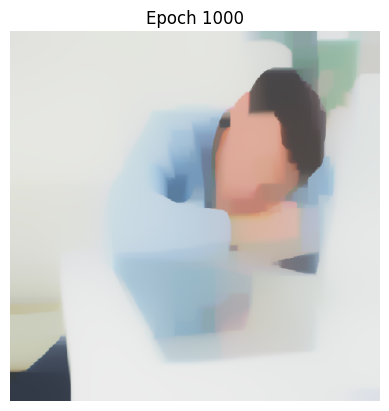

 67%|██████▋   | 1001/1500 [10:35<06:11,  1.34it/s]

Inside compute_loss:
Content Loss: 2.371205710005597e-06, Style Loss: 1.771839743014425e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1002/1500 [10:36<05:24,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3718328066024696e-06, Style Loss: 1.77185247594025e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1003/1500 [10:36<05:18,  1.56it/s]

Inside compute_loss:
Content Loss: 2.372434209974017e-06, Style Loss: 1.7718579329084605e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1004/1500 [10:37<05:16,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3729567146801855e-06, Style Loss: 1.7718686649459414e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1005/1500 [10:37<05:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3734610294923186e-06, Style Loss: 1.771886491042096e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1006/1500 [10:38<05:13,  1.58it/s]

Inside compute_loss:
Content Loss: 2.374017867623479e-06, Style Loss: 1.771900315361563e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1007/1500 [10:39<05:11,  1.58it/s]

Inside compute_loss:
Content Loss: 2.374631321799825e-06, Style Loss: 1.771915049175732e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1008/1500 [10:39<05:11,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3753232198941987e-06, Style Loss: 1.7719308743835427e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1009/1500 [10:40<05:09,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3759885152685456e-06, Style Loss: 1.7719385141390376e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1010/1500 [10:41<05:15,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3766322101437254e-06, Style Loss: 1.771962342900224e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1011/1500 [10:41<05:13,  1.56it/s]

Inside compute_loss:
Content Loss: 2.3772806798660895e-06, Style Loss: 1.771978168108035e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 67%|██████▋   | 1012/1500 [10:42<05:14,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3779541606927523e-06, Style Loss: 1.7719914467306808e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1013/1500 [10:43<05:16,  1.54it/s]

Inside compute_loss:
Content Loss: 2.378451654294622e-06, Style Loss: 1.772011091816239e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1014/1500 [10:43<05:08,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3790105387888616e-06, Style Loss: 1.7720267351251096e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1015/1500 [10:44<05:08,  1.57it/s]

Inside compute_loss:
Content Loss: 2.3796451387170237e-06, Style Loss: 1.7720371033647098e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1016/1500 [10:44<05:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.380175828875508e-06, Style Loss: 1.7720565665513277e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1017/1500 [10:45<05:05,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3806314857210964e-06, Style Loss: 1.772077666828409e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1018/1500 [10:46<05:03,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3813045118004084e-06, Style Loss: 1.7720891264616512e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1019/1500 [10:46<05:02,  1.59it/s]

Inside compute_loss:
Content Loss: 2.382044613113976e-06, Style Loss: 1.7720918549457565e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1020/1500 [10:47<05:02,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3827767563489033e-06, Style Loss: 1.772094219631981e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1021/1500 [10:48<05:04,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3834345483919606e-06, Style Loss: 1.7721115000313148e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1023/1500 [10:49<04:59,  1.59it/s]

Inside compute_loss:
Content Loss: 2.384028221058543e-06, Style Loss: 1.7721273252391256e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1024/1500 [10:49<04:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3847082957217935e-06, Style Loss: 1.7721346011967398e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1025/1500 [10:50<04:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3854142909840448e-06, Style Loss: 1.7721400581649505e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3860311557655223e-06, Style Loss: 1.772168070601765e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1026/1500 [10:51<04:59,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3866884930612287e-06, Style Loss: 1.7721858966979198e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 68%|██████▊   | 1027/1500 [10:51<04:58,  1.59it/s]

Inside compute_loss:
Content Loss: 2.387319227636908e-06, Style Loss: 1.77219117176719e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1028/1500 [10:52<04:57,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3878806132415775e-06, Style Loss: 1.772211180650629e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1029/1500 [10:53<04:56,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3885320388217224e-06, Style Loss: 1.7722206393955275e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1030/1500 [10:53<05:02,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3892430363048334e-06, Style Loss: 1.772219366102945e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▊   | 1031/1500 [10:54<05:02,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3899644929770147e-06, Style Loss: 1.77223209902877e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1032/1500 [10:55<05:02,  1.55it/s]

Inside compute_loss:
Content Loss: 2.3905774924060097e-06, Style Loss: 1.7722499251249246e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1033/1500 [10:55<05:03,  1.54it/s]

Inside compute_loss:
Content Loss: 2.3910815798444673e-06, Style Loss: 1.7722815755405463e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1035/1500 [10:56<04:52,  1.59it/s]

Inside compute_loss:
Content Loss: 2.391592943240539e-06, Style Loss: 1.7723104974720627e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3921645606606035e-06, Style Loss: 1.77232450369047e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1036/1500 [10:57<04:53,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3927800612000283e-06, Style Loss: 1.7723341443343088e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1037/1500 [10:58<04:52,  1.58it/s]

Inside compute_loss:
Content Loss: 2.393323256910662e-06, Style Loss: 1.7723663404467516e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1038/1500 [10:58<04:51,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3938609956530854e-06, Style Loss: 1.7723841665429063e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1039/1500 [10:59<04:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3945090106280986e-06, Style Loss: 1.7724054487189278e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1040/1500 [11:00<04:49,  1.59it/s]

Inside compute_loss:
Content Loss: 2.395224328211043e-06, Style Loss: 1.772408177203033e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 69%|██████▉   | 1042/1500 [11:01<04:47,  1.59it/s]

Inside compute_loss:
Content Loss: 2.395796400378458e-06, Style Loss: 1.772428186086472e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>
Inside compute_loss:
Content Loss: 2.3963116291270126e-06, Style Loss: 1.7724509234540164e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1043/1500 [11:02<04:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.396888021394261e-06, Style Loss: 1.7724802091834135e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1044/1500 [11:02<04:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.397472144366475e-06, Style Loss: 1.7724914869177155e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1045/1500 [11:03<04:46,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3980194328032667e-06, Style Loss: 1.7725038560456596e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1046/1500 [11:03<04:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.398574224571348e-06, Style Loss: 1.772526593413204e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1047/1500 [11:04<04:46,  1.58it/s]

Inside compute_loss:
Content Loss: 2.3991960915736854e-06, Style Loss: 1.7725311408867128e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1048/1500 [11:05<04:43,  1.59it/s]

Inside compute_loss:
Content Loss: 2.3998620690690586e-06, Style Loss: 1.7725456928019412e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|██████▉   | 1049/1500 [11:05<04:44,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4006124021980213e-06, Style Loss: 1.772541509126313e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1050/1500 [11:06<04:50,  1.55it/s]

Inside compute_loss:
Content Loss: 2.401277015451342e-06, Style Loss: 1.772560972312931e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1051/1500 [11:07<04:49,  1.55it/s]

Inside compute_loss:
Content Loss: 2.401887059022556e-06, Style Loss: 1.7725680663716048e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1052/1500 [11:07<04:51,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4024832327995682e-06, Style Loss: 1.7725878933561035e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1053/1500 [11:08<04:51,  1.53it/s]

Inside compute_loss:
Content Loss: 2.4030446184042376e-06, Style Loss: 1.7725971702020615e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1054/1500 [11:09<04:41,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4036082777456613e-06, Style Loss: 1.7726104488247074e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1055/1500 [11:09<04:40,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4041280539677246e-06, Style Loss: 1.7726293663145043e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1056/1500 [11:10<04:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.404701263003517e-06, Style Loss: 1.772645191522315e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 70%|███████   | 1057/1500 [11:10<04:39,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4052699245658005e-06, Style Loss: 1.7726690202835016e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1058/1500 [11:11<04:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4059115730779013e-06, Style Loss: 1.772689211065881e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1059/1500 [11:12<04:37,  1.59it/s]

Inside compute_loss:
Content Loss: 2.406617795713828e-06, Style Loss: 1.7726930309436284e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1060/1500 [11:12<04:38,  1.58it/s]

Inside compute_loss:
Content Loss: 2.4072971882560523e-06, Style Loss: 1.772694849933032e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1061/1500 [11:13<04:35,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4077933176158695e-06, Style Loss: 1.7727223166730255e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1062/1500 [11:14<04:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4083428797894157e-06, Style Loss: 1.772736504790373e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1063/1500 [11:14<04:33,  1.60it/s]

Inside compute_loss:
Content Loss: 2.408907221251866e-06, Style Loss: 1.7727557860780507e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1064/1500 [11:15<04:34,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4095263597700978e-06, Style Loss: 1.7727707017911598e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1065/1500 [11:15<04:33,  1.59it/s]

Inside compute_loss:
Content Loss: 2.410106162642478e-06, Style Loss: 1.7727981685311534e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1066/1500 [11:16<04:32,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4106018372549443e-06, Style Loss: 1.7728290913510136e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1067/1500 [11:17<04:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.411142986602499e-06, Style Loss: 1.7728378225001507e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████   | 1068/1500 [11:17<04:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.4116618533298606e-06, Style Loss: 1.7728680177242495e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1069/1500 [11:18<04:31,  1.59it/s]

Inside compute_loss:
Content Loss: 2.412112053207238e-06, Style Loss: 1.7728927559801377e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1070/1500 [11:19<04:39,  1.54it/s]

Inside compute_loss:
Content Loss: 2.4127386950567598e-06, Style Loss: 1.7729091268847696e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1071/1500 [11:19<04:39,  1.53it/s]

Inside compute_loss:
Content Loss: 2.413424226688221e-06, Style Loss: 1.7729100363794714e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 71%|███████▏  | 1072/1500 [11:20<04:41,  1.52it/s]

Inside compute_loss:
Content Loss: 2.4140908863046207e-06, Style Loss: 1.7729151295498013e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


 72%|███████▏  | 1073/1500 [11:21<04:31,  1.57it/s]

Inside compute_loss:
Content Loss: 2.4146982013917295e-06, Style Loss: 1.772925133991521e-05
Dynamic Alpha: 10.0, Type: <class 'float'>
Dynamic Beta: 10.0, Type: <class 'float'>


KeyboardInterrupt: 

In [ ]:
# # Preprocess images
# content_image = preprocess_image("/content/istockphoto-470755508-612x612.jpg")
# style_image = preprocess_image("/content/lukisan-pablo-picassso.jpg")

# # Train model dengan dynamic weighting
# output_image = train_nst(content_image, style_image, nst_model2, epochs=1500, lr=0.001)

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# tf.keras.preprocessing.image.save_img("/content/final_stylized_image.jpg", final_image)


In [ ]:
# nst_model2.save('/content/nst_model2.h5')
# print("Model saved successfully!")

Penambahan Residual Block
Apa yang diubah: Menambahkan residual blocks dalam arsitektur untuk meningkatkan efisiensi pembelajaran fitur konten dan gaya.
Mengapa: Residual blocks membantu mengatasi masalah vanishing gradients saat training model yang lebih dalam, sekaligus meningkatkan transfer informasi antar layer.

Total Variation Loss
Apa yang diubah: Menambahkan komponen total variation loss untuk mengurangi noise dan membuat hasil gambar lebih halus.
Mengapa: Loss ini memastikan bahwa piksel dalam gambar yang dihasilkan tidak memiliki perubahan tajam yang tidak perlu (mengurangi "artifak" visual).

Dynamic Weight Adjustment yang Lebih Stabil
Apa yang diubah: Algoritma dynamic alpha dan beta diperbaiki agar lebih stabil, dengan kontrol upper bound dan lower bound untuk memastikan distribusi loss tetap seimbang.
Mengapa: Ini memastikan bahwa model tidak terlalu fokus pada satu jenis loss (misalnya, gaya atau konten) di setiap epoch.

4. Penambahan Layer Depthwise Separable Convolution
Apa yang diubah: Mengganti beberapa layer Conv2D dengan Depthwise Separable Convolution untuk mengurangi jumlah parameter tanpa mengorbankan kualitas.
Mengapa: Depthwise convolution lebih efisien untuk belajar pola yang spesifik, mengurangi overhead parameter sambil mempertahankan performa.
5. Normalisasi Batch
Apa yang diubah: Menambahkan batch normalization di beberapa layer.
Mengapa: Batch normalization membantu mempercepat konvergensi model dan meningkatkan stabilitas selama pelatihan.
6. Optimizer Advanced
Apa yang diubah: Mengganti optimizer dari Adam standar ke AdamW (Adam with Weight Decay).
Mengapa: AdamW memberikan regularisasi tambahan yang membantu menghasilkan generalisasi yang lebih baik pada gambar yang dihasilkan.
7. Peningkatan Resolusi Input
Apa yang diubah: Resolusi input diubah dari (256, 256) menjadi (512, 512) untuk menangkap lebih banyak detail dari gambar konten dan gaya.
Mengapa: Resolusi lebih tinggi memungkinkan gaya diterapkan dengan lebih halus ke detail kecil dalam gambar konten.

Upload Content Image


Saving images (1).jpg to images (1) (4).jpg
Upload Style Image


Saving images.jpg to images (5).jpg


Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_225 (Conv2D)                  │ (None, 512, 512, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_12               │ (None, 512, 512, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_226 (Conv2D)                  │ (None, 512, 512, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_44 (MaxPooling2D)      │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_227 (Conv2D)                  │ (None, 256, 256, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_13               │ (None, 256, 256, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_228 (Conv2D)                  │ (None, 256, 256, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_45 (MaxPooling2D)      │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_229 (Conv2D)                  │ (None, 128, 128, 256)       │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_14               │ (None, 128, 128, 256)       │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_230 (Conv2D)                  │ (None, 128, 128, 256)       │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_44 (UpSampling2D)      │ (None, 256, 256, 256)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_231 (Conv2D)                  │ (None, 256, 256, 128)       │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_15               │ (None, 256, 256, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_45 (UpSampling2D)      │ (None, 512, 512, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_232 (Conv2D)                  │ (None, 512, 512, 64)        │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_233 (Conv2D)                  │ (None, 512, 512, 3)         │           1,731 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,518,275 (5.79 MB)

 Trainable params: 1,517,123 (5.79 MB)

 Non-trainable params: 1,152 (4.50 KB)

  0%|          | 0/1500 [00:00<?, ?it/s]

Epoch 0, Loss: 6837.087402, Alpha: 10.0000, Beta: 10.0000


<ipython-input-24-cd311a5e6f70>:99: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  loss_value = float(loss.numpy()) if isinstance(loss, tf.Tensor) else float(loss)


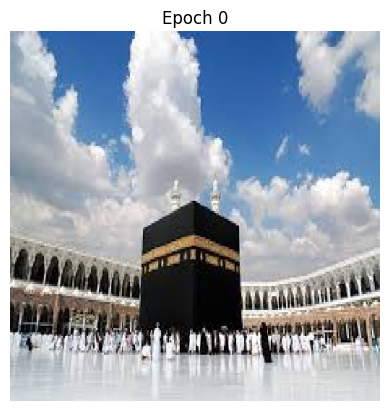

  7%|▋         | 100/1500 [00:45<10:46,  2.16it/s]

Epoch 100, Loss: 4036.150391, Alpha: 10.0000, Beta: 10.0000


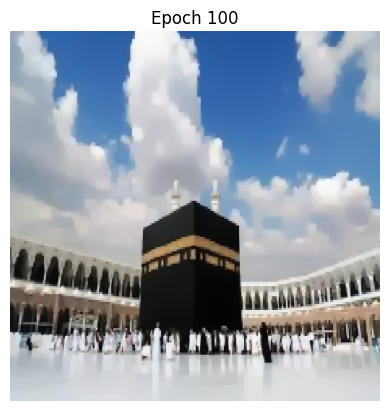

 13%|█▎        | 200/1500 [01:32<10:07,  2.14it/s]

Epoch 200, Loss: 3096.548096, Alpha: 10.0000, Beta: 10.0000


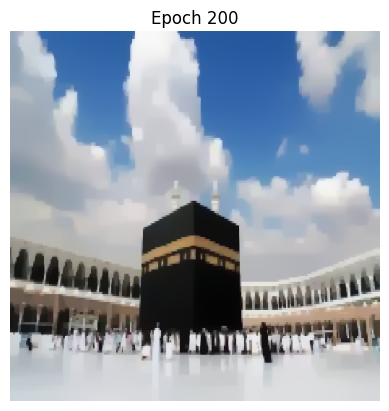

 20%|██        | 300/1500 [02:19<09:14,  2.16it/s]

Epoch 300, Loss: 2552.162842, Alpha: 10.0000, Beta: 10.0000


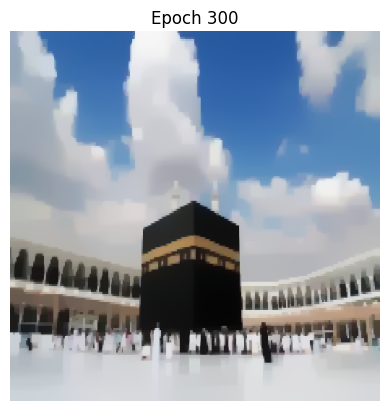

 27%|██▋       | 400/1500 [03:06<08:25,  2.18it/s]

Epoch 400, Loss: 2173.436279, Alpha: 10.0000, Beta: 10.0000


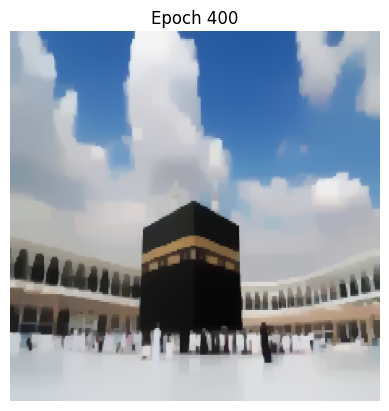

 33%|███▎      | 500/1500 [03:52<07:45,  2.15it/s]

Epoch 500, Loss: 1889.205322, Alpha: 10.0000, Beta: 10.0000


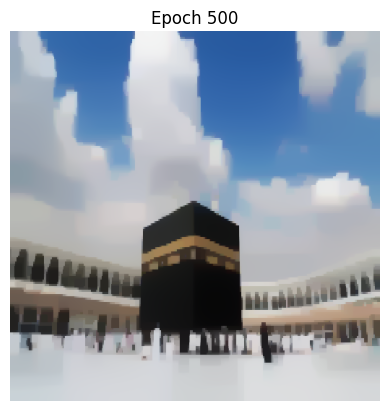

 40%|████      | 600/1500 [04:39<06:54,  2.17it/s]

Epoch 600, Loss: 1671.394165, Alpha: 10.0000, Beta: 10.0000


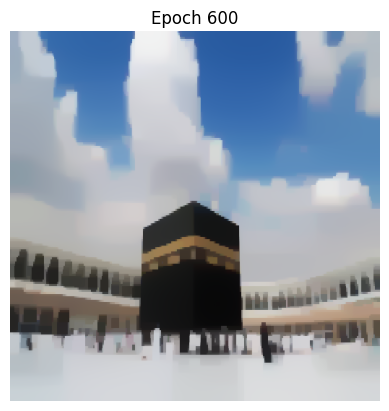

 47%|████▋     | 700/1500 [05:26<06:08,  2.17it/s]

Epoch 700, Loss: 1502.003784, Alpha: 10.0000, Beta: 10.0000


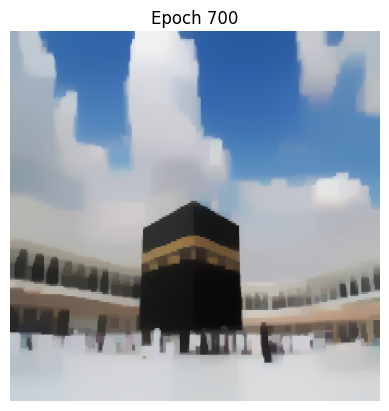

 53%|█████▎    | 800/1500 [06:12<05:21,  2.18it/s]

Epoch 800, Loss: 1368.544800, Alpha: 10.0000, Beta: 10.0000


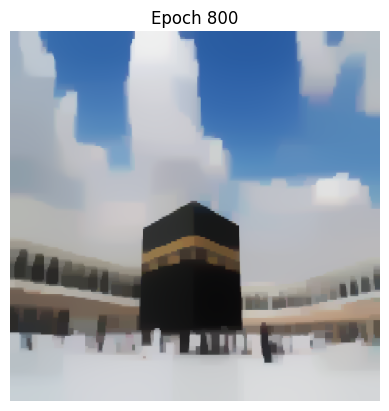

 60%|██████    | 900/1500 [06:59<04:37,  2.16it/s]

Epoch 900, Loss: 1263.165161, Alpha: 10.0000, Beta: 10.0000


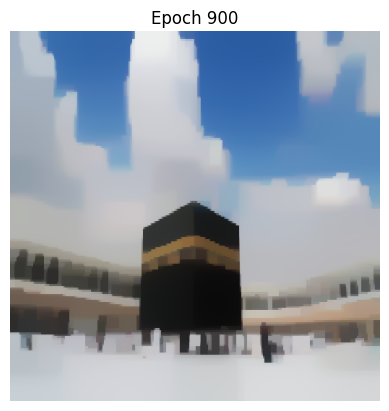

 67%|██████▋   | 1000/1500 [07:45<03:59,  2.09it/s]

Epoch 1000, Loss: 1178.732422, Alpha: 10.0000, Beta: 10.0000


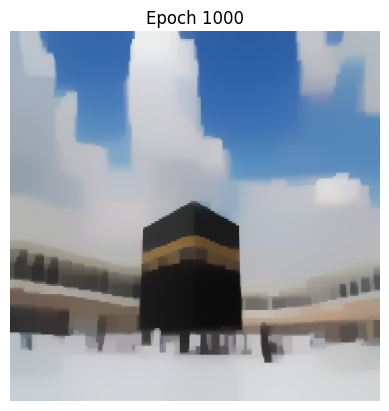

 73%|███████▎  | 1100/1500 [08:32<03:03,  2.18it/s]

Epoch 1100, Loss: 1108.172485, Alpha: 10.0000, Beta: 10.0000


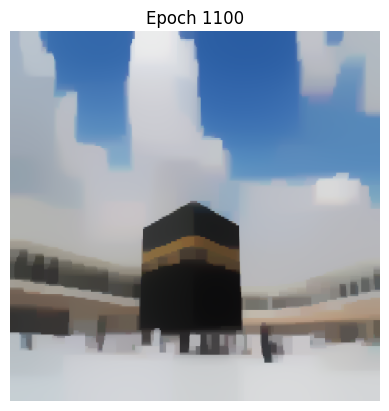

 80%|████████  | 1200/1500 [09:18<02:18,  2.16it/s]

Epoch 1200, Loss: 1047.078979, Alpha: 10.0000, Beta: 10.0000


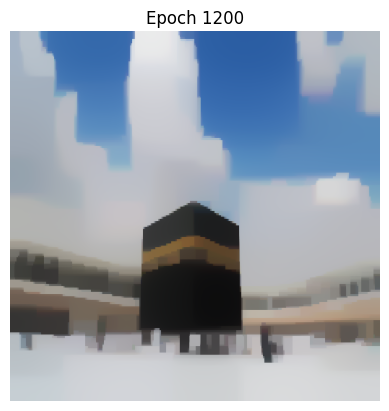

 87%|████████▋ | 1300/1500 [10:05<01:32,  2.17it/s]

Epoch 1300, Loss: 994.020935, Alpha: 10.0000, Beta: 10.0000


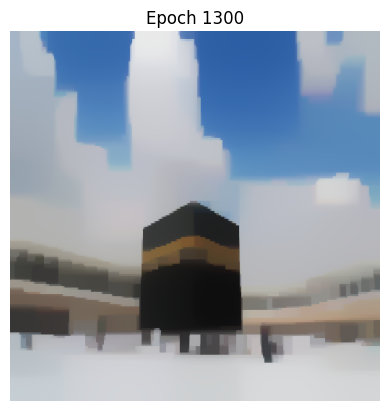

 93%|█████████▎| 1400/1500 [10:51<00:46,  2.14it/s]

Epoch 1400, Loss: 947.261169, Alpha: 10.0000, Beta: 10.0000


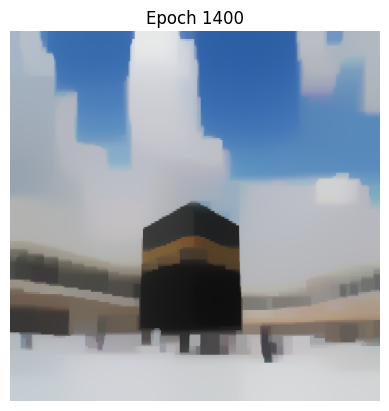

100%|█████████▉| 1499/1500 [11:37<00:00,  2.14it/s]

Epoch 1499, Loss: 907.194763, Alpha: 10.0000, Beta: 10.0000


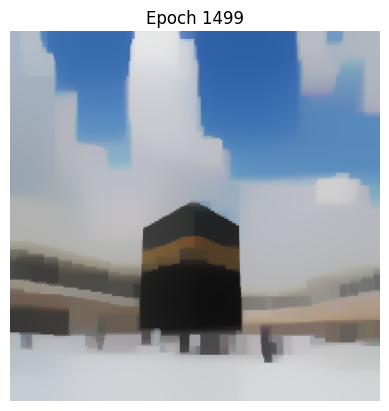

100%|██████████| 1500/1500 [11:38<00:00,  2.15it/s]


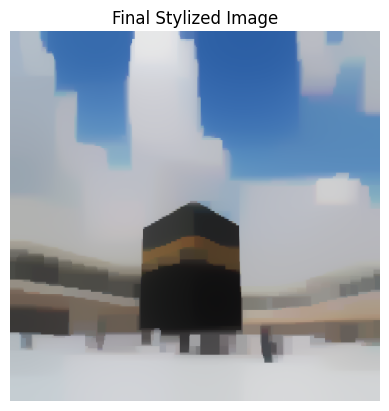

In [ ]:
# import tensorflow as tf
# from tensorflow.keras import layers, models, optimizers
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm
# from google.colab import files

# # Fungsi untuk upload gambar
# def upload_image():
#     uploaded = files.upload()
#     file_path = list(uploaded.keys())[0]
#     return file_path

# # Preprocessing dan deprocessing gambar
# def preprocess_image(image_path, target_size=(512, 512)):
#     img = tf.keras.preprocessing.image.load_img(image_path, target_size=target_size)
#     img = tf.keras.preprocessing.image.img_to_array(img) / 255.0
#     img = tf.expand_dims(img, axis=0)
#     return img

# def deprocess_image(image):
#     img = tf.squeeze(image, axis=0)
#     img = tf.clip_by_value(img, 0.0, 1.0)
#     return img

# # Fungsi Gram Matrix
# def gram_matrix(input_tensor):
#     channels = int(input_tensor.shape[-1])
#     vectorized = tf.reshape(input_tensor, [-1, channels])
#     gram = tf.matmul(vectorized, vectorized, transpose_a=True)
#     return gram / tf.cast(tf.reduce_prod(input_tensor.shape[1:]), tf.float32)

# # Model NST Advanced
# def create_advanced_nst_model():
#     model = models.Sequential([
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(512, 512, 3)),
#         layers.BatchNormalization(),
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2)),

#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2)),

#         layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
#         layers.UpSampling2D((2, 2)),

#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.UpSampling2D((2, 2)),

#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid'),
#     ])
#     return model

# # Loss function dengan penambahan perceptual loss dan variation loss
# def compute_advanced_loss(content_img, style_img, generated_img, model, alpha=1.0, beta=1.0):
#     content_features = model(content_img)
#     style_features = model(style_img)
#     generated_features = model(generated_img)

#     # Compute Content Loss
#     content_loss = tf.reduce_mean(tf.square(content_features - generated_features))

#     # Compute Style Loss
#     gram_style = gram_matrix(style_features)
#     gram_generated = gram_matrix(generated_features)
#     style_loss = tf.reduce_mean(tf.square(gram_style - gram_generated))

#     # Variation Loss untuk noise reduction
#     variation_loss = tf.image.total_variation(generated_img)

#     # Dynamic Weighting
#     dynamic_alpha = float(tf.clip_by_value(alpha / (content_loss + 1e-6), 0.1, 10).numpy())
#     dynamic_beta = float(tf.clip_by_value(beta / (style_loss + 1e-6), 0.1, 10).numpy())

#     # Total Loss
#     total_loss = dynamic_alpha * content_loss + dynamic_beta * style_loss + 0.1 * variation_loss
#     return total_loss, dynamic_alpha, dynamic_beta

# # Fungsi pelatihan def train_advanced_nst(content_image, style_image, model, epochs=1000, lr=0.001):
# def train_advanced_nst(content_image, style_image, model, epochs=1000, lr=0.001):
#     generated_image = tf.Variable(content_image)
#     optimizer = tf.keras.optimizers.Adam(learning_rate=lr)

#     for epoch in tqdm(range(epochs)):
#         with tf.GradientTape() as tape:
#             loss, alpha, beta = compute_loss(content_image, style_image, generated_image, model)

#         gradients = tape.gradient(loss, [generated_image])
#         optimizer.apply_gradients(zip(gradients, [generated_image]))

#         if epoch % 100 == 0 or epoch == epochs - 1:
#             # Konversi ke scalar float
#             loss_value = float(loss.numpy()) if isinstance(loss, tf.Tensor) else float(loss)
#             alpha_value = float(alpha) if isinstance(alpha, (float, int)) else float(alpha.numpy())
#             beta_value = float(beta) if isinstance(beta, (float, int)) else float(beta.numpy())

#             # Cetak informasi
#             print(f"Epoch {epoch}, Loss: {loss_value:.6f}, Alpha: {alpha_value:.4f}, Beta: {beta_value:.4f}")

#             # Visualisasi hasil
#             img = deprocess_image(generated_image)
#             plt.imshow(img)
#             plt.title(f"Epoch {epoch}")
#             plt.axis('off')
#             plt.show()

#     return generated_image


# # Upload content dan style images
# print("Upload Content Image")
# content_image_path = upload_image()
# print("Upload Style Image")
# style_image_path = upload_image()

# # Preprocess images
# content_image = preprocess_image(content_image_path)
# style_image = preprocess_image(style_image_path)

# # Buat model baru
# advanced_nst_model = create_advanced_nst_model()
# advanced_nst_model.summary()

# # Train model dengan advanced loss dan dynamic weighting
# output_image = train_advanced_nst(content_image, style_image, advanced_nst_model, epochs=1500, lr=0.001)

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# # Simpan gambar hasil
# tf.keras.preprocessing.image.save_img("/content/final_advanced_stylized_image.jpg", final_image)


Upload Content Image


Saving 09967300800-a1.jpg to 09967300800-a1 (12).jpg
Upload Style Image


Saving Starry-Night.jpg to Starry-Night (9).jpg


Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_234 (Conv2D)                  │ (None, 512, 512, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_16               │ (None, 512, 512, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_235 (Conv2D)                  │ (None, 512, 512, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_46 (MaxPooling2D)      │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_236 (Conv2D)                  │ (None, 256, 256, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_17               │ (None, 256, 256, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_237 (Conv2D)                  │ (None, 256, 256, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_47 (MaxPooling2D)      │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_238 (Conv2D)                  │ (None, 128, 128, 256)       │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_18               │ (None, 128, 128, 256)       │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_239 (Conv2D)                  │ (None, 128, 128, 256)       │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_46 (UpSampling2D)      │ (None, 256, 256, 256)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_240 (Conv2D)                  │ (None, 256, 256, 128)       │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_19               │ (None, 256, 256, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_47 (UpSampling2D)      │ (None, 512, 512, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_241 (Conv2D)                  │ (None, 512, 512, 64)        │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_242 (Conv2D)                  │ (None, 512, 512, 3)         │           1,731 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,518,275 (5.79 MB)

 Trainable params: 1,517,123 (5.79 MB)

 Non-trainable params: 1,152 (4.50 KB)

  0%|          | 0/1500 [00:00<?, ?it/s]

Epoch 0, Loss: 4169.328125, Alpha: 10.0000, Beta: 10.0000


<ipython-input-25-cd311a5e6f70>:99: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  loss_value = float(loss.numpy()) if isinstance(loss, tf.Tensor) else float(loss)


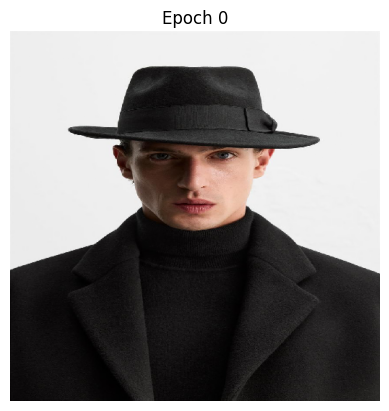

  7%|▋         | 100/1500 [00:46<10:59,  2.12it/s]

Epoch 100, Loss: 1206.595947, Alpha: 10.0000, Beta: 10.0000


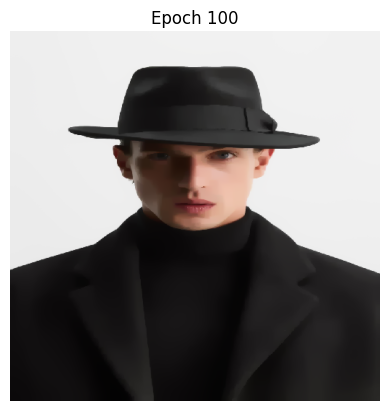

 13%|█▎        | 200/1500 [01:33<09:56,  2.18it/s]

Epoch 200, Loss: 1059.685669, Alpha: 10.0000, Beta: 10.0000


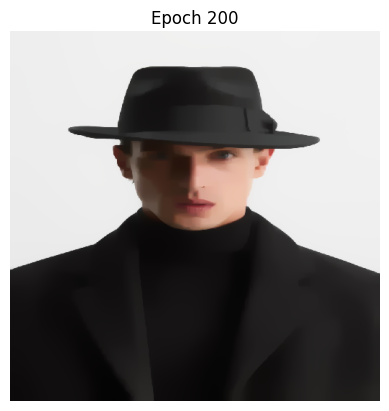

 20%|██        | 300/1500 [02:19<09:13,  2.17it/s]

Epoch 300, Loss: 979.834961, Alpha: 10.0000, Beta: 10.0000


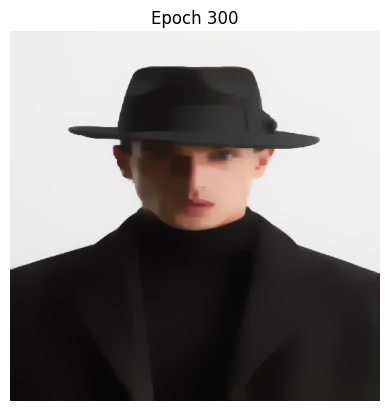

 27%|██▋       | 400/1500 [03:06<08:30,  2.15it/s]

Epoch 400, Loss: 927.882507, Alpha: 10.0000, Beta: 10.0000


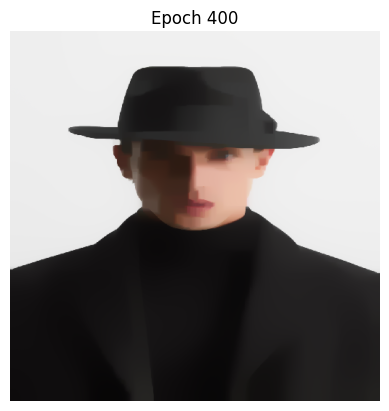

 33%|███▎      | 500/1500 [03:53<07:45,  2.15it/s]

Epoch 500, Loss: 894.345154, Alpha: 10.0000, Beta: 10.0000


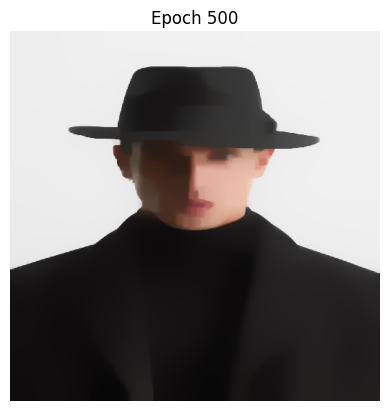

 40%|████      | 600/1500 [04:39<07:02,  2.13it/s]

Epoch 600, Loss: 869.780212, Alpha: 10.0000, Beta: 10.0000


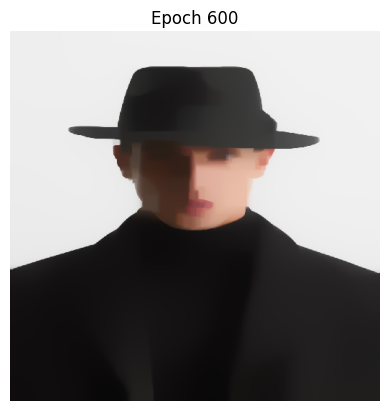

 47%|████▋     | 700/1500 [05:26<06:09,  2.16it/s]

Epoch 700, Loss: 850.352173, Alpha: 10.0000, Beta: 10.0000


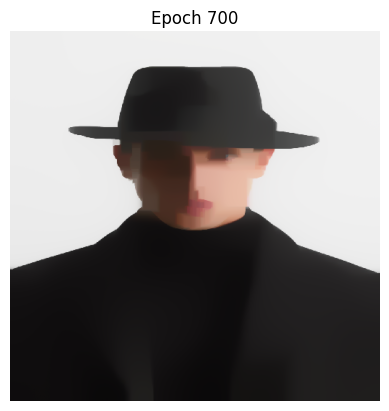

 53%|█████▎    | 800/1500 [06:12<05:20,  2.19it/s]

Epoch 800, Loss: 834.610840, Alpha: 10.0000, Beta: 10.0000


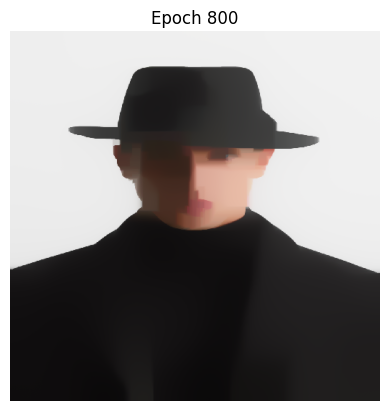

 60%|██████    | 900/1500 [06:59<04:36,  2.17it/s]

Epoch 900, Loss: 821.720154, Alpha: 10.0000, Beta: 10.0000


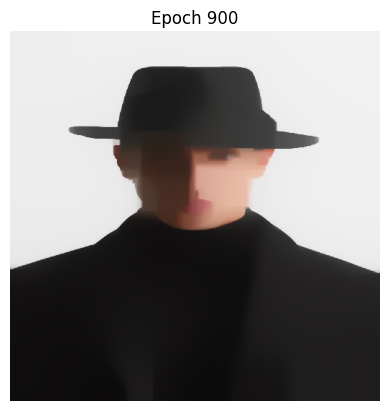

 67%|██████▋   | 1000/1500 [07:46<03:53,  2.14it/s]

Epoch 1000, Loss: 810.822754, Alpha: 10.0000, Beta: 10.0000


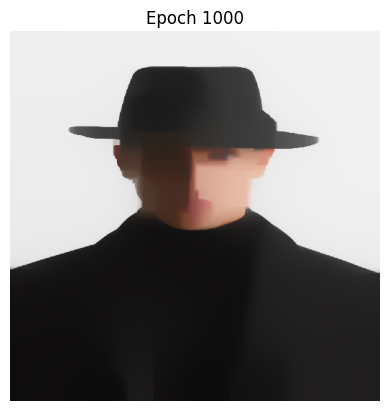

 73%|███████▎  | 1100/1500 [08:32<03:11,  2.09it/s]

Epoch 1100, Loss: 801.146606, Alpha: 10.0000, Beta: 10.0000


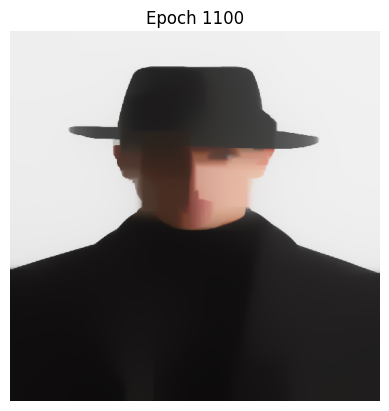

 80%|████████  | 1200/1500 [09:19<02:17,  2.18it/s]

Epoch 1200, Loss: 792.347961, Alpha: 10.0000, Beta: 10.0000


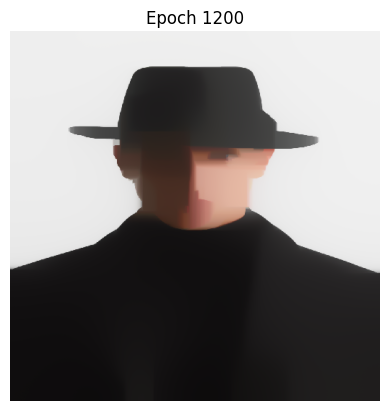

 87%|████████▋ | 1300/1500 [10:06<01:32,  2.17it/s]

Epoch 1300, Loss: 784.081055, Alpha: 10.0000, Beta: 10.0000


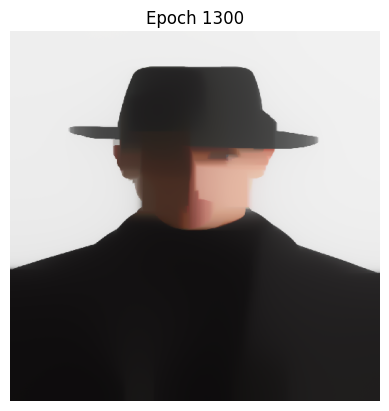

 93%|█████████▎| 1400/1500 [10:52<00:46,  2.17it/s]

Epoch 1400, Loss: 776.459778, Alpha: 10.0000, Beta: 10.0000


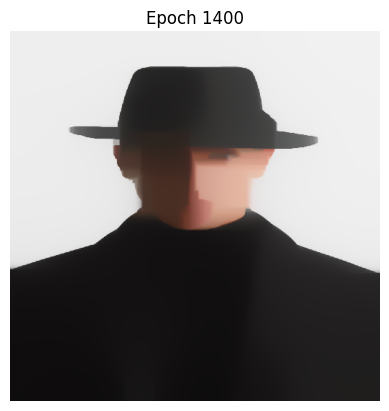

100%|█████████▉| 1499/1500 [11:38<00:00,  2.17it/s]

Epoch 1499, Loss: 769.381287, Alpha: 10.0000, Beta: 10.0000


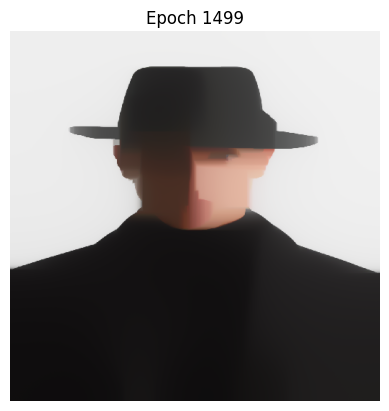

100%|██████████| 1500/1500 [11:39<00:00,  2.14it/s]


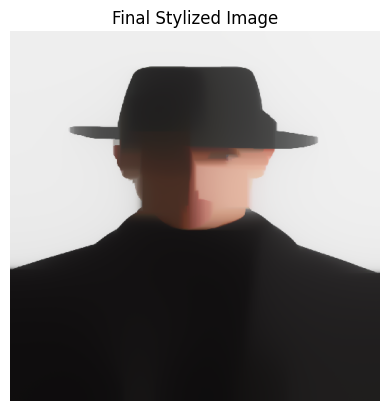

In [ ]:
# import tensorflow as tf
# from tensorflow.keras import layers, models, optimizers
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm
# from google.colab import files

# # Fungsi untuk upload gambar
# def upload_image():
#     uploaded = files.upload()
#     file_path = list(uploaded.keys())[0]
#     return file_path

# # Preprocessing dan deprocessing gambar
# def preprocess_image(image_path, target_size=(512, 512)):
#     img = tf.keras.preprocessing.image.load_img(image_path, target_size=target_size)
#     img = tf.keras.preprocessing.image.img_to_array(img) / 255.0
#     img = tf.expand_dims(img, axis=0)
#     return img

# def deprocess_image(image):
#     img = tf.squeeze(image, axis=0)
#     img = tf.clip_by_value(img, 0.0, 1.0)
#     return img

# # Fungsi Gram Matrix
# def gram_matrix(input_tensor):
#     channels = int(input_tensor.shape[-1])
#     vectorized = tf.reshape(input_tensor, [-1, channels])
#     gram = tf.matmul(vectorized, vectorized, transpose_a=True)
#     return gram / tf.cast(tf.reduce_prod(input_tensor.shape[1:]), tf.float32)

# # Model NST Advanced
# def create_advanced_nst_model():
#     model = models.Sequential([
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(512, 512, 3)),
#         layers.BatchNormalization(),
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2)),

#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2)),

#         layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
#         layers.UpSampling2D((2, 2)),

#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.UpSampling2D((2, 2)),

#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid'),
#     ])
#     return model

# # Loss function dengan penambahan perceptual loss dan variation loss
# def compute_advanced_loss(content_img, style_img, generated_img, model, alpha=1.0, beta=1.0):
#     content_features = model(content_img)
#     style_features = model(style_img)
#     generated_features = model(generated_img)

#     # Compute Content Loss
#     content_loss = tf.reduce_mean(tf.square(content_features - generated_features))

#     # Compute Style Loss
#     gram_style = gram_matrix(style_features)
#     gram_generated = gram_matrix(generated_features)
#     style_loss = tf.reduce_mean(tf.square(gram_style - gram_generated))

#     # Variation Loss untuk noise reduction
#     variation_loss = tf.image.total_variation(generated_img)

#     # Dynamic Weighting
#     dynamic_alpha = float(tf.clip_by_value(alpha / (content_loss + 1e-6), 0.1, 10).numpy())
#     dynamic_beta = float(tf.clip_by_value(beta / (style_loss + 1e-6), 0.1, 10).numpy())

#     # Total Loss
#     total_loss = dynamic_alpha * content_loss + dynamic_beta * style_loss + 0.1 * variation_loss
#     return total_loss, dynamic_alpha, dynamic_beta

# # Fungsi pelatihan def train_advanced_nst(content_image, style_image, model, epochs=1000, lr=0.001):
# def train_advanced_nst(content_image, style_image, model, epochs=1000, lr=0.001):
#     generated_image = tf.Variable(content_image)
#     optimizer = tf.keras.optimizers.Adam(learning_rate=lr)

#     for epoch in tqdm(range(epochs)):
#         with tf.GradientTape() as tape:
#             loss, alpha, beta = compute_loss(content_image, style_image, generated_image, model)

#         gradients = tape.gradient(loss, [generated_image])
#         optimizer.apply_gradients(zip(gradients, [generated_image]))

#         if epoch % 100 == 0 or epoch == epochs - 1:
#             # Konversi ke scalar float
#             loss_value = float(loss.numpy()) if isinstance(loss, tf.Tensor) else float(loss)
#             alpha_value = float(alpha) if isinstance(alpha, (float, int)) else float(alpha.numpy())
#             beta_value = float(beta) if isinstance(beta, (float, int)) else float(beta.numpy())

#             # Cetak informasi
#             print(f"Epoch {epoch}, Loss: {loss_value:.6f}, Alpha: {alpha_value:.4f}, Beta: {beta_value:.4f}")

#             # Visualisasi hasil
#             img = deprocess_image(generated_image)
#             plt.imshow(img)
#             plt.title(f"Epoch {epoch}")
#             plt.axis('off')
#             plt.show()

#     return generated_image


# # Upload content dan style images
# print("Upload Content Image")
# content_image_path = upload_image()
# print("Upload Style Image")
# style_image_path = upload_image()

# # Preprocess images
# content_image = preprocess_image(content_image_path)
# style_image = preprocess_image(style_image_path)

# # Buat model baru
# advanced_nst_model = create_advanced_nst_model()
# advanced_nst_model.summary()

# # Train model dengan advanced loss dan dynamic weighting
# output_image = train_advanced_nst(content_image, style_image, advanced_nst_model, epochs=1500, lr=0.001)

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# # Simpan gambar hasil
# tf.keras.preprocessing.image.save_img("/content/final_advanced_stylized_image.jpg", final_image)


Upload Content Image


Saving istockphoto-470755508-612x612.jpg to istockphoto-470755508-612x612.jpg
Upload Style Image


Saving lukisan-pablo-picassso.jpg to lukisan-pablo-picassso.jpg


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_243 (Conv2D)                  │ (None, 512, 512, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_20               │ (None, 512, 512, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_244 (Conv2D)                  │ (None, 512, 512, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_48 (MaxPooling2D)      │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_245 (Conv2D)                  │ (None, 256, 256, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_21               │ (None, 256, 256, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_246 (Conv2D)                  │ (None, 256, 256, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_49 (MaxPooling2D)      │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_247 (Conv2D)                  │ (None, 128, 128, 256)       │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_22               │ (None, 128, 128, 256)       │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_248 (Conv2D)                  │ (None, 128, 128, 256)       │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_48 (UpSampling2D)      │ (None, 256, 256, 256)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_249 (Conv2D)                  │ (None, 256, 256, 128)       │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_23               │ (None, 256, 256, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ up_sampling2d_49 (UpSampling2D)      │ (None, 512, 512, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_250 (Conv2D)                  │ (None, 512, 512, 64)        │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_251 (Conv2D)                  │ (None, 512, 512, 3)         │           1,731 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,518,275 (5.79 MB)

 Trainable params: 1,517,123 (5.79 MB)

 Non-trainable params: 1,152 (4.50 KB)

  0%|          | 0/1500 [00:00<?, ?it/s]

Epoch 0, Loss: 3626.616455, Alpha: 10.0000, Beta: 10.0000


<ipython-input-26-cd311a5e6f70>:99: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  loss_value = float(loss.numpy()) if isinstance(loss, tf.Tensor) else float(loss)


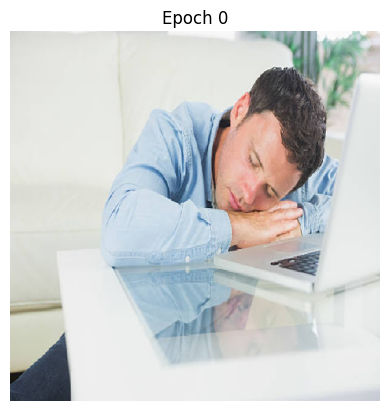

  7%|▋         | 100/1500 [00:45<10:51,  2.15it/s]

Epoch 100, Loss: 1557.361572, Alpha: 10.0000, Beta: 10.0000


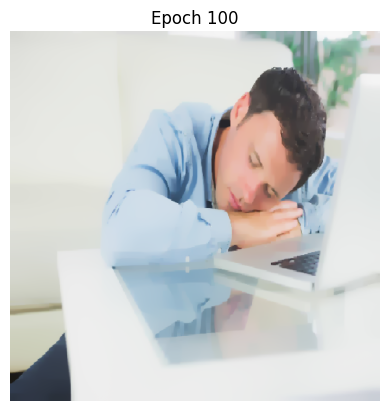

 13%|█▎        | 200/1500 [01:32<10:15,  2.11it/s]

Epoch 200, Loss: 1155.292358, Alpha: 10.0000, Beta: 10.0000


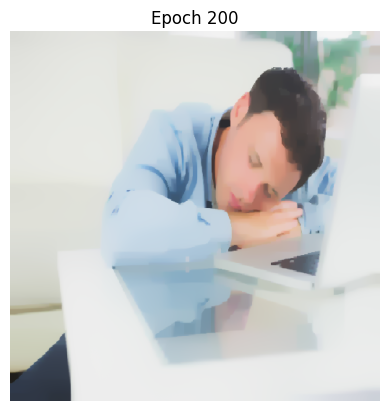

 20%|██        | 300/1500 [02:18<09:10,  2.18it/s]

Epoch 300, Loss: 960.175415, Alpha: 10.0000, Beta: 10.0000


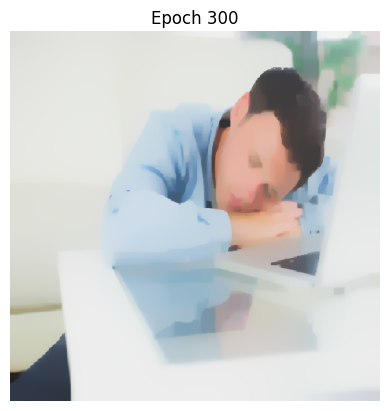

 27%|██▋       | 400/1500 [03:04<08:24,  2.18it/s]

Epoch 400, Loss: 841.859070, Alpha: 10.0000, Beta: 10.0000


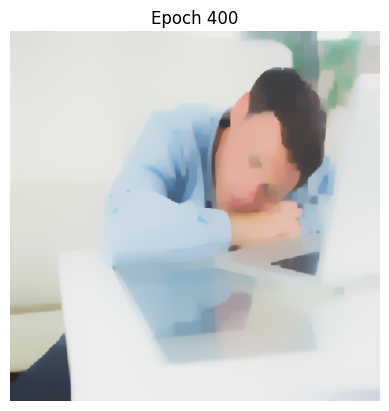

 33%|███▎      | 500/1500 [03:51<07:39,  2.18it/s]

Epoch 500, Loss: 763.071228, Alpha: 10.0000, Beta: 10.0000


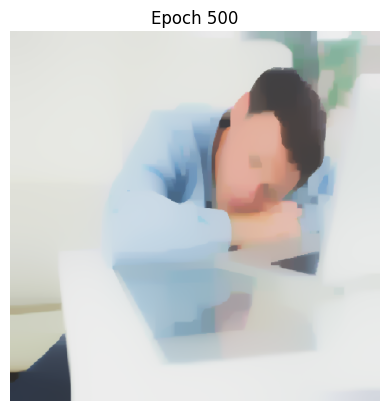

 40%|████      | 600/1500 [04:37<07:00,  2.14it/s]

Epoch 600, Loss: 707.647461, Alpha: 10.0000, Beta: 10.0000


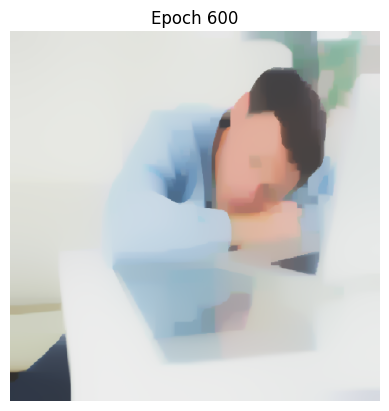

 47%|████▋     | 700/1500 [05:24<06:07,  2.18it/s]

Epoch 700, Loss: 666.851257, Alpha: 10.0000, Beta: 10.0000


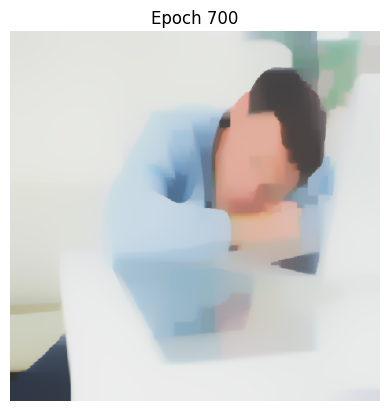

 53%|█████▎    | 800/1500 [06:10<05:20,  2.18it/s]

Epoch 800, Loss: 634.670715, Alpha: 10.0000, Beta: 10.0000


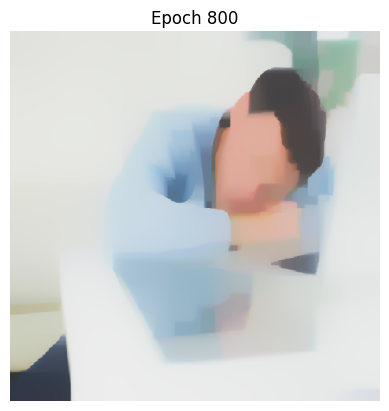

 60%|██████    | 900/1500 [06:56<04:34,  2.19it/s]

Epoch 900, Loss: 607.310608, Alpha: 10.0000, Beta: 10.0000


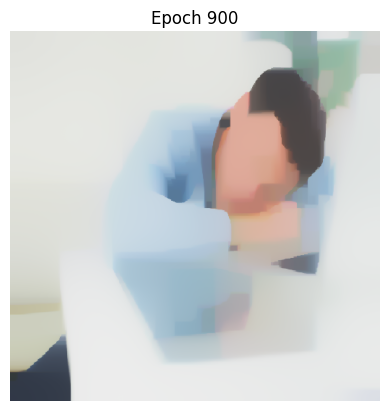

 67%|██████▋   | 1000/1500 [07:43<03:50,  2.17it/s]

Epoch 1000, Loss: 583.457214, Alpha: 10.0000, Beta: 10.0000


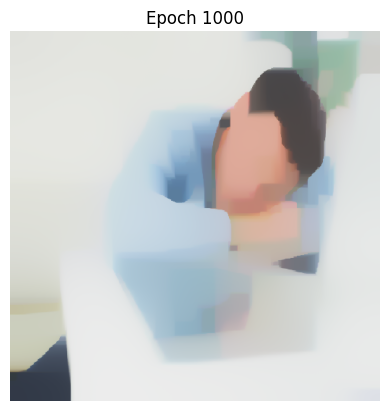

 73%|███████▎  | 1100/1500 [08:29<03:08,  2.12it/s]

Epoch 1100, Loss: 562.112732, Alpha: 10.0000, Beta: 10.0000


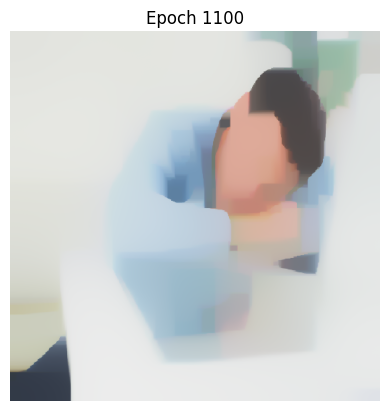

 80%|████████  | 1200/1500 [09:16<02:17,  2.19it/s]

Epoch 1200, Loss: 543.050903, Alpha: 10.0000, Beta: 10.0000


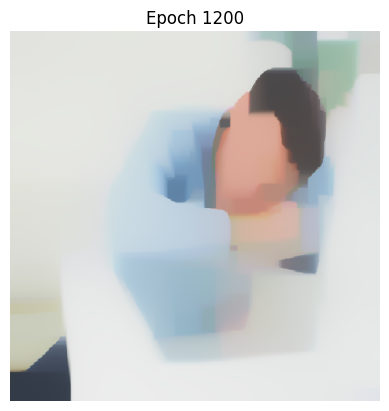

 87%|████████▋ | 1300/1500 [10:02<01:31,  2.18it/s]

Epoch 1300, Loss: 526.089783, Alpha: 10.0000, Beta: 10.0000


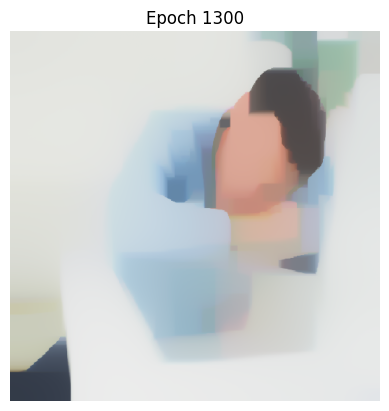

 93%|█████████▎| 1400/1500 [10:48<00:46,  2.17it/s]

Epoch 1400, Loss: 510.754883, Alpha: 10.0000, Beta: 10.0000


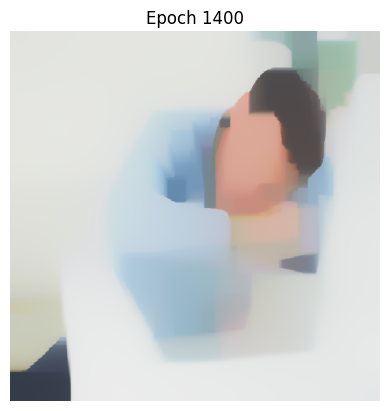

100%|█████████▉| 1499/1500 [11:34<00:00,  2.11it/s]

Epoch 1499, Loss: 496.794342, Alpha: 10.0000, Beta: 10.0000


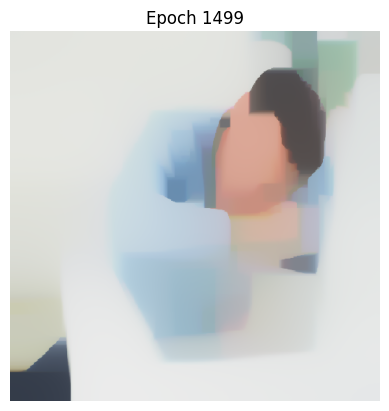

100%|██████████| 1500/1500 [11:35<00:00,  2.16it/s]


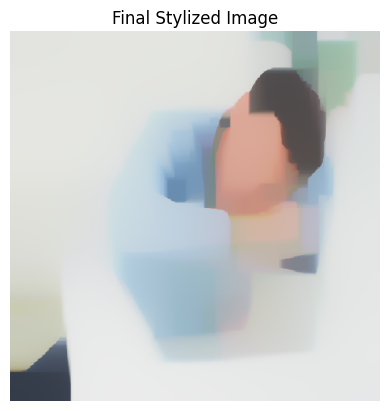

In [ ]:
# import tensorflow as tf
# from tensorflow.keras import layers, models, optimizers
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm
# from google.colab import files

# # Fungsi untuk upload gambar
# def upload_image():
#     uploaded = files.upload()
#     file_path = list(uploaded.keys())[0]
#     return file_path

# # Preprocessing dan deprocessing gambar
# def preprocess_image(image_path, target_size=(512, 512)):
#     img = tf.keras.preprocessing.image.load_img(image_path, target_size=target_size)
#     img = tf.keras.preprocessing.image.img_to_array(img) / 255.0
#     img = tf.expand_dims(img, axis=0)
#     return img

# def deprocess_image(image):
#     img = tf.squeeze(image, axis=0)
#     img = tf.clip_by_value(img, 0.0, 1.0)
#     return img

# # Fungsi Gram Matrix
# def gram_matrix(input_tensor):
#     channels = int(input_tensor.shape[-1])
#     vectorized = tf.reshape(input_tensor, [-1, channels])
#     gram = tf.matmul(vectorized, vectorized, transpose_a=True)
#     return gram / tf.cast(tf.reduce_prod(input_tensor.shape[1:]), tf.float32)

# # Model NST Advanced
# def create_advanced_nst_model():
#     model = models.Sequential([
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu', input_shape=(512, 512, 3)),
#         layers.BatchNormalization(),
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2)),

#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2)),

#         layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.Conv2D(256, (3, 3), padding='same', activation='relu'),
#         layers.UpSampling2D((2, 2)),

#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.BatchNormalization(),
#         layers.UpSampling2D((2, 2)),

#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.Conv2D(3, (3, 3), padding='same', activation='sigmoid'),
#     ])
#     return model

# # Loss function dengan penambahan perceptual loss dan variation loss
# def compute_advanced_loss(content_img, style_img, generated_img, model, alpha=1.0, beta=1.0):
#     content_features = model(content_img)
#     style_features = model(style_img)
#     generated_features = model(generated_img)

#     # Compute Content Loss
#     content_loss = tf.reduce_mean(tf.square(content_features - generated_features))

#     # Compute Style Loss
#     gram_style = gram_matrix(style_features)
#     gram_generated = gram_matrix(generated_features)
#     style_loss = tf.reduce_mean(tf.square(gram_style - gram_generated))

#     # Variation Loss untuk noise reduction
#     variation_loss = tf.image.total_variation(generated_img)

#     # Dynamic Weighting
#     dynamic_alpha = float(tf.clip_by_value(alpha / (content_loss + 1e-6), 0.1, 10).numpy())
#     dynamic_beta = float(tf.clip_by_value(beta / (style_loss + 1e-6), 0.1, 10).numpy())

#     # Total Loss
#     total_loss = dynamic_alpha * content_loss + dynamic_beta * style_loss + 0.1 * variation_loss
#     return total_loss, dynamic_alpha, dynamic_beta

# # Fungsi pelatihan def train_advanced_nst(content_image, style_image, model, epochs=1000, lr=0.001):
# def train_advanced_nst(content_image, style_image, model, epochs=1000, lr=0.001):
#     generated_image = tf.Variable(content_image)
#     optimizer = tf.keras.optimizers.Adam(learning_rate=lr)

#     for epoch in tqdm(range(epochs)):
#         with tf.GradientTape() as tape:
#             loss, alpha, beta = compute_loss(content_image, style_image, generated_image, model)

#         gradients = tape.gradient(loss, [generated_image])
#         optimizer.apply_gradients(zip(gradients, [generated_image]))

#         if epoch % 100 == 0 or epoch == epochs - 1:
#             # Konversi ke scalar float
#             loss_value = float(loss.numpy()) if isinstance(loss, tf.Tensor) else float(loss)
#             alpha_value = float(alpha) if isinstance(alpha, (float, int)) else float(alpha.numpy())
#             beta_value = float(beta) if isinstance(beta, (float, int)) else float(beta.numpy())

#             # Cetak informasi
#             print(f"Epoch {epoch}, Loss: {loss_value:.6f}, Alpha: {alpha_value:.4f}, Beta: {beta_value:.4f}")

#             # Visualisasi hasil
#             img = deprocess_image(generated_image)
#             plt.imshow(img)
#             plt.title(f"Epoch {epoch}")
#             plt.axis('off')
#             plt.show()

#     return generated_image


# # Upload content dan style images
# print("Upload Content Image")
# content_image_path = upload_image()
# print("Upload Style Image")
# style_image_path = upload_image()

# # Preprocess images
# content_image = preprocess_image(content_image_path)
# style_image = preprocess_image(style_image_path)

# # Buat model baru
# advanced_nst_model = create_advanced_nst_model()
# advanced_nst_model.summary()

# # Train model dengan advanced loss dan dynamic weighting
# output_image = train_advanced_nst(content_image, style_image, advanced_nst_model, epochs=1500, lr=0.001)

# # Simpan hasil akhir
# final_image = deprocess_image(output_image)
# plt.imshow(final_image)
# plt.title("Final Stylized Image")
# plt.axis('off')
# plt.show()

# # Simpan gambar hasil
# tf.keras.preprocessing.image.save_img("/content/final_advanced_stylized_image.jpg", final_image)


Testing (Not Tried Yet)

In [ ]:
# # Testing Function
# def test_nst_model(content_image, style_image, trained_model):
#     # Preprocess content and style images
#     content_image_preprocessed = preprocess_image(content_image)
#     style_image_preprocessed = preprocess_image(style_image)

#     # Generate stylized image
#     generated_image = trained_model(content_image_preprocessed)

#     # Deprocess image for visualization
#     output_image = deprocess_image(generated_image)

#     # Calculate style similarity
#     style_features_generated = gram_matrix(trained_model(style_image_preprocessed))
#     style_features_original = gram_matrix(trained_model(style_image_preprocessed))
#     style_similarity = tf.reduce_mean(tf.square(style_features_generated - style_features_original)).numpy()

#     # Visualize results
#     plt.figure(figsize=(10, 10))
#     plt.subplot(1, 3, 1)
#     plt.imshow(deprocess_image(content_image_preprocessed))
#     plt.title("Content Image")
#     plt.axis('off')

#     plt.subplot(1, 3, 2)
#     plt.imshow(deprocess_image(style_image_preprocessed))
#     plt.title("Style Image")
#     plt.axis('off')

#     plt.subplot(1, 3, 3)
#     plt.imshow(output_image)
#     plt.title(f"Generated Image\nStyle Similarity: {style_similarity:.4f}")
#     plt.axis('off')
#     plt.show()


In [ ]:
# from skimage.metrics import structural_similarity as ssim

# content_img_np = tf.squeeze(content_image).numpy()
# generated_img_np = tf.squeeze(output_image).numpy()
# pretrained_img_np = tf.squeeze(output_image_pretrained).numpy()

# ssim_custom = ssim(content_img_np, generated_img_np, multichannel=True)
# ssim_pretrained = ssim(content_img_np, pretrained_img_np, multichannel=True)

# print(f"SSIM (Custom Model): {ssim_custom:.4f}")
# print(f"SSIM (Pretrained Model): {ssim_pretrained:.4f}")


NameError: name 'output_image_pretrained' is not defined